# GAN

## Objective

- Build an GAN model for generating channel estimation
- Solve problems related to gan during the training and inferencing
- Visualize and compare the results for each version

Note: The GAN model or (WGAN, WGAN-GP) like a min max game, The generator model try to fool the discriminor while discriminator try to classfy which sample is fake or real. The state of these model after training should be equilibrium

In [ ]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from torchvision import datasets

## Generator

In [ ]:
import torch
import torch.nn as nn

class Generator(nn.Module):
    def __init__(self, z_dim=100, im_chan=2, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        self.hidden_dim = hidden_dim

        self.transform = nn.Sequential(
            nn.Linear(z_dim, hidden_dim * 4 * 4),  # Initial size of 4x4
            nn.ReLU(),
        )

        self.gen = nn.Sequential(
            self.make_gen_block(hidden_dim, hidden_dim // 2, kernel_size=4, stride=2, padding=1),     # 4x4 -> 8x8
            self.make_gen_block(hidden_dim // 2, hidden_dim // 4, kernel_size=4, stride=2, padding=1), # 8x8 -> 16x16
            self.make_gen_block(hidden_dim // 4, im_chan, kernel_size=4, stride=2, padding=1, final_layer=True), # 16x16 -> 32x32
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=4, stride=2, padding=1, final_layer=False):
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride, padding),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride, padding),
                nn.Tanh(),
            )

    def forward(self, noise):
        x = self.transform(noise)
        x = x.view(len(x), self.hidden_dim, 4, 4)  # Reshape to 4x4
        return self.gen(x)

In [ ]:
from torchsummary import summary

g_model = Generator(32 * 32 * 2).cuda()

summary(g_model, (32 * 32 * 2,))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Linear-1                 [-1, 1024]       2,098,176
              ReLU-2                 [-1, 1024]               0
   ConvTranspose2d-3             [-1, 32, 8, 8]          32,800
       BatchNorm2d-4             [-1, 32, 8, 8]              64
              ReLU-5             [-1, 32, 8, 8]               0
   ConvTranspose2d-6           [-1, 16, 16, 16]           8,208
       BatchNorm2d-7           [-1, 16, 16, 16]              32
              ReLU-8           [-1, 16, 16, 16]               0
   ConvTranspose2d-9            [-1, 2, 32, 32]             514
             Tanh-10            [-1, 2, 32, 32]               0
Total params: 2,139,794
Trainable params: 2,139,794
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.01
Forward/backward pass size (MB): 0.19
Params size (MB): 8.16
Estimat

## Discriminator

In [ ]:
import torch
import torch.nn as nn

class Discriminator(nn.Module):
    def __init__(self, im_chan=2, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.critic = nn.Sequential(
            self.make_critic_block(im_chan, hidden_dim, kernel_size=4, stride=2, padding=1),     # 2x32x32 -> 64x16x16
            self.make_critic_block(hidden_dim, hidden_dim * 2, kernel_size=4, stride=2, padding=1), # 64x16x16 -> 128x8x8
            self.make_critic_block(hidden_dim * 2, hidden_dim * 4, kernel_size=4, stride=2, padding=1),  # 128x8x8 -> 256x4x4
        )
        self.avg_pool = nn.AdaptiveAvgPool2d((1, 1))
        self.fc = nn.Linear(hidden_dim * 4, 1)
        self.activation = nn.Sigmoid()

    def make_critic_block(self, input_channels, output_channels, kernel_size=4, stride=2, padding=1):
        return nn.Sequential(
            nn.Conv2d(input_channels, output_channels, kernel_size, stride, padding),
            nn.BatchNorm2d(output_channels),
            nn.LeakyReLU(0.2, inplace=True),
        )

    def forward(self, image):
        critic_pred = self.critic(image)
        critic_pred = self.avg_pool(critic_pred)
        critic_pred = critic_pred.view(critic_pred.size(0), -1)
        critic_pred = self.fc(critic_pred)
        critic_pred = self.activation(critic_pred)
        return critic_pred

In [ ]:
from torchsummary import summary

d_1 = Discriminator().cuda()
summary(d_1, (2,32, 32))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 16, 16]           2,112
       BatchNorm2d-2           [-1, 64, 16, 16]             128
         LeakyReLU-3           [-1, 64, 16, 16]               0
            Conv2d-4            [-1, 128, 8, 8]         131,200
       BatchNorm2d-5            [-1, 128, 8, 8]             256
         LeakyReLU-6            [-1, 128, 8, 8]               0
            Conv2d-7            [-1, 256, 4, 4]         524,544
       BatchNorm2d-8            [-1, 256, 4, 4]             512
         LeakyReLU-9            [-1, 256, 4, 4]               0
AdaptiveAvgPool2d-10            [-1, 256, 1, 1]               0
           Linear-11                    [-1, 1]             257
          Sigmoid-12                    [-1, 1]               0
Total params: 659,009
Trainable params: 659,009
Non-trainable params: 0
-------------------------------

## Loss function


In [ ]:
# Compute the critic loss
def discriminator_loss(loss_func, real_pred, fake_pred):
    real_loss = loss_func(real_pred, torch.ones_like(real_pred))
    fake_loss = loss_func(fake_pred, torch.zeros_like(fake_pred))
    return real_loss + fake_loss

In [ ]:
# Compute the generator loss
def generator_loss(loss_func, fake_pred):
    return loss_func(fake_pred, torch.ones_like(fake_pred))


In [ ]:
def l2_loss(fake, real):
    return torch.norm(fake - real, p=2)

## Initial Process

### Hyperarameters

In [ ]:
n_epochs = 100
z_dim = 256
batch_size = 256
lr = 0.002
betas = (0.5, 0.999)
c_lambda = 10
critic_repeats = 3
device = 'cuda'
n_workers = 4

### Dataset

In [ ]:
import gdown
import pickle

def download_and_load_pkl(url, output='output.pkl'):
    # Download the pickle file from Google Drive
    gdown.download(url, output, quiet=False)

    # Load the pickle file
    with open(output, 'rb') as f:
        data = pickle.load(f)

    return data

In [ ]:
channels = download_and_load_pkl('https://drive.google.com/uc?export=download&id=1OwPoI-pQjuNvDmxhGHkBAweRnR73zwcv', output='channels_res.pkl')
responses = download_and_load_pkl('https://drive.google.com/uc?export=download&id=1lMpM8LJldgIDlXwqaPyg_YFte_bIs80x', output='y_res.pkl')



Downloading...
From (original): https://drive.google.com/uc?export=download&id=1OwPoI-pQjuNvDmxhGHkBAweRnR73zwcv
From (redirected): https://drive.google.com/uc?export=download&id=1OwPoI-pQjuNvDmxhGHkBAweRnR73zwcv&confirm=t&uuid=636c5218-8123-4724-8f8d-a89940c7a2a1
To: /content/channels_res.pkl
100%|██████████| 328M/328M [00:03<00:00, 83.1MB/s]
Downloading...
From (original): https://drive.google.com/uc?export=download&id=1lMpM8LJldgIDlXwqaPyg_YFte_bIs80x
From (redirected): https://drive.google.com/uc?export=download&id=1lMpM8LJldgIDlXwqaPyg_YFte_bIs80x&confirm=t&uuid=22d42689-bf06-45e4-8ff8-77d22b84ebd5
To: /content/y_res.pkl
100%|██████████| 328M/328M [00:04<00:00, 74.3MB/s]


In [ ]:
channels.shape

(20000, 4, 8, 32, 2)

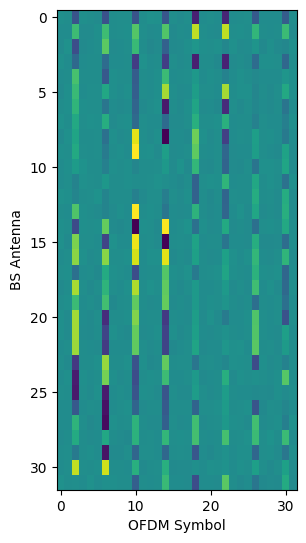

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(3, 6))  # Adjust the figsize to make the plot height much greater than the width

# Assuming x_signal is a 2D array
# Display the array as an image
plt.imshow(responses[0].reshape(32, 32, 2).transpose(1,0,2)[:,:,0], cmap='viridis', aspect='auto')
# Set labels for the axes
plt.xlabel('OFDM Symbol')
plt.ylabel('BS Antenna')
# Adjust subplot parameters to fit the figure area
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

# Show the plot
plt.show()

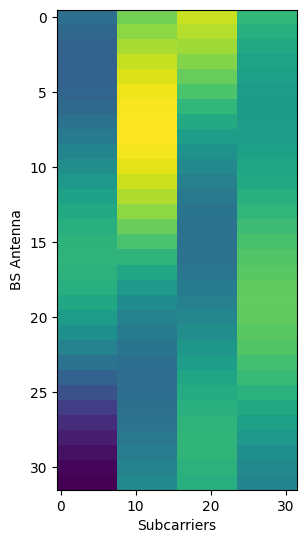

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(3, 6))  # Adjust the figsize to make the plot height much greater than the width

# Assuming x_signal is a 2D array
# Display the array as an image
plt.imshow(channels[0].reshape(32, 32, 2).transpose(1,0,2)[:,:,0], cmap='viridis', aspect='auto')
# Set labels for the axes
plt.xlabel('Subcarriers')
plt.ylabel('BS Antenna')
# Adjust subplot parameters to fit the figure area
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

# Show the plot
plt.show()

In [ ]:
import torch
import torchvision.transforms as transforms
from torch.utils.data.dataloader import DataLoader
import numpy as np


def sign(x: np.ndarray):
    x[x < 0] = -1
    x[x > 0] = 1
    return x

class ChannelsData(torch.utils.data.Dataset):
    def __init__(
        self, channels_res: np.ndarray, y_res: np.ndarray, type_data: str = "train"
    ):
        self.len_dataset = channels_res.shape[0]

        self.transform_channel = transforms.Compose(
            [
                transforms.ToTensor(),
            ]
        )
        self.transform_y_signal = transforms.Compose(
            [
                transforms.ToTensor(),
            ]
        )
        ratio = 4 / 5
        if type_data == "train":
            self._channels_res = channels_res[: int(self.len_dataset * ratio)]
            self.y_res = y_res[: int(self.len_dataset * ratio)]
        elif type_data == "eval":
            self._channels_res = channels_res[int(self.len_dataset * ratio) :]
            self.y_res = y_res[int(self.len_dataset * ratio) :]
            self._channels_res = self._channels_res[: int(len(self._channels_res) / 2)]
            self.y_res = self.y_res[: int(len(self.y_res) / 2)]
        else:
            self._channels_res = channels_res[int(self.len_dataset * ratio) :]
            self.y_res = y_res[int(self.len_dataset * ratio) :]
            self._channels_res = self._channels_res[int(len(self._channels_res) / 2) :]
            self.y_res = self.y_res[int(len(self.y_res) / 2) :]


    def preprocess_response(self, y_res):

        # y_res = y_res.T.flatten()

        normalized_y_res = np.zeros_like(y_res)
        for i in range(len(y_res)):
            y_res_i = y_res[i]
            y_res_i = (y_res_i - y_res_i.min()) / (y_res_i.max() - y_res_i.min())
            y_res_i = 2 * y_res_i - 1
            normalized_y_res[i] = y_res_i


        normalized_y_res = normalized_y_res.reshape(32, 32, 2).transpose(1,0,2)
        normalized_y_res = normalized_y_res.T.flatten()
        return normalized_y_res

    def preprocess_chanel(self, channel_res):
        # Get the real part of the complex number

        # channel_res = channel_res[:,:,0]

        # channel_res = (channel_res - channel_res.min()) / (channel_res.max() - channel_res.min())
        # channel_res = 2 * channel_res - 1

        normalized_channel_res = np.zeros_like(channel_res)
        for i in range(len(channel_res)):
            channel_res_i = channel_res[i]
            channel_res_i = (channel_res_i - channel_res_i.min()) / (channel_res_i.max() - channel_res_i.min())
            channel_res_i = 2 * channel_res_i - 1
            normalized_channel_res[i] = channel_res_i

        normalized_channel_res = normalized_channel_res.reshape(32, 32, 2).transpose(1,0,2)
        return normalized_channel_res

    def __getitem__(self, item):
        channel_res = self._channels_res[item]
        y_res = self.y_res[item]

        channel_res = self.preprocess_chanel(channel_res)
        y_res = self.preprocess_response(y_res)

        item_channel_res = torch.FloatTensor(channel_res).permute(2, 0, 1)
        item_y_res = torch.FloatTensor(y_res)

        return item_channel_res, item_y_res

    def __len__(self):
        return len(self._channels_res)


class ChannelDataloader:
    def __init__(
        self,
        channels_res: np.ndarray,
        y_res: np.ndarray,
        batch_size: int = 64,
        pin_memory: bool = False,
        num_worker: int = 1,
    ):
        self.channels_res = channels_res
        self.y_res = y_res
        self.batch_size = batch_size
        self.pin_memory = pin_memory
        self.num_worker = num_worker

    def train_dataloader(self):
        return DataLoader(
            ChannelsData(
                channels_res=self.channels_res,
                y_res=self.y_res,
                type_data="train",
            ),
            batch_size=self.batch_size,
            pin_memory=self.pin_memory,
            shuffle=True,
            num_workers=self.num_worker,
        )

    def test_dataloader(self):
        return DataLoader(
            ChannelsData(
                channels_res=self.channels_res,
                y_res=self.y_res,
                type_data="test",
            ),
            batch_size=1,
            pin_memory=self.pin_memory,
            num_workers=self.num_worker,
            # shuffle=True,
        )

    def eval_dataloader(self):
        return DataLoader(
            ChannelsData(
                channels_res=self.channels_res,
                y_res=self.y_res,
                type_data="eval",
            ),
            batch_size=1,
            pin_memory=self.pin_memory,
            num_workers=self.num_worker,
            shuffle=True,
        )


In [ ]:
dataloader = ChannelDataloader(
    y_res=responses, channels_res=channels, batch_size=batch_size, num_worker=n_workers
)
train_dataset = dataloader.train_dataloader()
eval_dataset = dataloader.eval_dataloader()

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


### Model

Each model, we need to initialize weighs which help model converge faster, and prevent the vanishing and exploding gradient at eh first time .

In [ ]:
def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

In [ ]:
generator = Generator(32 * 32 * 2).to(device)
discriminator = Discriminator().to(device)

# Initialize weights
generator = generator.apply(weights_init)
discriminator = discriminator.apply(weights_init)


# Optimizer is Adam help converge faster and more stable
g_opt = torch.optim.Adam(generator.parameters(), lr=lr, betas=betas)
d_opt = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=betas)


# Losses
loss_func = nn.BCEWithLogitsLoss()

### Visualization

In [ ]:
def show_tensor_images(image_tensor):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_grid = image_tensor.detach().cpu()
    plt.imshow(image_grid.squeeze())
    plt.show()
    plt.close()

def show_loss_images(c_losses, g_losses):
    plt.figure(figsize=(10, 5))
    plt.plot(c_losses, label="Discriminator Loss", linestyle='-', linewidth=2)
    plt.plot(g_losses, label="Generator Loss", linestyle='-', linewidth=2)
    plt.title("GAN Training Losses")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    plt.close()


def show_nmse(nmse_scores):
    plt.figure(figsize=(10, 5))
    plt.plot(range(len(nmse_scores)), nmse_scores, marker='o', linestyle='-', color='b', label='NMSE')
    plt.title('Normalized Mean Squared Error (NMSE) vs Prediction Set', fontsize=14)
    plt.xlabel('Prediction Set', fontsize=12)
    plt.ylabel('NMSE', fontsize=12)
    plt.grid(True)
    plt.legend()
    plt.show()
    plt.close()

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde


def plot_distribution(
    c_real,
    c_fake,
    g_fake,
    c_real_threshold=None,
    c_fake_threshold=None,
    g_fake_threshold=None,
    save_path=None,
):
    # Create a figure with two subplots
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 12))

    # Histogram plot
    ax1.hist(c_real, bins=30, alpha=0.5, label="Real Critic")
    ax1.hist(c_fake, bins=30, alpha=0.5, label="Fake Critic")
    ax1.hist(g_fake, bins=30, alpha=0.5, label="Fake Generator")
    if c_real_threshold:
        ax1.axvline(
            c_real_threshold,
            color="r",
            linestyle="--",
            label="Threshold for Real Critic",
        )
    if c_fake_threshold:
        ax1.axvline(
            c_fake_threshold,
            color="g",
            linestyle="--",
            label="Threshold for Fake Critic",
        )
    if g_fake_threshold:
        ax1.axvline(
            g_fake_threshold,
            color="b",
            linestyle="--",
            label="Threshold for Fake Generator",
        )
    ax1.set_title("Histogram of Distributions with Thresholds")
    ax1.set_xlabel("Value")
    ax1.set_ylabel("Frequency")
    ax1.legend()

    # KDE plot
    kde_c_real = gaussian_kde(c_real)
    kde_c_fake = gaussian_kde(c_fake)
    kde_g_fake = gaussian_kde(g_fake)

    x_range = np.linspace(
        min(c_real.min(), c_fake.min(), g_fake.min()),
        max(c_real.max(), c_fake.max(), g_fake.max()),
        200,
    )

    ax2.plot(x_range, kde_c_real(x_range), label="Real Critic")
    ax2.plot(x_range, kde_c_fake(x_range), label="Fake Critic")
    ax2.plot(x_range, kde_g_fake(x_range), label="Fake Generator")
    if c_real_threshold:
        ax1.axvline(
            c_real_threshold,
            color="r",
            linestyle="--",
            label="Threshold for Real Critic",
        )
    if c_fake_threshold:
        ax1.axvline(
            c_fake_threshold,
            color="g",
            linestyle="--",
            label="Threshold for Fake Critic",
        )
    if g_fake_threshold:
        ax1.axvline(
            g_fake_threshold,
            color="b",
            linestyle="--",
            label="Threshold for Fake Generator",
        )
    ax2.set_title("Kernel Density Estimation of Distributions with Thresholds")
    ax2.set_xlabel("Value")
    ax2.set_ylabel("Density")
    ax2.legend()

    plt.tight_layout()

    # save file
    if save_path:
        if not os.path.exists(save_path):
            os.makedirs(os.path.dirname(save_path), exist_ok=True)
        plt.savefig(save_path)

    plt.show()
    plt.close()

In [ ]:
import os

import matplotlib.pyplot as plt
import numpy as np


def plot_generated_image(prediction, test_input, tar, t=0, prefix: str = "wgan"):

    test_input = test_input.cpu().detach().numpy().squeeze()
    prediction = prediction.cpu().detach().numpy().squeeze()
    tar = tar.cpu().detach().numpy().squeeze()

    display_list = [
        np.squeeze(test_input),
        np.squeeze(tar),
        np.squeeze(prediction),
    ]
    title = ["Input Y", "Target H", "Prediction H"]

    for i in range(3):
        plt.subplot(1, 3, i + 1)
        plt.title(title[i])
        plt.imshow(display_list[i])
        plt.axis("off")

    img_path = os.path.join("results/generated_img", prefix, "img_" + str(t) + ".png")

    if not os.path.exists(img_path):
        os.makedirs(os.path.dirname(img_path), exist_ok=True)
    plt.savefig(img_path)
    plt.close()


def plot_skewness_func(skewness_scores, epochs, img_path):
    # # Plot the loss curves
    plt.figure(figsize=(10, 6))
    plt.plot(epochs, skewness_scores, label="Target")
    plt.xlabel("Epoch")
    plt.ylabel("Skewness distances")
    plt.title("Skewness Loss")
    plt.legend()
    if not os.path.exists(img_path):
        os.makedirs(os.path.dirname(img_path), exist_ok=True)
    plt.savefig(img_path)
    plt.close()
    # plt.show()

def plot_nmse_func(mse_scores, epochs, img_path):
    # # Plot the loss curves
    plt.figure(figsize=(10, 6))
    plt.plot(epochs, mse_scores, label="Target")
    plt.xlabel("Epoch")
    plt.ylabel("MSE")
    plt.title("MSE Scores")
    plt.legend()
    if not os.path.exists(img_path):
        os.makedirs(os.path.dirname(img_path), exist_ok=True)
    plt.savefig(img_path)
    plt.close()
    # plt.show()


def plot_loss_func(losses_d, losses_g, epochs, img_path):
    # # Plot the loss curves
    plt.figure(figsize=(10, 6))
    plt.plot(epochs, losses_d, label="Discriminator Loss")
    plt.plot(epochs, losses_g, label="Generator Loss")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title("Loss Curves")
    plt.legend()

    if not os.path.exists(img_path):
        os.makedirs(os.path.dirname(img_path), exist_ok=True)
    plt.savefig(img_path)
    plt.close()
    # plt.show()

#### Discriminator Activation Mapping

In [ ]:
import os
import numpy as np
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable


class Hook:
    def __init__(self, module):
        self.stored = None
        module.register_forward_hook(self.hook_fn)

    def hook_fn(self, module, input, output):
        # Store the forward activations
        self.stored = output.detach()


class HookBwd:
    def __init__(self, module):
        self.stored = None
        module.register_full_backward_hook(self.hook_fn)

    def hook_fn(self, module, grad_input, grad_output):
        # Store the gradients during the backward pass
        self.stored = grad_output[0].detach()


class GradCam:
    def __init__(self, model, conv_layer):
        self.model = model

        self.hook_activation = Hook(conv_layer)
        self.hook_gradient = HookBwd(conv_layer)

    def compute_activation_map(self, image):

        output = self.model(image)

        # because in our case ciritic is a single value so it is not possible to get the target class
        output.backward()

        # Retrieve stored activations and gradients
        activations = self.hook_activation.stored
        gradients = self.hook_gradient.stored

        # get importance weights of the gradients
        importance_weights = gradients.mean(dim=[2, 3], keepdim=True)

        # Multiply the importance weights with the activations
        weighted_activations = (
            importance_weights * activations
        )  # Element-wise multiplication

        # Get activation map by summing the weighted activations
        activation_map = weighted_activations.sum(dim=1)

        # Apply ReLU to remove negative values
        activation_map = F.relu(activation_map)

        # normalize the activation map
        activation_map = activation_map.cpu().detach().numpy()  # Convert to numpy
        activation_map = (activation_map - activation_map.min()) / (
            activation_map.max() - activation_map.min()
        )  # Normalize

        return activation_map

    def visualize_cam(self, image, save_path=None):
        # Compute the activation map
        activation_map = self.compute_activation_map(image)

        # Get the first image and activation map
        activation_map = activation_map.squeeze(0)
        image = image.squeeze(0)

        # Normalize the image
        image = (
            image.cpu().numpy().transpose(1, 2, 0)
        )  # Shape: [height, width, channels]
        image = (image - image.min()) / (image.max() - image.min())

        real_image = image[:, :, 0]


        # Plot the images side by side
        fig, axs = plt.subplots(1, 3, figsize=(12, 6))

        # Plot the original image
        axs[0].imshow(real_image, alpha=0.9,)
        axs[0].axis("off")
        axs[0].set_title("Input Image")

        # Plot heatmap
        im = axs[1].imshow(
            activation_map,
            alpha=0.4,
            cmap="jet",
            extent=(0, image.shape[1], image.shape[0], 0),
            interpolation="bilinear",
        )
        axs[1].axis("off")
        axs[1].set_title("Activation Map")

        # Plot the overlay image
        axs[2].imshow(
            real_image, aspect="auto", alpha=0.9
        )  # Set higher alpha for real_image
        axs[2].imshow(
            activation_map,
            alpha=0.6,
            cmap="jet",
            extent=(0, image.shape[1], image.shape[0], 0),
            interpolation="bilinear",
        )
        axs[2].axis("off")
        axs[2].set_title("Activation Map Overlay")

        # set color bar
        divider = make_axes_locatable(axs[1])
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)

        # save file
        if save_path:
            if not os.path.exists(save_path):
                os.makedirs(os.path.dirname(save_path), exist_ok=True)
            plt.savefig(save_path)
            np.save(save_path.replace(".png", ".npy"), activation_map)

        plt.show()
        plt.close()


class ScoreCam(GradCam):
    def __init__(self, model, conv_layer):
        super(ScoreCam, self).__init__(model, conv_layer)

    def compute_activation_map(self, image):
        # Forward pass to get activation maps
        _ = self.model(image)
        activations = self.hook_activation.stored

        # Upsample activations to match input size
        upsampled = F.interpolate(
            activations, size=image.shape[2:], mode="bilinear", align_corners=False
        )

        # Normalize each activation map
        normalized = torch.zeros_like(upsampled)
        for i in range(upsampled.shape[1]):
            normalized[:, i, :, :] = (
                upsampled[:, i, :, :] - upsampled[:, i, :, :].min()
            ) / (upsampled[:, i, :, :].max() - upsampled[:, i, :, :].min() + 1e-8)

        # Compute scores for each activation map
        scores = []
        for i in range(normalized.shape[1]):
            masked_input = image * normalized[:, i, :, :].unsqueeze(1)
            output = self.model(masked_input)
            scores.append(output.detach().cpu().numpy())

        scores = np.array(scores)

        # Weight the activation maps by their scores
        weighted_activations = (
            torch.tensor(scores, device=activations.device).unsqueeze(0) * activations
        ).sum(dim=1)

        # Apply ReLU and normalize
        activation_map = F.relu(weighted_activations)
        activation_map = activation_map.cpu().detach().numpy()
        activation_map = (activation_map - activation_map.min()) / (
            activation_map.max() - activation_map.min() + 1e-8
        )

        return activation_map

    def visualize_cam(self, image, save_path=None):
        return super().visualize_cam(image, save_path)


class EigenCam(GradCam):
    def __init__(self, model, conv_layer):
        super(EigenCam, self).__init__(model, conv_layer)

    def compute_activation_map(self, image):
        """
        Computes EigenCAM activation map using the eigenvector from the activations' covariance matrix.
        """
        # Step 1: Forward pass to get activation maps
        _ = self.model(image)
        activations = (
            self.hook_activation.stored
        )  # [batch_size, channels, height, width]

        # Step 2: Reshape activations to 2D (batch, channels, width*height)
        activations = activations.view(
            activations.size(0), activations.size(1), -1
        )  # [batch_size, channels, width*height]

        # Step 3: Compute the covariance matrix for each activation map (batch-wise)
        # Using torch.bmm for batch-wise matrix multiplication of activations and their transpose
        cov_matrix = torch.bmm(
            activations, activations.transpose(1, 2)
        )  # [batch_size, channels, channels]

        # Step 4: Move to CPU for eigenvalue computation (or stay on GPU if desired)
        cov_matrix = cov_matrix.cpu().detach().numpy()

        # Step 5: Compute eigenvalues and eigenvectors (using NumPy as PyTorch doesn't have batch-wise eigenvalue decomposition)
        eigenvalues, eigenvectors = np.linalg.eigh(
            cov_matrix
        )  # Eigenvalue decomposition for each sample in batch

        # Step 6: Use the eigenvector corresponding to the largest eigenvalue
        # The last eigenvector corresponds to the largest eigenvalue because they are sorted in ascending order
        largest_eigenvector = eigenvectors[..., -1]  # [batch_size, channels]

        # Convert eigenvector back to PyTorch and move to same device as the input image
        largest_eigenvector = torch.from_numpy(largest_eigenvector).to(
            image.device
        )  # [batch_size, channels]
        largest_eigenvector = torch.abs(largest_eigenvector)  # Take the absolute value

        # Step 7: Weight the activations by the largest eigenvector
        # Unsqueeze to match the activation dimensions, then apply weighting
        weighted_activations = activations * largest_eigenvector.unsqueeze(
            -1
        )  # [batch_size, channels, width*height]

        # Step 8: Sum across channels to get a single activation map
        activation_map = weighted_activations.sum(dim=1)  # [batch_size, width*height]

        # Step 9: Reshape back to original spatial dimensions (height, width)
        activation_map = activation_map.view(
            activations.size(0),
            self.hook_activation.stored.size(2),
            self.hook_activation.stored.size(3),
        )  # [batch_size, height, width]

        # Step 10: Apply ReLU and normalize the activation map
        activation_map = F.relu(activation_map)
        activation_map = activation_map.cpu().detach().numpy()

        # Normalize the heatmap to be between 0 and 1
        activation_map = (activation_map - activation_map.min()) / (
            activation_map.max() - activation_map.min() + 1e-8
        )

        return activation_map

    def visualize_cam(self, image, save_path=None):
        return super().visualize_cam(image, save_path)

### Evaluate

In [ ]:
def nmse(pred, target):
    """
    Compute the Normalized Mean Squared Error (NMSE) between two tensors.

    Args:
        pred (torch.Tensor): Predicted tensor.
        target (torch.Tensor): Ground truth tensor (target).

    Returns:
        float: The NMSE value.
    """
    # Compute the Mean Squared Error (MSE)
    mse = torch.mean((pred - target) ** 2)

    # Compute the norm of the target tensor
    norm = torch.mean(target ** 2)

    # NMSE is the ratio of MSE to the norm of the target
    nmse_value = mse / norm

    return nmse_value.item()

In [ ]:
def save_checkpoint(model, file_name):
    model_to_save = {
        "state_dict": model.state_dict(),
    }
    if not os.path.exists(file_name):
        os.makedirs(os.path.dirname(file_name), exist_ok=True)
    torch.save(model_to_save, file_name)


def save_npy(file_name, np_array):
    if not os.path.exists(file_name):
        os.makedirs(os.path.dirname(file_name), exist_ok=True)
    np.save(file_name, np_array)

### Training Steps

In [ ]:
def channel_est_gan():
    total_g_losses = []
    total_d_losses = []
    total_nmse_scores = []
    save_results = "channel_est_gan"
    min_nmse_scores = 10000000
    for epoch in range(n_epochs):
        # Training
        g_losses = 0
        d_losses = 0
        nmse_scores = 0
        for batch_index, (real, label) in enumerate(train_dataset):

            real = real.to(device)
            label = label.to(device)
            cur_batch_size = real.shape[0]
            ########################
            # Update discriminator #
            ########################
            d_opt.zero_grad()

            fake = generator(label)

            d_fake_pred = discriminator(fake)
            d_real_pred = discriminator(real)
            # critic loss
            d_loss = discriminator_loss(loss_func, d_real_pred, d_fake_pred)


            # Update gradients
            d_loss.backward(retain_graph=True)

            # Update optimizer
            d_opt.step()

            d_losses += d_loss.detach().cpu().item()

            ####################
            # Update generator #
            ####################
            g_opt.zero_grad()

            # get noise
            fake_2 = generator(label)

            d_fake_pred_2 = discriminator(fake_2)
            g_loss = generator_loss(loss_func, d_fake_pred_2)

            # Update gradients
            g_loss.backward()

            # Update the weights
            g_opt.step()

            g_losses += g_loss.detach().cpu().item()

            if batch_index % (len(train_dataset) // 3) == 0:
                print(f"Batch [{batch_index}/{len(train_dataset)}] - ",  "Critic loss: ",  d_losses / (batch_index + 1), "- generator loss: ", g_losses / (batch_index + 1))

            nmse_score = nmse(
                pred=fake.permute(0, 2, 3, 1).detach().cpu(),
                target=real.permute(0, 2, 3, 1).detach().cpu(),
            )
            nmse_scores += nmse_score

        total_nmse_scores.append(nmse_scores / len(train_dataset))
        total_d_losses.append(d_losses / len(train_dataset))
        total_g_losses.append(g_losses / len(train_dataset))
        print(f"\tEpoch {epoch} - critic loss: {total_d_losses[-1]} - generator loss: {total_g_losses[-1]}")

        # Visualize Test Dataset
        with torch.no_grad():
            for real, label in eval_dataset:
                cur_batch_size = real.shape[0]
                real = real.to(device)
                label = label.to(device)
                fake = generator(label)
                break
        if epoch in range(0, n_epochs, int(n_epochs // 10)):
            show_tensor_images(label.view(-1, 2, 32, 32)[0,0,:,:].T)
            show_tensor_images(fake[0,0,:,:])
            show_tensor_images(real[0,0,:,:])
            show_loss_images(total_d_losses, total_g_losses)

        if min_nmse_scores > min(total_nmse_scores):
            min_nmse_scores = min(total_nmse_scores)
            plot_generated_image(
                fake[0,0,:,:],
                test_input=label.view(-1, 2, 32, 32)[0,0,:,:].T,
                tar=real[0,0,:,:],
                prefix=save_results,
            )
            save_checkpoint(generator, f"results/checkpoint/{save_results}/g_model.pt")
            save_checkpoint(discriminator, f"results/checkpoint/{save_results}/d_model.pt")
            print(f"\tMNSE Score: {min_nmse_scores}")

        plot_nmse_func(
            total_nmse_scores,
            range(epoch + 1),
            img_path=f"results/nmse/{save_results}/nmse.png",
        )
        plot_loss_func(
            total_d_losses,
            total_g_losses,
            range(epoch + 1),
            img_path=f"results/loss/{save_results}/loss.png",
        )
    save_npy(f"results/nmse/{save_results}/nmse_scores.npy", np.array(total_nmse_scores))
    save_npy(f"results/loss/{save_results}/losses_d.npy", np.array(total_d_losses))
    save_npy(f"results/loss/{save_results}/losses_g.npy", np.array(total_g_losses))


In [ ]:
# channel_est_gan()

## WGAN-GP

In [ ]:
class Critic(Discriminator):
    def __init__(self, im_chan=2, hidden_dim=64):
        super(Critic, self).__init__(im_chan, hidden_dim)
        self.activation = nn.LeakyReLU()

    def forward(self, image):
        critic_pred = self.critic(image)
        critic_pred = self.avg_pool(critic_pred)
        critic_pred = critic_pred.view(critic_pred.size(0), -1)
        critic_pred = self.fc(critic_pred)
        # critic_pred = self.activation(critic_pred)
        return critic_pred

In [ ]:
# before compute the gradient penalty, we need compute the gradient of interpolated image
def get_gradient(critic, real, fake, epsilon, *args):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        critic: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = critic(mixed_images, *args)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=mixed_images,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


# then we compute the gradient penalty
def gradient_penalty_loss(critic, real, fake, *args):

    # get epsilon value
    epsilon = torch.rand(len(real), 1, 1, 1, device=real.device, requires_grad=True)

    # Compute the gradient
    gradient = get_gradient(critic, real, fake, epsilon, *args)

    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)

    # Penalize the mean squared distance of the gradient norms from 1
    penalty = torch.mean((gradient_norm - 1)**2)
    return penalty

In [ ]:
import torch
from scipy import stats
import numpy as np

class SkewCalculator:
    def __init__(self, device=None):
        self.device = device if device is not None else torch.device("cuda" if torch.cuda.is_available() else "cpu")

    def __call__(self, tensor):
        """
        Compute skewness of a PyTorch tensor with flexible shape.
        If the tensor is multi-dimensional, computes skewness along the first dimension.

        :param tensor: PyTorch tensor of any shape
        :return: PyTorch tensor containing skewness value(s)
        """
        # Ensure input is a PyTorch tensor
        if not isinstance(tensor, torch.Tensor):
            tensor = torch.tensor(tensor, dtype=torch.float32, device=self.device)

        # Move tensor to CPU and convert to numpy for scipy
        numpy_array = tensor.detach().cpu().numpy()

        # Compute skewness along the first dimension
        if numpy_array.ndim == 1:
            skewness = stats.skew(numpy_array, axis=0, bias=False)

            if np.isnan(skewness):
                skewness = 0.0
        else:
            skewness = stats.skew(numpy_array, axis=1, bias=False)


        # Convert back to PyTorch tensor and move to original device
        return torch.tensor(skewness, dtype=torch.float32, device=self.device)

In [ ]:
generator = Generator((32 * 32 * 2)).to(device)
critic = Critic().to(device)

# Initialize weights
generator = generator.apply(weights_init)
critic = critic.apply(weights_init)

# Optimizer is Adam help converge faster and more stable
g_opt = torch.optim.Adam(generator.parameters(), lr=lr, betas=betas)
c_opt = torch.optim.Adam(critic.parameters(), lr=lr, betas=betas)


skew_cal = SkewCalculator(device)

In [ ]:
def channel_est_wgan_gp():
    save_results = "channel_est_wgan_gp"
    min_nmse_scores = 10000000
    total_g_losses = []
    total_c_losses = []
    total_nmse_scores = []
    total_skewness = []

    for epoch in range(n_epochs):
        # Training
        g_losses = 0
        c_losses = 0
        nmse_scores = 0
        g_skewness = 0
        if epoch == 0:
            c_lambda_2 = 0.0
        else:
            c_lambda_2 = 0.1
        total_critic_reals = []
        total_critic_fakes = []
        total_generator_fakes = []

        generator.train()
        critic.train()
        for batch_index, (real, label) in enumerate(train_dataset):

            real = real.to(device)
            label = label.to(device)
            cur_batch_size = real.shape[0]
            #################
            # Update critic #
            #################
            total_c_repeat_losses = 0
            critic_reals = 0
            critic_fakes = 0
            for _ in range(critic_repeats):
                c_opt.zero_grad()

                fake = generator(label)

                # critic loss
                critic_real = critic(real)
                critic_fake = critic(fake)

                c_repeat_loss = - (torch.mean(critic_real) - torch.mean(critic_fake))

                # gp loss
                gp_loss = gradient_penalty_loss(critic=critic, real=real, fake=fake)


                # total critic loss
                total_c_repeat_loss = c_repeat_loss + c_lambda * gp_loss

                # Update gradients
                total_c_repeat_loss.backward(retain_graph=True)

                # Update optimizer
                c_opt.step()

                # Keep track of the average critic loss in this batch
                critic_reals += critic_real.detach().cpu()
                critic_fakes += critic_fake.detach().cpu()

                total_c_repeat_losses += total_c_repeat_loss.detach().cpu().item()

            total_critic_reals.append((critic_reals / critic_repeats).view(-1))
            total_critic_fakes.append((critic_fakes / critic_repeats).view(-1))
            c_losses += total_c_repeat_losses / critic_repeats

            ####################
            # Update generator #
            ####################
            g_opt.zero_grad()

            # get noise
            fake_2 = generator(label)

            critic_fake_2 = critic(fake_2)

            skew_loss_2 = l2_loss(skew_cal(real.view(real.size(0), -1)),skew_cal(fake_2.view(fake_2.size(0), -1)))

            g_loss = - torch.mean(critic_fake_2)


            # Update gradients
            g_loss.backward()

            # Update the weights
            g_opt.step()

            g_losses += g_loss.detach().cpu().item()
            total_generator_fakes.append(critic_fake_2.detach().cpu().view(-1))
            g_skewness += skew_loss_2.detach().cpu().item()

            if batch_index % (len(train_dataset) // 3) == 0:
                print(f"Batch [{batch_index}/{len(train_dataset)}] - ",  "Critic loss: ",  c_losses / (batch_index + 1), "- generator loss: ", g_losses / (batch_index + 1))

            nmse_score = nmse(
                pred=fake.permute(0, 2, 3, 1).detach().cpu(),
                target=real.permute(0, 2, 3, 1).detach().cpu(),
            )
            nmse_scores += nmse_score

        total_nmse_scores.append(nmse_scores / len(train_dataset))
        total_c_losses.append(c_losses / len(train_dataset))
        total_g_losses.append(g_losses / len(train_dataset))
        total_skewness.append(g_skewness / len(train_dataset))


        print(f"\tEpoch {epoch} - critic loss: {total_c_losses[-1]} - generator loss: {total_g_losses[-1]}")

        generator.eval()
        critic.eval()
        # Visualize Test Dataset
        with torch.no_grad():
            for real, label in eval_dataset:
                cur_batch_size = real.shape[0]
                real = real.to(device)
                label = label.to(device)
                fake = generator(label)
                break
        if epoch in range(0, n_epochs, int(n_epochs // 10)):
            show_tensor_images(label.view(-1, 2, 32, 32)[0,0,:,:].T)
            show_tensor_images(fake[0,0,:,:])
            show_tensor_images(real[0,0,:,:])
            show_loss_images(total_c_losses, total_g_losses)


        if min_nmse_scores > min(total_nmse_scores):
            min_nmse_scores = min(total_nmse_scores)
            plot_generated_image(
                fake[0,0,:,:],
                test_input=label.view(-1, 2, 32, 32)[0,0,:,:].T,
                tar=real[0,0,:,:],
                prefix=save_results,
            )

            plot_distribution(
                np.array(torch.cat(total_critic_reals)),
                np.array(torch.cat(total_critic_fakes)),
                np.array(torch.cat(total_generator_fakes)),
                save_path=f"results/dis/{save_results}/dis_{epoch}.png"
            )
            save_checkpoint(generator, f"results/checkpoint/{save_results}/g_model.pt")
            save_checkpoint(critic, f"results/checkpoint/{save_results}/d_model.pt")

            conv_layer = critic.critic[-3]
            grad_cam = GradCam(critic, conv_layer)
            grad_cam.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_1_epoch{epoch}.png")

            print(f"\tMNSE Score: {min_nmse_scores}")

        plot_nmse_func(
            total_nmse_scores,
            range(epoch + 1),
            img_path=f"results/nmse/{save_results}/nmse.png",
        )
        plot_loss_func(
            total_c_losses,
            total_g_losses,
            range(epoch + 1),
            img_path=f"results/loss/{save_results}/loss.png",
        )
        plot_skewness_func(
            total_skewness,
            range(epoch + 1),
            img_path=f"results/skewness/{save_results}/skewness.png",
        )

    save_npy(f"results/nmse/{save_results}/nmse_scores.npy", np.array(total_nmse_scores))
    save_npy(f"results/loss/{save_results}/losses_d.npy", np.array(total_c_losses))
    save_npy(f"results/loss/{save_results}/losses_g.npy", np.array(total_g_losses))

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:825: UserWarning: Attempting to run cuBLAS, but there was no current CUDA context! Attempting to set the primary context... (Triggered internally at ../aten/src/ATen/cuda/CublasHandlePool.cpp:135.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


Batch [0/63] -  Critic loss:  9.865395228068033 - generator loss:  -0.04114039987325668
Batch [21/63] -  Critic loss:  7.472699345964375 - generator loss:  -0.2864260280674154
Batch [42/63] -  Critic loss:  7.120411277741423 - generator loss:  -0.5220408585182456
	Epoch 0 - critic loss: 6.749125142576831 - generator loss: -0.7225427045708611


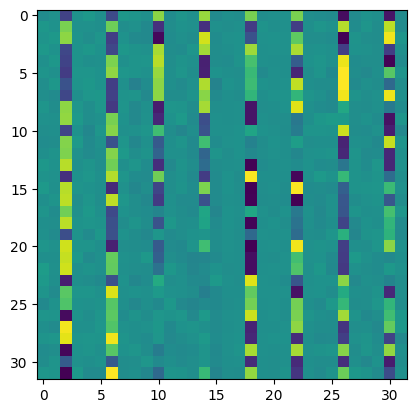

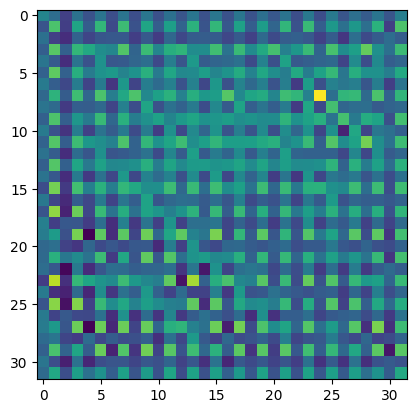

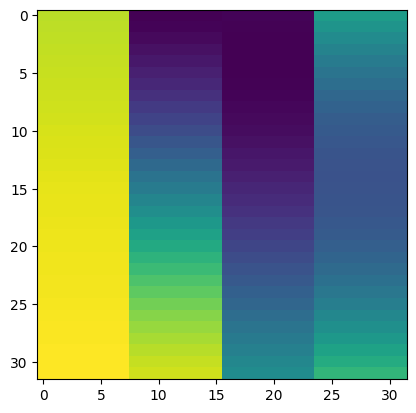

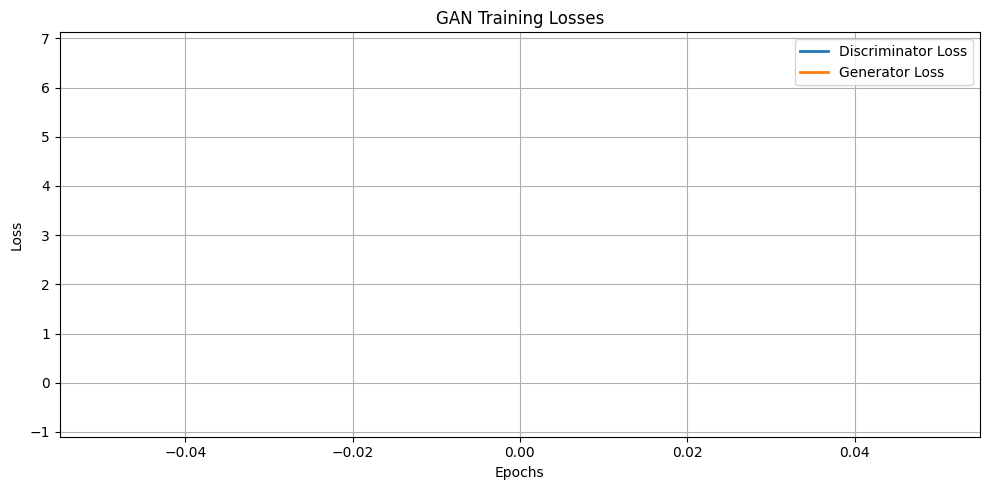

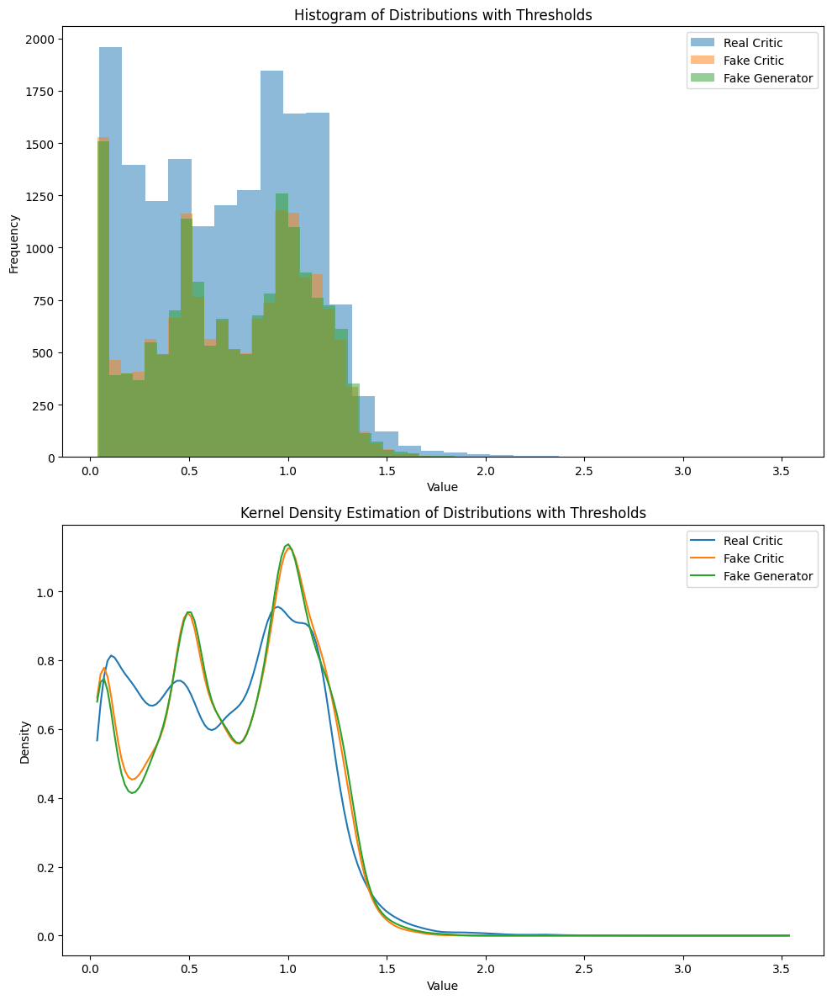

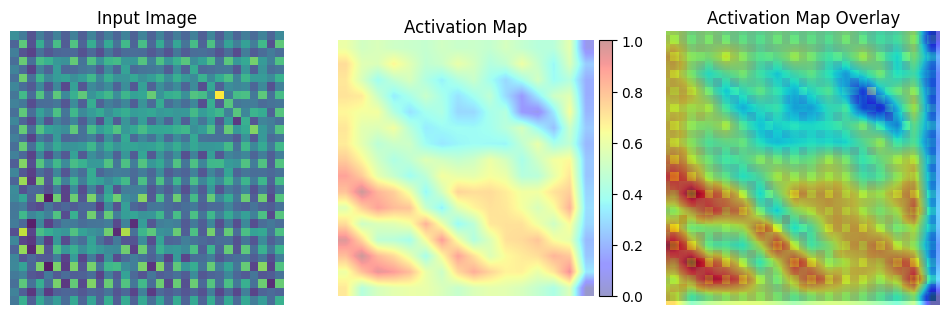

	MNSE Score: 1.0132942767370314
Batch [0/63] -  Critic loss:  7.816256841023763 - generator loss:  -1.2838994264602661
Batch [21/63] -  Critic loss:  5.9577307375994595 - generator loss:  -1.3597817800261758
Batch [42/63] -  Critic loss:  5.85017282278963 - generator loss:  -1.4087269112121228
	Epoch 1 - critic loss: 5.382081487822156 - generator loss: -1.491899151650686
Batch [0/63] -  Critic loss:  2.021564563115438 - generator loss:  -1.7642594575881958
Batch [21/63] -  Critic loss:  2.526591221491496 - generator loss:  -1.854105293750763
Batch [42/63] -  Critic loss:  2.0040163065111916 - generator loss:  -1.9596922314444254
	Epoch 2 - critic loss: 2.688049592984416 - generator loss: -2.049726654612829
Batch [0/63] -  Critic loss:  4.1252334912618 - generator loss:  -2.3257570266723633
Batch [21/63] -  Critic loss:  4.262626566670158 - generator loss:  -2.268135330893777
Batch [42/63] -  Critic loss:  3.2469168111335387 - generator loss:  -2.217870651289474
	Epoch 3 - critic loss: 

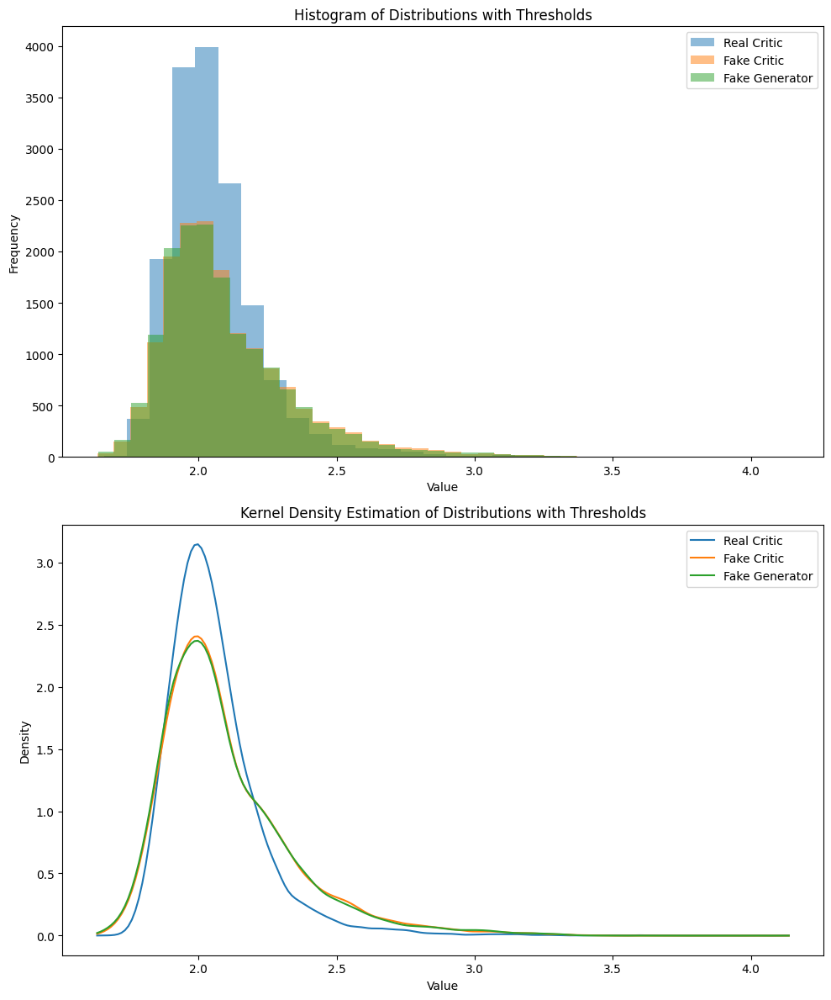

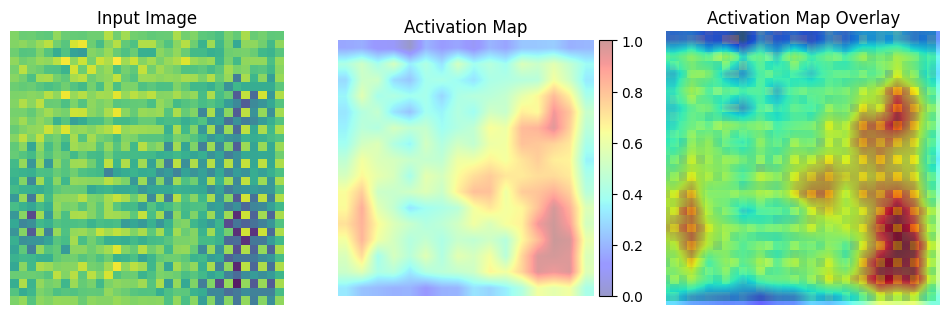

	MNSE Score: 1.0093934403525457
Batch [0/63] -  Critic loss:  0.2688552538553874 - generator loss:  -2.029907464981079
Batch [21/63] -  Critic loss:  0.18611947458350298 - generator loss:  -2.0094580108469184
Batch [42/63] -  Critic loss:  0.16598767319390942 - generator loss:  -1.9687139461206835
	Epoch 5 - critic loss: 0.144491808597373 - generator loss: -1.9465547270245023


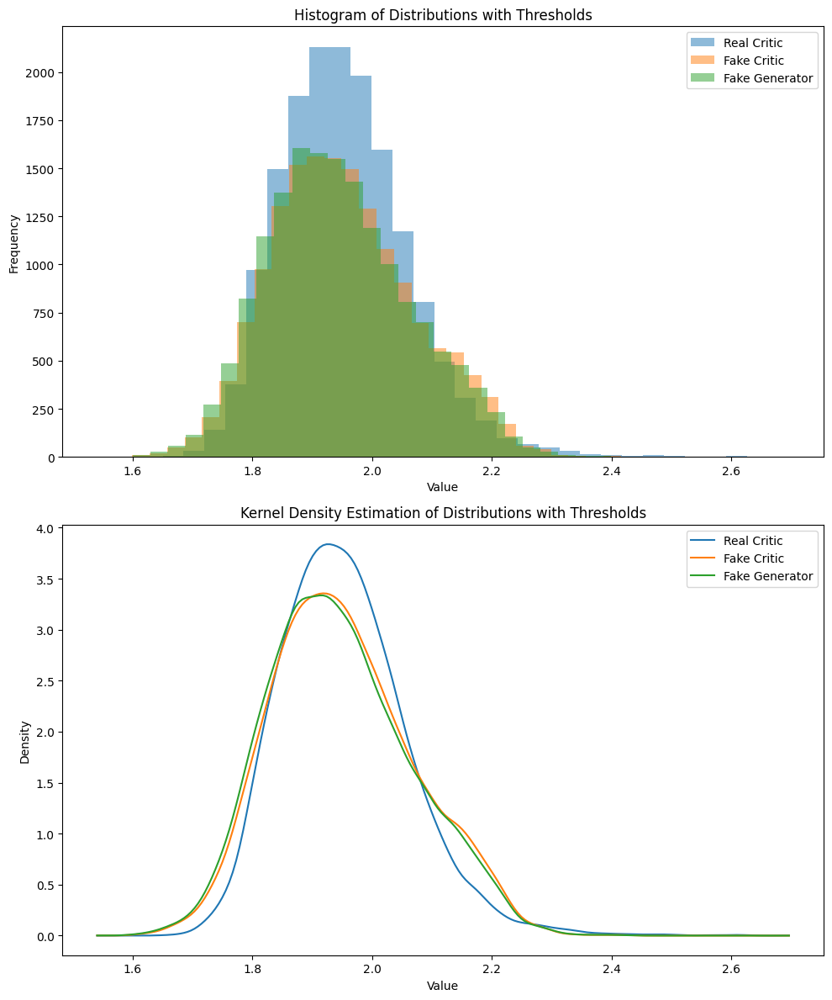

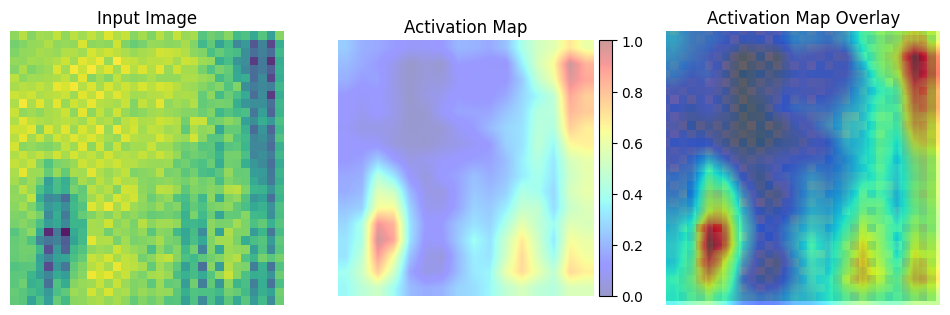

	MNSE Score: 0.9847078957254924
Batch [0/63] -  Critic loss:  0.19648654262224832 - generator loss:  -1.9274399280548096
Batch [21/63] -  Critic loss:  0.11029259025147466 - generator loss:  -1.9306980696591465
Batch [42/63] -  Critic loss:  0.08907868355050567 - generator loss:  -1.941169530846352
	Epoch 6 - critic loss: 0.07913811895109357 - generator loss: -1.9614600605434842


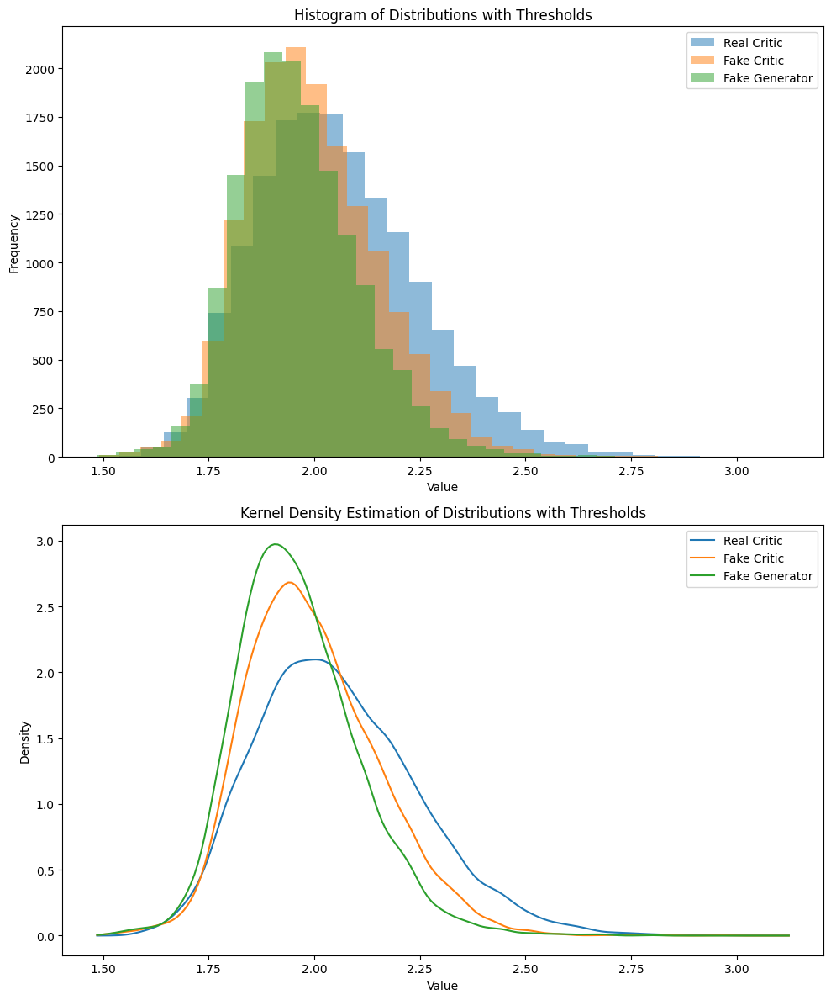

<ipython-input-27-b68e3bf66b4b>:63: RuntimeWarning: invalid value encountered in divide
  activation_map = (activation_map - activation_map.min()) / (


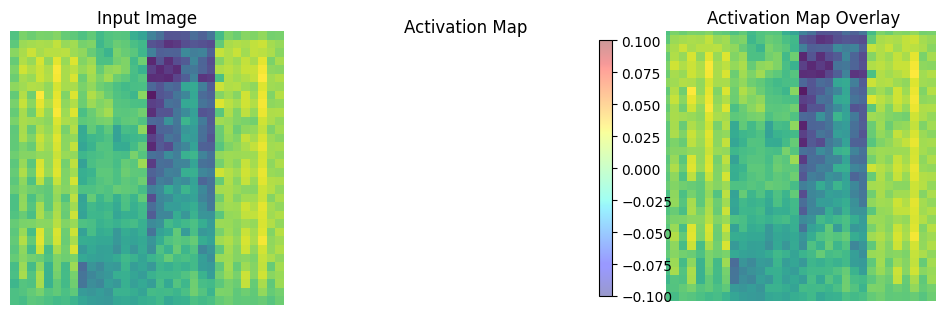

	MNSE Score: 0.9779361741883414
Batch [0/63] -  Critic loss:  0.07420494655768077 - generator loss:  -1.9317359924316406
Batch [21/63] -  Critic loss:  0.1130145245203466 - generator loss:  -1.9498958858576687
Batch [42/63] -  Critic loss:  0.14726289032503612 - generator loss:  -2.0371256623157237
	Epoch 7 - critic loss: 0.13843737495323968 - generator loss: -2.0583171068675936


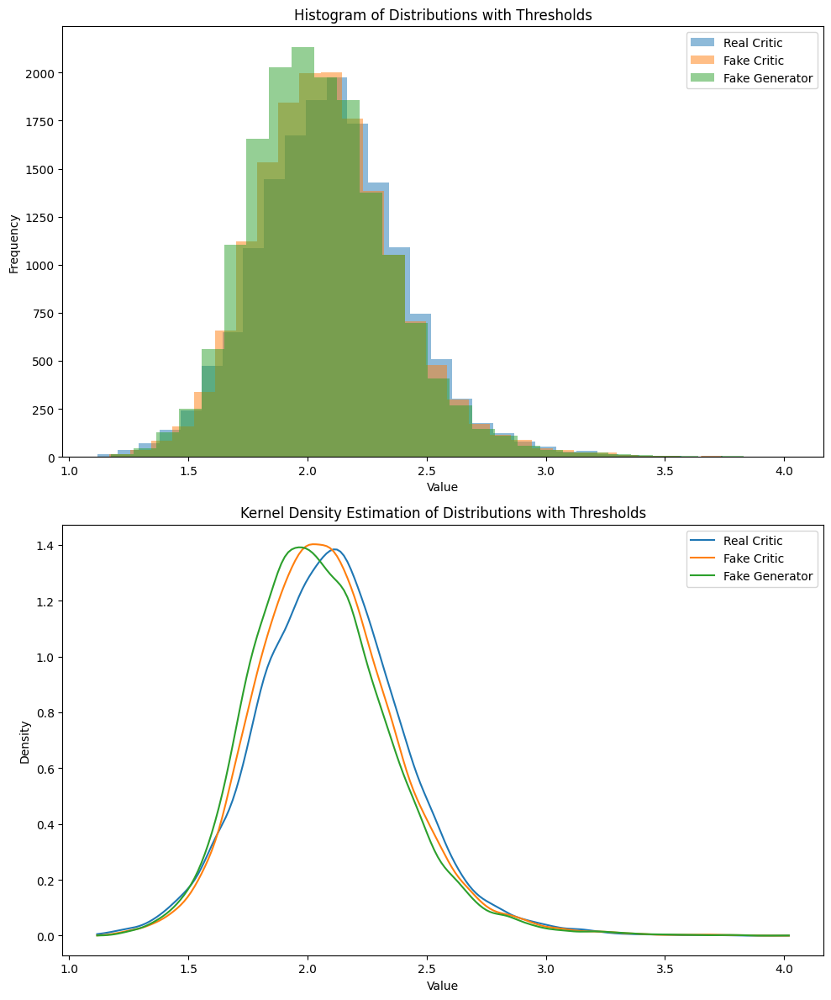

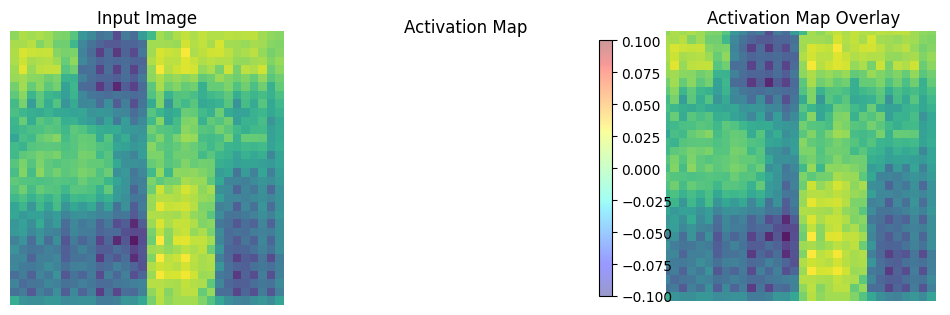

	MNSE Score: 0.9703473637974451
Batch [0/63] -  Critic loss:  0.07376411308844884 - generator loss:  -2.154736280441284
Batch [21/63] -  Critic loss:  0.0714404158519976 - generator loss:  -2.114315986633301
Batch [42/63] -  Critic loss:  0.08216363208931546 - generator loss:  -2.1236571212147557
	Epoch 8 - critic loss: 0.08508801097592347 - generator loss: -2.1566898747095986
Batch [0/63] -  Critic loss:  0.12266731510559718 - generator loss:  -2.290972948074341
Batch [21/63] -  Critic loss:  0.06937184467008618 - generator loss:  -2.3248492912812666
Batch [42/63] -  Critic loss:  0.06224933122248612 - generator loss:  -2.3451078825218734
	Epoch 9 - critic loss: 0.050404730395822925 - generator loss: -2.3249823290204246
Batch [0/63] -  Critic loss:  0.035557751854260765 - generator loss:  -2.2783212661743164
Batch [21/63] -  Critic loss:  -0.023492902968869068 - generator loss:  -2.2293820706280796
Batch [42/63] -  Critic loss:  -0.04791720540717591 - generator loss:  -2.1820800637089

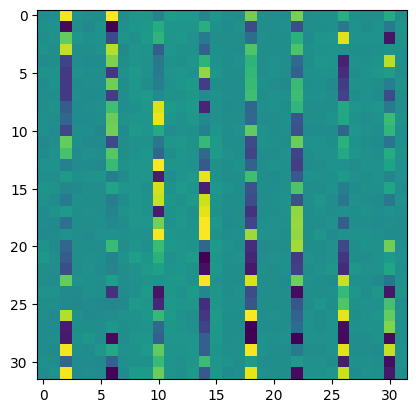

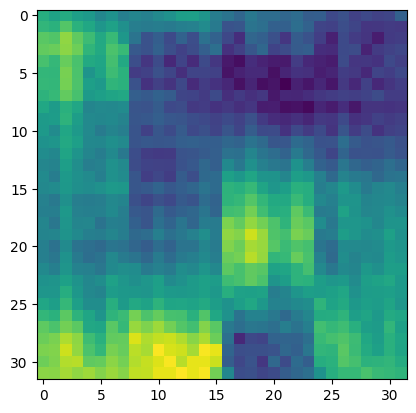

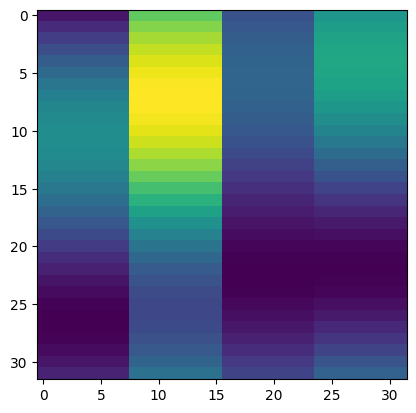

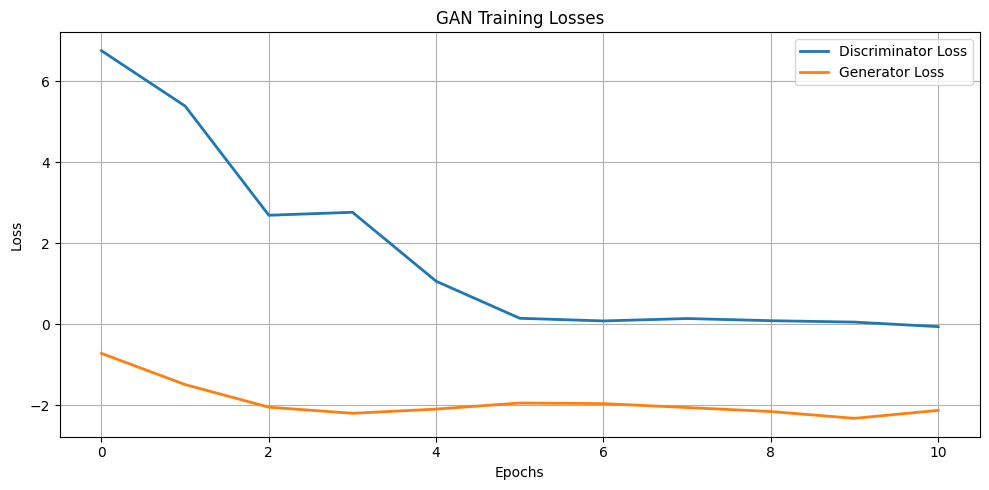

Batch [0/63] -  Critic loss:  -0.13738670696814856 - generator loss:  -1.9398653507232666
Batch [21/63] -  Critic loss:  -0.1733501712706956 - generator loss:  -1.8363067236813633
Batch [42/63] -  Critic loss:  -0.19350768487120784 - generator loss:  -1.7306523572566896
	Epoch 11 - critic loss: -0.23151990467751474 - generator loss: -1.6842583436814567
Batch [0/63] -  Critic loss:  -0.26685043176015216 - generator loss:  -1.6162439584732056
Batch [21/63] -  Critic loss:  -0.3951867392117326 - generator loss:  -1.4381622834639116
Batch [42/63] -  Critic loss:  -0.45036976351294417 - generator loss:  -1.3590994047564129
	Epoch 12 - critic loss: -0.5304163259173199 - generator loss: -1.362692605881464
Batch [0/63] -  Critic loss:  -0.6819449464480082 - generator loss:  -1.305975079536438
Batch [21/63] -  Critic loss:  -0.7541829189567856 - generator loss:  -1.5329316691918806
Batch [42/63] -  Critic loss:  -0.8660175229689874 - generator loss:  -1.7393637951030287
	Epoch 13 - critic loss:

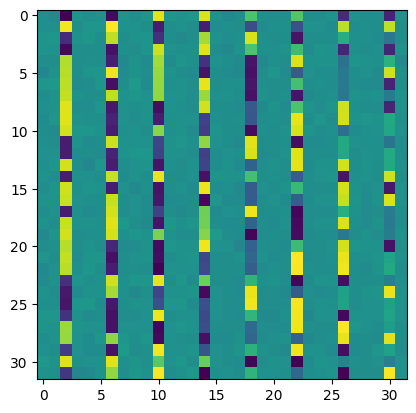

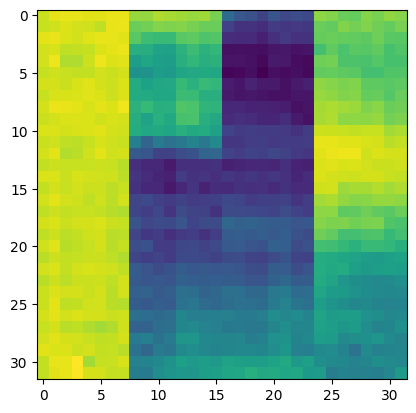

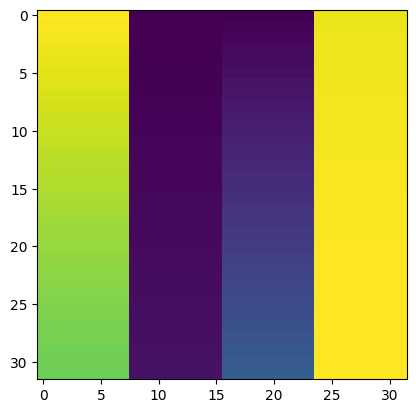

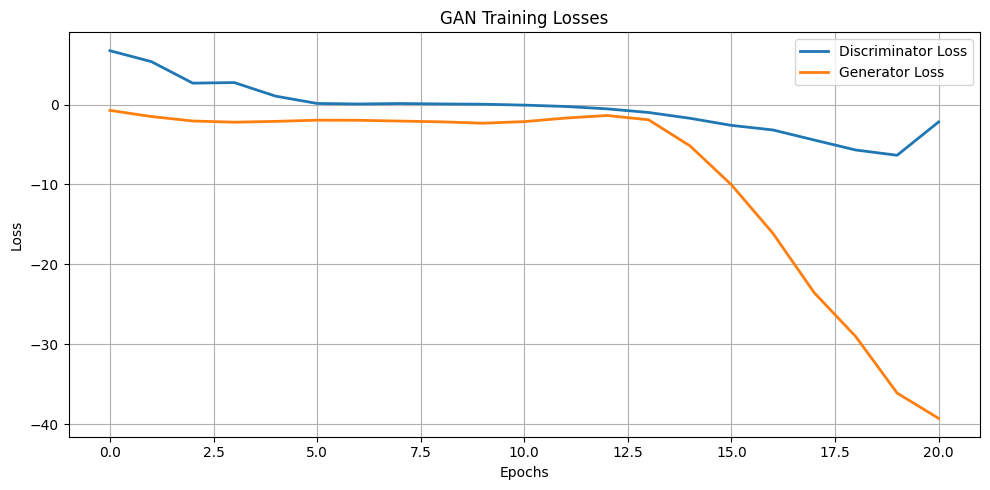

Batch [0/63] -  Critic loss:  -1.9888513882954915 - generator loss:  -43.18391418457031
Batch [21/63] -  Critic loss:  -3.006700494072654 - generator loss:  -44.32871506430886
Batch [42/63] -  Critic loss:  -3.5652435565179634 - generator loss:  -45.2432879070903
	Epoch 21 - critic loss: -4.109414130922348 - generator loss: -46.38987289913117
Batch [0/63] -  Critic loss:  -5.611591974894206 - generator loss:  -49.15899658203125
Batch [21/63] -  Critic loss:  -5.9440085761474855 - generator loss:  -51.50848041881215
Batch [42/63] -  Critic loss:  -6.320774371309799 - generator loss:  -52.241510790447855
	Epoch 22 - critic loss: -6.423559067425905 - generator loss: -52.644916473873074
Batch [0/63] -  Critic loss:  -0.9253091017405192 - generator loss:  -50.68585968017578
Batch [21/63] -  Critic loss:  -4.2523984078204995 - generator loss:  -54.44496674971147
Batch [42/63] -  Critic loss:  -5.7363777345465135 - generator loss:  -56.16907545577648
	Epoch 23 - critic loss: -6.65384354225542

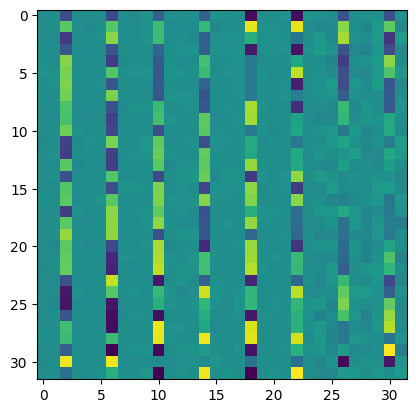

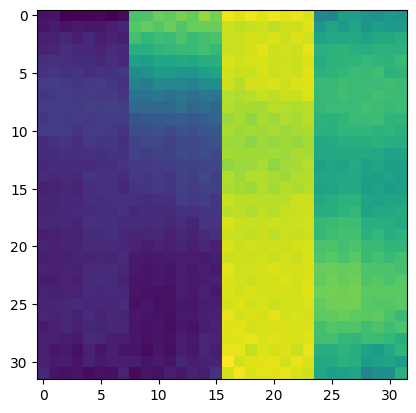

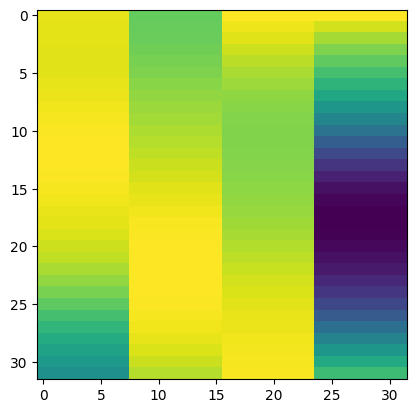

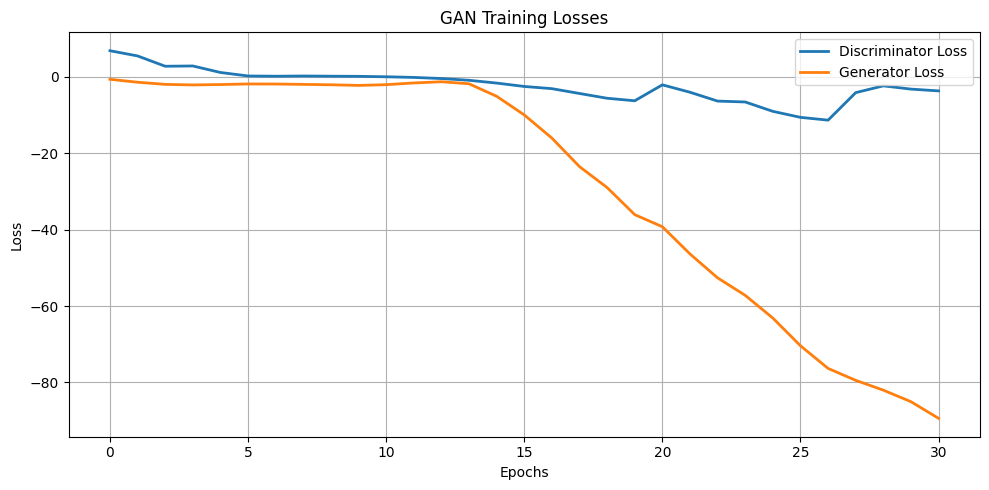

Batch [0/63] -  Critic loss:  -4.076530536015828 - generator loss:  -91.09153747558594
Batch [21/63] -  Critic loss:  -4.0022166353283515 - generator loss:  -92.55002108487216
Batch [42/63] -  Critic loss:  -4.095763280410177 - generator loss:  -93.13041527326718
	Epoch 31 - critic loss: -4.1795946145183835 - generator loss: -93.83814469594805
Batch [0/63] -  Critic loss:  -4.2542792956034345 - generator loss:  -96.81346130371094
Batch [21/63] -  Critic loss:  -4.577828540946499 - generator loss:  -97.43890623612837
Batch [42/63] -  Critic loss:  -4.618905474049176 - generator loss:  -98.46991250681323
	Epoch 32 - critic loss: -4.723150330245809 - generator loss: -99.13914271763393
Batch [0/63] -  Critic loss:  -4.681462128957112 - generator loss:  -100.96249389648438
Batch [21/63] -  Critic loss:  -4.9852627335172714 - generator loss:  -101.11208724975586
Batch [42/63] -  Critic loss:  -5.166972982791041 - generator loss:  -101.75714519412018
	Epoch 33 - critic loss: -5.10352183145189

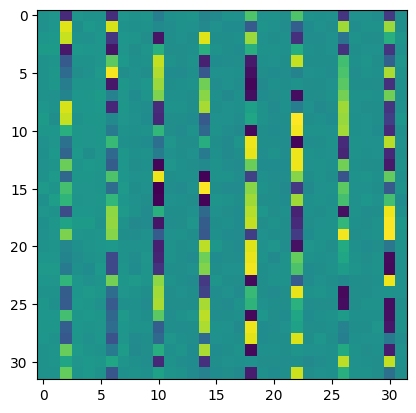

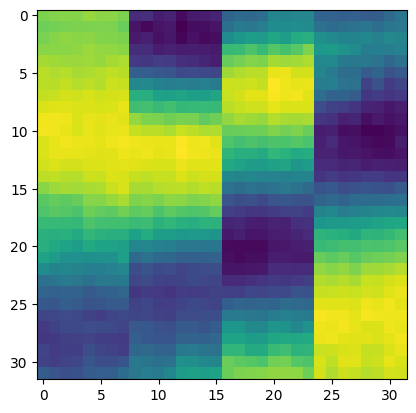

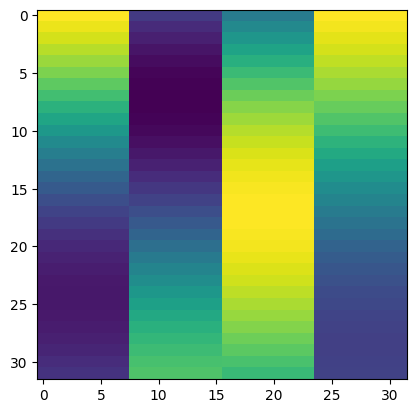

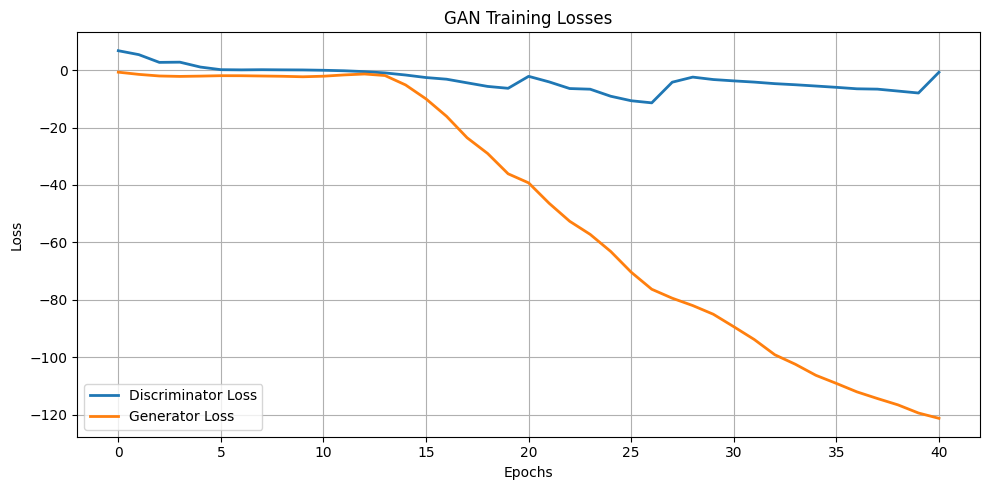

Batch [0/63] -  Critic loss:  -1.2923370997111003 - generator loss:  -126.43977355957031
Batch [21/63] -  Critic loss:  -1.4334250255064531 - generator loss:  -126.17293028397994
Batch [42/63] -  Critic loss:  -1.6006346987199416 - generator loss:  -126.55073795762173
	Epoch 41 - critic loss: -1.7870267427787585 - generator loss: -127.06029437837147
Batch [0/63] -  Critic loss:  -1.822009523709615 - generator loss:  -127.105224609375
Batch [21/63] -  Critic loss:  -2.549557602766788 - generator loss:  -128.4467034773393
Batch [42/63] -  Critic loss:  -2.8031118396640746 - generator loss:  -129.015546044638
	Epoch 42 - critic loss: -2.9597152629226597 - generator loss: -129.24022819882347
Batch [0/63] -  Critic loss:  -3.687842925389608 - generator loss:  -129.8939971923828
Batch [21/63] -  Critic loss:  -4.2289480259924215 - generator loss:  -130.71844274347478
Batch [42/63] -  Critic loss:  -4.3156673963679815 - generator loss:  -130.83063347395077
	Epoch 43 - critic loss: -4.37148649

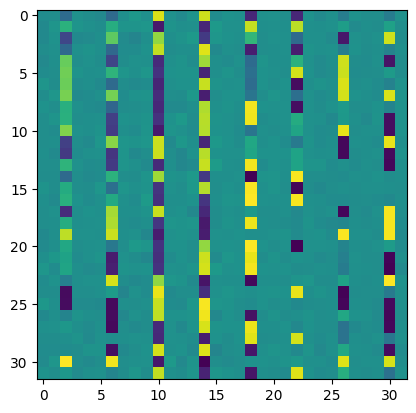

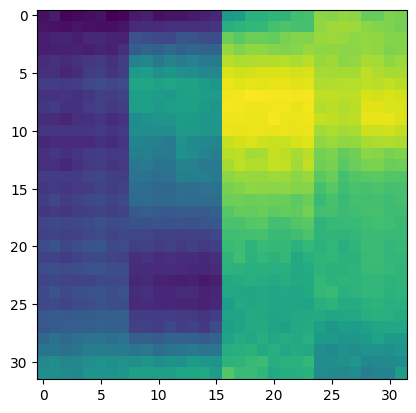

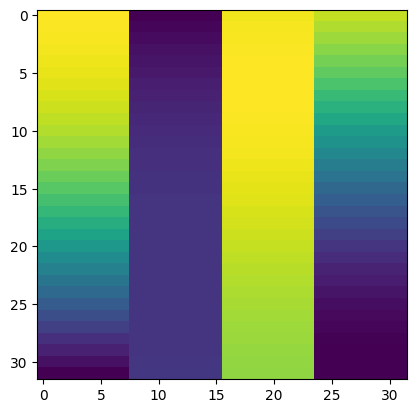

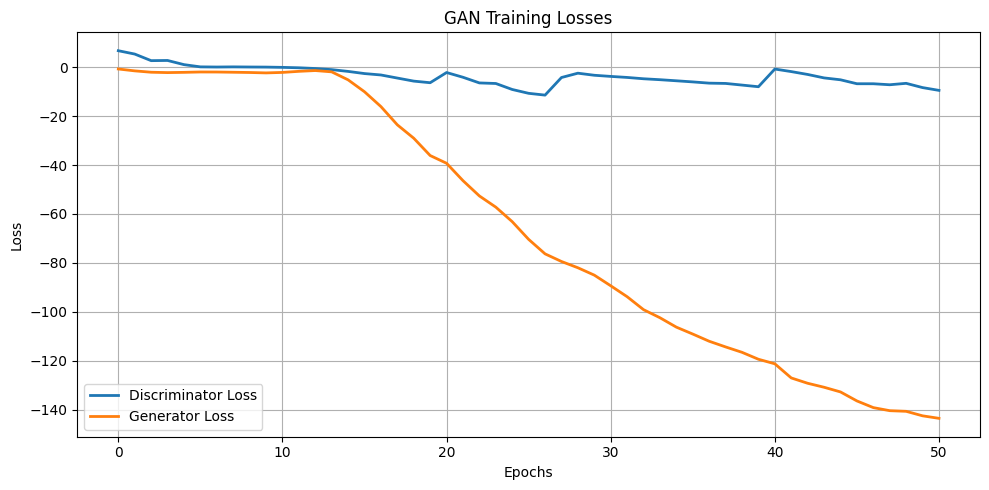

Batch [0/63] -  Critic loss:  -6.380743066469829 - generator loss:  -139.8767547607422
Batch [21/63] -  Critic loss:  -9.173082569331832 - generator loss:  -142.9213541204279
Batch [42/63] -  Critic loss:  -6.995202969673068 - generator loss:  -141.87937643361647
	Epoch 51 - critic loss: -7.930252327174737 - generator loss: -142.8298875112382
Batch [0/63] -  Critic loss:  -6.965524355570476 - generator loss:  -145.63595581054688
Batch [21/63] -  Critic loss:  -10.874392630475942 - generator loss:  -144.27159396084872
Batch [42/63] -  Critic loss:  -10.861261675524156 - generator loss:  -145.78529286939045
	Epoch 52 - critic loss: -10.709353450114133 - generator loss: -146.0949220203218
Batch [0/63] -  Critic loss:  -14.666059811909994 - generator loss:  -145.4056396484375
Batch [21/63] -  Critic loss:  -11.981899216319574 - generator loss:  -149.90595384077594
Batch [42/63] -  Critic loss:  -10.883082725280941 - generator loss:  -149.90314749784247
	Epoch 53 - critic loss: -10.37125787

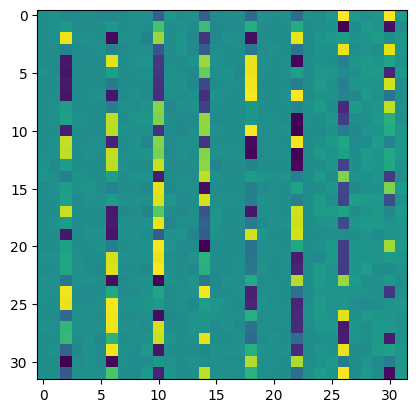

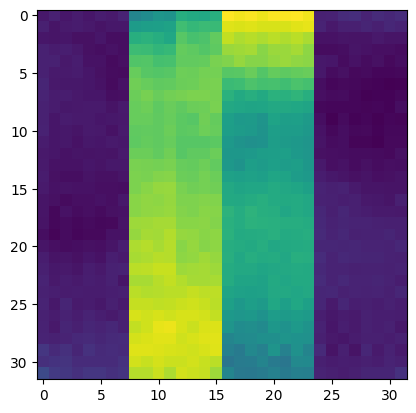

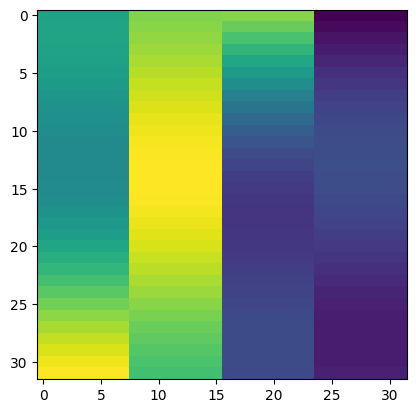

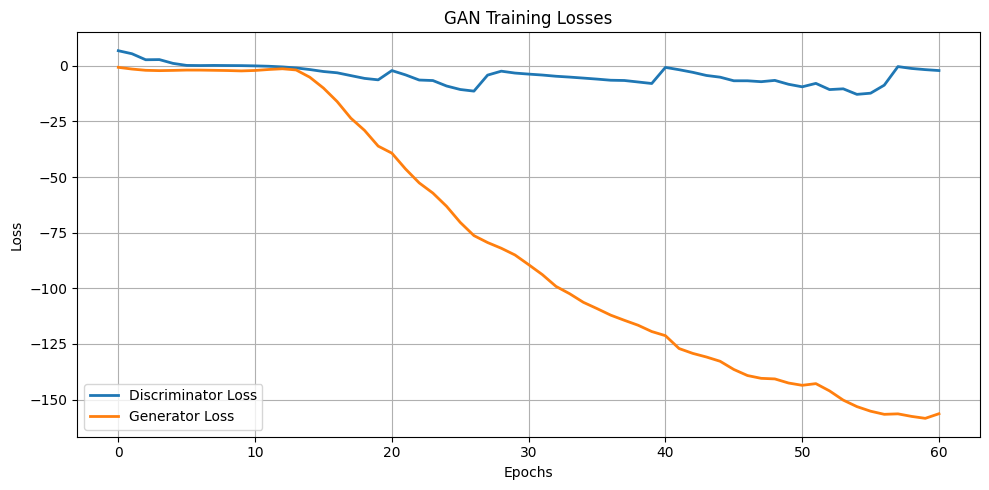

Batch [0/63] -  Critic loss:  -2.4268571535746255 - generator loss:  -154.36581420898438
Batch [21/63] -  Critic loss:  -2.353873964511987 - generator loss:  -155.0502069646662
Batch [42/63] -  Critic loss:  -2.4194643765456916 - generator loss:  -154.83346735044967
	Epoch 61 - critic loss: -2.5000136573478655 - generator loss: -154.65316651359436
Batch [0/63] -  Critic loss:  -2.4411396980285645 - generator loss:  -152.22132873535156
Batch [21/63] -  Critic loss:  -2.7953684059056365 - generator loss:  -153.0248128717596
Batch [42/63] -  Critic loss:  -2.843945746273958 - generator loss:  -152.06934480888899
	Epoch 62 - critic loss: -2.9236549066488076 - generator loss: -151.41067722865515
Batch [0/63] -  Critic loss:  -3.488897720972697 - generator loss:  -149.6187744140625
Batch [21/63] -  Critic loss:  -3.2796787348660557 - generator loss:  -149.18927279385653
Batch [42/63] -  Critic loss:  -3.5827705324158203 - generator loss:  -149.40084342069403
	Epoch 63 - critic loss: -3.72760

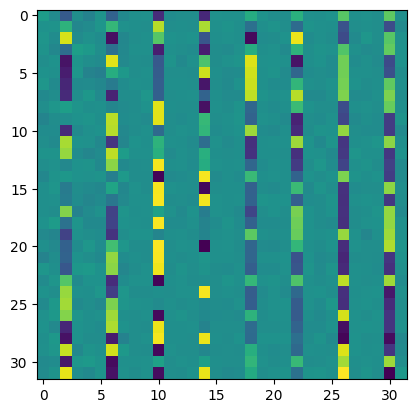

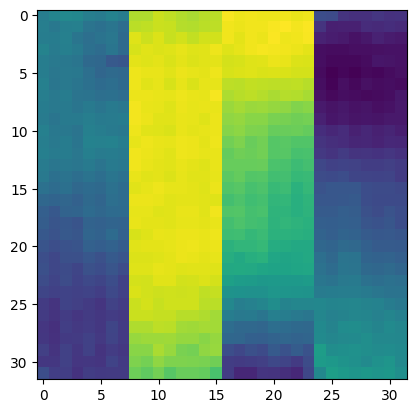

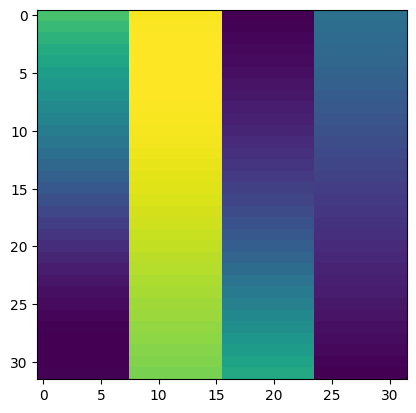

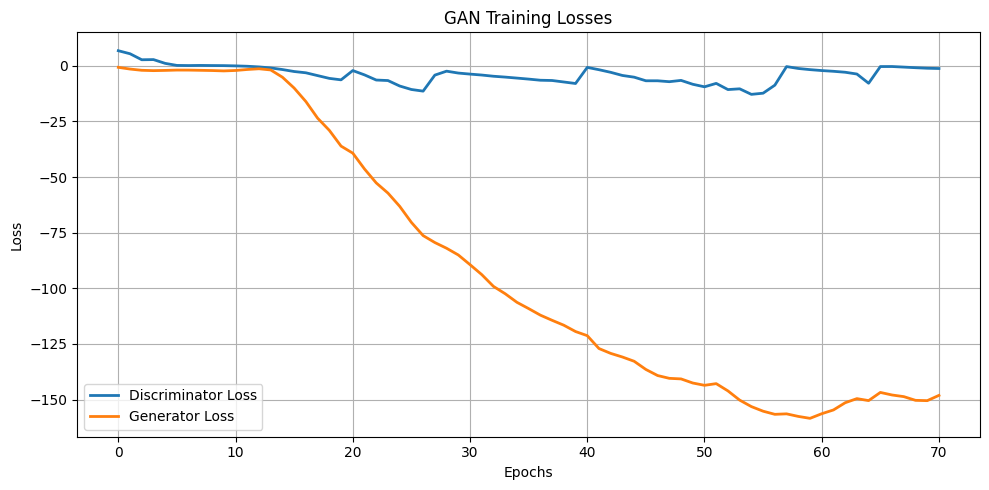

Batch [0/63] -  Critic loss:  -1.3391318321228027 - generator loss:  -147.1580810546875
Batch [21/63] -  Critic loss:  -1.3932227790355685 - generator loss:  -145.35021209716797
Batch [42/63] -  Critic loss:  -1.3823388292807945 - generator loss:  -144.58906058377997
	Epoch 71 - critic loss: -1.3567132200828937 - generator loss: -143.6107688782707
Batch [0/63] -  Critic loss:  -1.5152675708134968 - generator loss:  -141.25875854492188
Batch [21/63] -  Critic loss:  -1.3748309223940878 - generator loss:  -139.36332980069247
Batch [42/63] -  Critic loss:  -1.4194404233333677 - generator loss:  -138.5092695369277
	Epoch 72 - critic loss: -1.4559309476267093 - generator loss: -137.95897880433097
Batch [0/63] -  Critic loss:  -1.587441126505534 - generator loss:  -135.37283325195312
Batch [21/63] -  Critic loss:  -1.516164450934439 - generator loss:  -134.8859266801314
Batch [42/63] -  Critic loss:  -1.5321793546972347 - generator loss:  -134.10161750261173
	Epoch 73 - critic loss: -1.54360

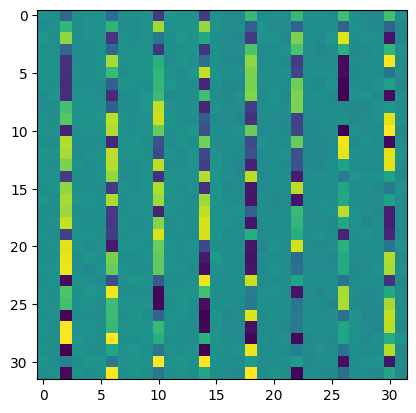

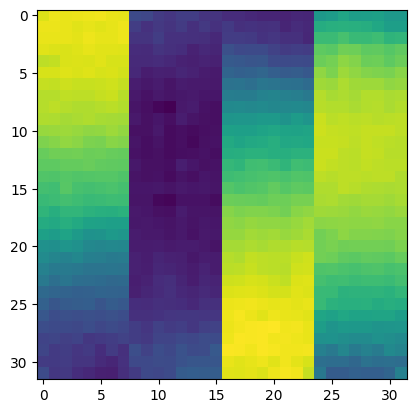

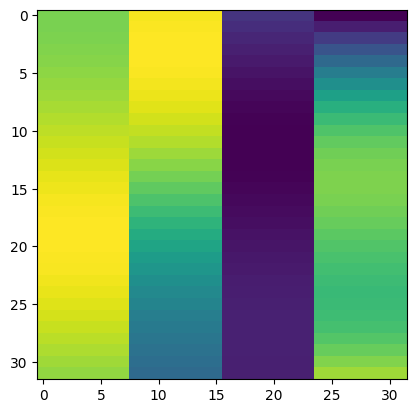

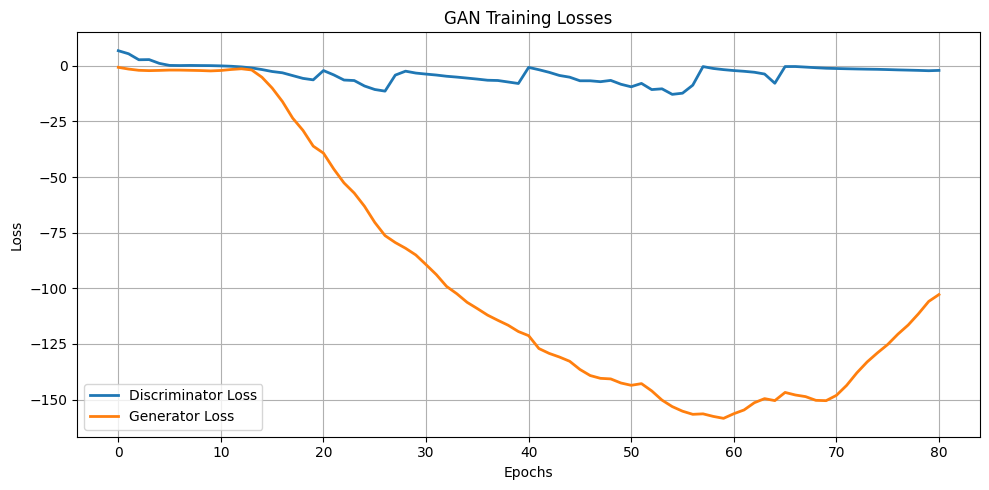

Batch [0/63] -  Critic loss:  -2.6143649419148765 - generator loss:  -100.19673919677734
Batch [21/63] -  Critic loss:  -2.393686418280457 - generator loss:  -100.42738827792081
Batch [42/63] -  Critic loss:  -2.4697330704955163 - generator loss:  -100.09434668962345
	Epoch 81 - critic loss: -2.5687541554844575 - generator loss: -99.68832833426339
Batch [0/63] -  Critic loss:  -2.929940700531006 - generator loss:  -98.21368408203125
Batch [21/63] -  Critic loss:  -2.8910002708435054 - generator loss:  -98.37998893044211
Batch [42/63] -  Critic loss:  -2.728236317172531 - generator loss:  -98.36874123506767
	Epoch 82 - critic loss: -2.7928766983526723 - generator loss: -98.18184867737786
Batch [0/63] -  Critic loss:  -2.474205414454142 - generator loss:  -97.70248413085938
Batch [21/63] -  Critic loss:  -2.8896481448953795 - generator loss:  -97.60598546808416
Batch [42/63] -  Critic loss:  -2.205719215463297 - generator loss:  -97.8730713600336
	Epoch 83 - critic loss: -2.4601194738710

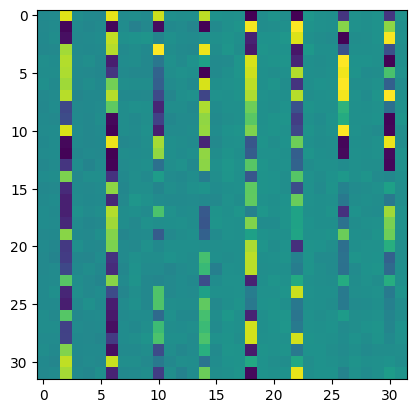

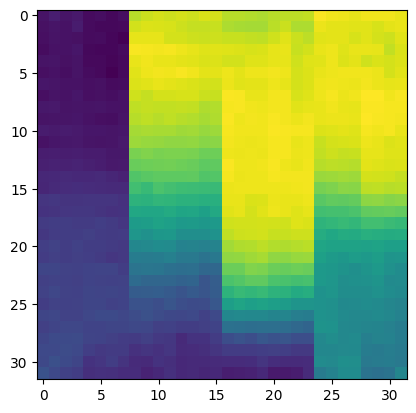

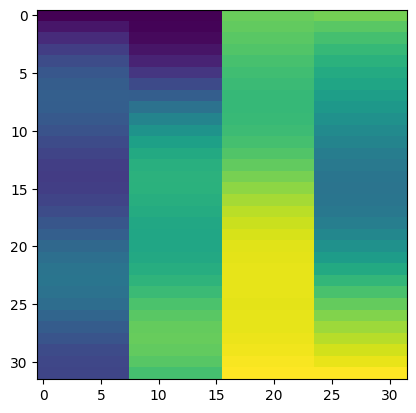

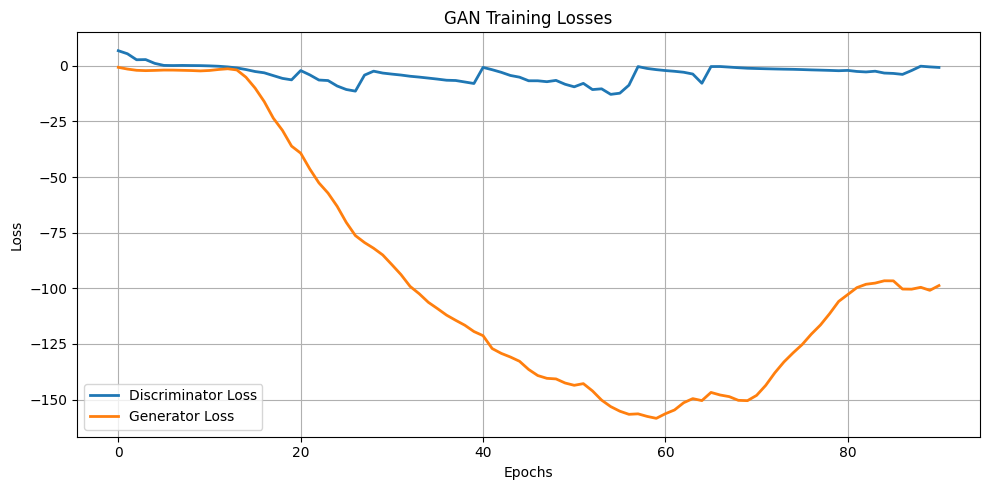

Batch [0/63] -  Critic loss:  -0.6123132109642029 - generator loss:  -97.17459869384766
Batch [21/63] -  Critic loss:  -0.8797296226927728 - generator loss:  -96.98986781727184
Batch [42/63] -  Critic loss:  -0.939086349204529 - generator loss:  -96.8900375366211
	Epoch 91 - critic loss: -0.9894963167016466 - generator loss: -96.8642807006836
Batch [0/63] -  Critic loss:  -1.4210328658421834 - generator loss:  -97.14144134521484
Batch [21/63] -  Critic loss:  -1.201331593773582 - generator loss:  -97.94933423128995
Batch [42/63] -  Critic loss:  -1.1811802934768592 - generator loss:  -97.93663823327353
	Epoch 92 - critic loss: -1.2883465345259066 - generator loss: -97.58211505223834
Batch [0/63] -  Critic loss:  -1.0211182832717896 - generator loss:  -95.53030395507812
Batch [21/63] -  Critic loss:  -1.5443776015079385 - generator loss:  -95.83160747181286
Batch [42/63] -  Critic loss:  -1.718807673269464 - generator loss:  -95.39853952097339
	Epoch 93 - critic loss: -1.929582689805005

In [ ]:
channel_est_wgan_gp()

## WGAN_GP + L2 Loss

In [ ]:
generator = Generator((32 * 32 * 2)).to(device)
critic = Critic().to(device)

# Initialize weights
generator = generator.apply(weights_init)
critic = critic.apply(weights_init)

# Optimizer is Adam help converge faster and more stable
g_opt = torch.optim.Adam(generator.parameters(), lr=lr, betas=betas)
c_opt = torch.optim.Adam(critic.parameters(), lr=lr, betas=betas)

skew_cal = SkewCalculator(device)

In [ ]:
def channel_est_wgan_gp_rec_loss():
    save_results = "channel_est_wgan_gp_rec_loss"
    min_nmse_scores = 10000000
    total_g_losses = []
    total_c_losses = []
    total_nmse_scores = []
    total_skewness = []
    for epoch in range(n_epochs):
        # Training
        g_losses = 0
        c_losses = 0
        nmse_scores = 0
        g_skewness = 0
        if epoch == 0:
            c_lambda_2 = 0.0
        else:
            c_lambda_2 = 0.1
        total_critic_reals = []
        total_critic_fakes = []
        total_generator_fakes = []

        generator.train()
        critic.train()
        for batch_index, (real, label) in enumerate(train_dataset):

            real = real.to(device)
            label = label.to(device)
            cur_batch_size = real.shape[0]
            #################
            # Update critic #
            #################
            total_c_repeat_losses = 0
            critic_reals = 0
            critic_fakes = 0
            for _ in range(critic_repeats):
                c_opt.zero_grad()

                fake = generator(label)

                # critic loss
                critic_real = critic(real)
                critic_fake = critic(fake)

                c_repeat_loss = - (torch.mean(critic_real) - torch.mean(critic_fake))

                # gp loss
                gp_loss = gradient_penalty_loss(critic=critic, real=real, fake=fake)


                # total critic loss
                total_c_repeat_loss = c_repeat_loss + c_lambda * gp_loss

                # Update gradients
                total_c_repeat_loss.backward(retain_graph=True)

                # Update optimizer
                c_opt.step()

                # Keep track of the average critic loss in this batch
                critic_reals += critic_real.detach().cpu()
                critic_fakes += critic_fake.detach().cpu()

                total_c_repeat_losses += total_c_repeat_loss.detach().cpu().item()

            total_critic_reals.append((critic_reals / critic_repeats).view(-1))
            total_critic_fakes.append((critic_fakes / critic_repeats).view(-1))
            c_losses += total_c_repeat_losses / critic_repeats

            ####################
            # Update generator #
            ####################
            g_opt.zero_grad()

            # get noise
            fake_2 = generator(label)

            critic_fake_2 = critic(fake_2)

            skew_loss_2 = l2_loss(skew_cal(real.view(real.size(0), -1)),skew_cal(fake_2.view(fake_2.size(0), -1)))

            g_loss = - torch.mean(critic_fake_2) + l2_loss(fake_2, real)


            # Update gradients
            g_loss.backward()

            # Update the weights
            g_opt.step()

            g_losses += g_loss.detach().cpu().item()
            total_generator_fakes.append(critic_fake_2.detach().cpu().view(-1))
            g_skewness += skew_loss_2.detach().cpu().item()

            if batch_index % (len(train_dataset) // 3) == 0:
                print(f"Batch [{batch_index}/{len(train_dataset)}] - ",  "Critic loss: ",  c_losses / (batch_index + 1), "- generator loss: ", g_losses / (batch_index + 1))

            nmse_score = nmse(
                pred=fake.permute(0, 2, 3, 1).detach().cpu(),
                target=real.permute(0, 2, 3, 1).detach().cpu(),
            )
            nmse_scores += nmse_score

        total_nmse_scores.append(nmse_scores / len(train_dataset))
        total_c_losses.append(c_losses / len(train_dataset))
        total_g_losses.append(g_losses / len(train_dataset))
        total_skewness.append(g_skewness / len(train_dataset))

        print(f"\tEpoch {epoch} - critic loss: {total_c_losses[-1]} - generator loss: {total_g_losses[-1]}")


        generator.eval()
        critic.eval()
        # Visualize Test Dataset
        with torch.no_grad():
            for real, label in eval_dataset:
                cur_batch_size = real.shape[0]
                real = real.to(device)
                label = label.to(device)
                fake = generator(label)
                break
        if epoch in range(0, n_epochs, int(n_epochs // 10)):
            show_tensor_images(label.view(-1, 2, 32, 32)[0,0,:,:].T)
            show_tensor_images(fake[0,0,:,:])
            show_tensor_images(real[0,0,:,:])
            show_loss_images(total_c_losses, total_g_losses)

        # if epoch in range(0, n_epochs, int(n_epochs // 5)) or (epoch == (n_epochs-1)):
        #     # GradCam
        #     conv_layer = critic.critic[-3][0]
        #     grad_cam = GradCam(critic.eval(), conv_layer)
        #     grad_cam_1 = GradCam(critic.eval(), critic.critic[-2][0])
        #     grad_cam_2 = GradCam(critic.eval(), critic.critic[-1][0])
        #     # eigen_cam = EigenCam(critic.eval(), conv_layer)
        #     # score_cam = ScoreCam(critic.eval(), conv_layer)
        #     grad_cam.visualize_cam(real, save_path=f"results/dam/{save_results}/grad_cam_real_conv_1_epoch{epoch}.png")
        #     grad_cam.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_1_epoch{epoch}.png")
        #     grad_cam_1.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_2_epoch{epoch}.png")
        #     grad_cam_2.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_3_epoch{epoch}.png")
        #     # eigen_cam.visualize_cam(real, save_path=f"results/dam/{save_results}/eigen_cam_real_conv_1_epoch{epoch}.png")
        #     # score_cam.visualize_cam(real, save_path=f"results/dam/{save_results}/score_cam_real_conv_1_epoch{epoch}.png")


        if min_nmse_scores > min(total_nmse_scores):
            min_nmse_scores = min(total_nmse_scores)
            plot_generated_image(
                fake[0,0,:,:],
                test_input=label.view(-1, 2, 32, 32)[0,0,:,:].T,
                tar=real[0,0,:,:],
                prefix=save_results,
            )

            plot_distribution(
                np.array(torch.cat(total_critic_reals)),
                np.array(torch.cat(total_critic_fakes)),
                np.array(torch.cat(total_generator_fakes)),
                save_path=f"results/dis/{save_results}/dis_{epoch}.png"
            )
            save_checkpoint(generator, f"results/checkpoint/{save_results}/g_model.pt")
            save_checkpoint(discriminator, f"results/checkpoint/{save_results}/d_model.pt")

            conv_layer = critic.critic[-3]
            grad_cam = GradCam(critic, conv_layer)
            grad_cam.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_1_epoch{epoch}.png")

            print(f"\tMNSE Score: {min_nmse_scores}")

        plot_nmse_func(
            total_nmse_scores,
            range(epoch + 1),
            img_path=f"results/nmse/{save_results}/nmse.png",
        )
        plot_loss_func(
            total_c_losses,
            total_g_losses,
            range(epoch + 1),
            img_path=f"results/loss/{save_results}/loss.png",
        )

        plot_skewness_func(
            total_skewness,
            range(epoch + 1),
            img_path=f"results/skewness/{save_results}/skewness.png",
        )

    save_npy(f"results/nmse/{save_results}/nmse_scores.npy", np.array(total_nmse_scores))
    save_npy(f"results/loss/{save_results}/losses_d.npy", np.array(total_c_losses))
    save_npy(f"results/loss/{save_results}/losses_g.npy", np.array(total_g_losses))


Batch [0/63] -  Critic loss:  9.86612606048584 - generator loss:  494.3697204589844
Batch [21/63] -  Critic loss:  6.042692455378447 - generator loss:  455.01649475097656
Batch [42/63] -  Critic loss:  4.571608540623687 - generator loss:  380.716103132381
	Epoch 0 - critic loss: 3.7489640416291654 - generator loss: 331.6221567789714


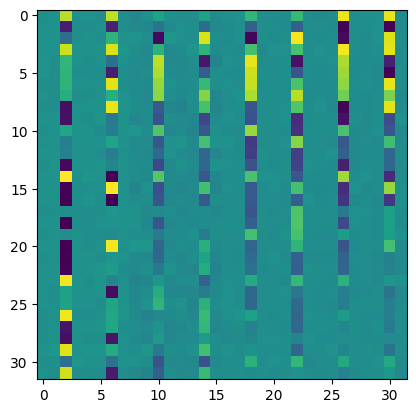

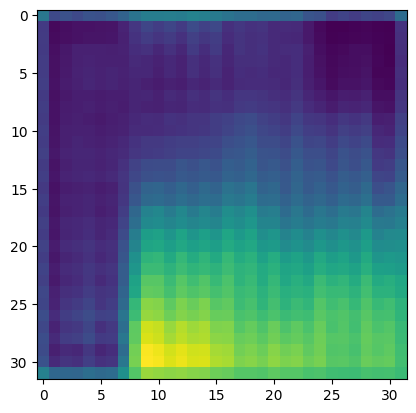

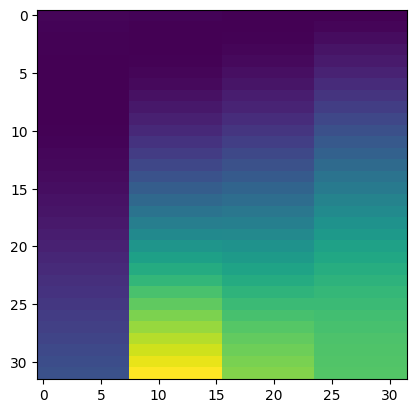

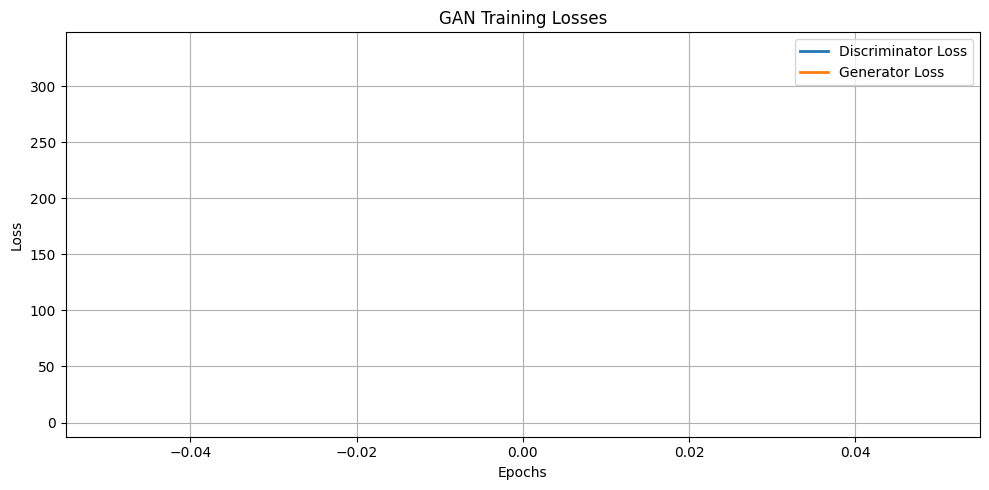

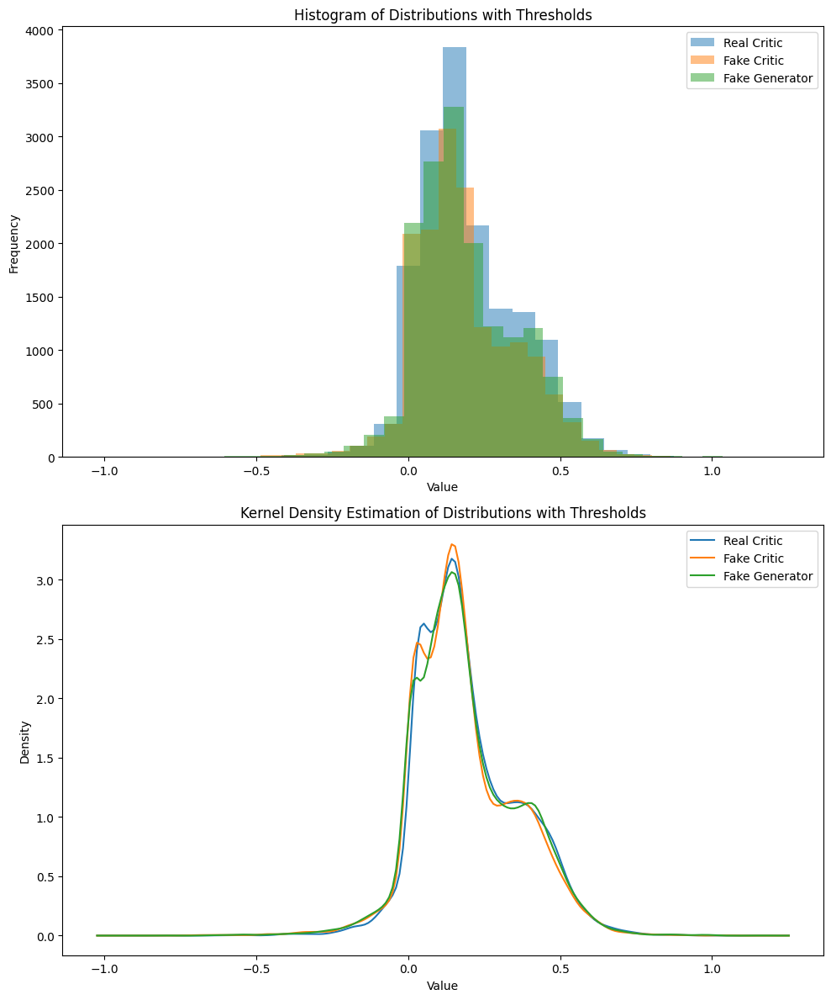

<ipython-input-27-b68e3bf66b4b>:63: RuntimeWarning: invalid value encountered in divide
  activation_map = (activation_map - activation_map.min()) / (


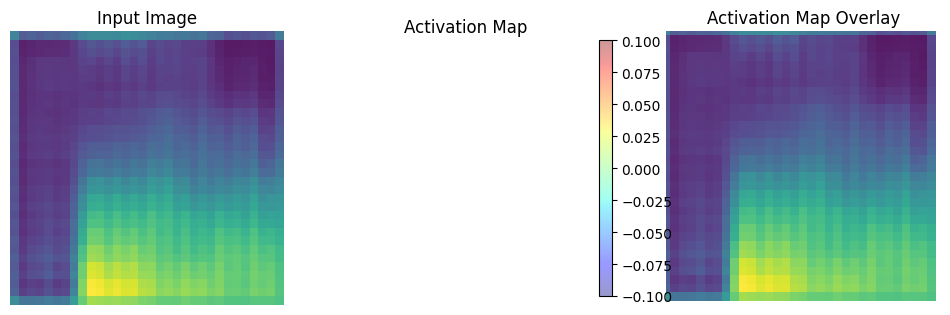

	MNSE Score: 0.5060646252499686
Batch [0/63] -  Critic loss:  0.9287241299947103 - generator loss:  194.44480895996094
Batch [21/63] -  Critic loss:  0.9414109447688769 - generator loss:  175.18000932173297
Batch [42/63] -  Critic loss:  0.673546877826831 - generator loss:  161.47033584949583
	Epoch 1 - critic loss: 0.542299775929047 - generator loss: 151.95989324176122


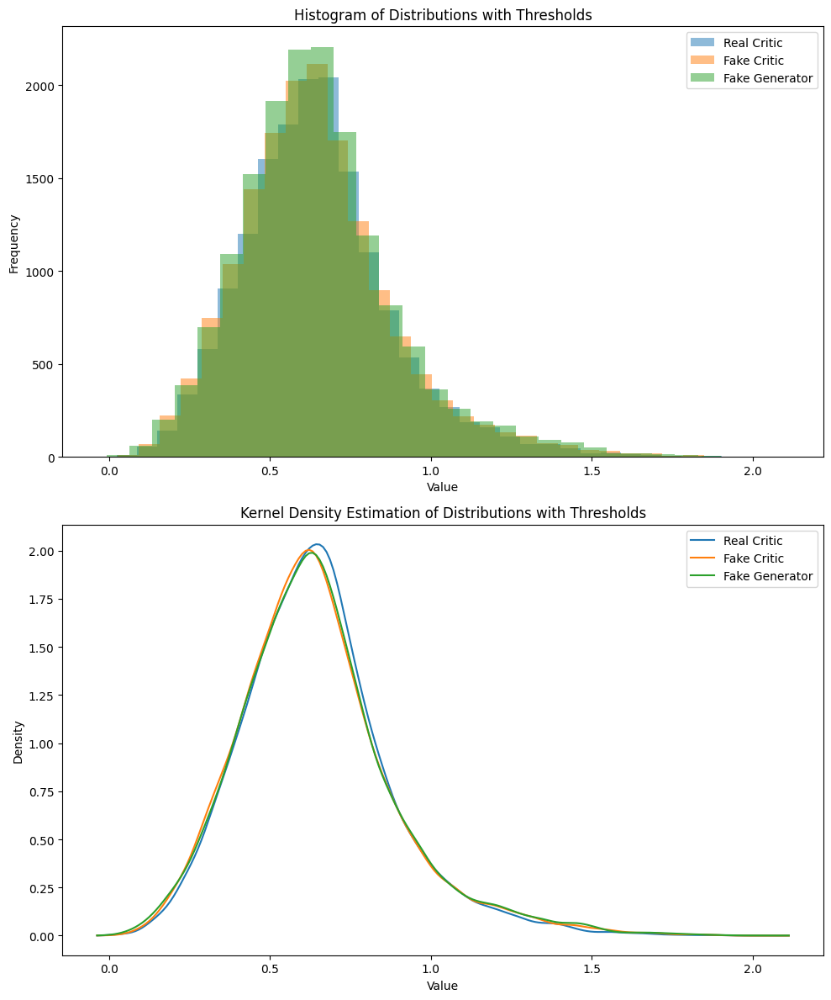

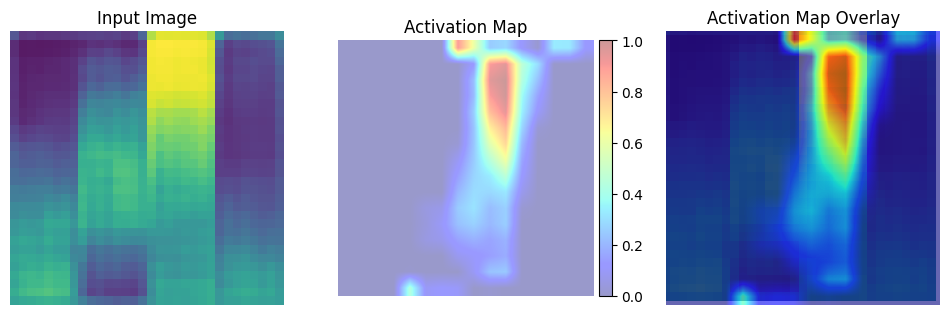

	MNSE Score: 0.10015907670770373
Batch [0/63] -  Critic loss:  0.22067009409268698 - generator loss:  124.51675415039062
Batch [21/63] -  Critic loss:  0.23388029996192816 - generator loss:  118.45658978548917
Batch [42/63] -  Critic loss:  0.738541507674742 - generator loss:  116.48192596435547
	Epoch 2 - critic loss: 1.2281662252529588 - generator loss: 113.08922758556548


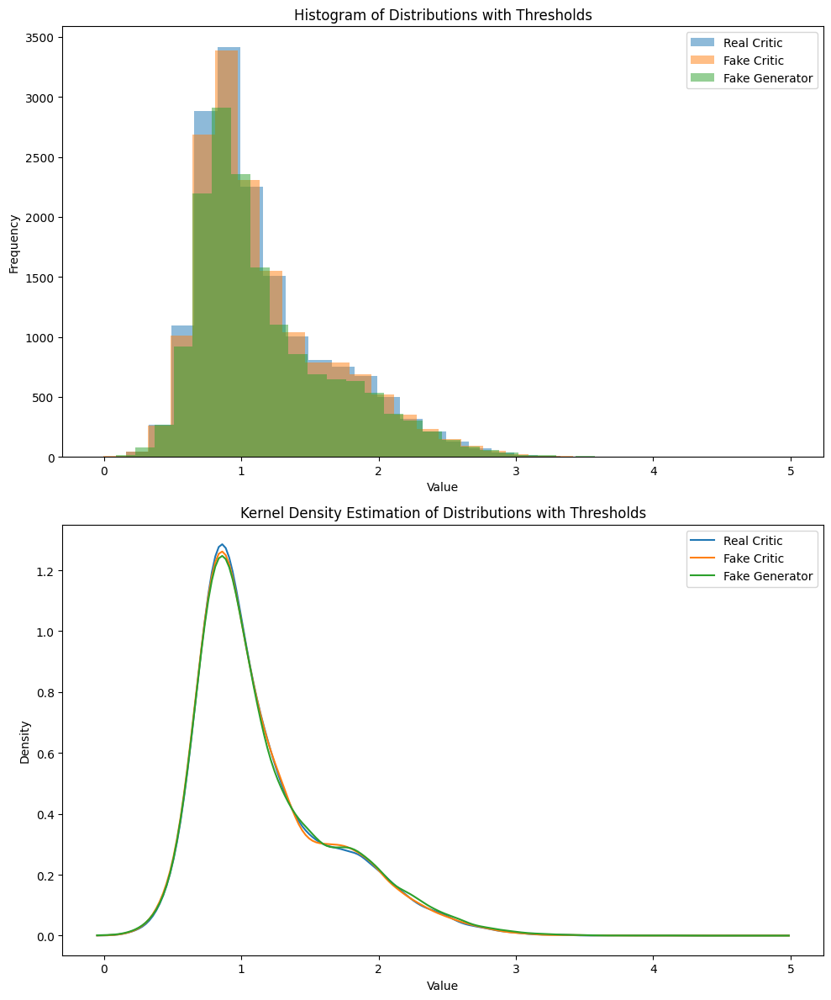

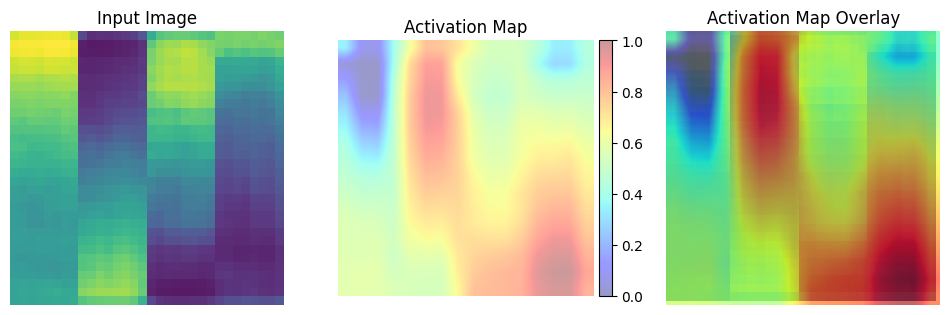

	MNSE Score: 0.0554163795969789
Batch [0/63] -  Critic loss:  1.5350488821665447 - generator loss:  98.5057601928711
Batch [21/63] -  Critic loss:  0.7622576974558108 - generator loss:  99.44122175736861
Batch [42/63] -  Critic loss:  0.9634123222772464 - generator loss:  98.30535161217978
	Epoch 3 - critic loss: 1.0946637322662995 - generator loss: 96.98474230085101


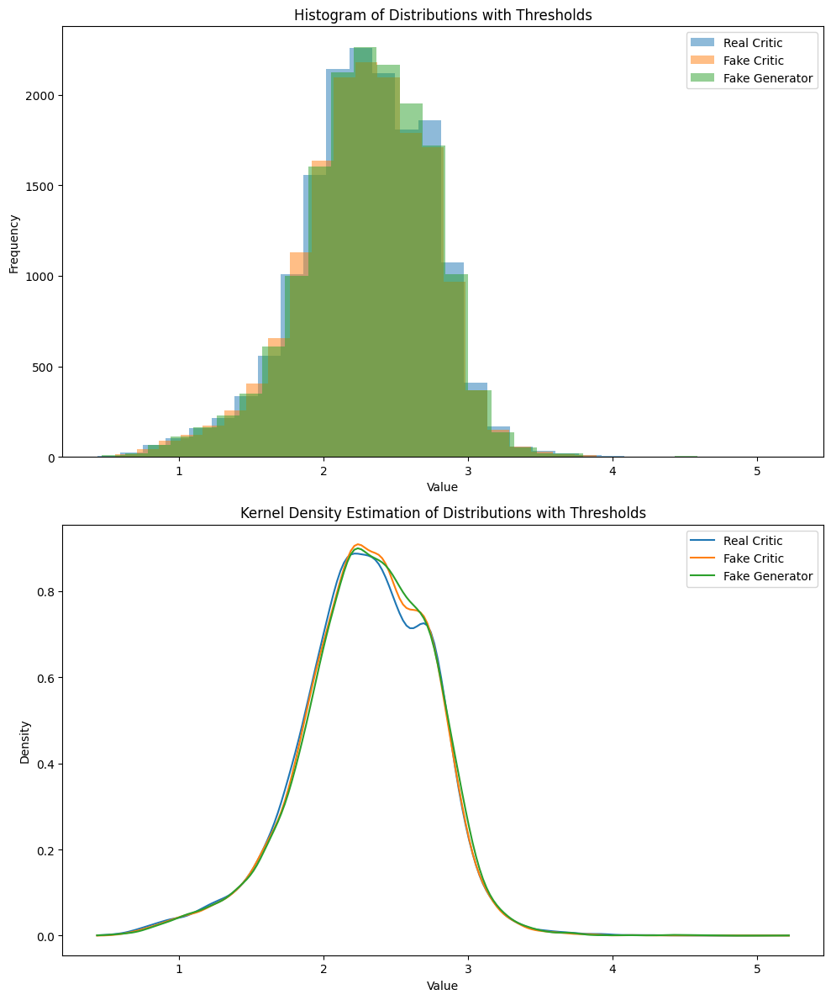

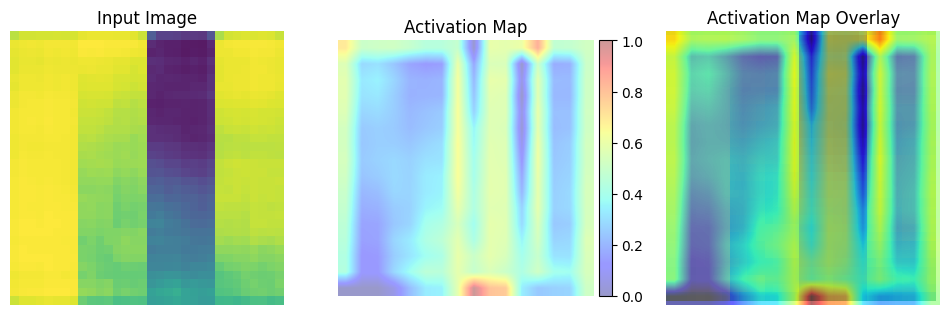

	MNSE Score: 0.04179365696415069
Batch [0/63] -  Critic loss:  0.3825264275074005 - generator loss:  91.96760559082031
Batch [21/63] -  Critic loss:  0.4096543084491383 - generator loss:  89.91732475974344
Batch [42/63] -  Critic loss:  0.31534358339254237 - generator loss:  89.12433162955351
	Epoch 4 - critic loss: 0.264644379101733 - generator loss: 87.39061912657722


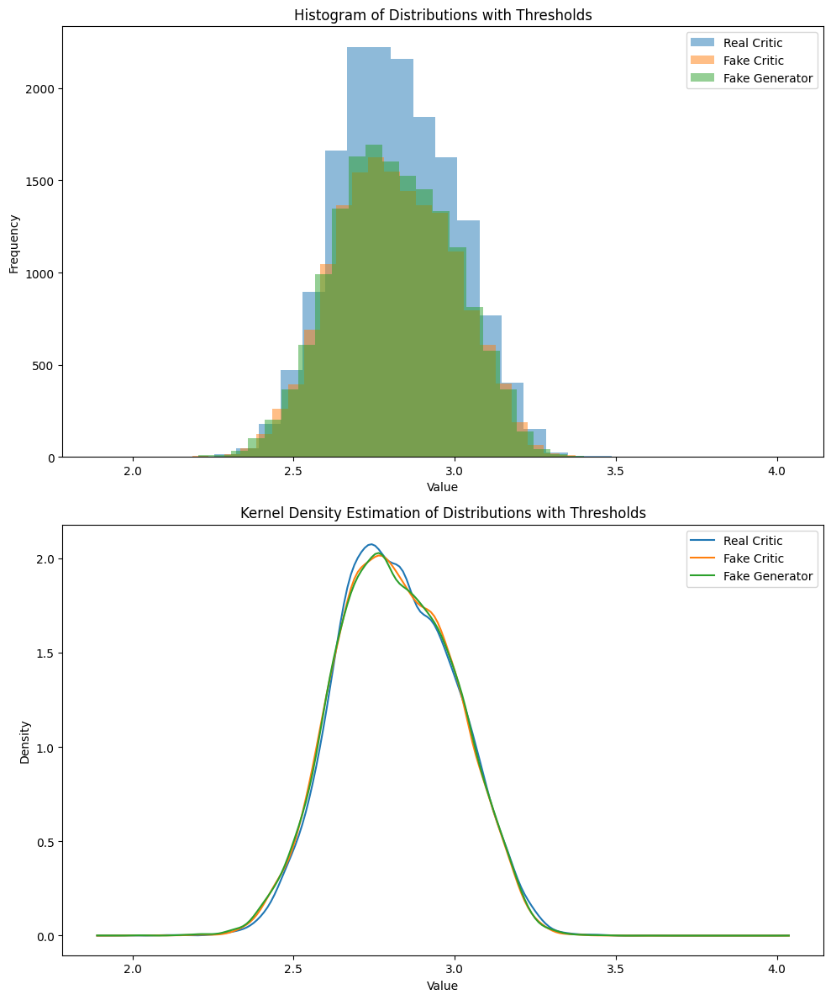

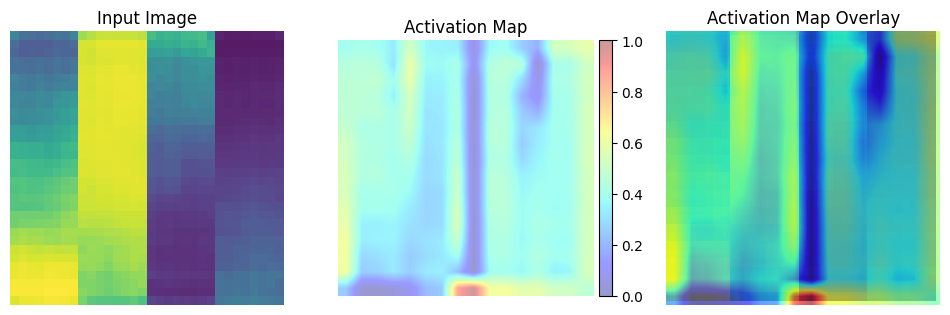

	MNSE Score: 0.03452711061589302
Batch [0/63] -  Critic loss:  0.25682465235392254 - generator loss:  80.70636749267578
Batch [21/63] -  Critic loss:  0.1236958694503163 - generator loss:  83.08270887895064
Batch [42/63] -  Critic loss:  0.09558748289249666 - generator loss:  81.81619103010311
	Epoch 5 - critic loss: 0.08451808048855694 - generator loss: 81.02474121820359


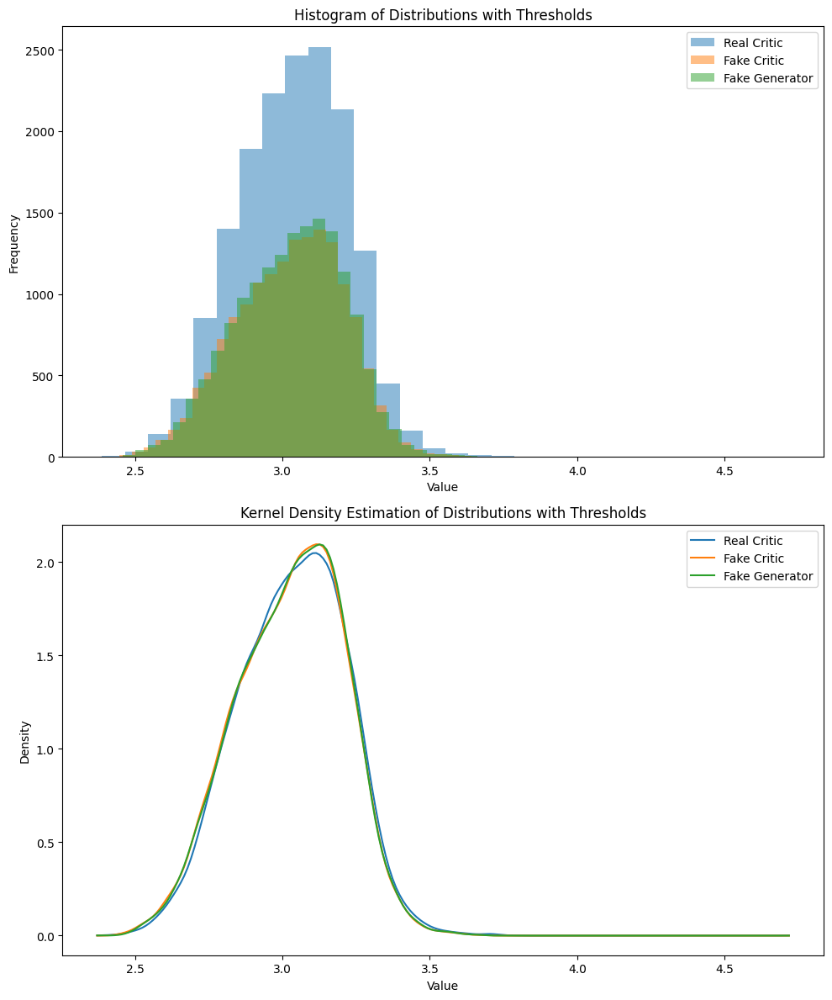

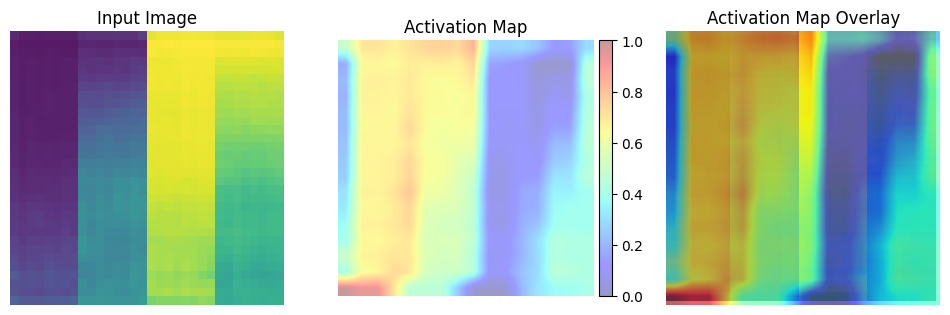

	MNSE Score: 0.029954657342935367
Batch [0/63] -  Critic loss:  0.049409255385398865 - generator loss:  77.1407241821289
Batch [21/63] -  Critic loss:  0.06075171714253498 - generator loss:  75.79150147871538
Batch [42/63] -  Critic loss:  0.05042154994583869 - generator loss:  75.69795848048011
	Epoch 6 - critic loss: 0.05046278522128152 - generator loss: 74.77547854468936


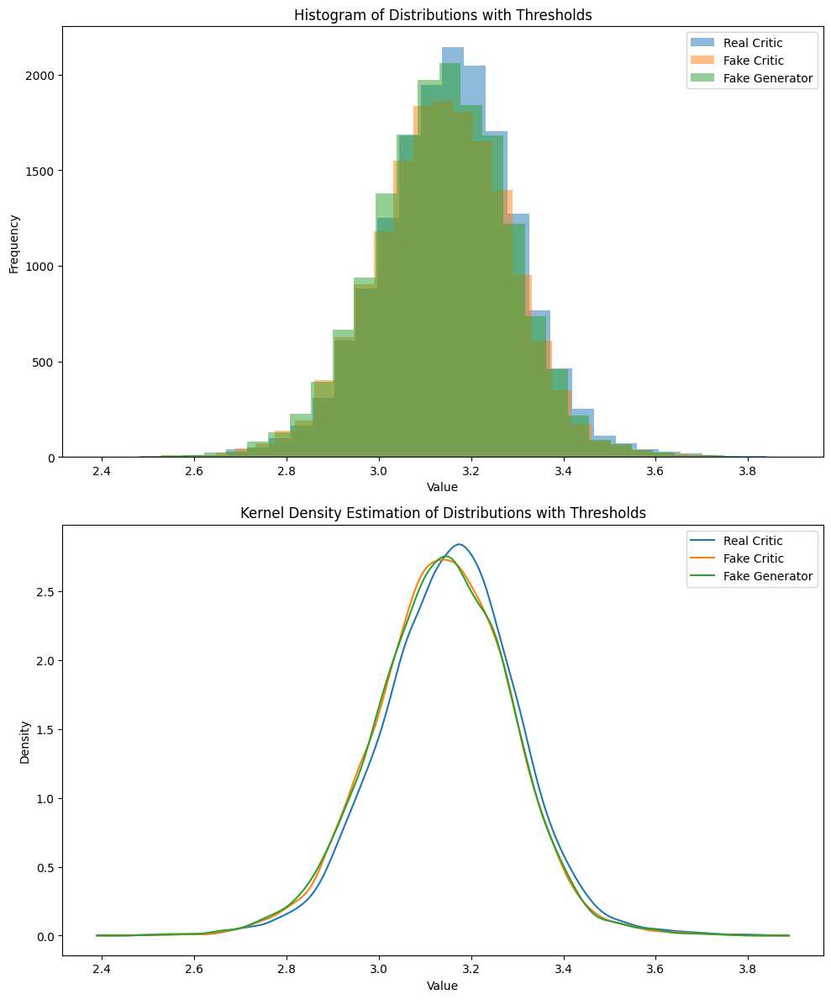

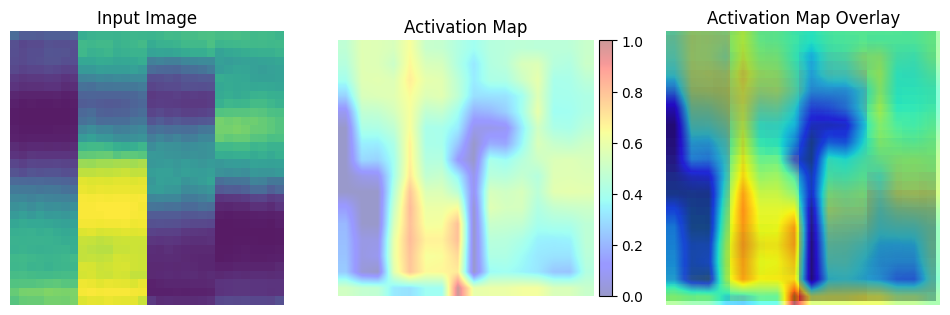

	MNSE Score: 0.025739471413313397
Batch [0/63] -  Critic loss:  0.06340581178665161 - generator loss:  69.75395202636719
Batch [21/63] -  Critic loss:  0.052610217057394264 - generator loss:  72.58833694458008
Batch [42/63] -  Critic loss:  0.042634225428797475 - generator loss:  72.44387639955033
	Epoch 7 - critic loss: 0.029081994953451963 - generator loss: 71.77736330789233


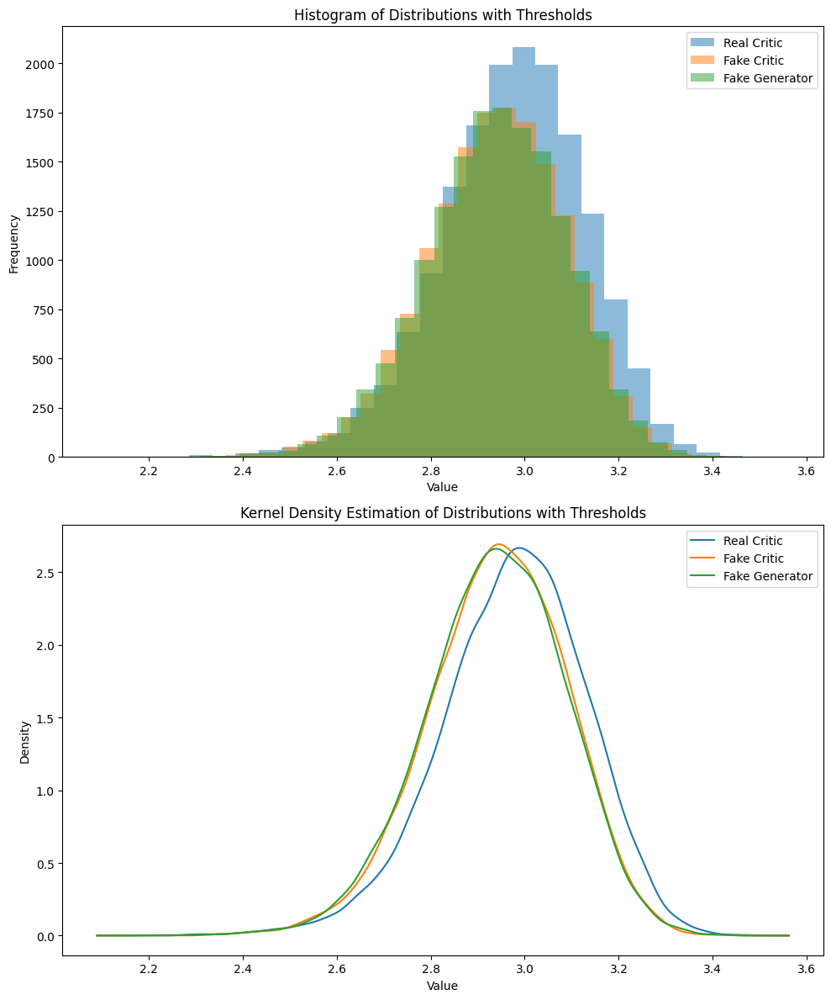

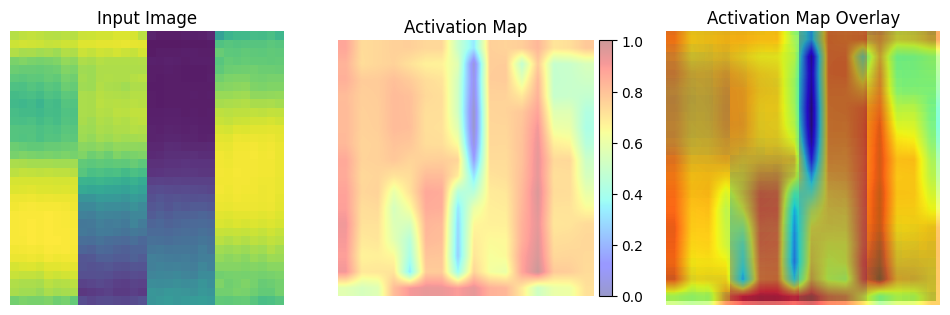

	MNSE Score: 0.023658066012320064
Batch [0/63] -  Critic loss:  -0.0015785743792851765 - generator loss:  67.4959945678711
Batch [21/63] -  Critic loss:  -0.015874598880834652 - generator loss:  69.15830473466353
Batch [42/63] -  Critic loss:  -0.026740046246915825 - generator loss:  68.6216970931652
	Epoch 8 - critic loss: -0.032761070414116134 - generator loss: 68.08942001584977


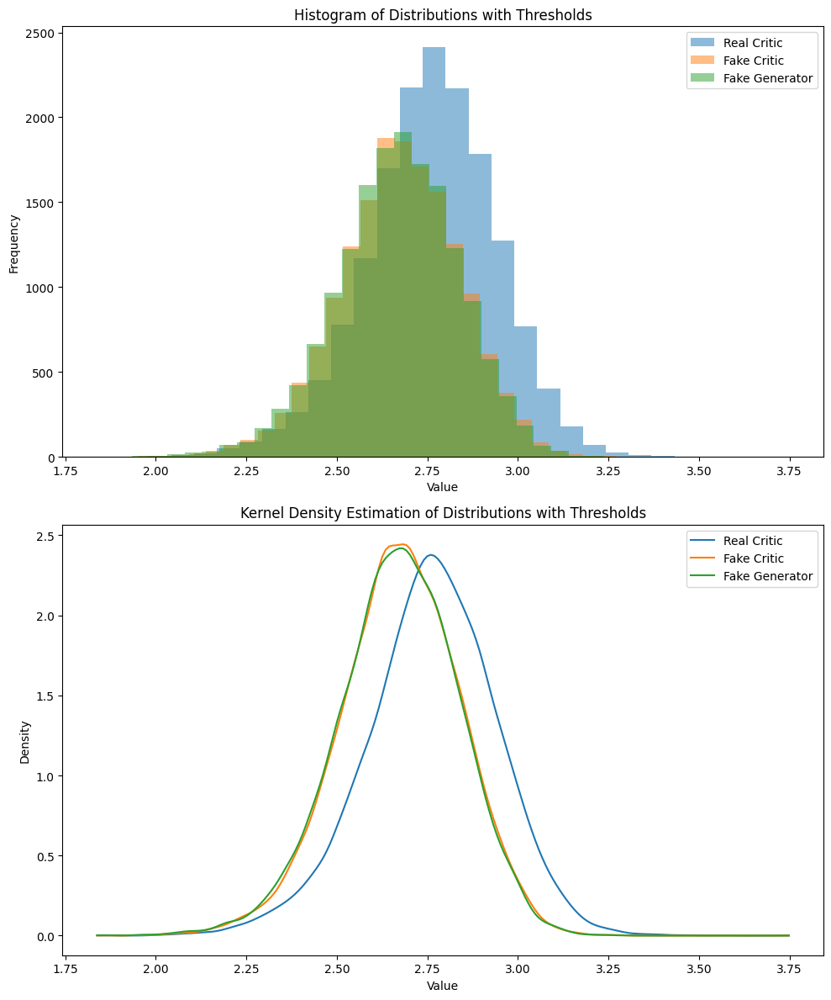

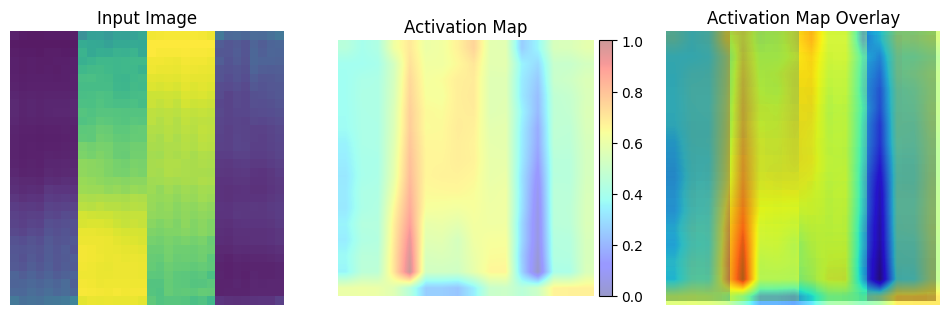

	MNSE Score: 0.021271648506323498
Batch [0/63] -  Critic loss:  -0.060098608334859215 - generator loss:  70.55364990234375
Batch [21/63] -  Critic loss:  -0.052119366711739334 - generator loss:  67.07593189586292
Batch [42/63] -  Critic loss:  -0.07305825842443361 - generator loss:  66.51316806881927
	Epoch 9 - critic loss: -0.09132435192506778 - generator loss: 65.88829004196893


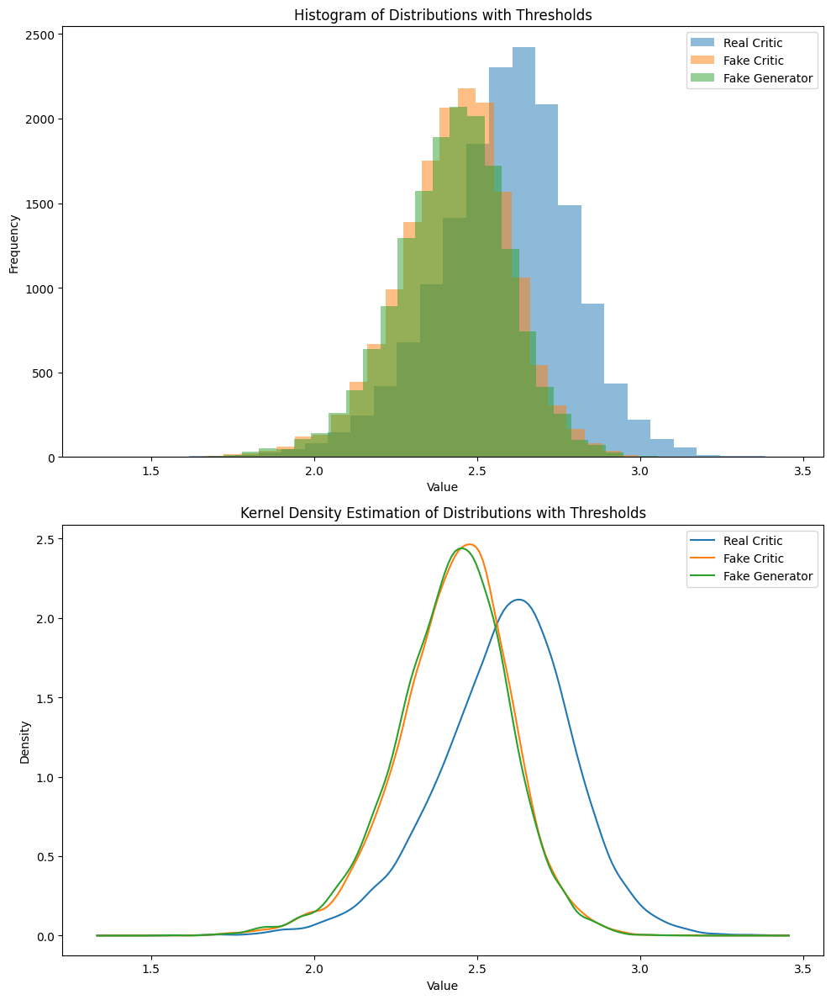

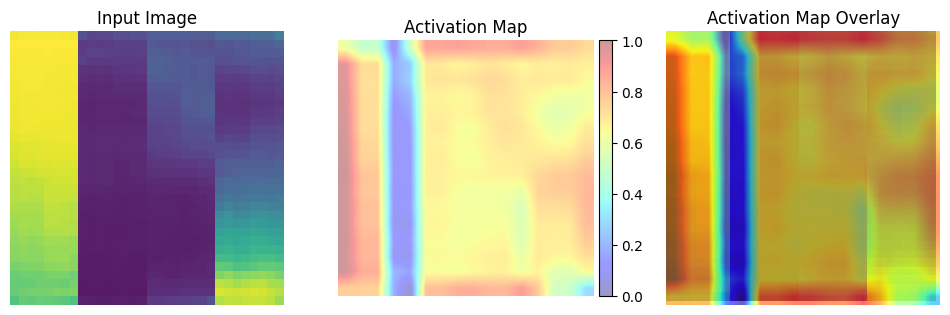

	MNSE Score: 0.019796239655642284
Batch [0/63] -  Critic loss:  -0.1743109772602717 - generator loss:  69.49607849121094
Batch [21/63] -  Critic loss:  -0.1651091196320274 - generator loss:  63.91542850841176
Batch [42/63] -  Critic loss:  -0.18625710361687714 - generator loss:  63.76184907070426
	Epoch 10 - critic loss: -0.19444836967836612 - generator loss: 63.52832267397926


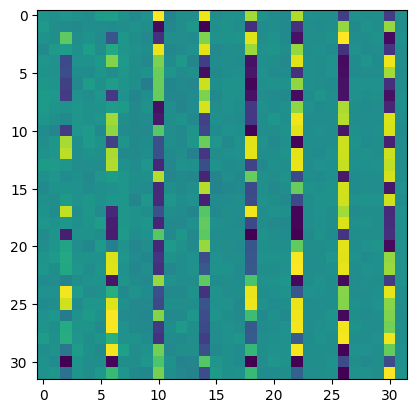

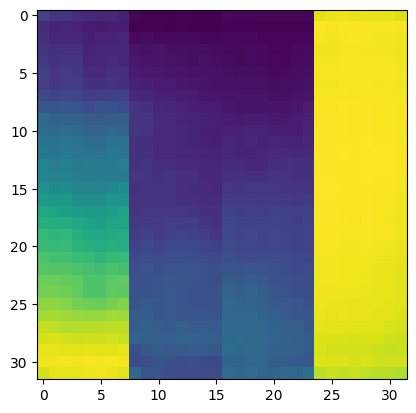

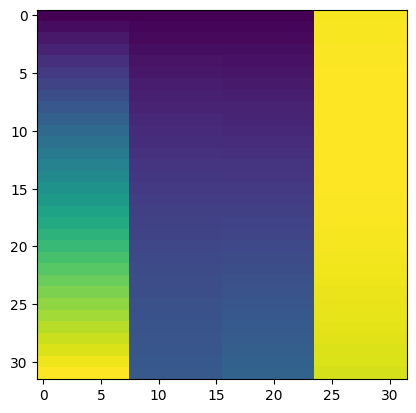

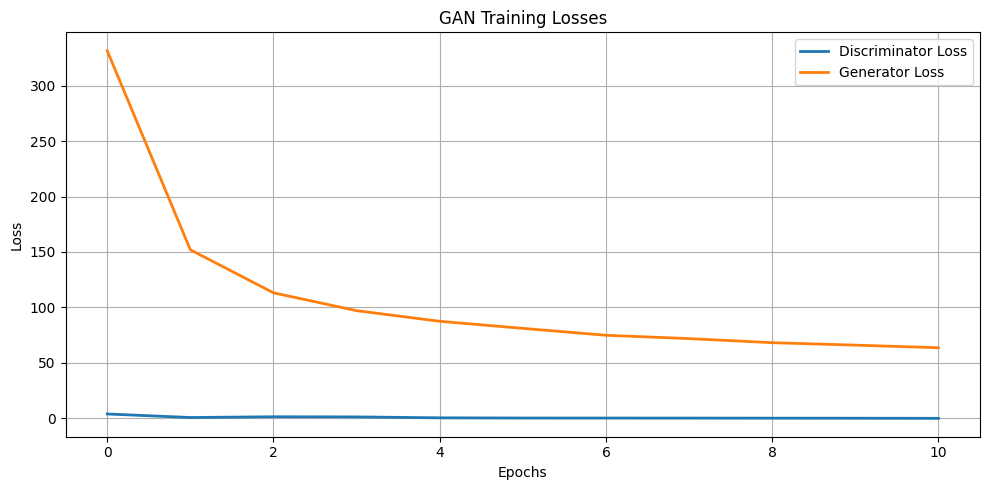

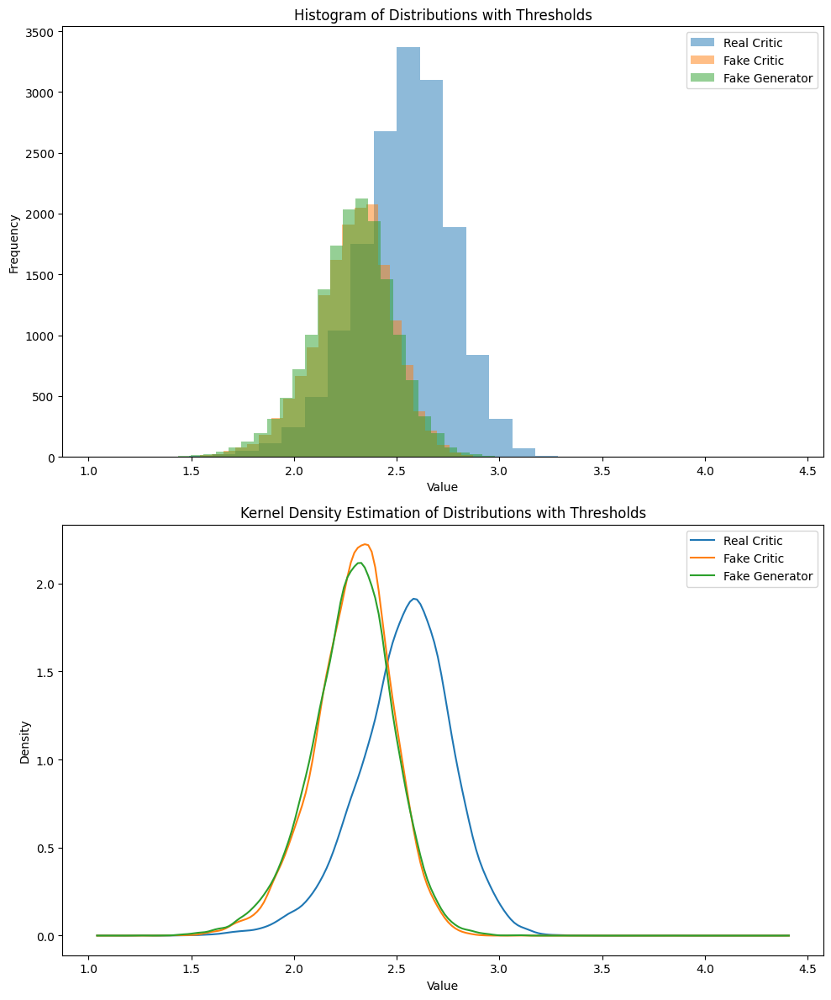

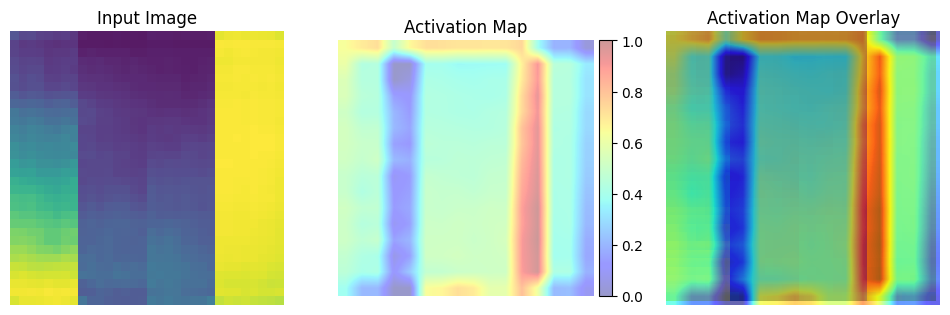

	MNSE Score: 0.018370715989952997
Batch [0/63] -  Critic loss:  -0.27113349239031476 - generator loss:  59.60832595825195
Batch [21/63] -  Critic loss:  -0.2751552336143725 - generator loss:  62.19939630681818
Batch [42/63] -  Critic loss:  -0.2920204909272897 - generator loss:  62.22365454740302
	Epoch 11 - critic loss: -0.3041512723322268 - generator loss: 61.824320354158914


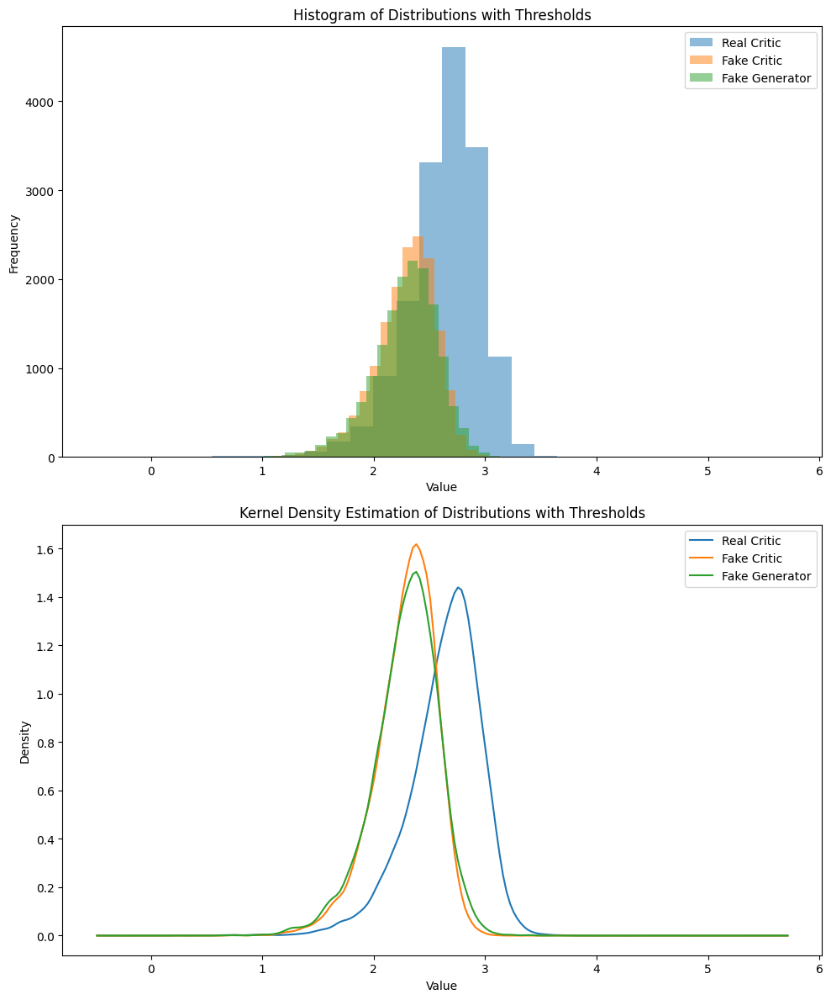

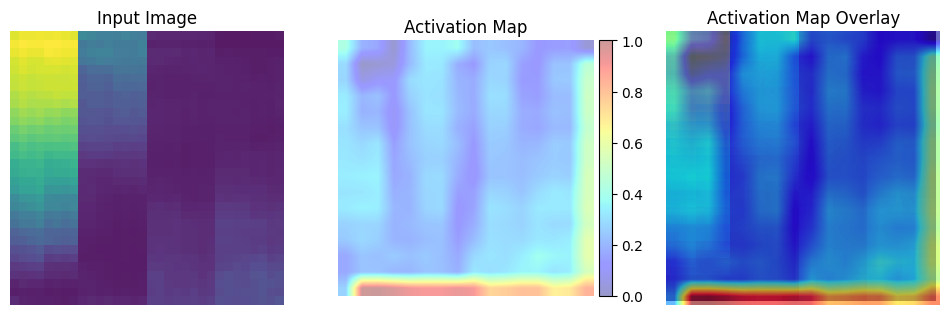

	MNSE Score: 0.017435168551783713
Batch [0/63] -  Critic loss:  -0.3852979938189189 - generator loss:  61.56855010986328
Batch [21/63] -  Critic loss:  -0.3221285252860098 - generator loss:  59.73010930148038
Batch [42/63] -  Critic loss:  -0.3729931044486143 - generator loss:  59.4802360534668
	Epoch 12 - critic loss: -0.3838602578829206 - generator loss: 59.65917345077273


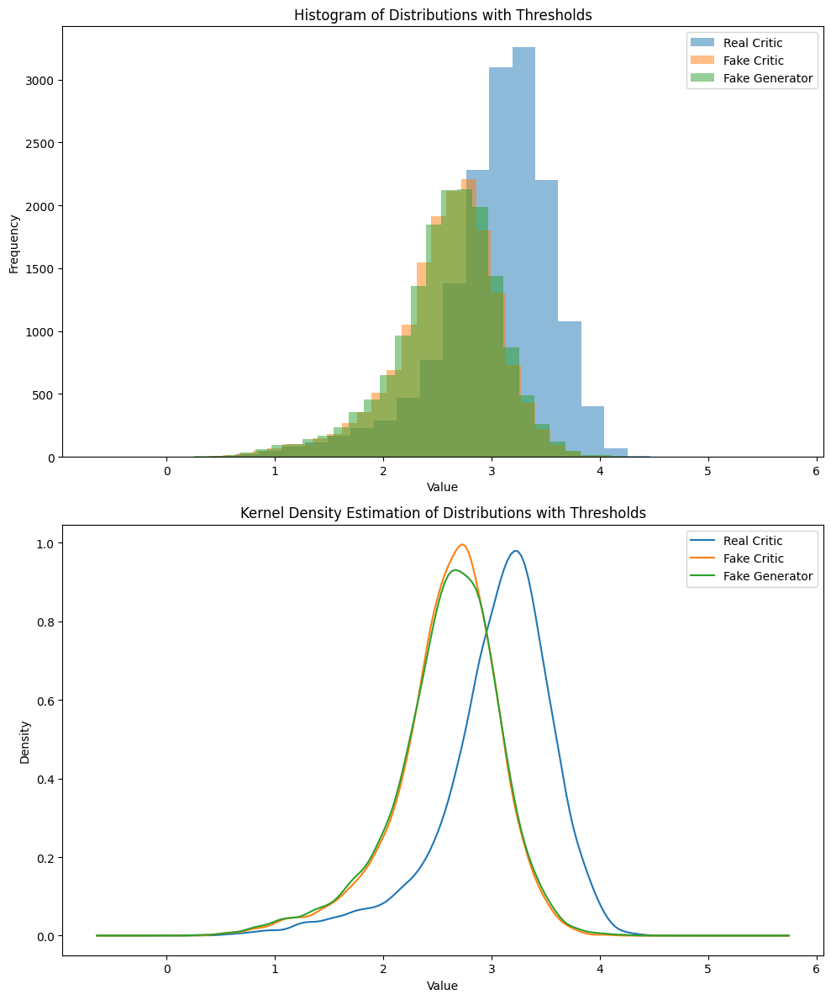

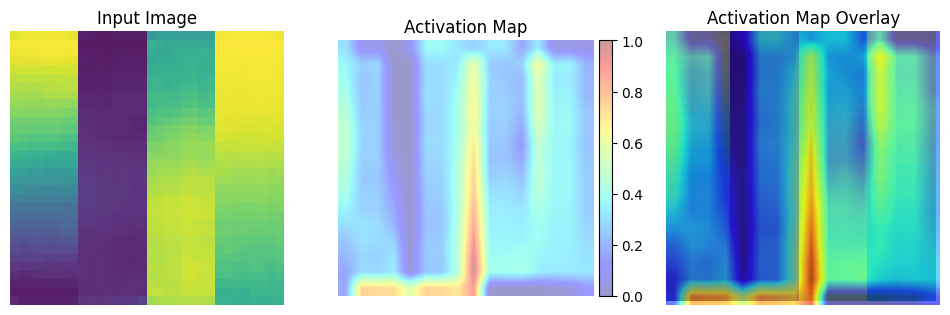

	MNSE Score: 0.01645124096068598
Batch [0/63] -  Critic loss:  -0.46196584900220233 - generator loss:  60.01615905761719
Batch [21/63] -  Critic loss:  -0.4985849301923405 - generator loss:  59.97119747508656
Batch [42/63] -  Critic loss:  -0.4931702775548596 - generator loss:  59.13203465661337
	Epoch 13 - critic loss: -0.5057061435999695 - generator loss: 58.583573356507316


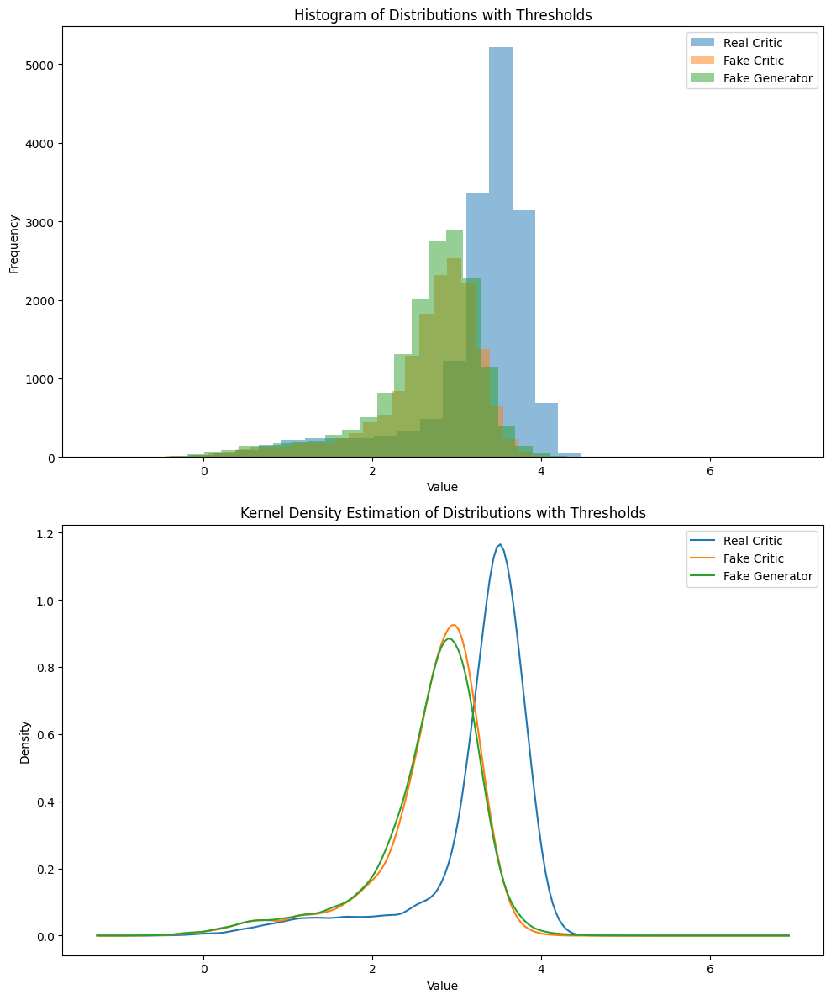

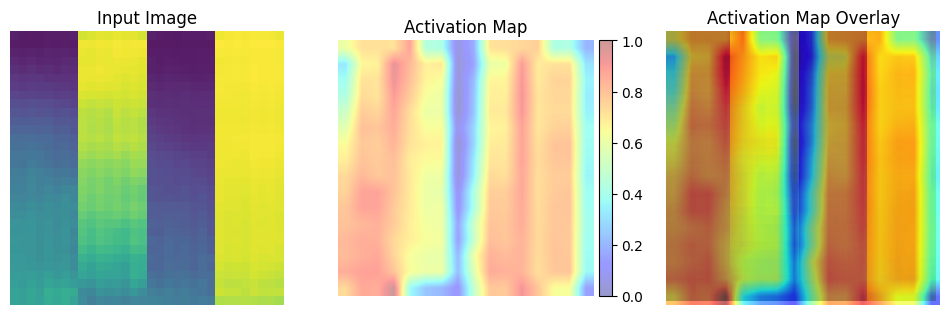

	MNSE Score: 0.015939050782767552
Batch [0/63] -  Critic loss:  -0.40651918450991315 - generator loss:  53.712127685546875
Batch [21/63] -  Critic loss:  -0.5628080029379237 - generator loss:  56.094938624988906
Batch [42/63] -  Critic loss:  -0.5866087901499843 - generator loss:  56.786083310149436
	Epoch 14 - critic loss: -0.6051728852369168 - generator loss: 57.21578174167209


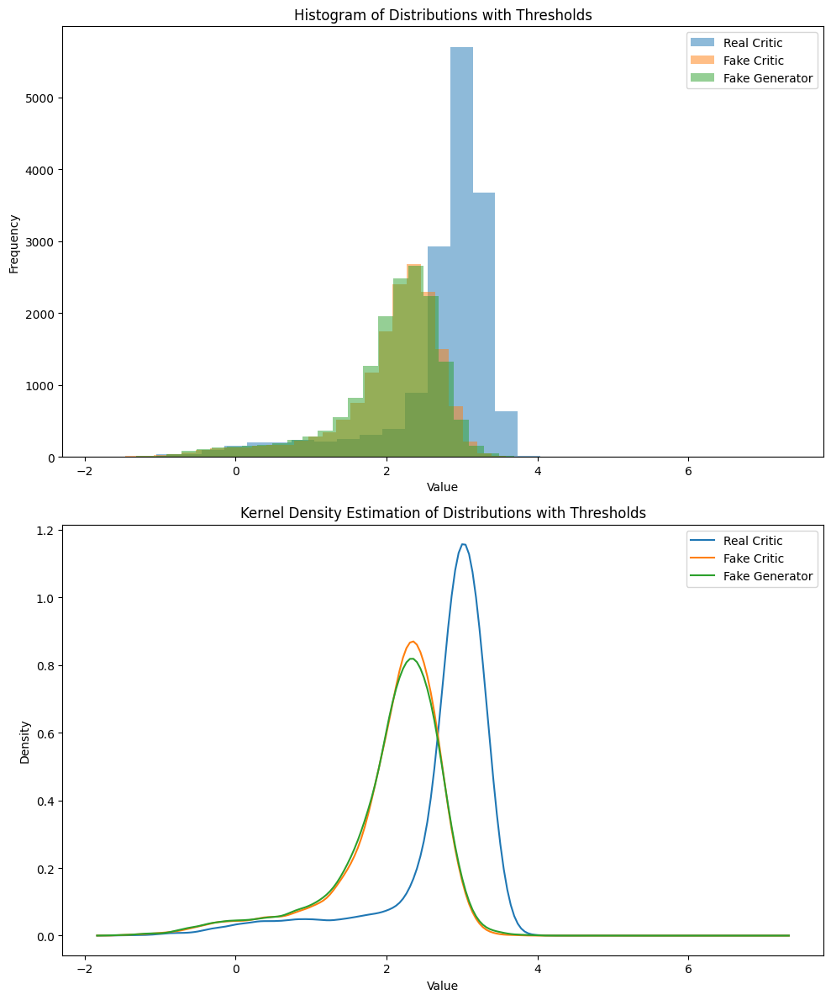

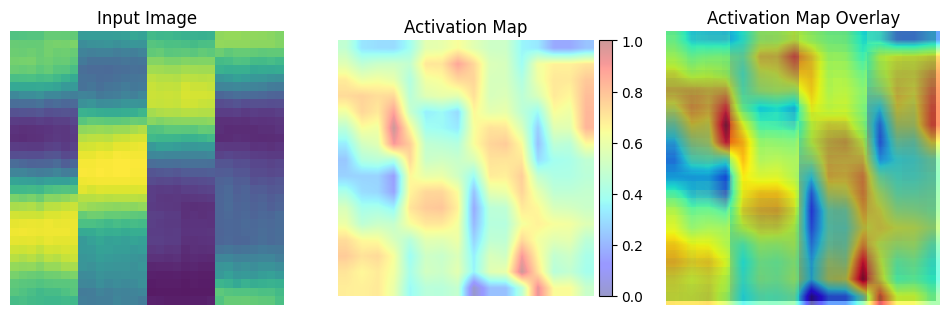

	MNSE Score: 0.014922506220283963
Batch [0/63] -  Critic loss:  -0.6313005884488424 - generator loss:  54.38668441772461
Batch [21/63] -  Critic loss:  -0.5815535567023538 - generator loss:  56.232479615644976
Batch [42/63] -  Critic loss:  -0.6357893689658292 - generator loss:  56.250091464020485
	Epoch 15 - critic loss: -0.6583785339007303 - generator loss: 55.87587744092185


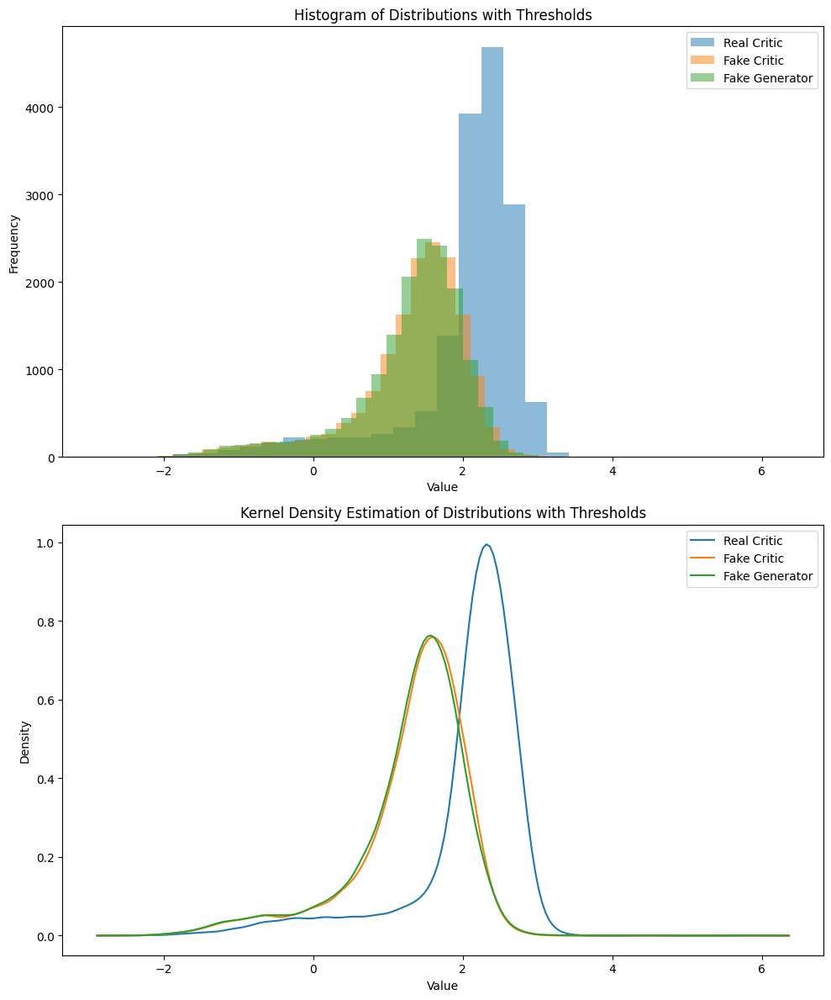

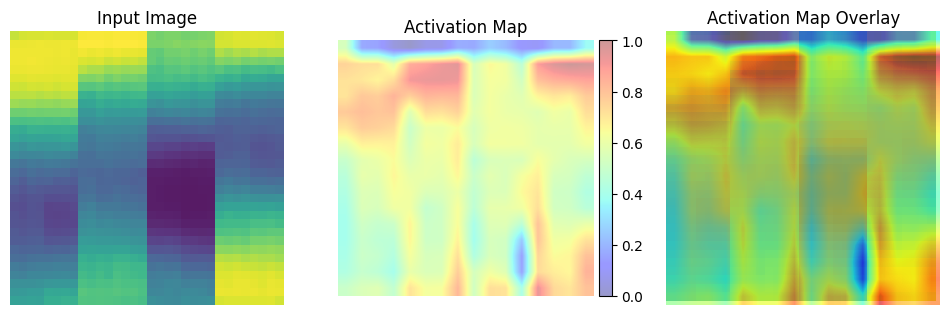

	MNSE Score: 0.013864944674192912
Batch [0/63] -  Critic loss:  -0.6727775732676188 - generator loss:  51.40647506713867
Batch [21/63] -  Critic loss:  -0.7486461400985718 - generator loss:  54.81752482327548
Batch [42/63] -  Critic loss:  -0.7525288689044094 - generator loss:  54.755792662154796
	Epoch 16 - critic loss: -0.7534471548423564 - generator loss: 54.9549694364033


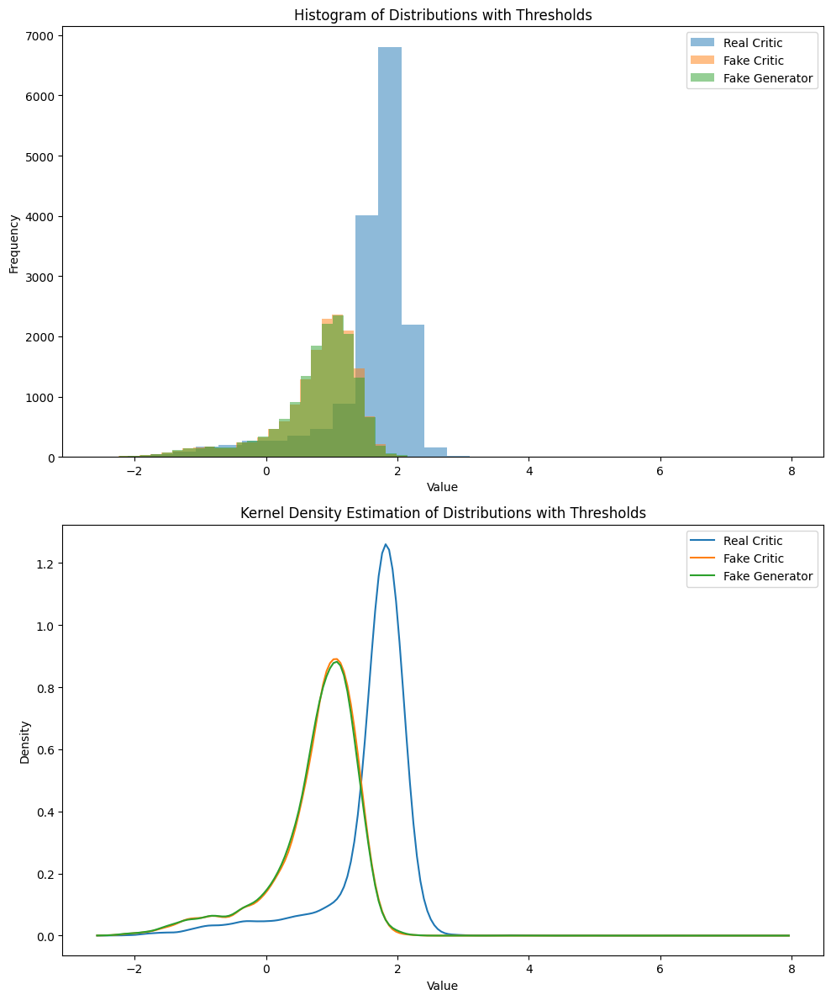

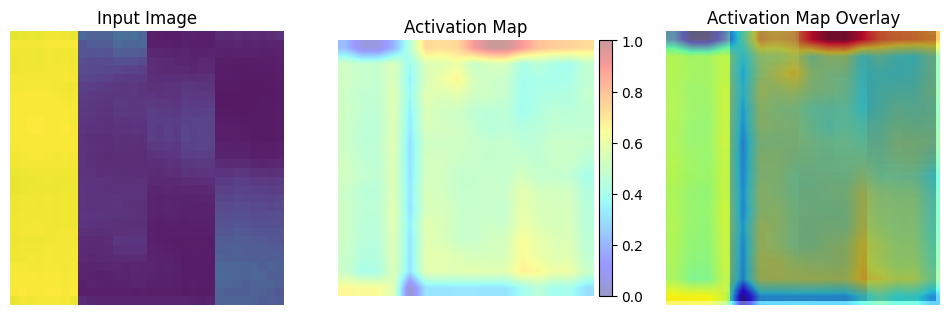

	MNSE Score: 0.013198243779322457
Batch [0/63] -  Critic loss:  -0.8451615969340006 - generator loss:  54.33200454711914
Batch [21/63] -  Critic loss:  -0.789170716748093 - generator loss:  55.47035234624689
Batch [42/63] -  Critic loss:  -0.7756482360436933 - generator loss:  55.15084767896076
	Epoch 17 - critic loss: -0.7821410435532764 - generator loss: 54.55751667325459


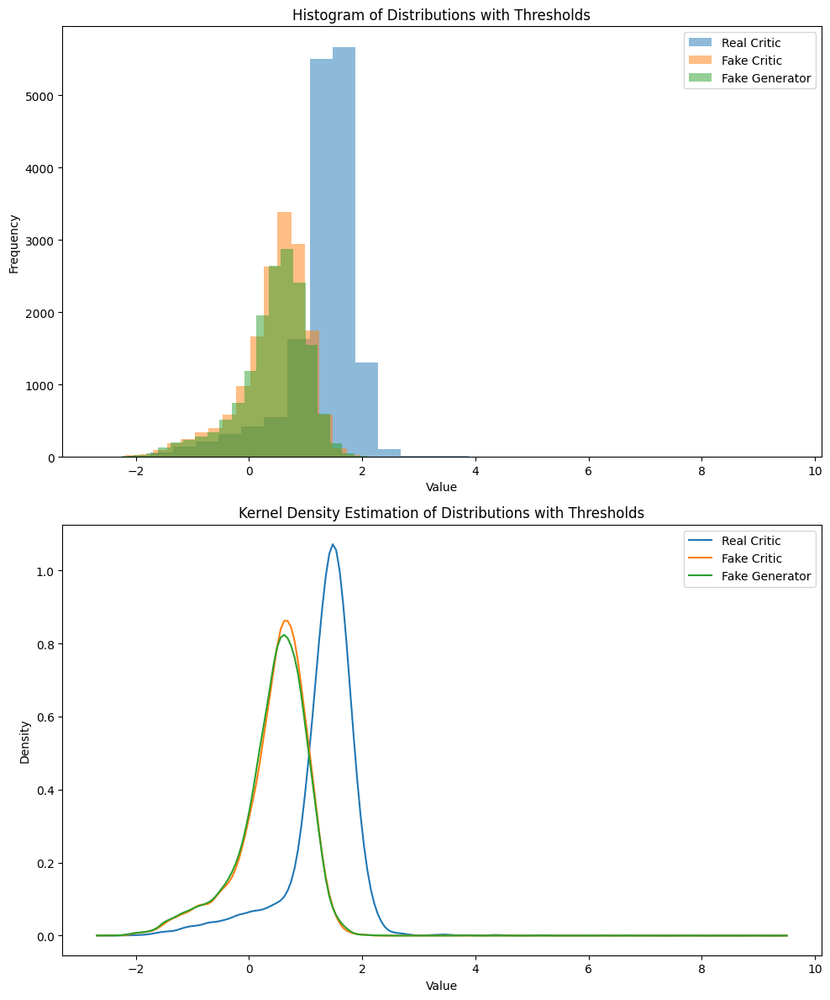

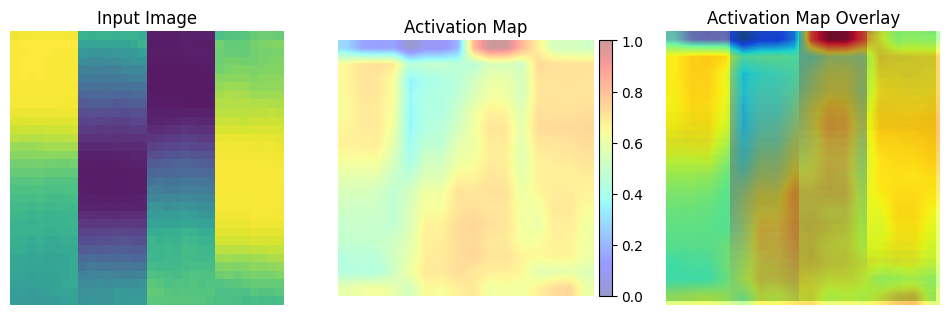

	MNSE Score: 0.012841610548396906
Batch [0/63] -  Critic loss:  -0.6630462010701498 - generator loss:  48.14512252807617
Batch [21/63] -  Critic loss:  -0.8038234403639127 - generator loss:  53.69249725341797
Batch [42/63] -  Critic loss:  -0.7784947711367938 - generator loss:  53.82754436759062
	Epoch 18 - critic loss: -0.7889131809037828 - generator loss: 54.019585200718474


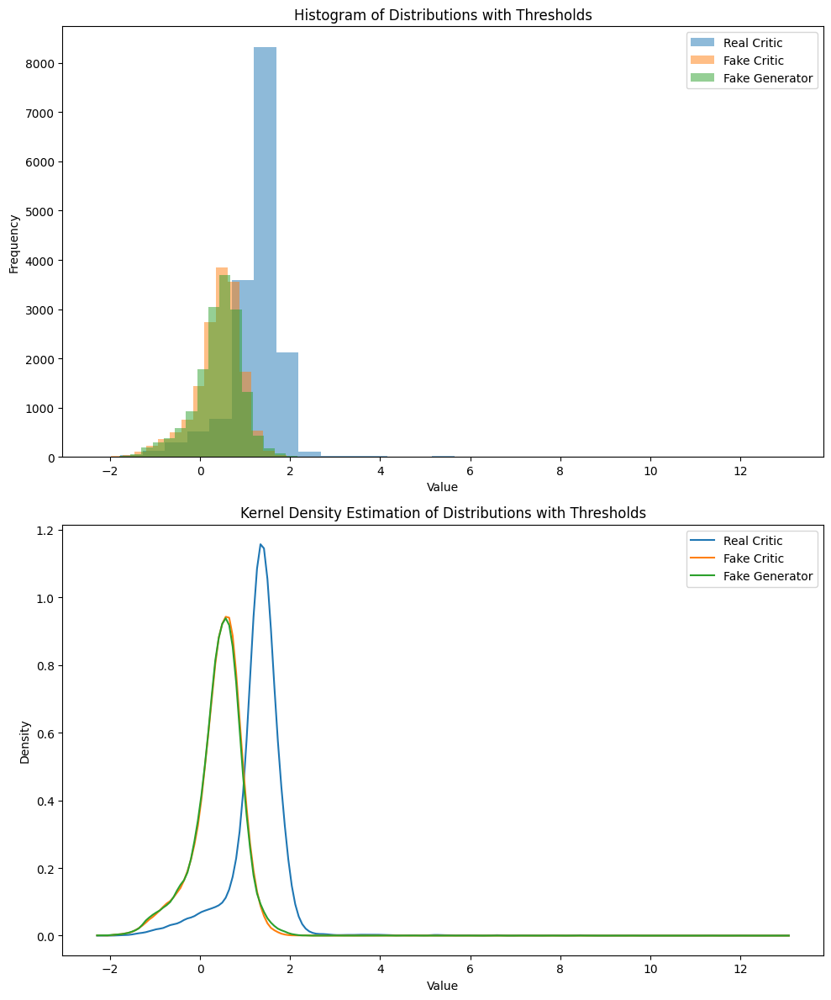

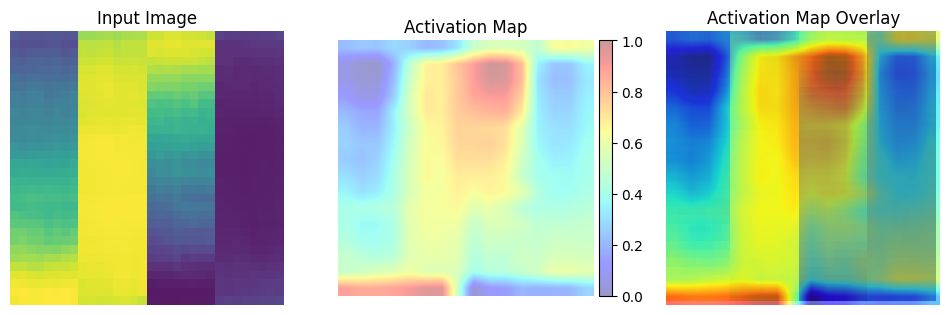

	MNSE Score: 0.01258219015740213
Batch [0/63] -  Critic loss:  -0.8093520005544027 - generator loss:  51.06641387939453
Batch [21/63] -  Critic loss:  -0.7905369726094335 - generator loss:  53.62439450350675
Batch [42/63] -  Critic loss:  -0.8088223504465681 - generator loss:  53.67276178404342
	Epoch 19 - critic loss: -0.8117261264059281 - generator loss: 53.35900666978624


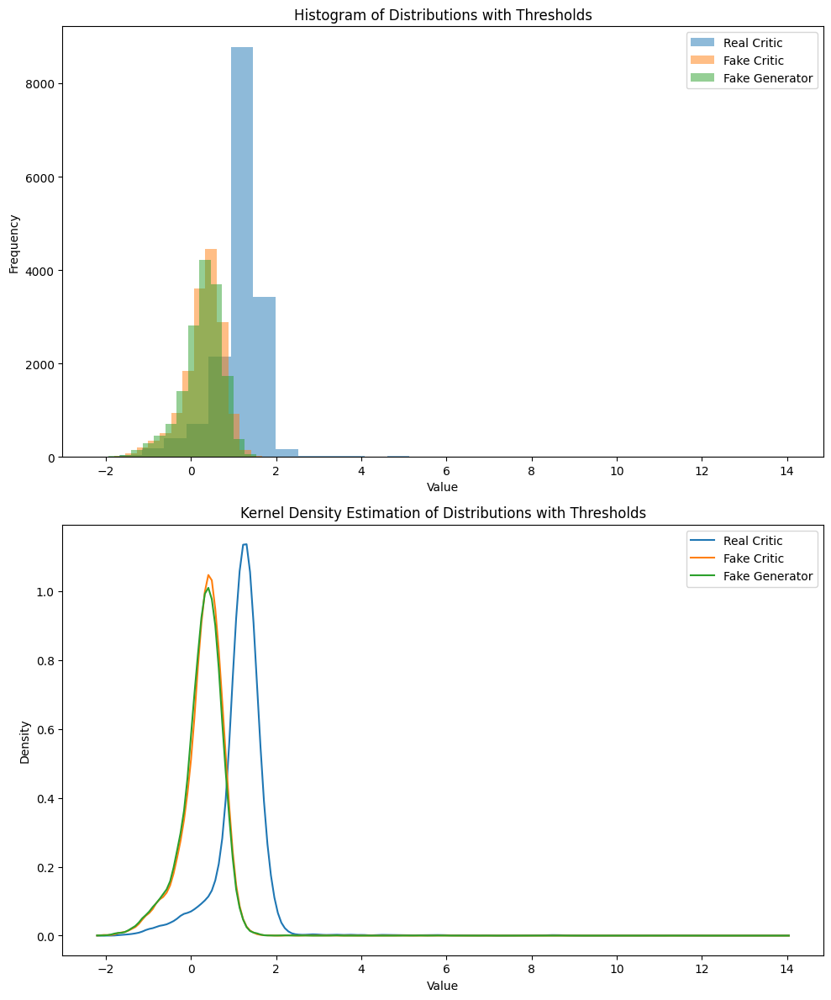

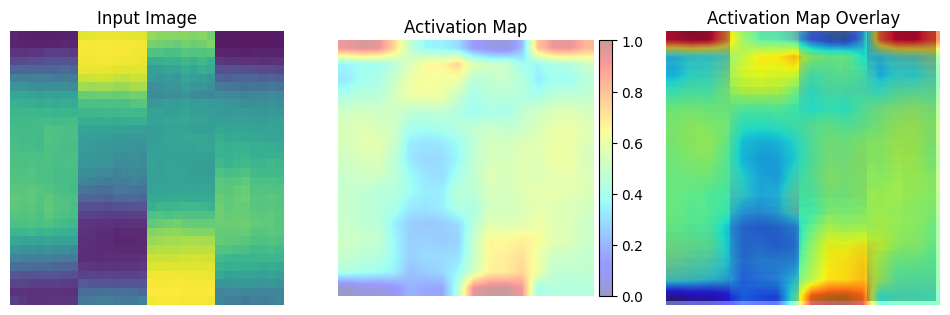

	MNSE Score: 0.012197469198514544
Batch [0/63] -  Critic loss:  -0.7579574783643087 - generator loss:  49.52777099609375
Batch [21/63] -  Critic loss:  -0.8040821516152586 - generator loss:  52.93219046159224
Batch [42/63] -  Critic loss:  -0.8087071235789809 - generator loss:  53.201186601505725
	Epoch 20 - critic loss: -0.8155823602247491 - generator loss: 52.99216757880317


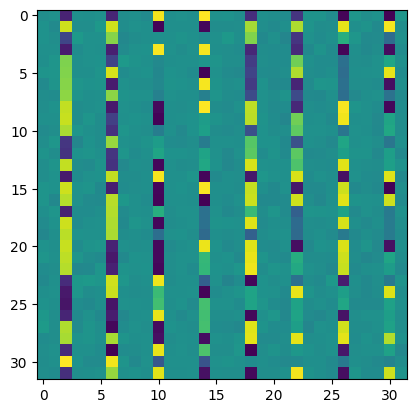

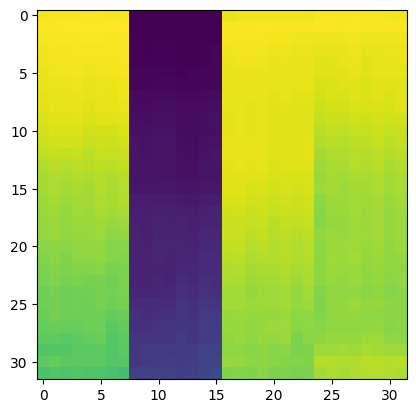

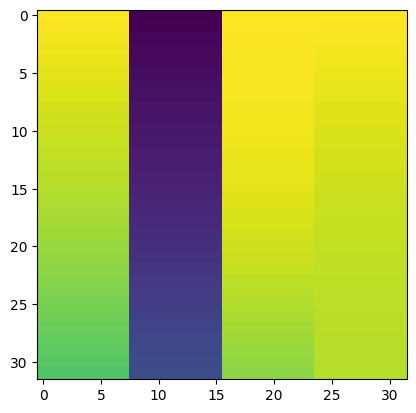

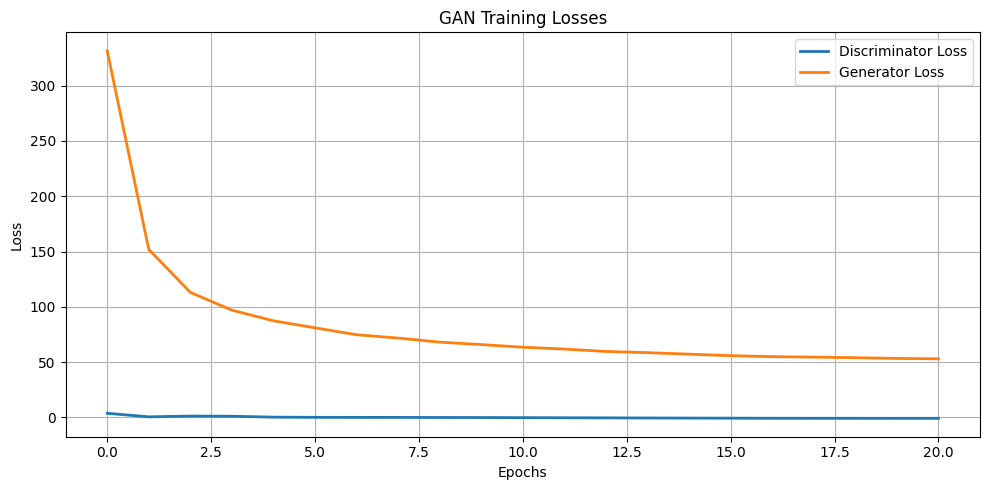

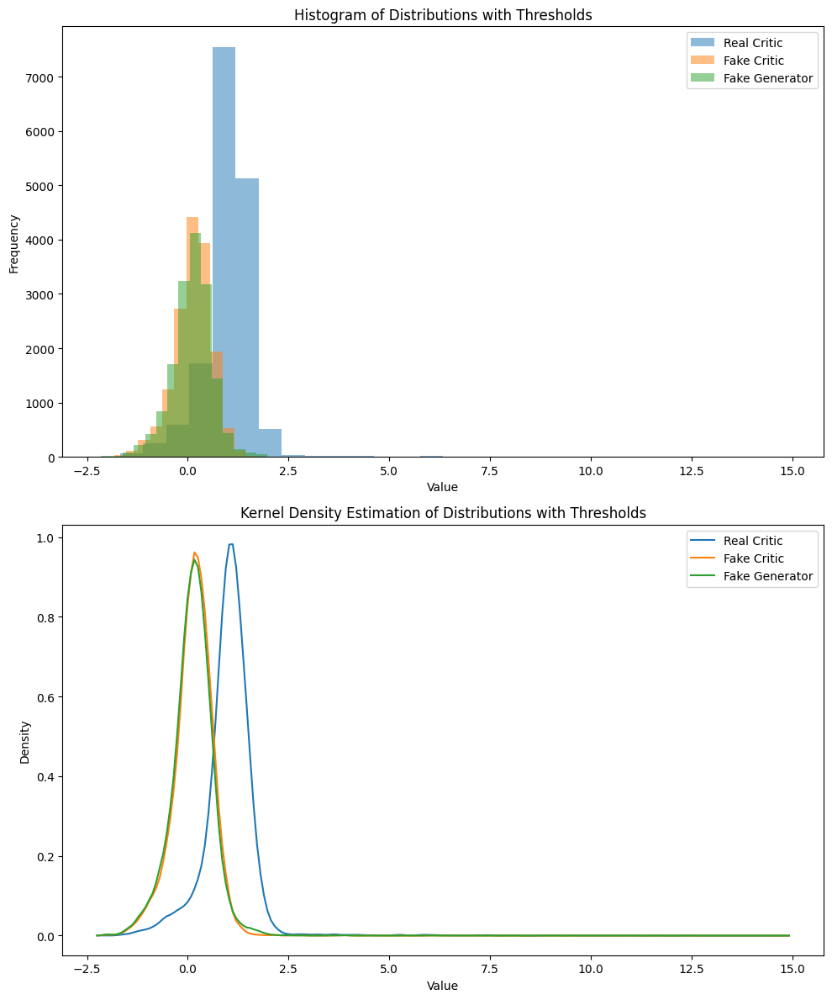

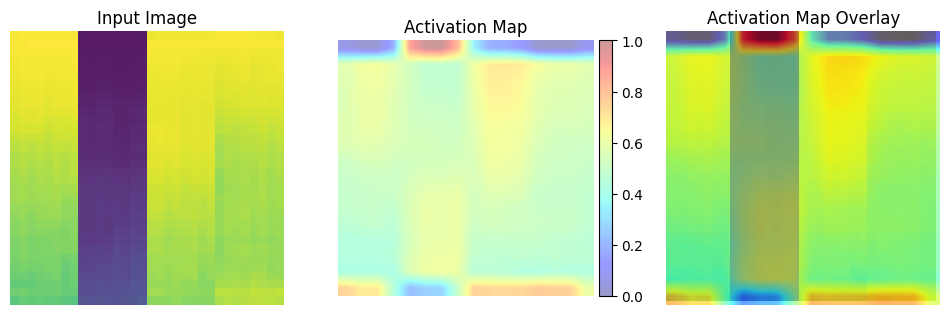

	MNSE Score: 0.011967460920531598
Batch [0/63] -  Critic loss:  -0.8627372781435648 - generator loss:  49.75678634643555
Batch [21/63] -  Critic loss:  -0.8405080085450952 - generator loss:  51.91099028153853
Batch [42/63] -  Critic loss:  -0.835820136606231 - generator loss:  51.46757329896439
	Epoch 21 - critic loss: -0.8278370755059377 - generator loss: 51.698539310031464


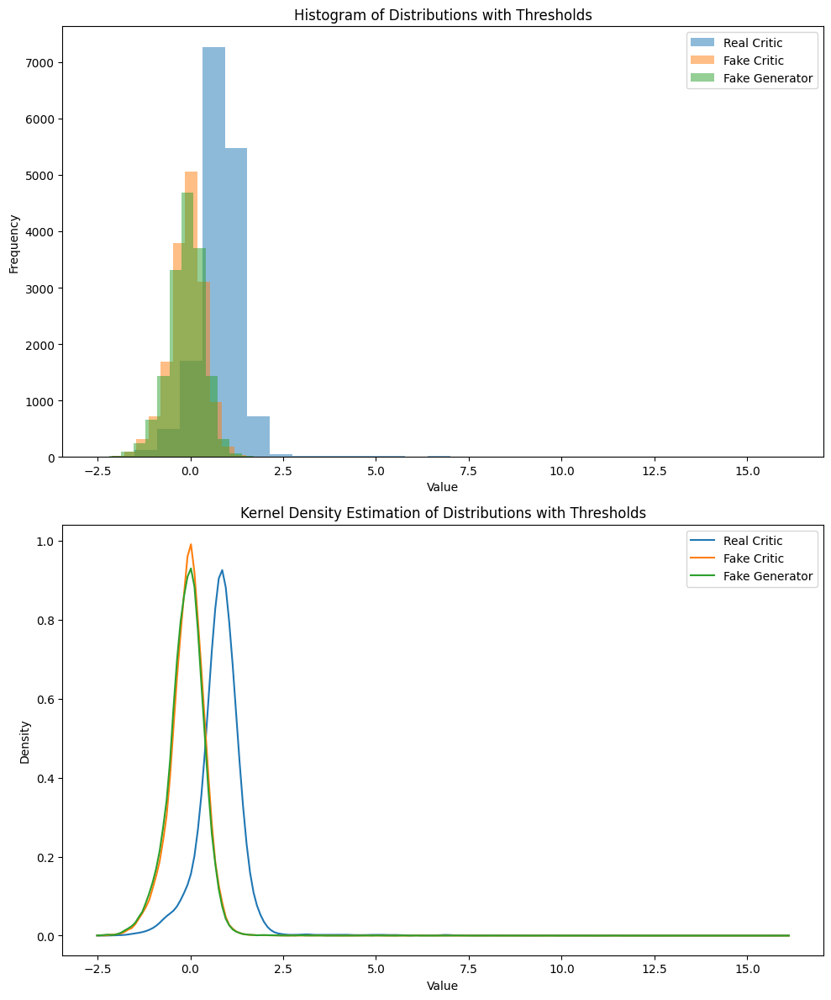

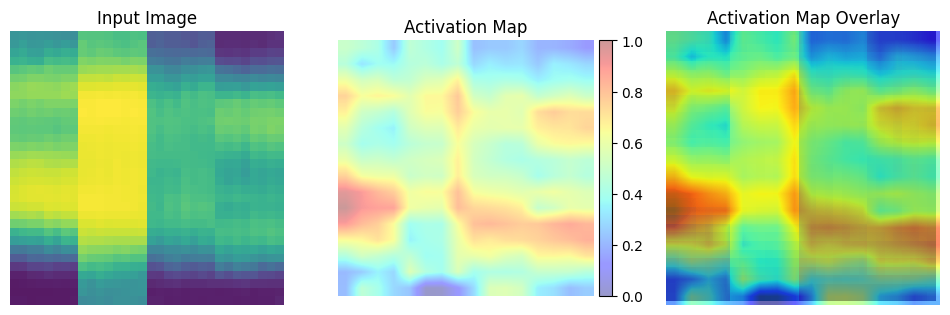

	MNSE Score: 0.011297254630970576
Batch [0/63] -  Critic loss:  -0.4866364300251007 - generator loss:  51.322227478027344
Batch [21/63] -  Critic loss:  -0.826364417419289 - generator loss:  51.93036859685724
Batch [42/63] -  Critic loss:  -0.8313892227272655 - generator loss:  51.50566677714503
	Epoch 22 - critic loss: -0.8317165726391725 - generator loss: 51.71504211425781


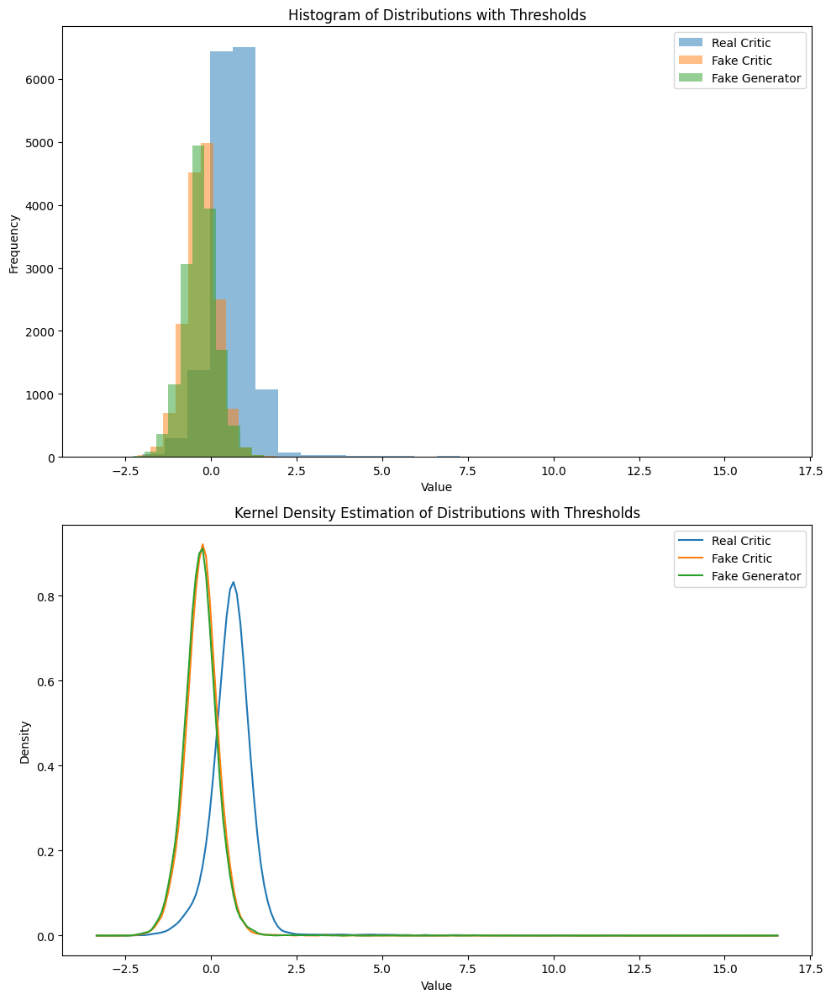

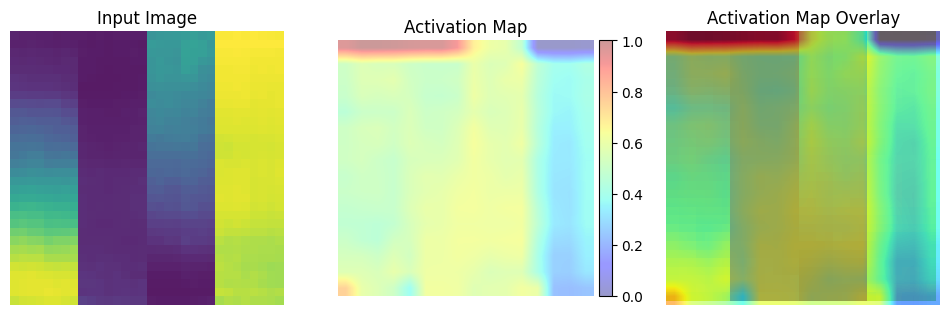

	MNSE Score: 0.011246040359967284
Batch [0/63] -  Critic loss:  -0.8409298459688822 - generator loss:  54.47978210449219
Batch [21/63] -  Critic loss:  -0.8480243488694683 - generator loss:  51.89347839355469
Batch [42/63] -  Critic loss:  -0.8204731218112532 - generator loss:  51.564064469448354
	Epoch 23 - critic loss: -0.8316194224294532 - generator loss: 50.817711481972346


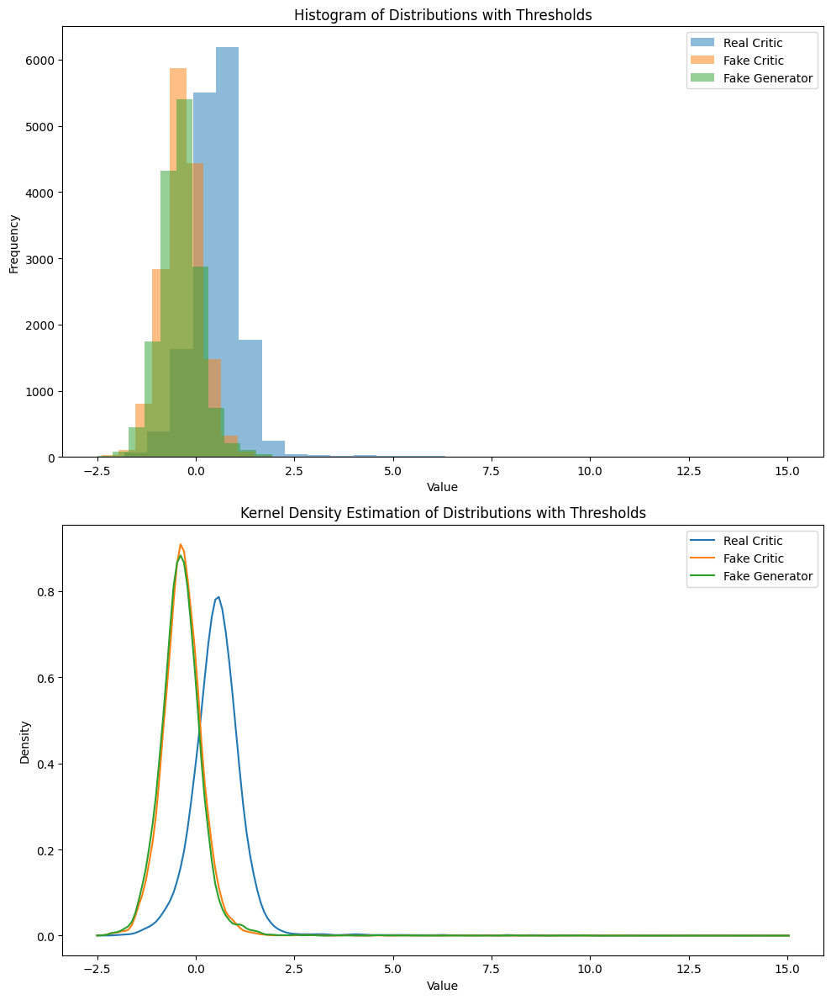

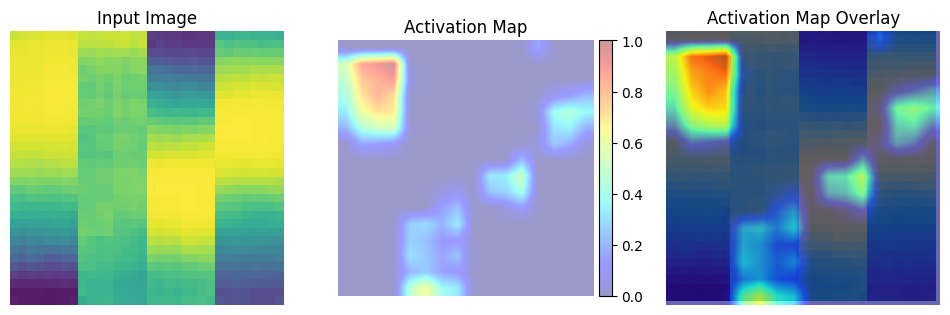

	MNSE Score: 0.010816217429699406
Batch [0/63] -  Critic loss:  -0.9048150181770325 - generator loss:  48.446006774902344
Batch [21/63] -  Critic loss:  -0.8422470824284987 - generator loss:  50.046757437966086
Batch [42/63] -  Critic loss:  -0.835250013096388 - generator loss:  49.73993656247161
	Epoch 24 - critic loss: -0.8434100743954773 - generator loss: 49.96433633471292


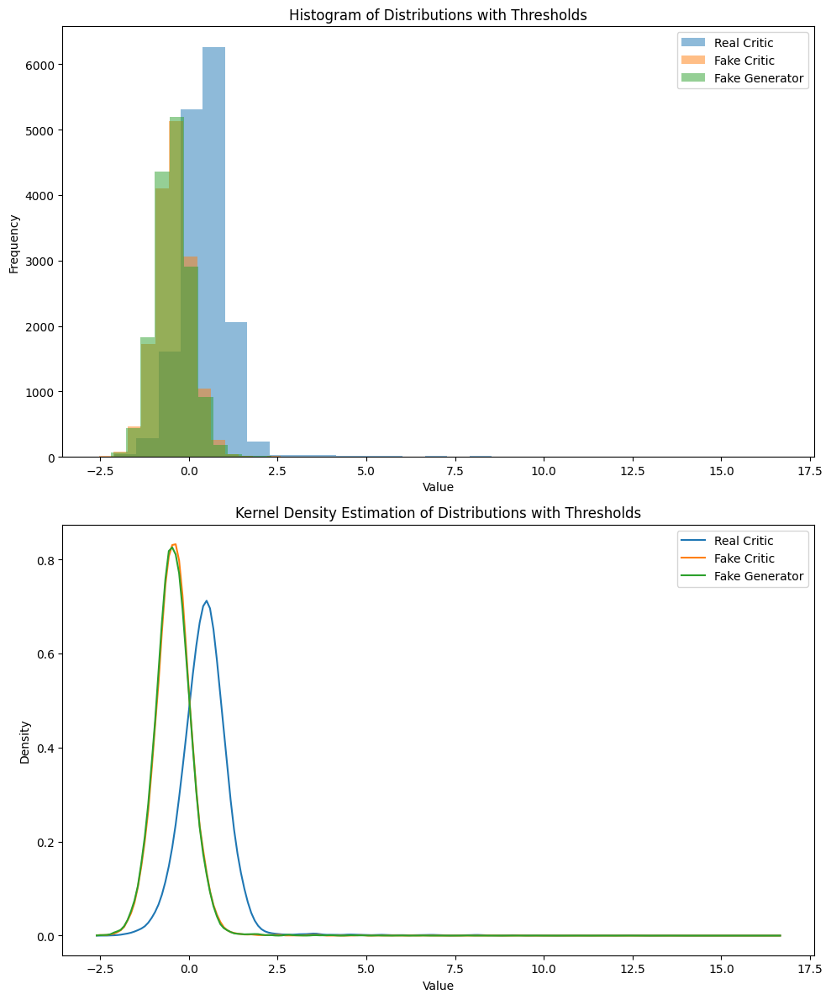

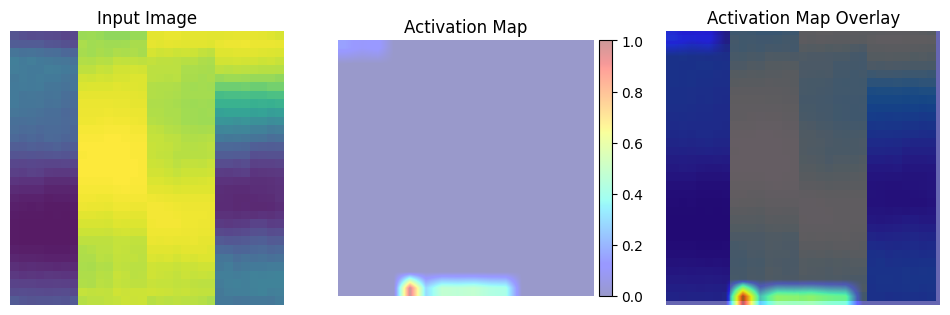

	MNSE Score: 0.010420650169844664
Batch [0/63] -  Critic loss:  -0.9553678631782532 - generator loss:  49.99866485595703
Batch [21/63] -  Critic loss:  -0.8491367246165418 - generator loss:  49.93614439530806
Batch [42/63] -  Critic loss:  -0.8569564569828119 - generator loss:  49.740205188130226
	Epoch 25 - critic loss: -0.8429989168252892 - generator loss: 49.20394655257937


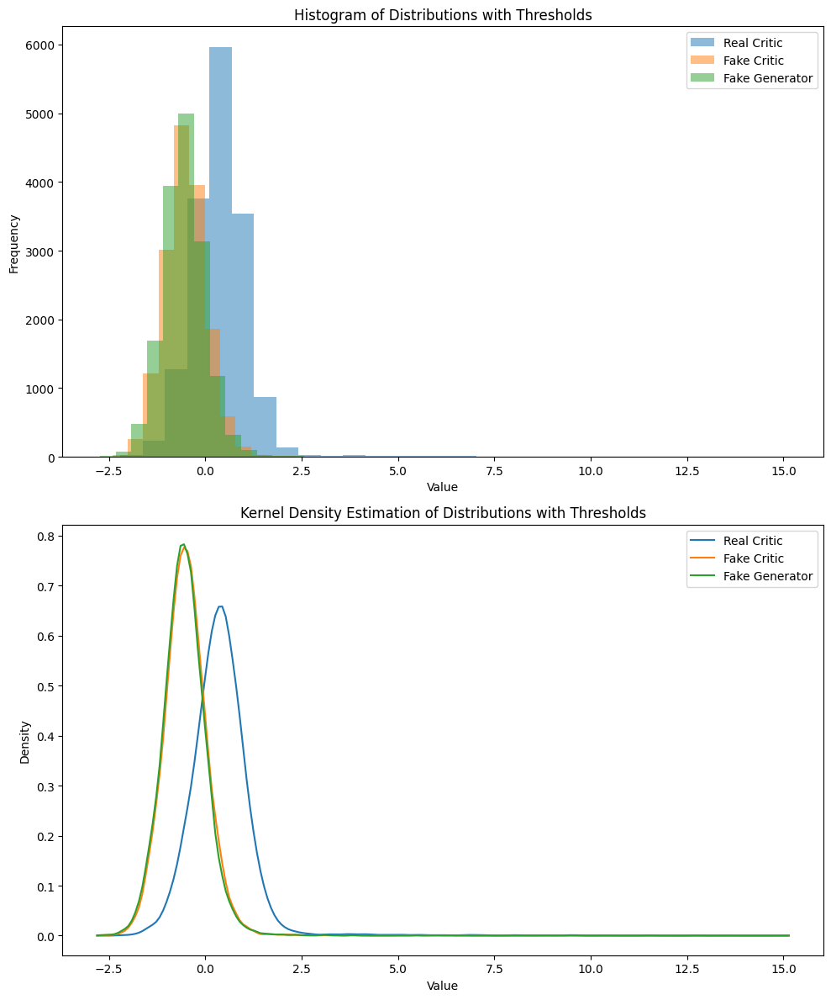

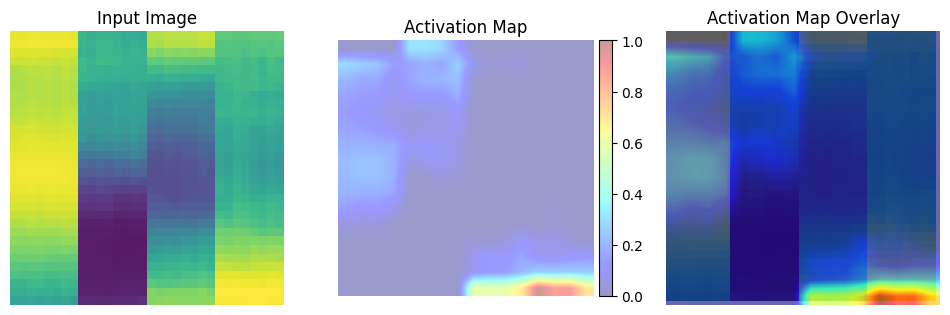

	MNSE Score: 0.010052532933297612
Batch [0/63] -  Critic loss:  -0.8348020513852438 - generator loss:  49.00291061401367
Batch [21/63] -  Critic loss:  -0.8523331943786506 - generator loss:  48.34566116333008
Batch [42/63] -  Critic loss:  -0.8511182319286259 - generator loss:  48.514104443927145
	Epoch 26 - critic loss: -0.8488764802299479 - generator loss: 48.44699877784366


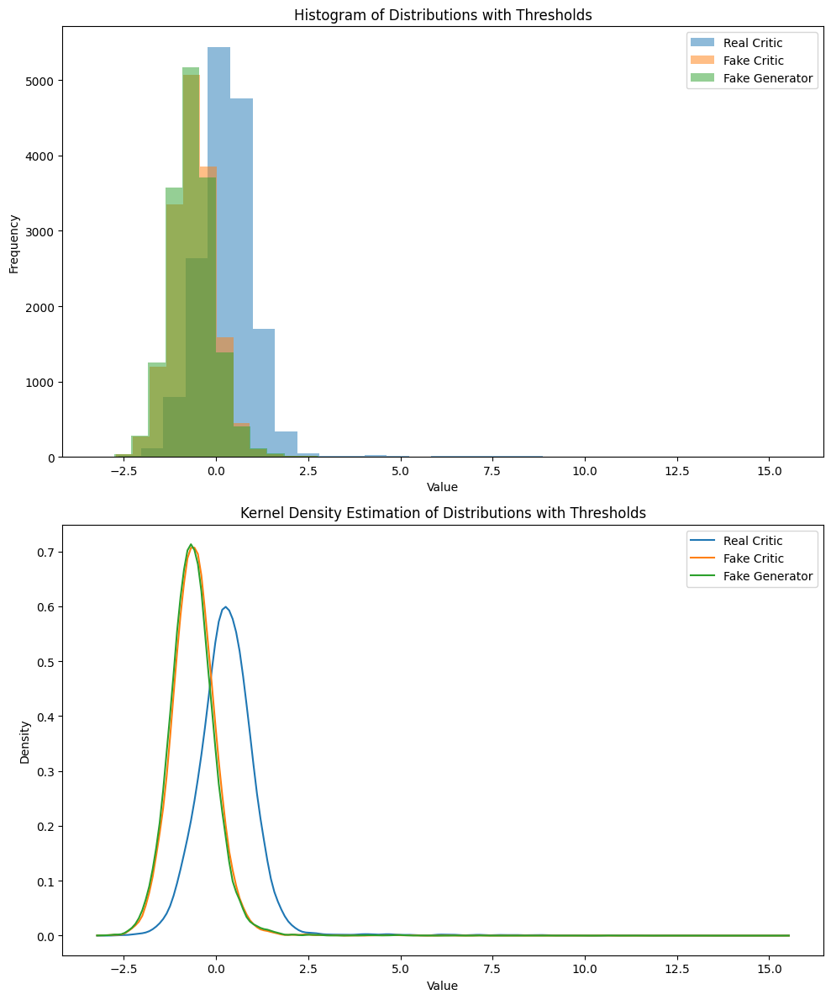

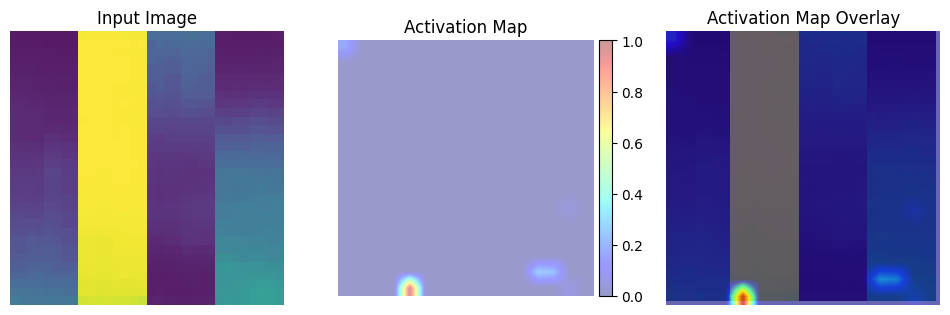

	MNSE Score: 0.009705650280155832
Batch [0/63] -  Critic loss:  -0.7537543972333273 - generator loss:  46.09370040893555
Batch [21/63] -  Critic loss:  -0.8624031480514642 - generator loss:  49.22224391590465
Batch [42/63] -  Critic loss:  -0.8599187117214353 - generator loss:  49.48305830844613
	Epoch 27 - critic loss: -0.86458997530912 - generator loss: 49.29998470488049
Batch [0/63] -  Critic loss:  -0.8477897644042969 - generator loss:  45.498172760009766
Batch [21/63] -  Critic loss:  -0.84849033482147 - generator loss:  46.496825131503016
Batch [42/63] -  Critic loss:  -0.8627389577008033 - generator loss:  47.27359053146007
	Epoch 28 - critic loss: -0.8593210240520496 - generator loss: 47.3186406332349


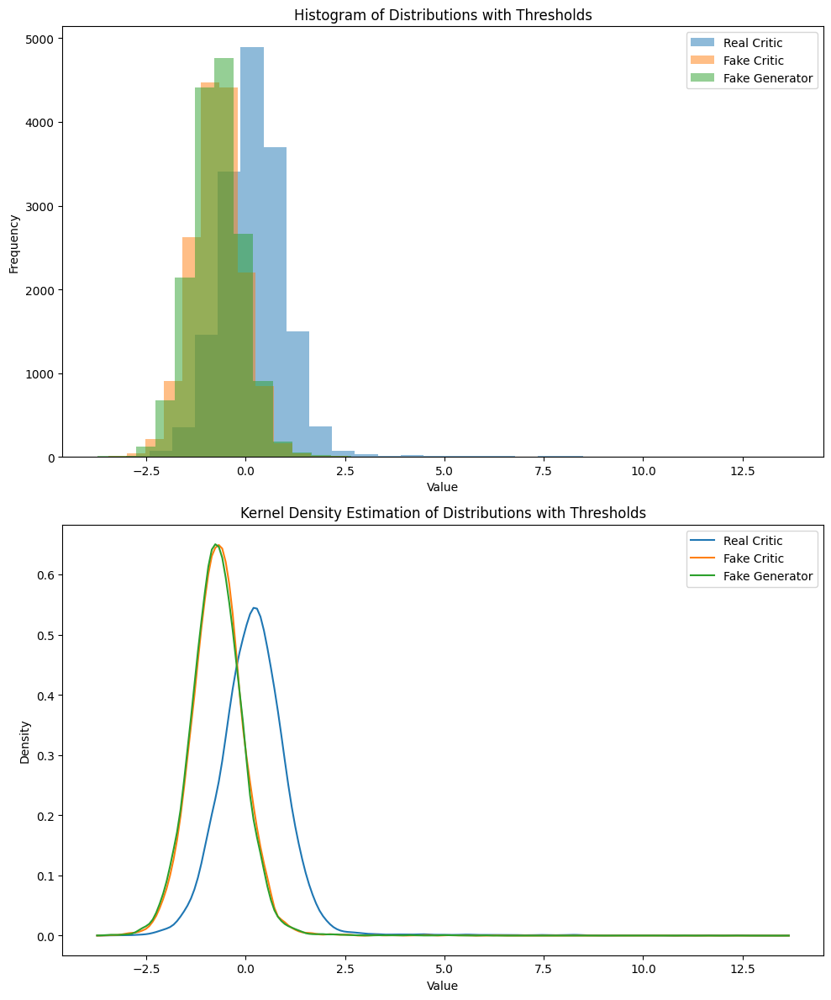

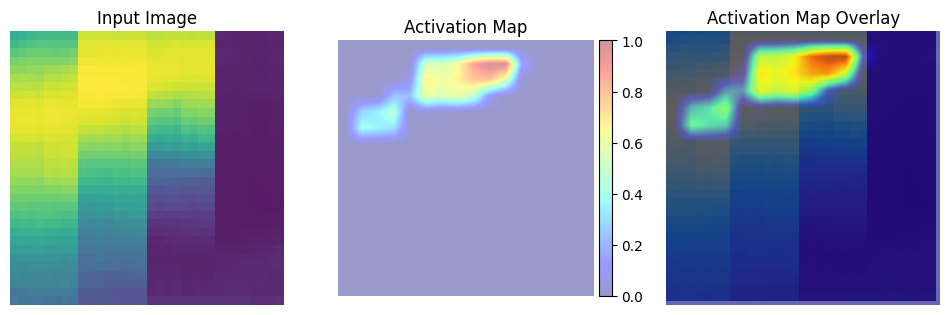

	MNSE Score: 0.009221823871253974
Batch [0/63] -  Critic loss:  -0.8916544914245605 - generator loss:  45.902400970458984
Batch [21/63] -  Critic loss:  -0.8270794997612636 - generator loss:  48.261405598033555
Batch [42/63] -  Critic loss:  -0.843950520883235 - generator loss:  48.182177965031116
	Epoch 29 - critic loss: -0.8509810044967308 - generator loss: 47.48870298597548


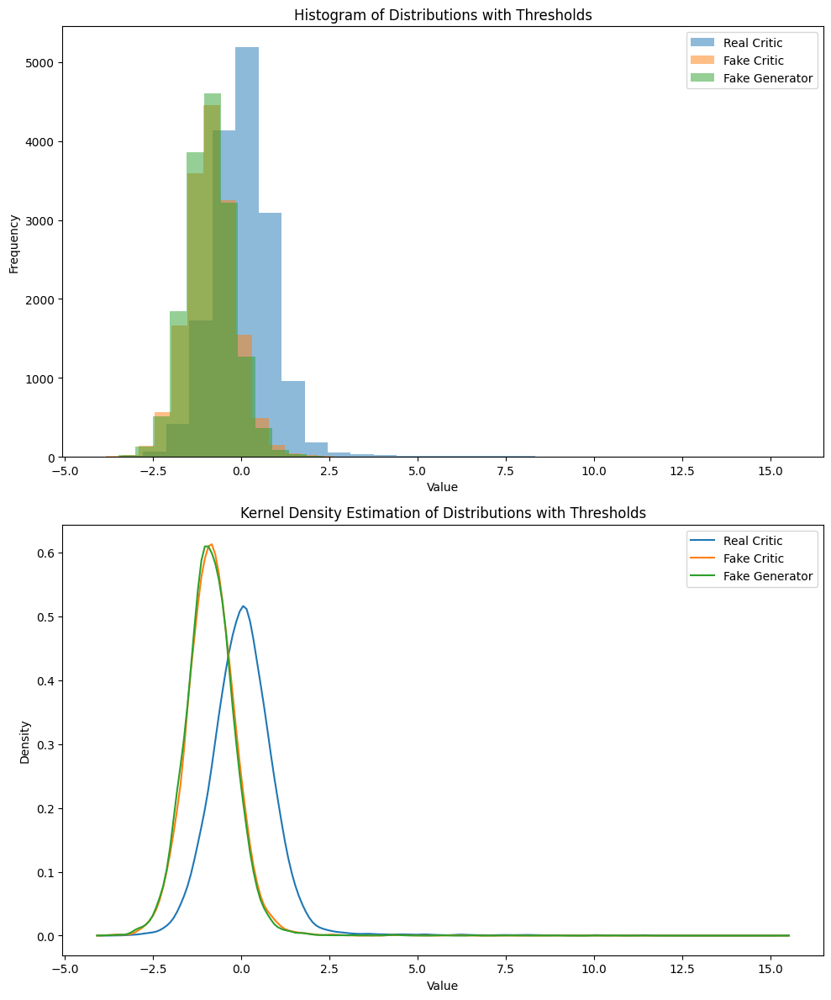

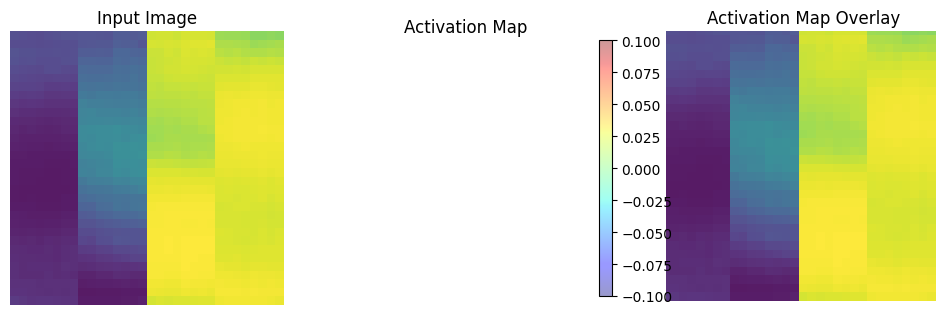

	MNSE Score: 0.009220604193470781
Batch [0/63] -  Critic loss:  -1.030640721321106 - generator loss:  47.23613739013672
Batch [21/63] -  Critic loss:  -0.8645502085035498 - generator loss:  46.95600006797097
Batch [42/63] -  Critic loss:  -0.8614988955416419 - generator loss:  47.20769935430482
	Epoch 30 - critic loss: -0.8628524500856956 - generator loss: 47.15231520032126


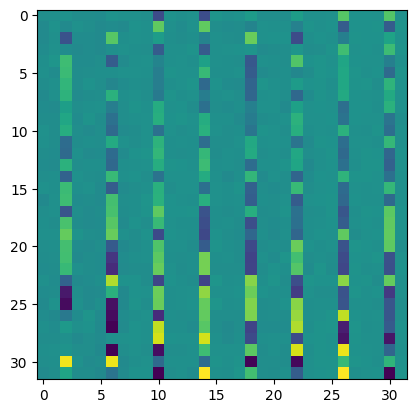

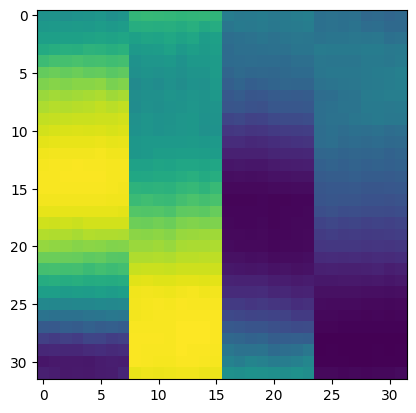

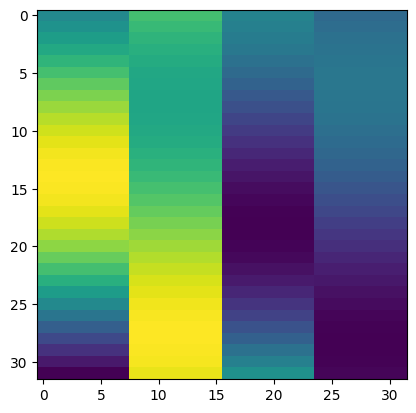

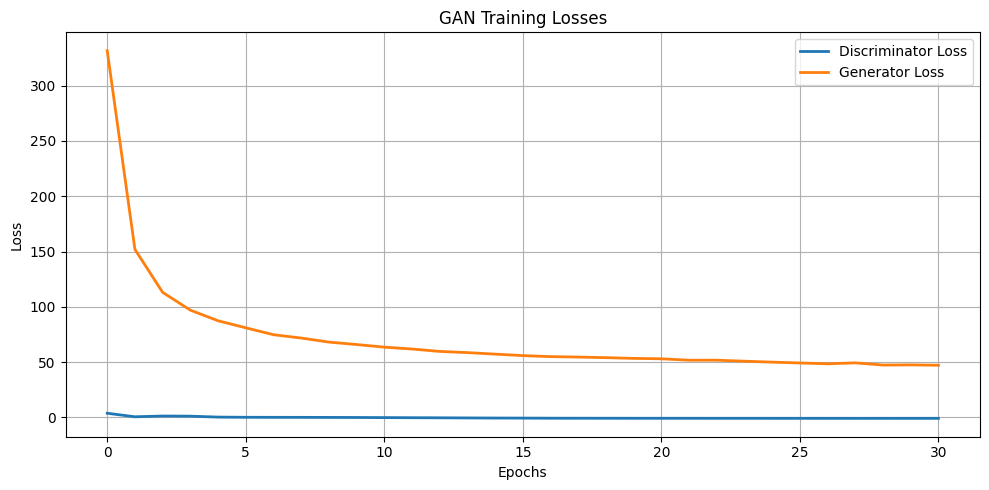

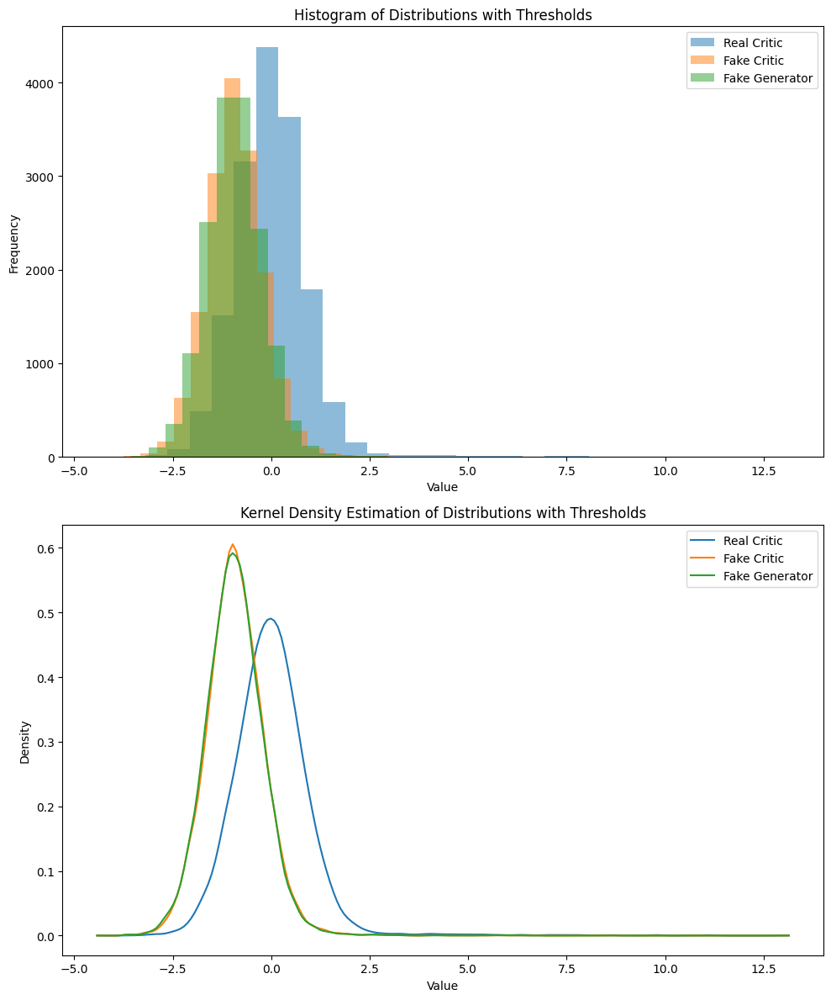

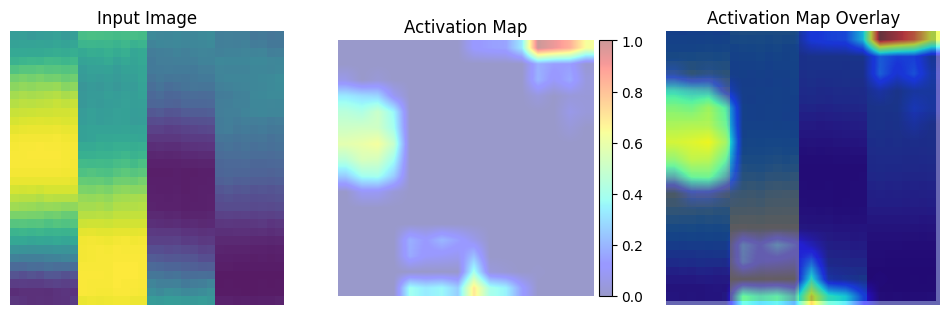

	MNSE Score: 0.009080358610917178
Batch [0/63] -  Critic loss:  -0.9517200986544291 - generator loss:  44.7965087890625
Batch [21/63] -  Critic loss:  -0.8599315583705902 - generator loss:  46.43841535394842
Batch [42/63] -  Critic loss:  -0.862030229365179 - generator loss:  46.890960782073265
	Epoch 31 - critic loss: -0.8647964700819953 - generator loss: 47.17406160869296


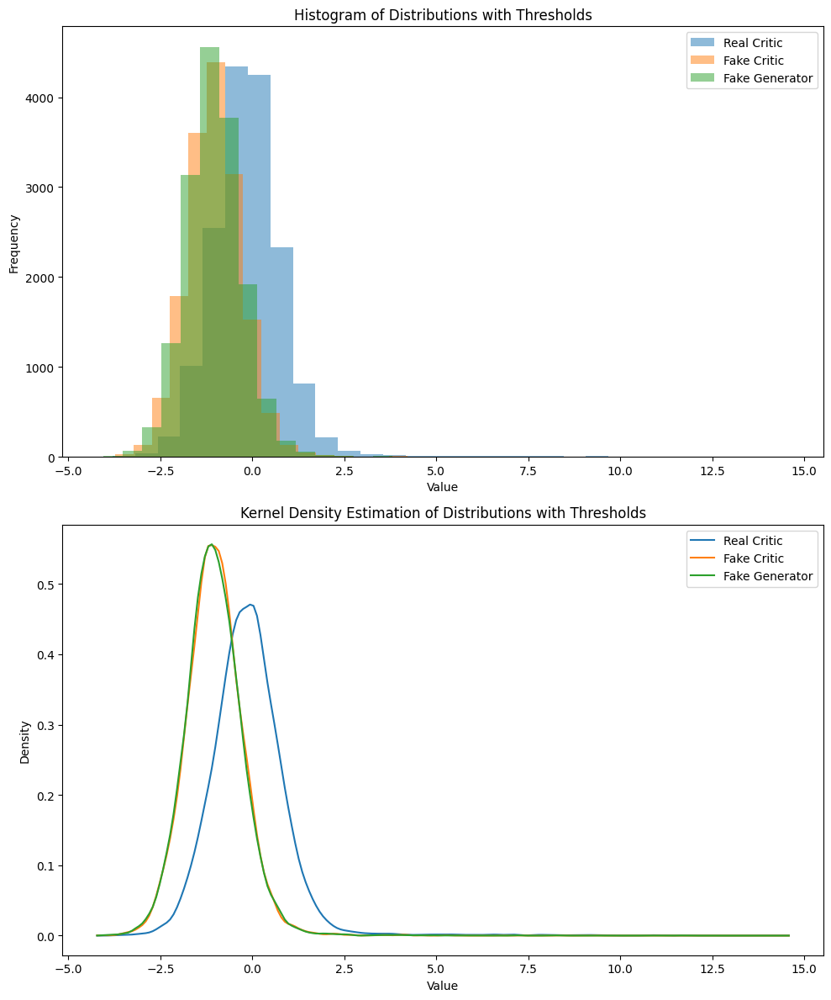

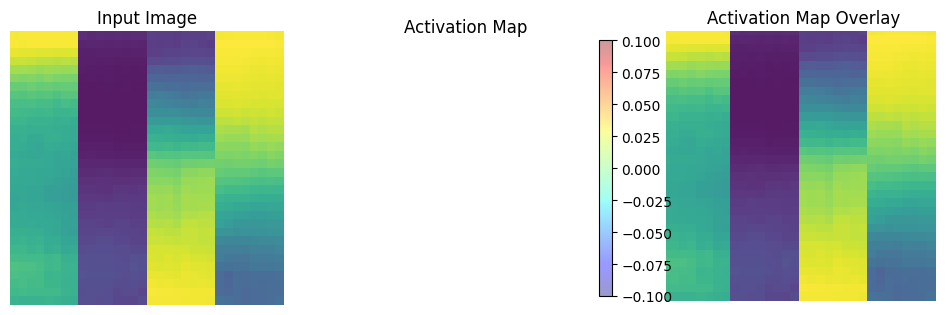

	MNSE Score: 0.009040964272109762
Batch [0/63] -  Critic loss:  -0.8198173840840658 - generator loss:  42.52859878540039
Batch [21/63] -  Critic loss:  -0.8389619155363605 - generator loss:  46.68735122680664
Batch [42/63] -  Critic loss:  -0.8493456618730412 - generator loss:  46.829211833865145
	Epoch 32 - critic loss: -0.8577987141710108 - generator loss: 46.3010121300107


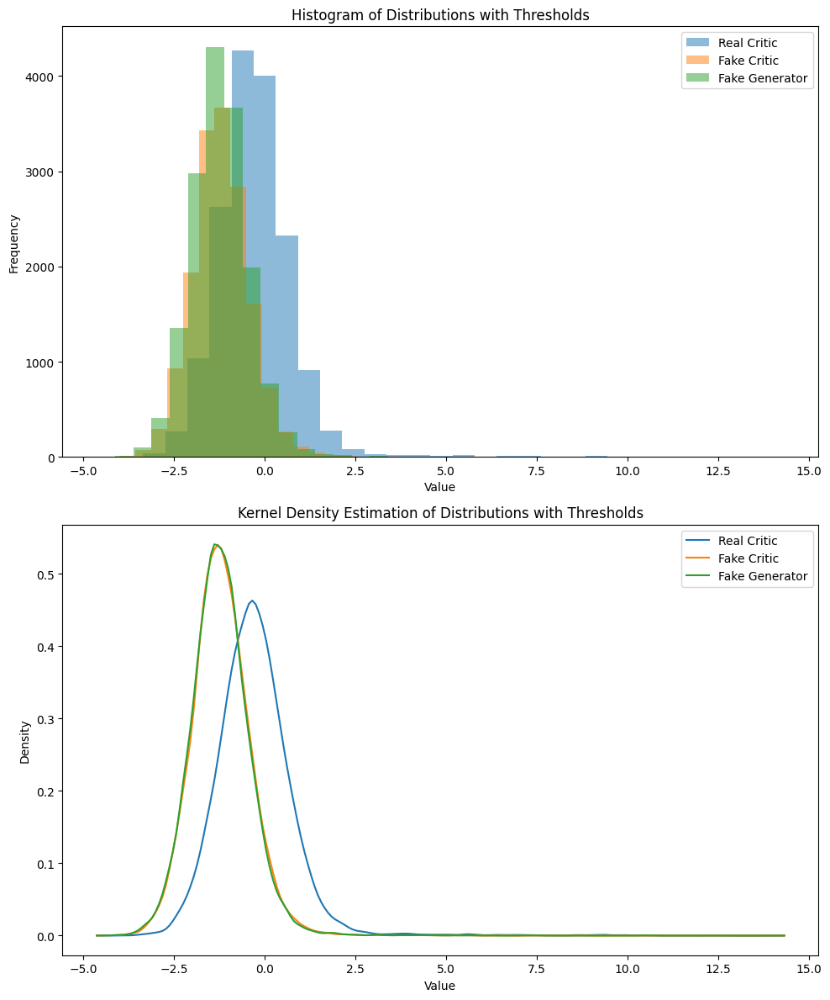

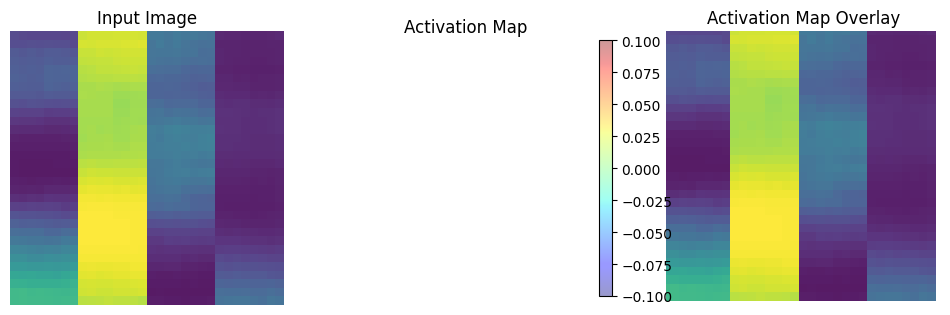

	MNSE Score: 0.008621411161526801
Batch [0/63] -  Critic loss:  -0.7668003837267557 - generator loss:  49.89561462402344
Batch [21/63] -  Critic loss:  -0.8577343189355099 - generator loss:  45.95932873812589
Batch [42/63] -  Critic loss:  -0.8591352211412533 - generator loss:  45.98300898352335
	Epoch 33 - critic loss: -0.8617682441201794 - generator loss: 46.12593417697482


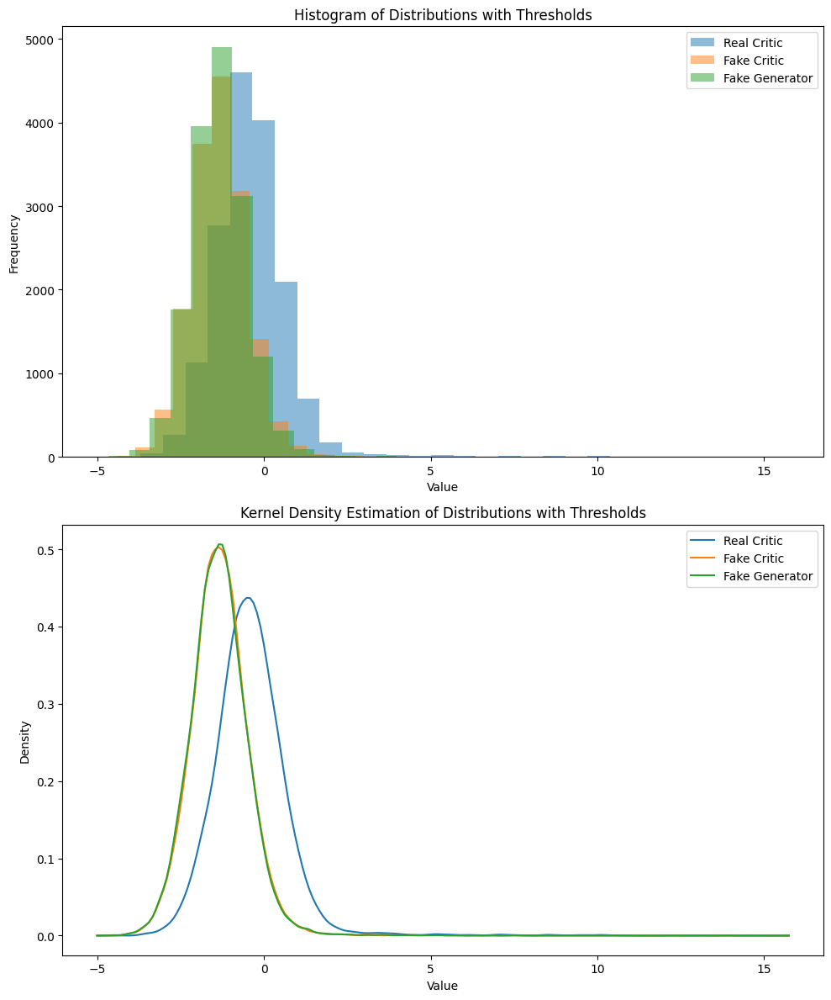

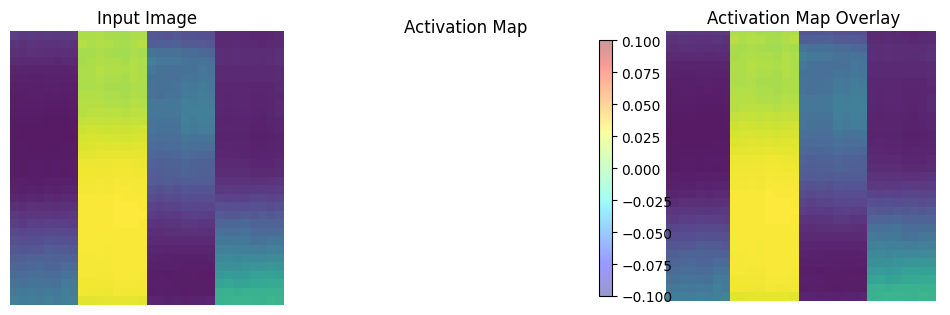

	MNSE Score: 0.008521218702847522
Batch [0/63] -  Critic loss:  -0.929568370183309 - generator loss:  48.03091049194336
Batch [21/63] -  Critic loss:  -0.8578517563415297 - generator loss:  45.62488434531472
Batch [42/63] -  Critic loss:  -0.8616904343745504 - generator loss:  45.829124450683594
	Epoch 34 - critic loss: -0.8642204889544733 - generator loss: 46.027340540810236


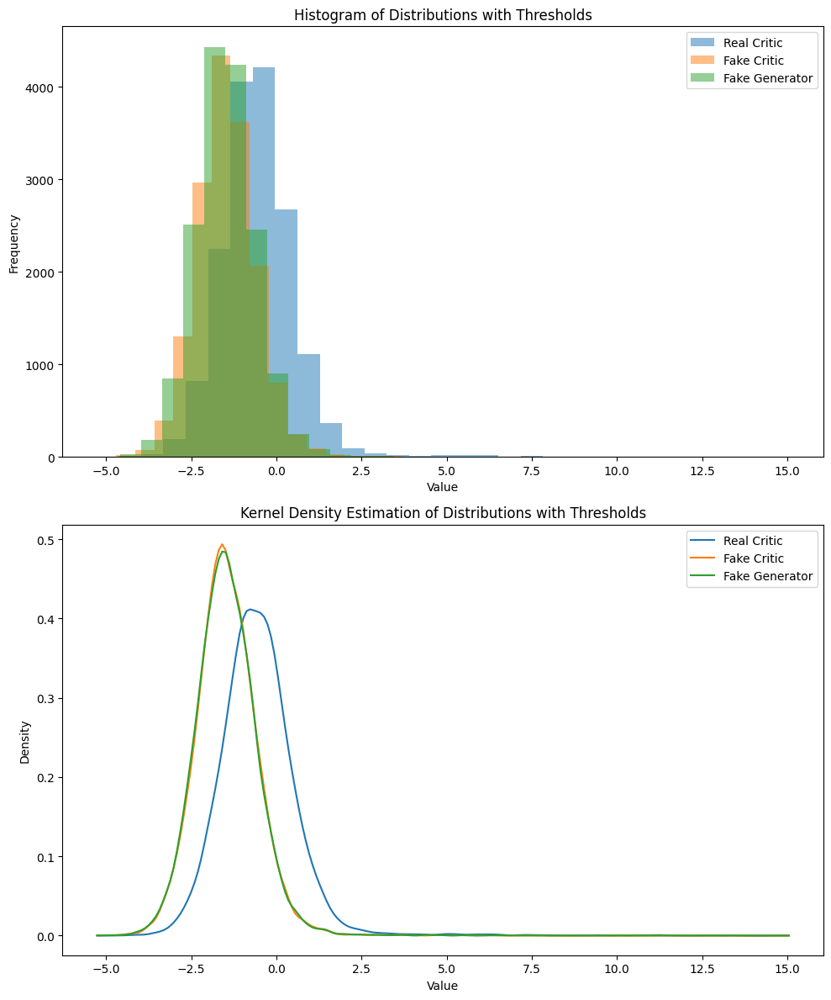

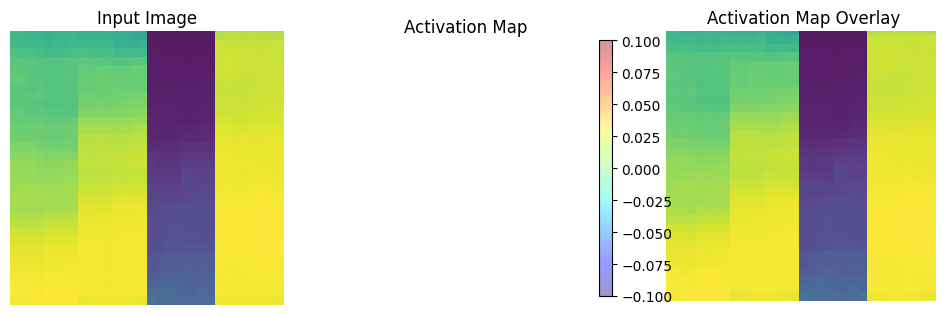

	MNSE Score: 0.008438679071823283
Batch [0/63] -  Critic loss:  -0.9887601931889852 - generator loss:  46.775238037109375
Batch [21/63] -  Critic loss:  -0.8684170390620376 - generator loss:  46.8073375008323
Batch [42/63] -  Critic loss:  -0.8647054516991902 - generator loss:  46.211897650430366
	Epoch 35 - critic loss: -0.8637080132645905 - generator loss: 46.06967762538365


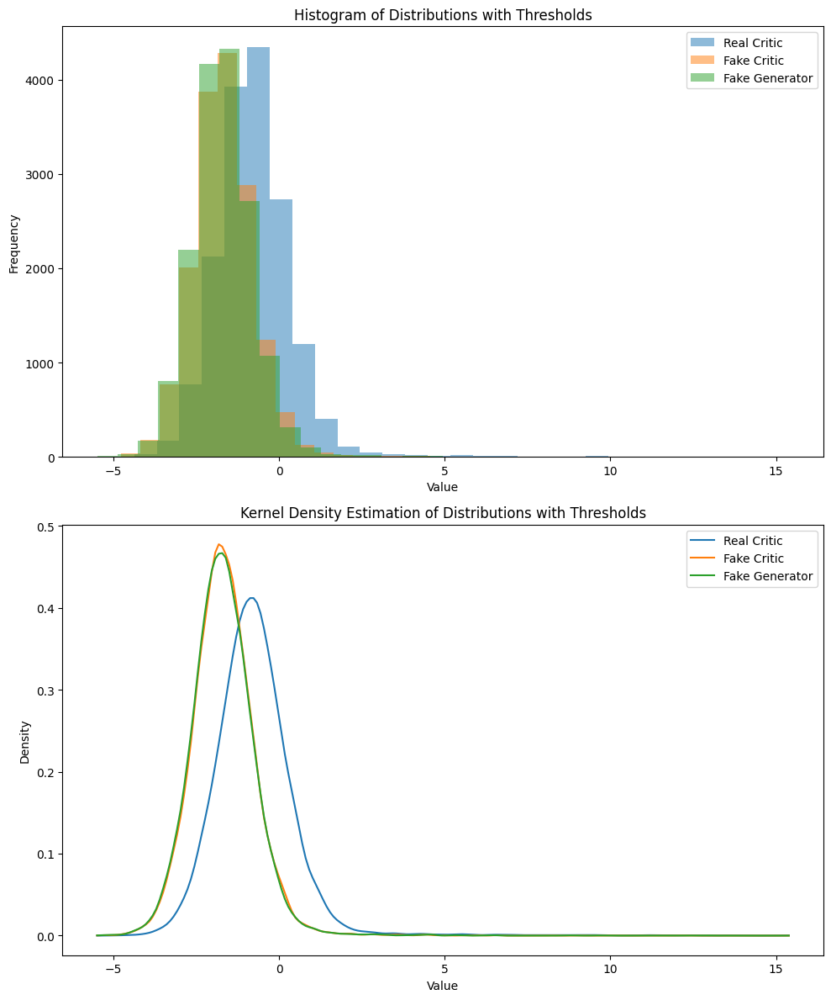

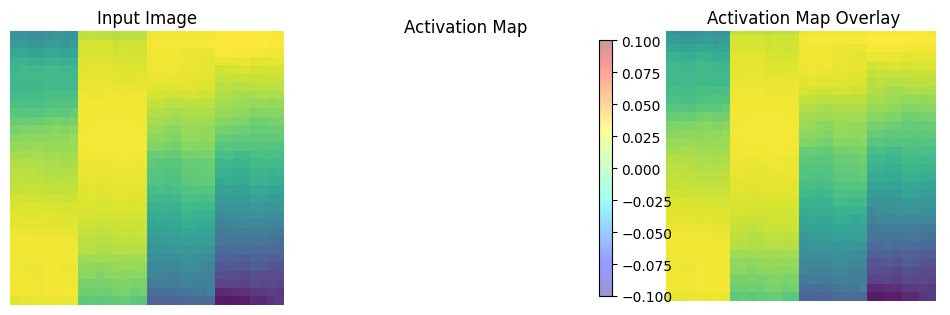

	MNSE Score: 0.008406390805566122
Batch [0/63] -  Critic loss:  -0.702044685681661 - generator loss:  48.55467224121094
Batch [21/63] -  Critic loss:  -0.8593762426665336 - generator loss:  45.9976130398837
Batch [42/63] -  Critic loss:  -0.857300813345946 - generator loss:  46.05032171205033
	Epoch 36 - critic loss: -0.8634734447040255 - generator loss: 45.75796351357112


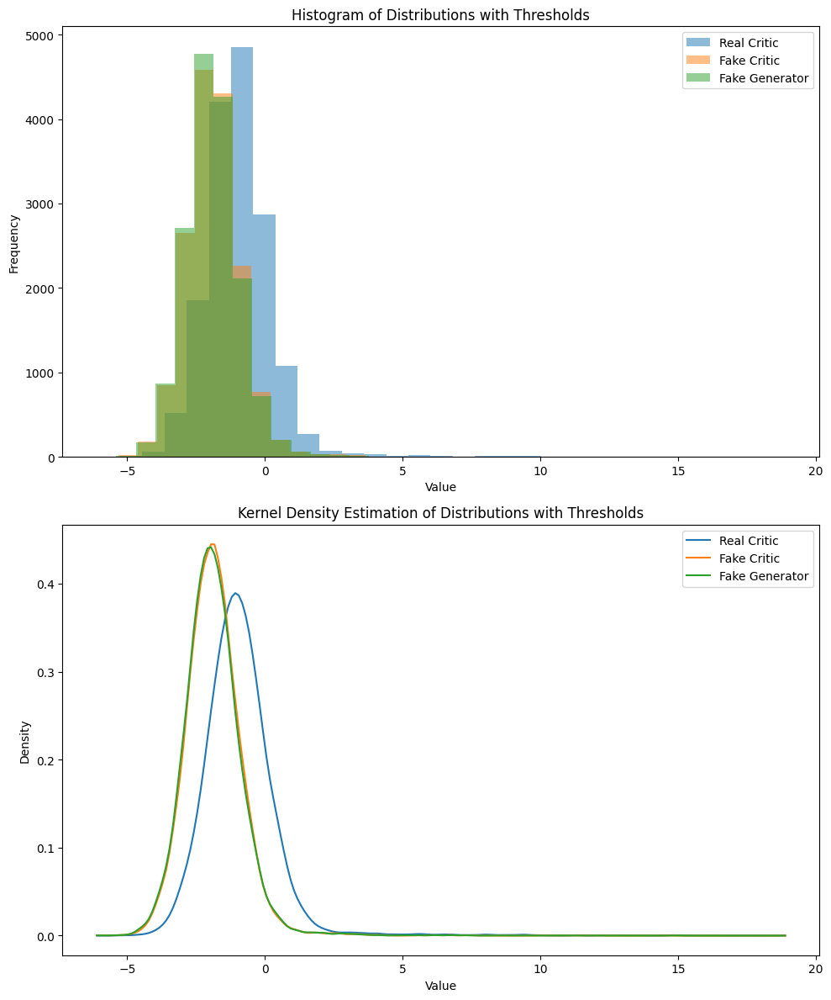

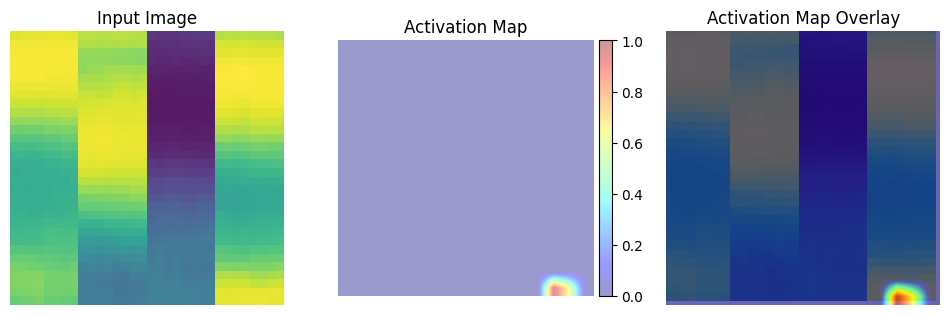

	MNSE Score: 0.008174051501093403
Batch [0/63] -  Critic loss:  -0.8295298218727112 - generator loss:  43.65761184692383
Batch [21/63] -  Critic loss:  -0.8576719498995579 - generator loss:  45.08894521539862
Batch [42/63] -  Critic loss:  -0.8657066651092944 - generator loss:  45.5869035055471
	Epoch 37 - critic loss: -0.8631948708857178 - generator loss: 45.285645167032875


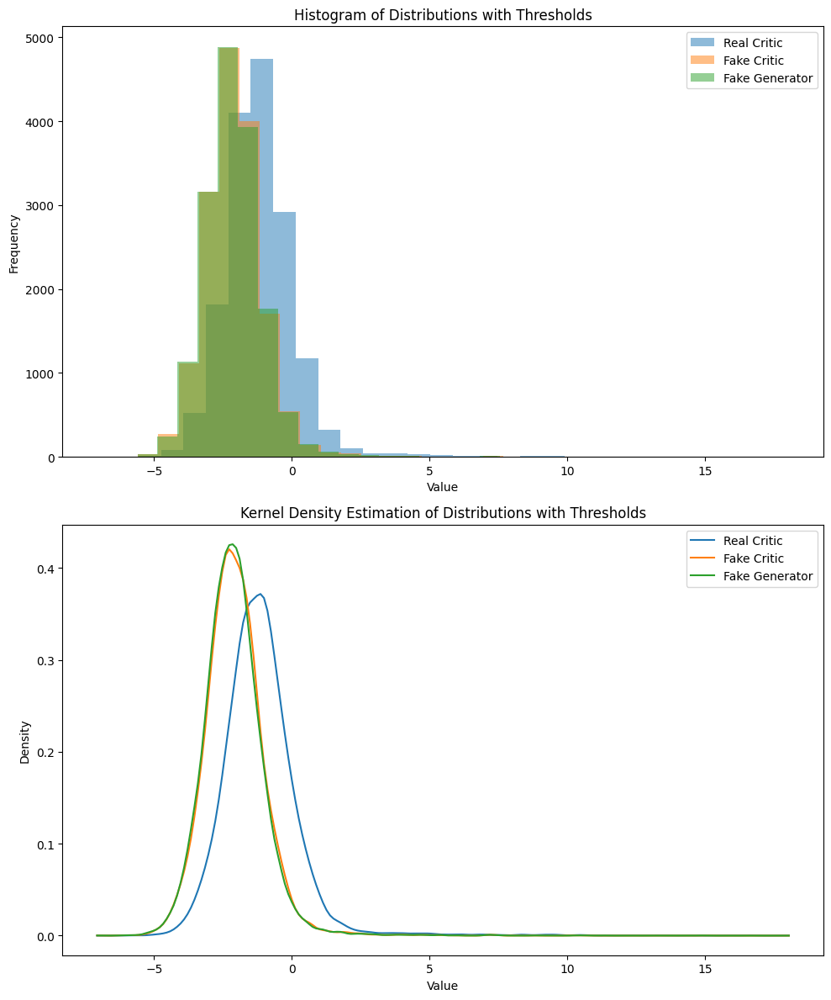

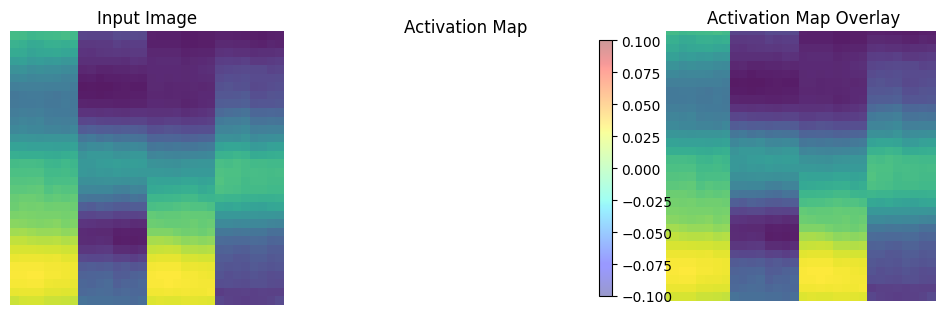

	MNSE Score: 0.007903612817504577
Batch [0/63] -  Critic loss:  -0.9216288924217224 - generator loss:  44.09601593017578
Batch [21/63] -  Critic loss:  -0.2448292732464545 - generator loss:  45.42738342285156
Batch [42/63] -  Critic loss:  -0.34486413539149047 - generator loss:  44.80976415234943
	Epoch 38 - critic loss: -0.4349334352309741 - generator loss: 44.0506100124783


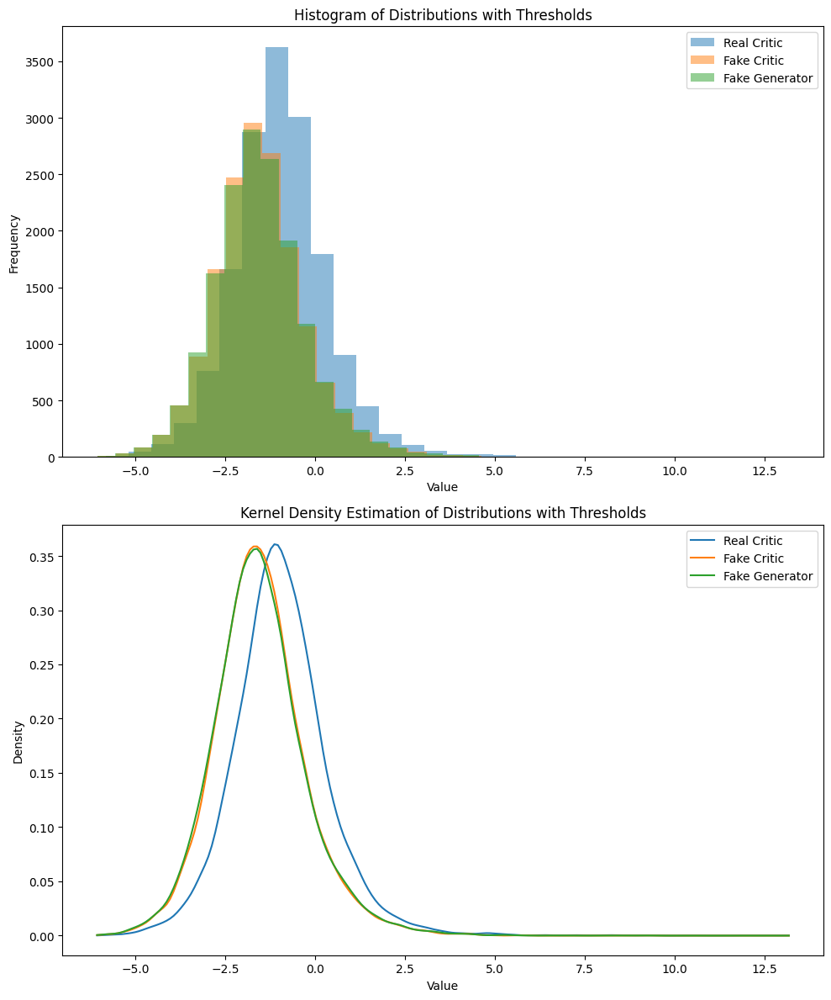

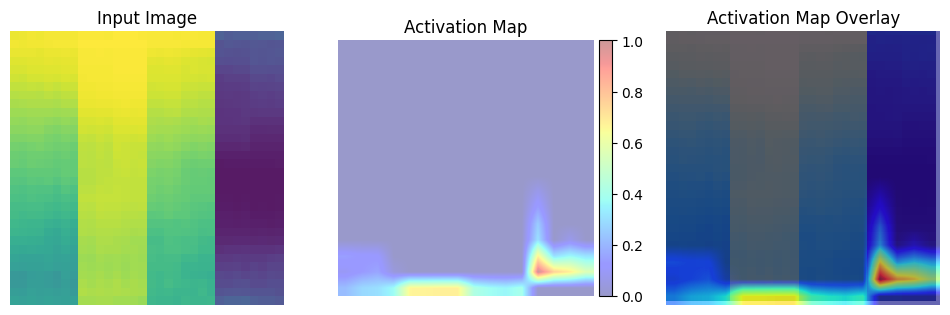

	MNSE Score: 0.007685830816626549
Batch [0/63] -  Critic loss:  -0.6637899279594421 - generator loss:  41.878746032714844
Batch [21/63] -  Critic loss:  -0.721188586769682 - generator loss:  44.36319489912553
Batch [42/63] -  Critic loss:  -0.7560425955195761 - generator loss:  44.52058171117029
	Epoch 39 - critic loss: -0.7734964821073748 - generator loss: 44.566547091045074
Batch [0/63] -  Critic loss:  -0.8794379631678263 - generator loss:  42.293827056884766
Batch [21/63] -  Critic loss:  -0.8250749689159971 - generator loss:  45.68218716708097
Batch [42/63] -  Critic loss:  -0.8218886977018312 - generator loss:  44.69061084126317
	Epoch 40 - critic loss: -0.8216207304959574 - generator loss: 44.12153994847858


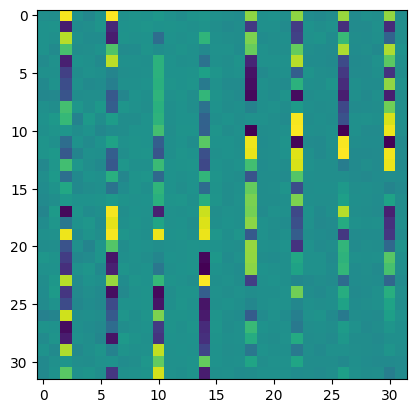

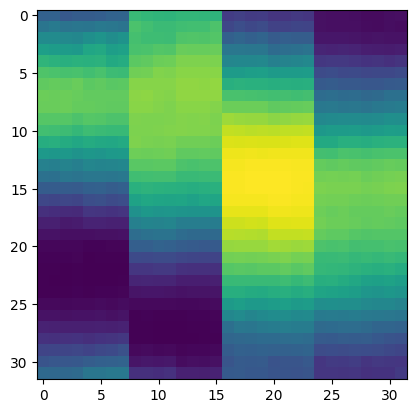

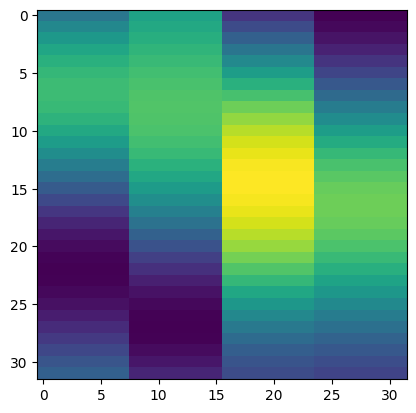

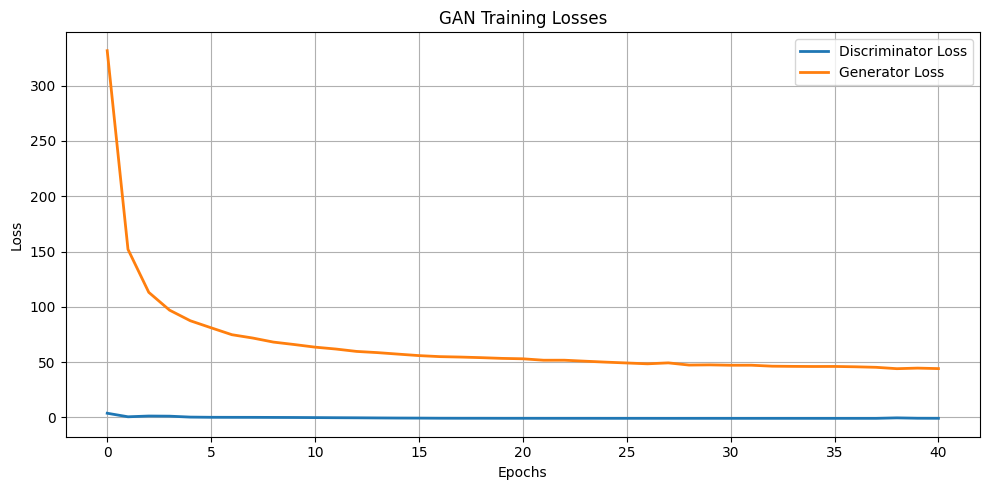

Batch [0/63] -  Critic loss:  -0.9140599171320597 - generator loss:  44.30615997314453
Batch [21/63] -  Critic loss:  -0.8236084345615272 - generator loss:  42.650453394109554
Batch [42/63] -  Critic loss:  -0.8310048691062042 - generator loss:  42.89946569398392
	Epoch 41 - critic loss: -0.8365138217254923 - generator loss: 43.32644792587038


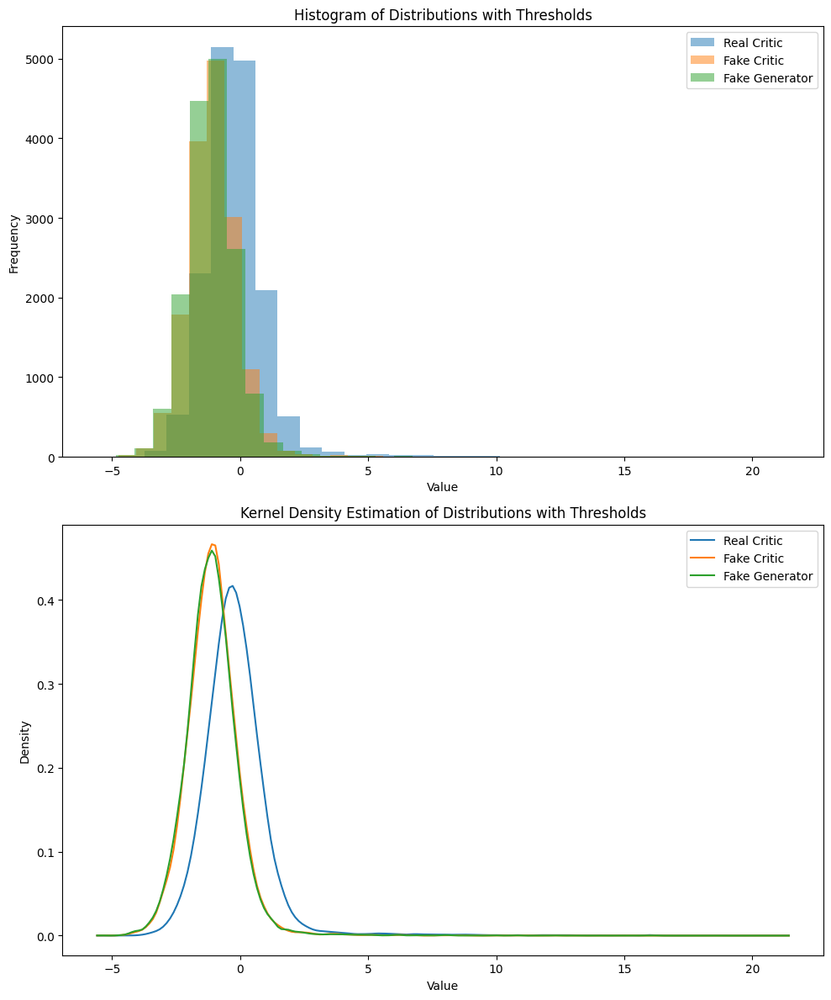

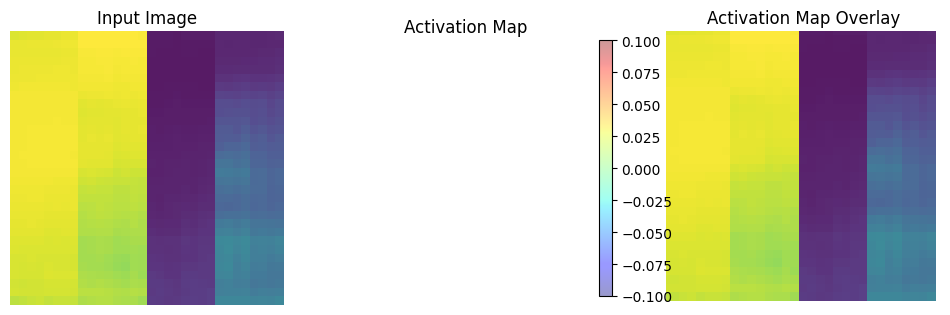

	MNSE Score: 0.007597930278510801
Batch [0/63] -  Critic loss:  -1.0025275945663452 - generator loss:  51.85953903198242
Batch [21/63] -  Critic loss:  -0.8396911783651873 - generator loss:  43.21376609802246
Batch [42/63] -  Critic loss:  -0.8410231230794921 - generator loss:  43.81073645658271
	Epoch 42 - critic loss: -0.8389469605905038 - generator loss: 43.423265608530194


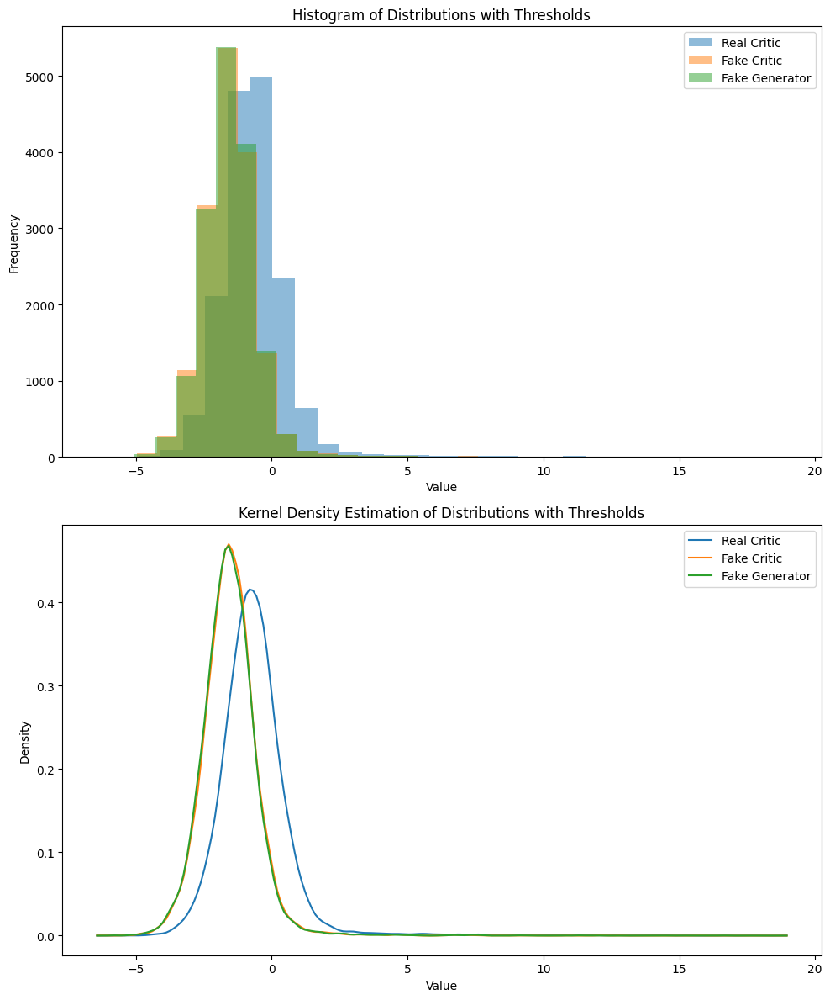

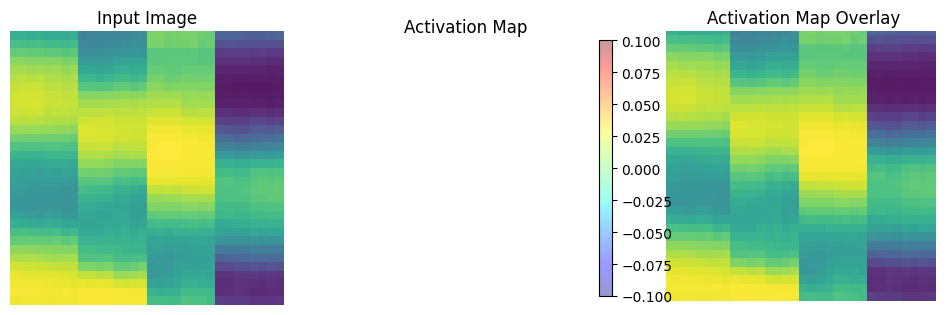

	MNSE Score: 0.0074550303009649115
Batch [0/63] -  Critic loss:  -0.8668980201085409 - generator loss:  38.672237396240234
Batch [21/63] -  Critic loss:  -0.8414690133297082 - generator loss:  44.46586088700728
Batch [42/63] -  Critic loss:  -0.8389231872188951 - generator loss:  43.881362471469615
	Epoch 43 - critic loss: -0.8455664247432083 - generator loss: 43.56703609890408


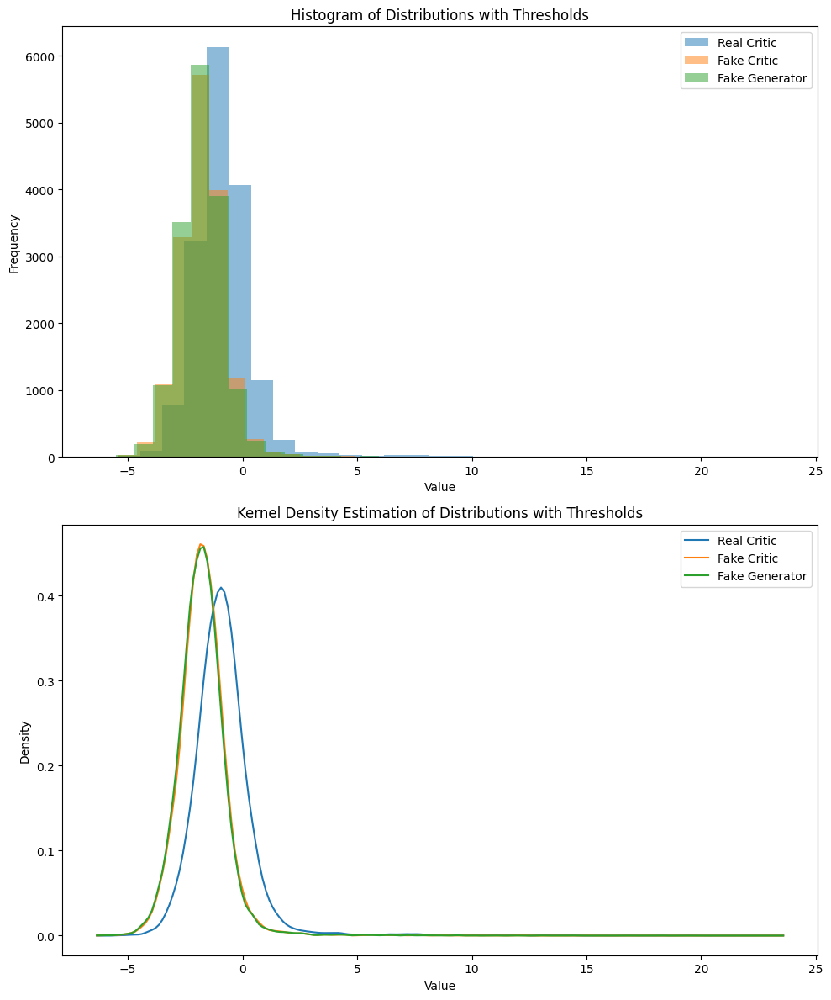

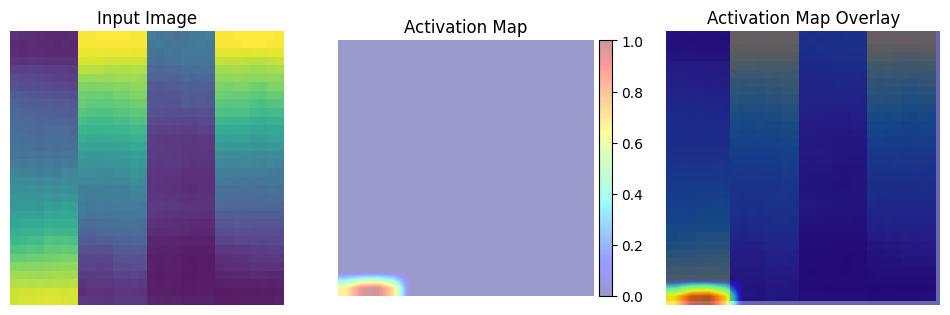

	MNSE Score: 0.0074218290503181164
Batch [0/63] -  Critic loss:  -0.8493746916453043 - generator loss:  43.93156051635742
Batch [21/63] -  Critic loss:  -0.8430681616970989 - generator loss:  43.27200629494407
Batch [42/63] -  Critic loss:  -0.8409236868222554 - generator loss:  42.678129417951716
	Epoch 44 - critic loss: -0.8418404097279544 - generator loss: 42.866454593719


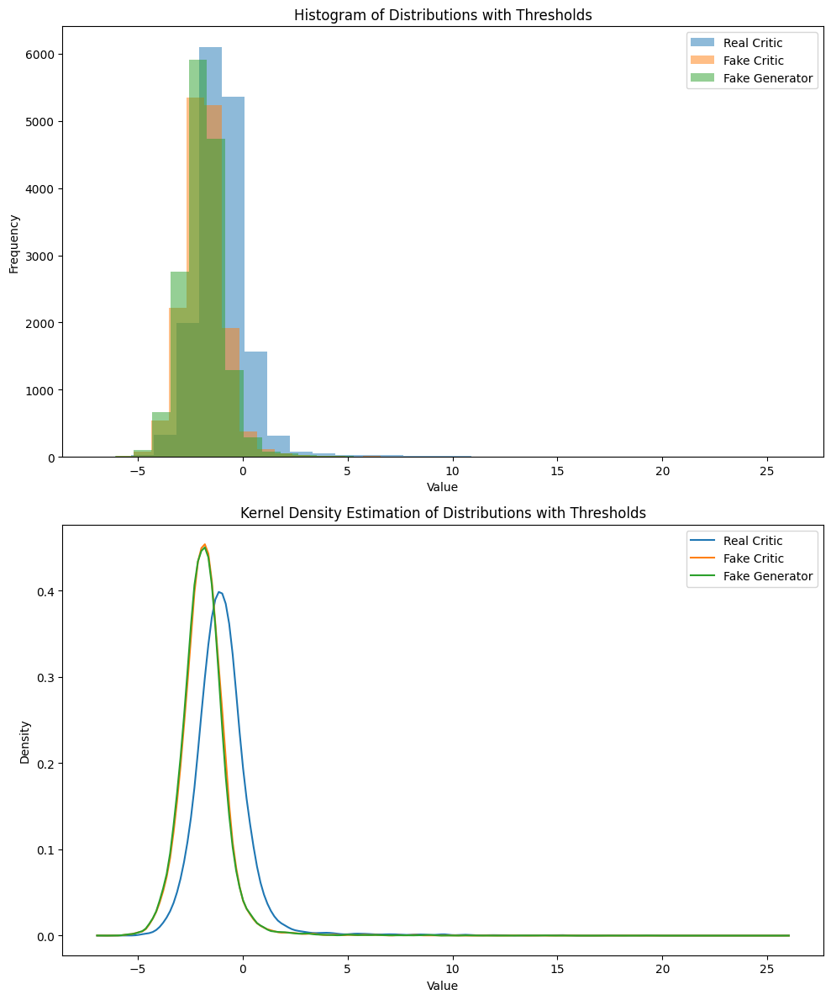

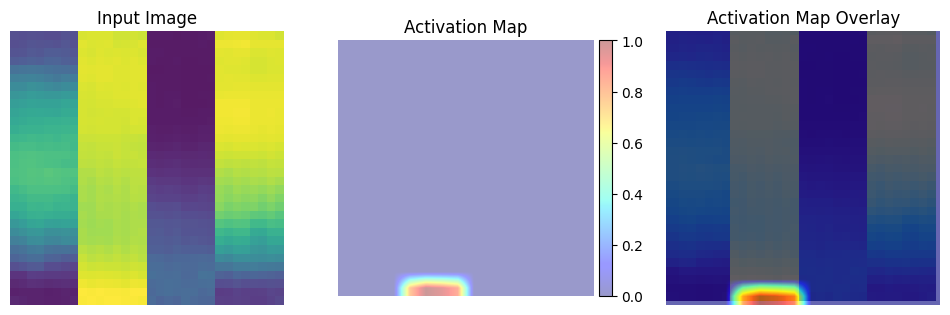

	MNSE Score: 0.007141089539915797
Batch [0/63] -  Critic loss:  -0.9048463702201843 - generator loss:  41.364967346191406
Batch [21/63] -  Critic loss:  -0.8409309793602339 - generator loss:  41.57554782520641
Batch [42/63] -  Critic loss:  -0.8425621852394225 - generator loss:  42.24787769761196
	Epoch 45 - critic loss: -0.8416309750900067 - generator loss: 42.40015820094517


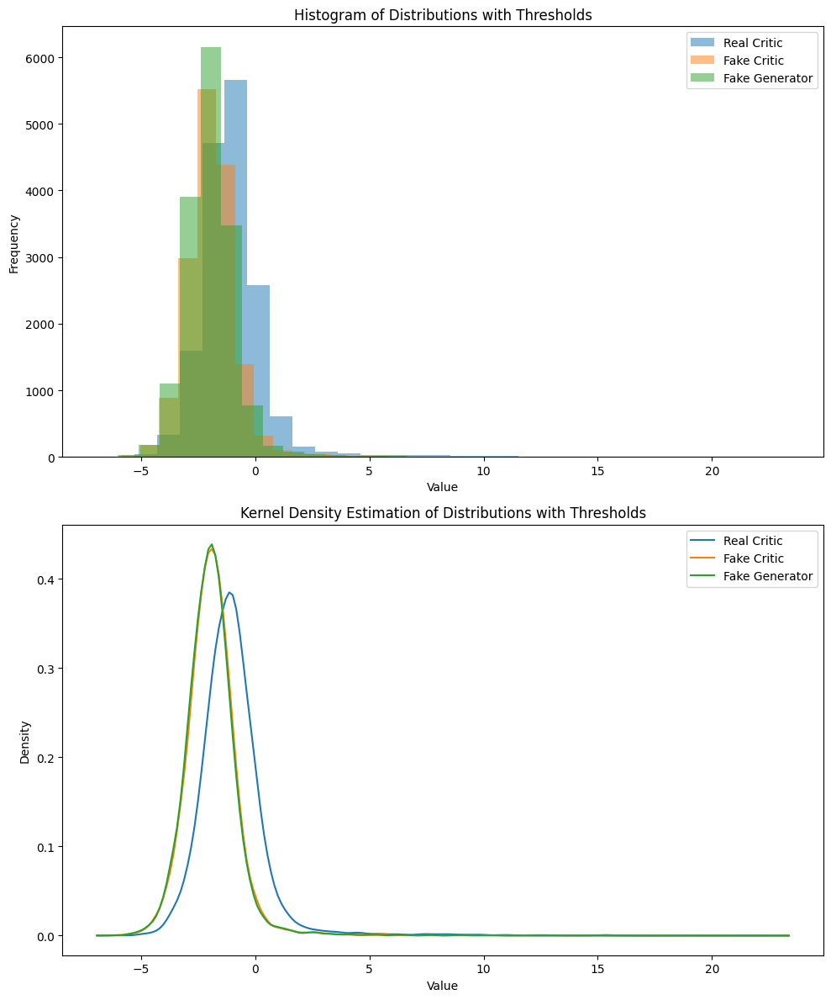

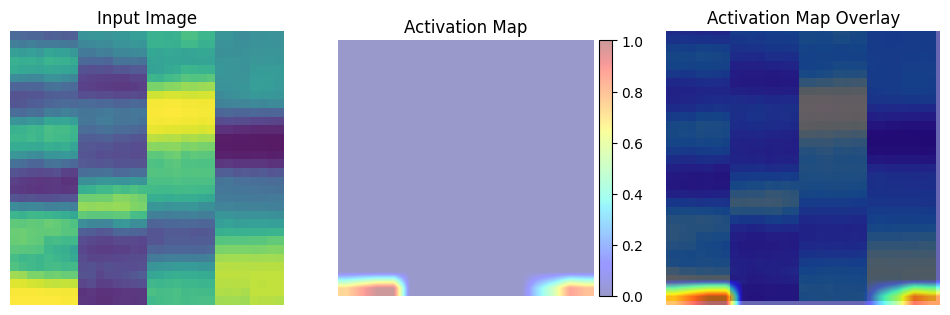

	MNSE Score: 0.006966942544316962
Batch [0/63] -  Critic loss:  -0.7534607251485189 - generator loss:  52.74420928955078
Batch [21/63] -  Critic loss:  -0.8350494368509813 - generator loss:  42.83606251803312
Batch [42/63] -  Critic loss:  -0.8329398955485618 - generator loss:  42.636340562687366
	Epoch 46 - critic loss: -0.8350365587643215 - generator loss: 42.83658666459341
Batch [0/63] -  Critic loss:  -0.8051277200380961 - generator loss:  41.567115783691406
Batch [21/63] -  Critic loss:  -0.8449266570987124 - generator loss:  42.019194169477984
Batch [42/63] -  Critic loss:  -0.8421751847562863 - generator loss:  42.097963909770165
	Epoch 47 - critic loss: -0.8385249291147504 - generator loss: 42.43700905451699
Batch [0/63] -  Critic loss:  -0.824118435382843 - generator loss:  39.69718933105469
Batch [21/63] -  Critic loss:  -0.8437212506930034 - generator loss:  42.39187448674982
Batch [42/63] -  Critic loss:  -0.8409472186436024 - generator loss:  42.29636054815248
	Epoch 48 - 

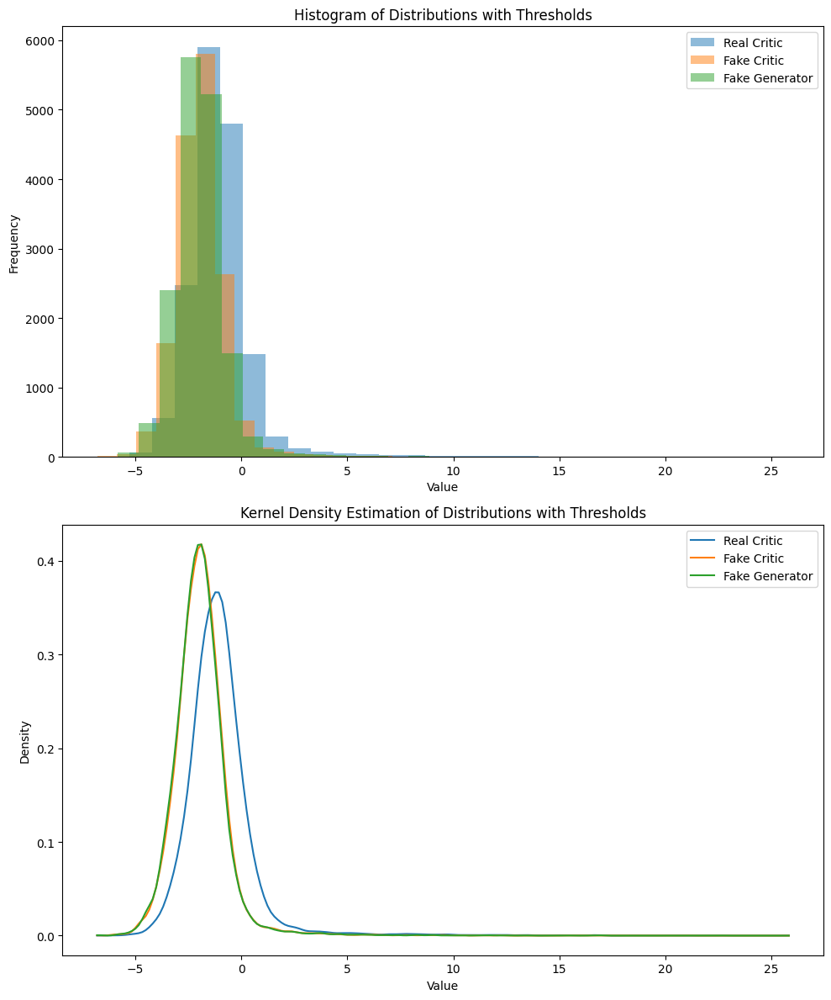

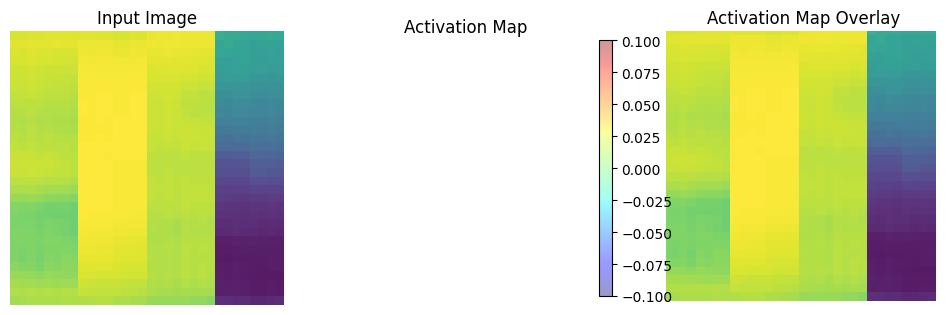

	MNSE Score: 0.0069271826687904575
Batch [0/63] -  Critic loss:  -0.9792782862981161 - generator loss:  43.8681755065918
Batch [21/63] -  Critic loss:  -0.8408208588759105 - generator loss:  41.229088349775836
Batch [42/63] -  Critic loss:  -0.8412187667780145 - generator loss:  41.43735575121502
	Epoch 49 - critic loss: -0.8371033454067496 - generator loss: 41.93031716725183


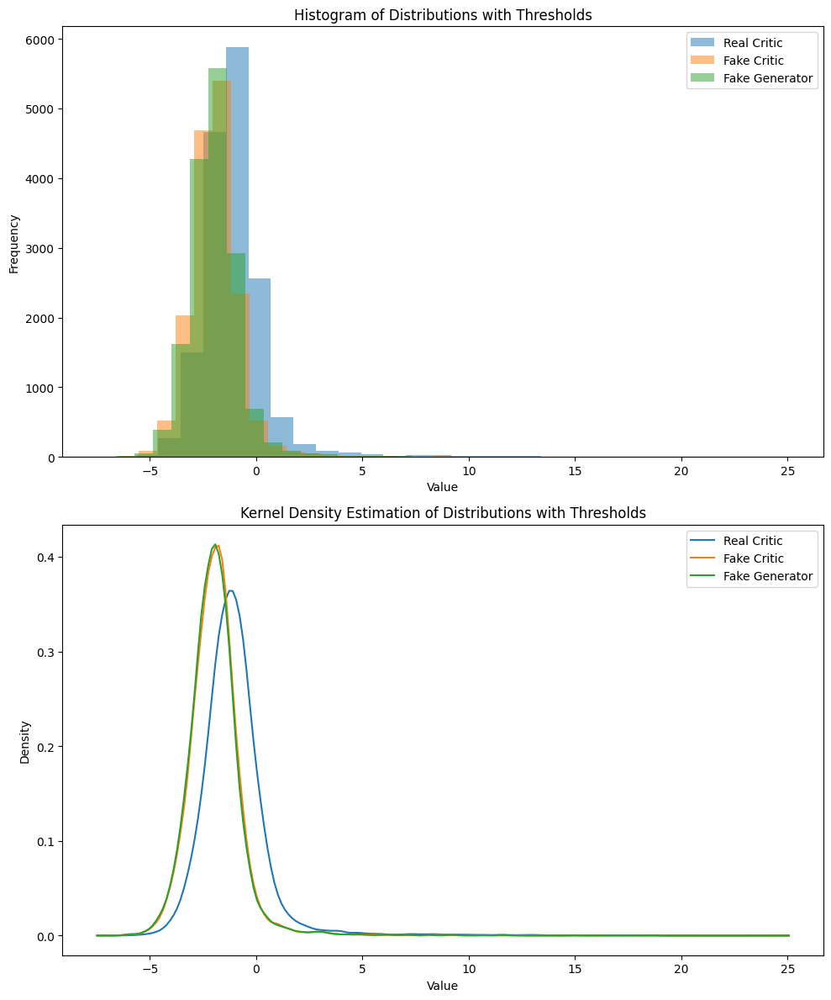

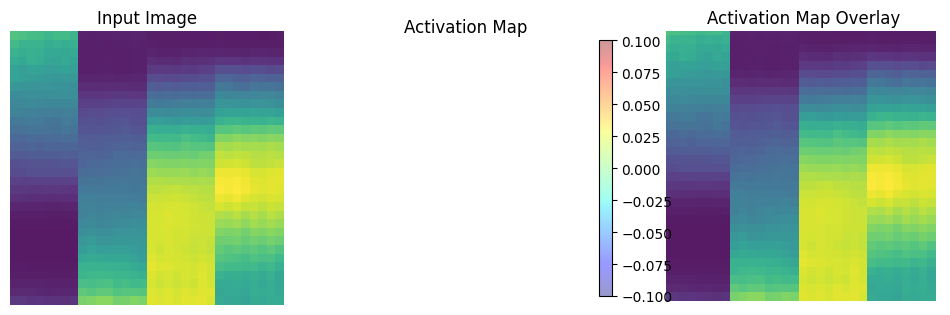

	MNSE Score: 0.006803194667020488
Batch [0/63] -  Critic loss:  -0.8469588955243429 - generator loss:  39.433231353759766
Batch [21/63] -  Critic loss:  -0.8368029747948501 - generator loss:  41.72164258089933
Batch [42/63] -  Critic loss:  -0.8418896849765334 - generator loss:  41.867532242176146
	Epoch 50 - critic loss: -0.842473224672691 - generator loss: 41.58196531023298


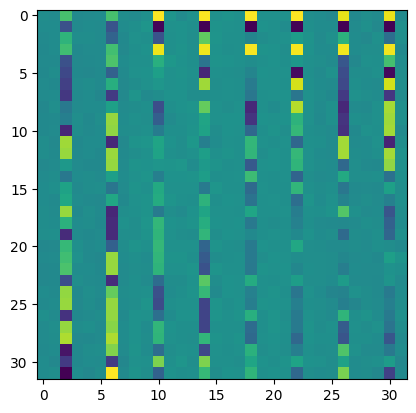

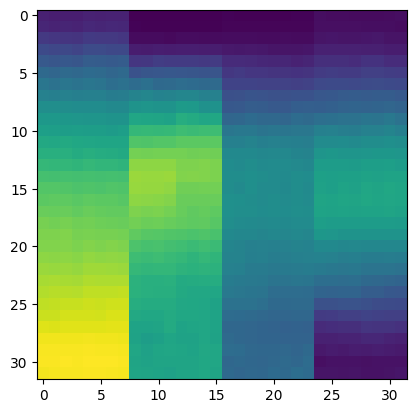

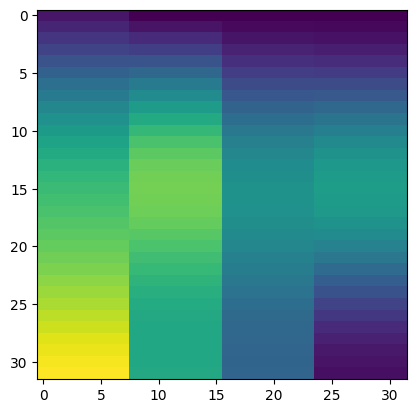

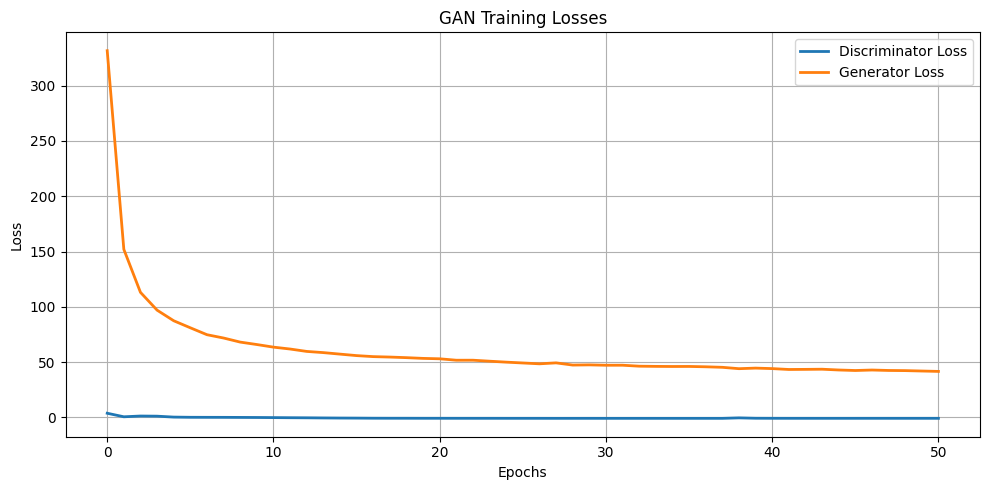

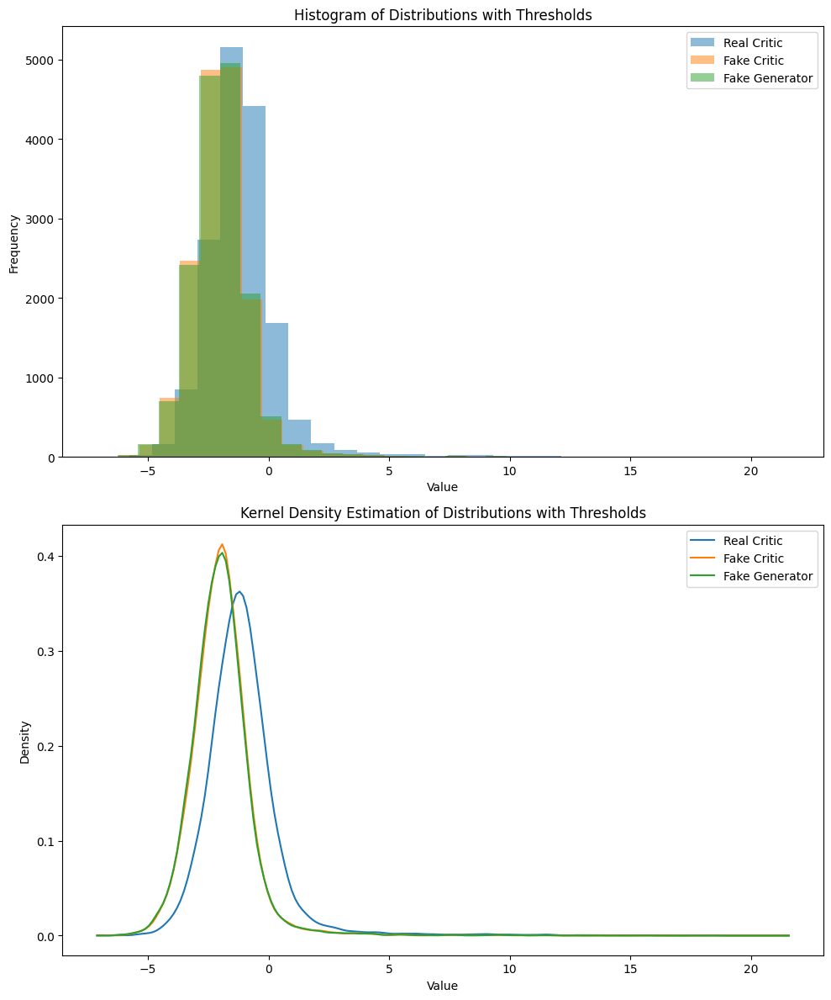

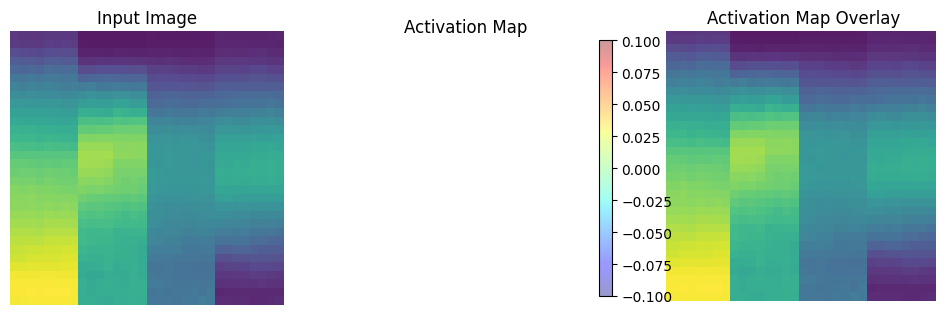

	MNSE Score: 0.006668866338533541
Batch [0/63] -  Critic loss:  -0.8380000193913778 - generator loss:  43.199920654296875
Batch [21/63] -  Critic loss:  -0.8281625265424902 - generator loss:  41.695743560791016
Batch [42/63] -  Critic loss:  -0.829003986462142 - generator loss:  41.842307867005815
	Epoch 51 - critic loss: -0.8340289378292345 - generator loss: 41.885369709559846
Batch [0/63] -  Critic loss:  -0.7239137093226115 - generator loss:  40.74256134033203
Batch [21/63] -  Critic loss:  -0.8435457990025029 - generator loss:  41.329289349642664
Batch [42/63] -  Critic loss:  -0.8386707347492841 - generator loss:  41.453415626703304
	Epoch 52 - critic loss: -0.8402635303754658 - generator loss: 41.28560583932059


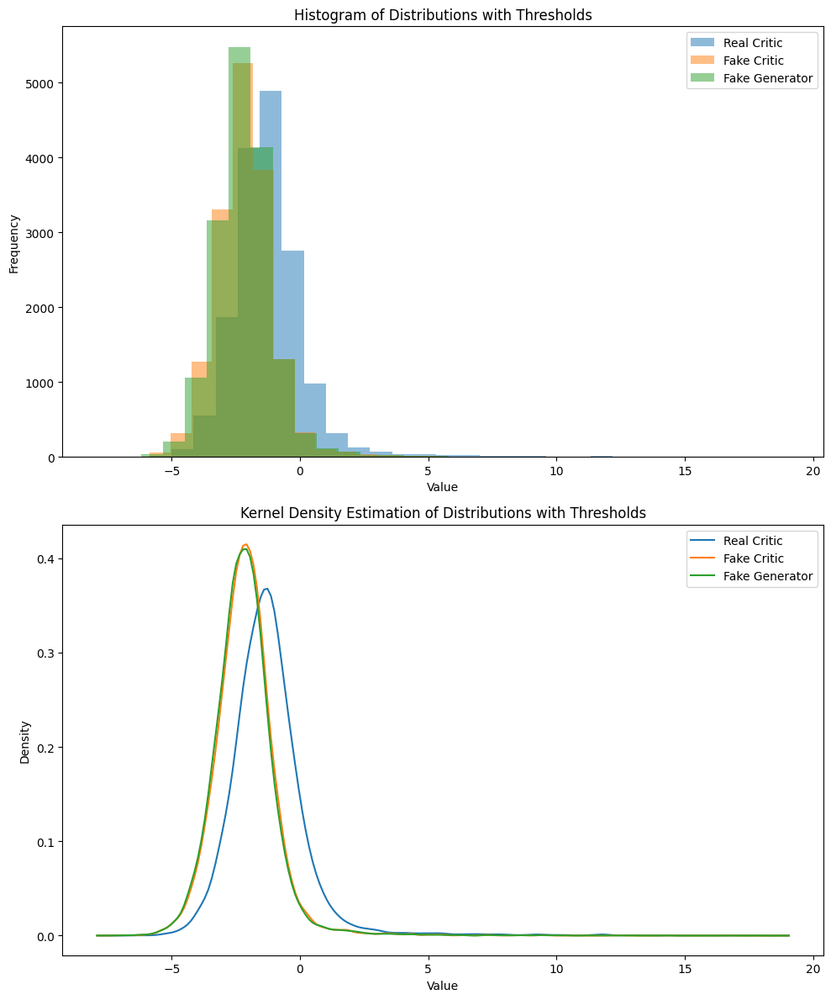

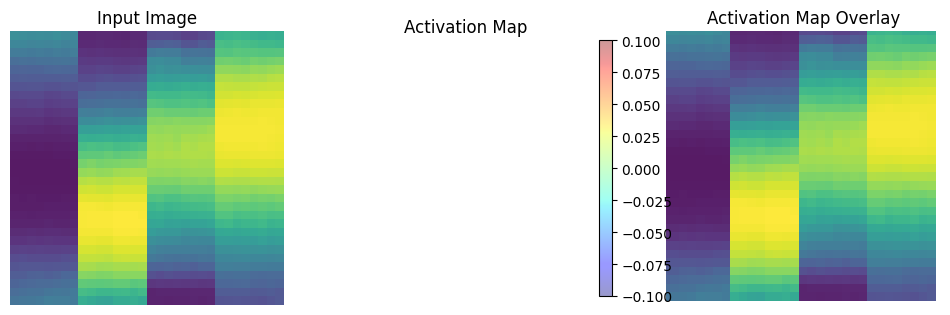

	MNSE Score: 0.006510006869950938
Batch [0/63] -  Critic loss:  -0.86501544713974 - generator loss:  37.19483947753906
Batch [21/63] -  Critic loss:  -0.8289296139370311 - generator loss:  40.16689127141779
Batch [42/63] -  Critic loss:  -0.8342903875565344 - generator loss:  40.92601554338322
	Epoch 53 - critic loss: -0.8424987600593973 - generator loss: 41.07522691999163


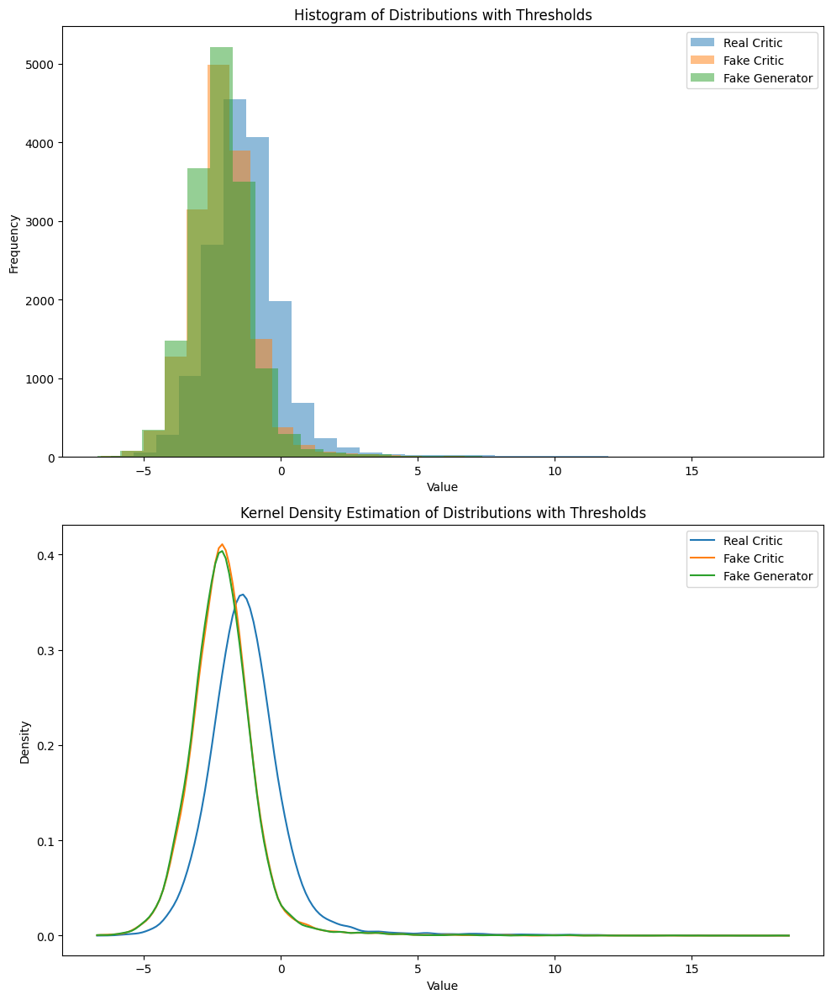

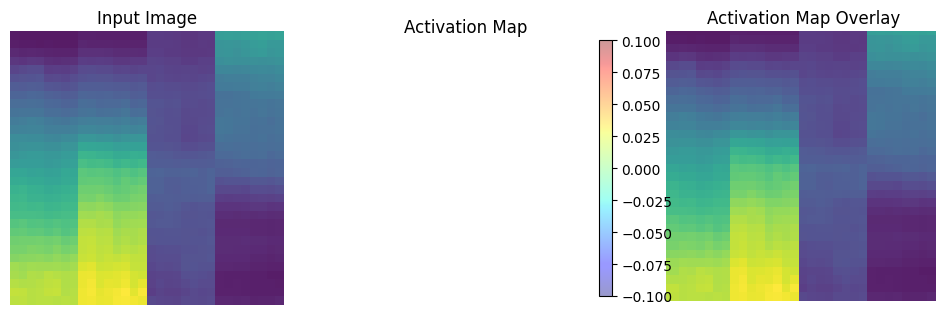

	MNSE Score: 0.006463491069596438
Batch [0/63] -  Critic loss:  -0.7225541273752848 - generator loss:  38.95845413208008
Batch [21/63] -  Critic loss:  -0.8374277262976676 - generator loss:  41.028349269520156
Batch [42/63] -  Critic loss:  -0.8384129839350085 - generator loss:  41.23544568793718
	Epoch 54 - critic loss: -0.8396844952194777 - generator loss: 40.865909334213015


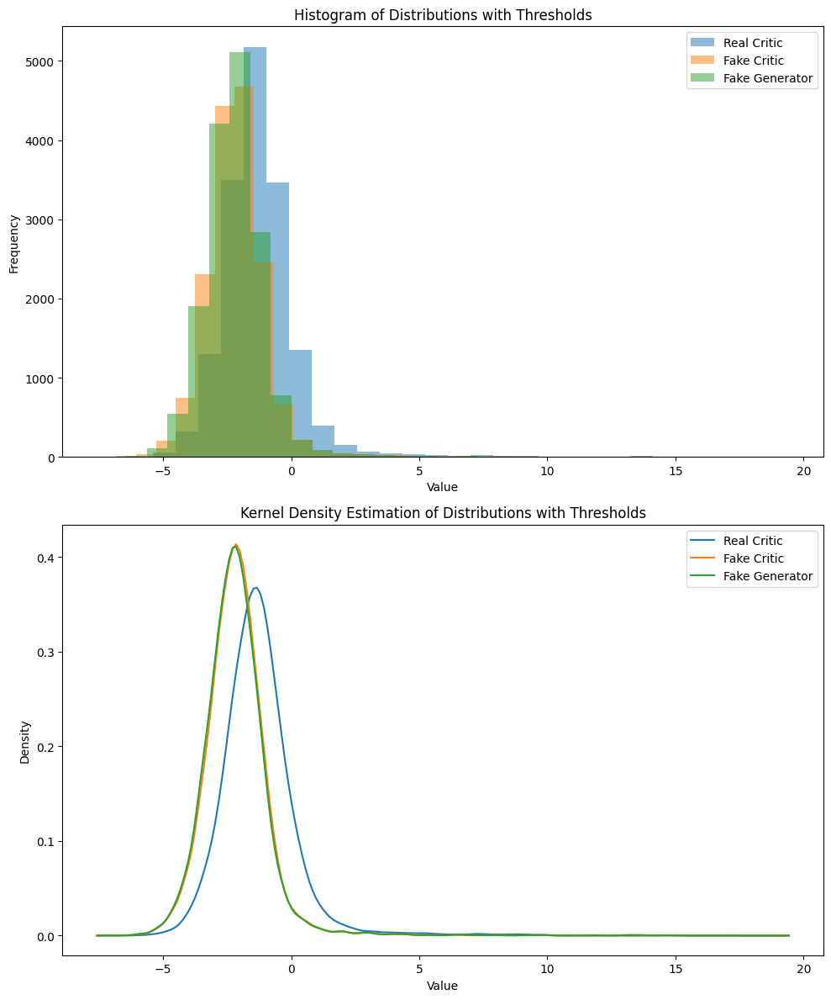

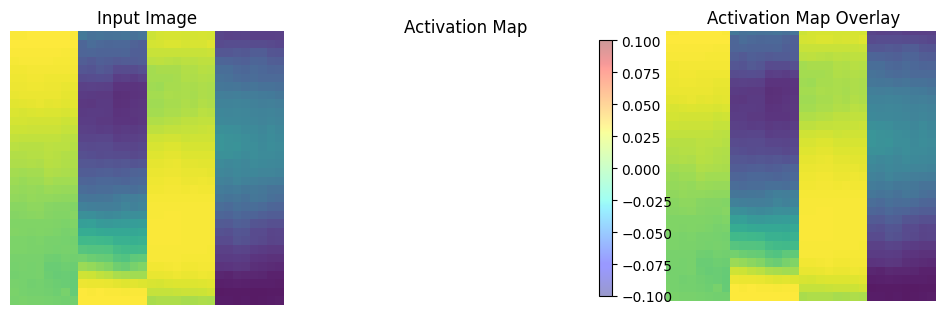

	MNSE Score: 0.006373841138113113
Batch [0/63] -  Critic loss:  -0.7079471747080485 - generator loss:  45.085105895996094
Batch [21/63] -  Critic loss:  -0.8440848245765223 - generator loss:  42.668683312155984
Batch [42/63] -  Critic loss:  -0.8377919566723725 - generator loss:  41.6669561696607
	Epoch 55 - critic loss: -0.8399833450241693 - generator loss: 40.81393590049138


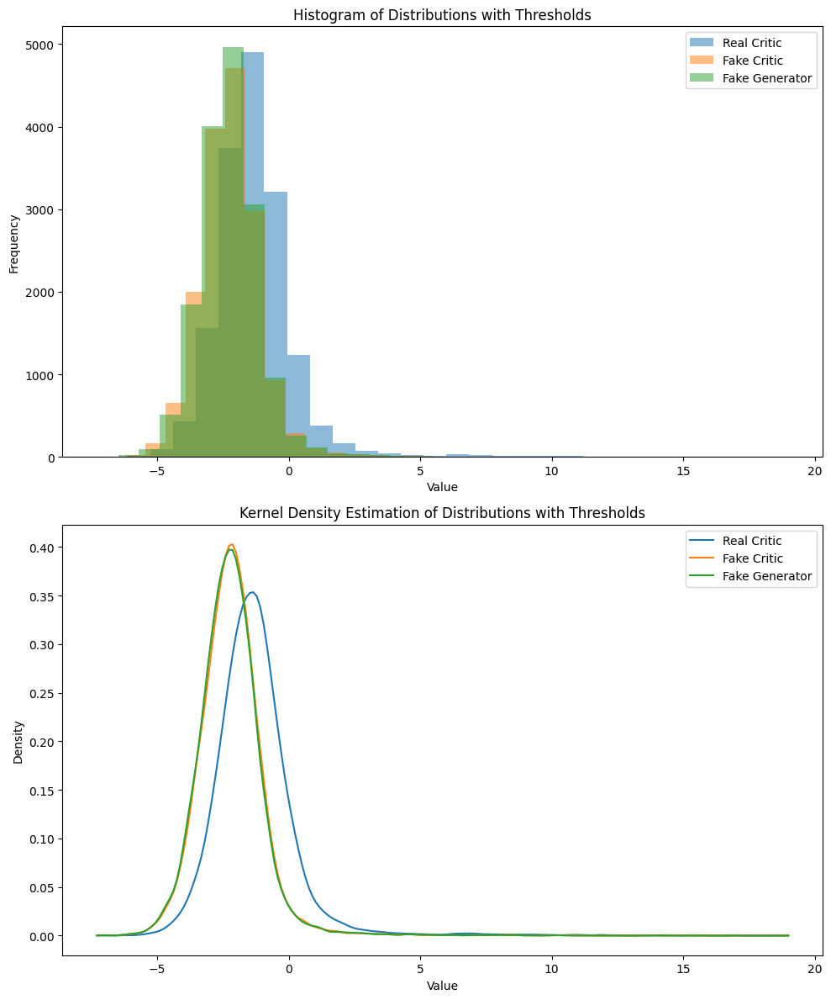

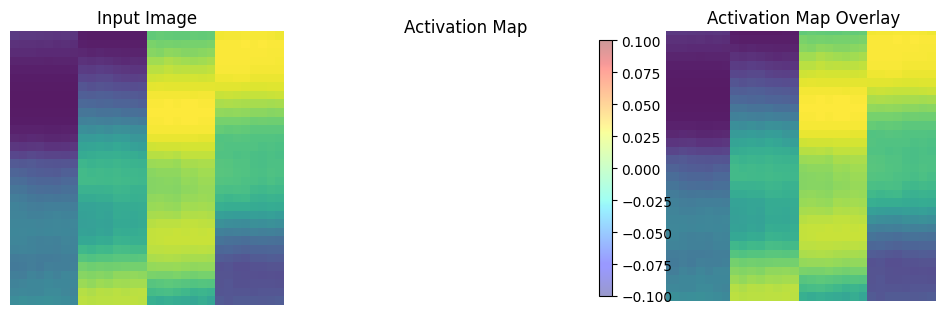

	MNSE Score: 0.006343097189470889
Batch [0/63] -  Critic loss:  -0.8170071840286255 - generator loss:  38.7283821105957
Batch [21/63] -  Critic loss:  -0.8397346753062623 - generator loss:  40.3787205436013
Batch [42/63] -  Critic loss:  -0.8402919561363928 - generator loss:  40.76831240986669
	Epoch 56 - critic loss: -0.8360614344556495 - generator loss: 40.81730500478593


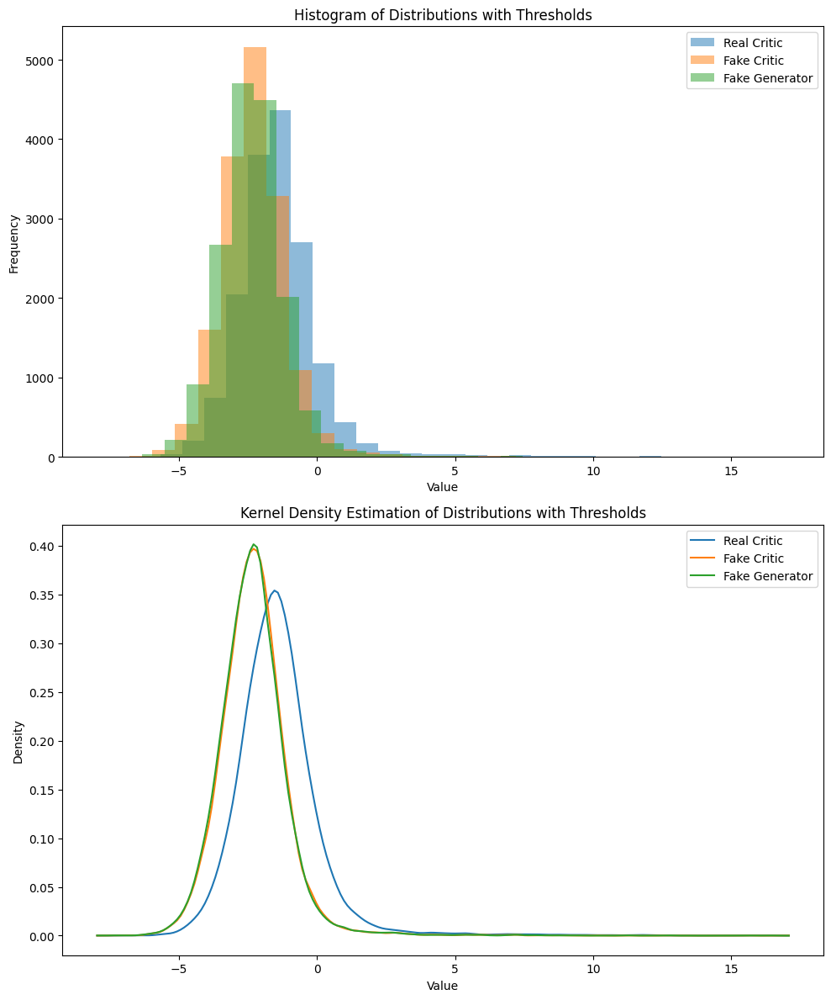

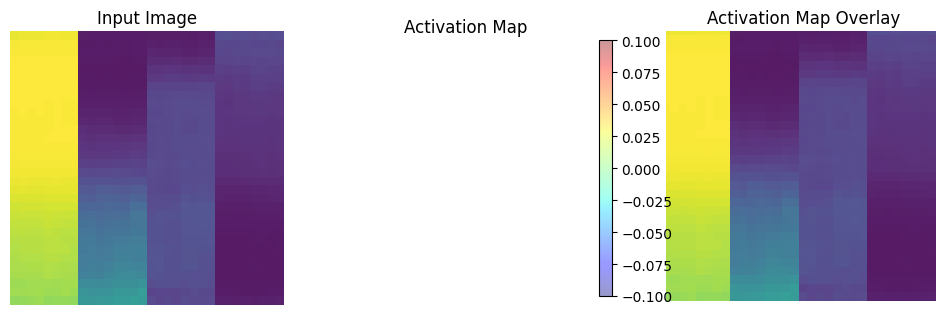

	MNSE Score: 0.006311025418755081
Batch [0/63] -  Critic loss:  -1.0308991471926372 - generator loss:  47.23863983154297
Batch [21/63] -  Critic loss:  -0.8430636886394385 - generator loss:  41.32164261557839
Batch [42/63] -  Critic loss:  -0.8449819369833601 - generator loss:  40.813948342966476
	Epoch 57 - critic loss: -0.8430089105373972 - generator loss: 40.47107275705489


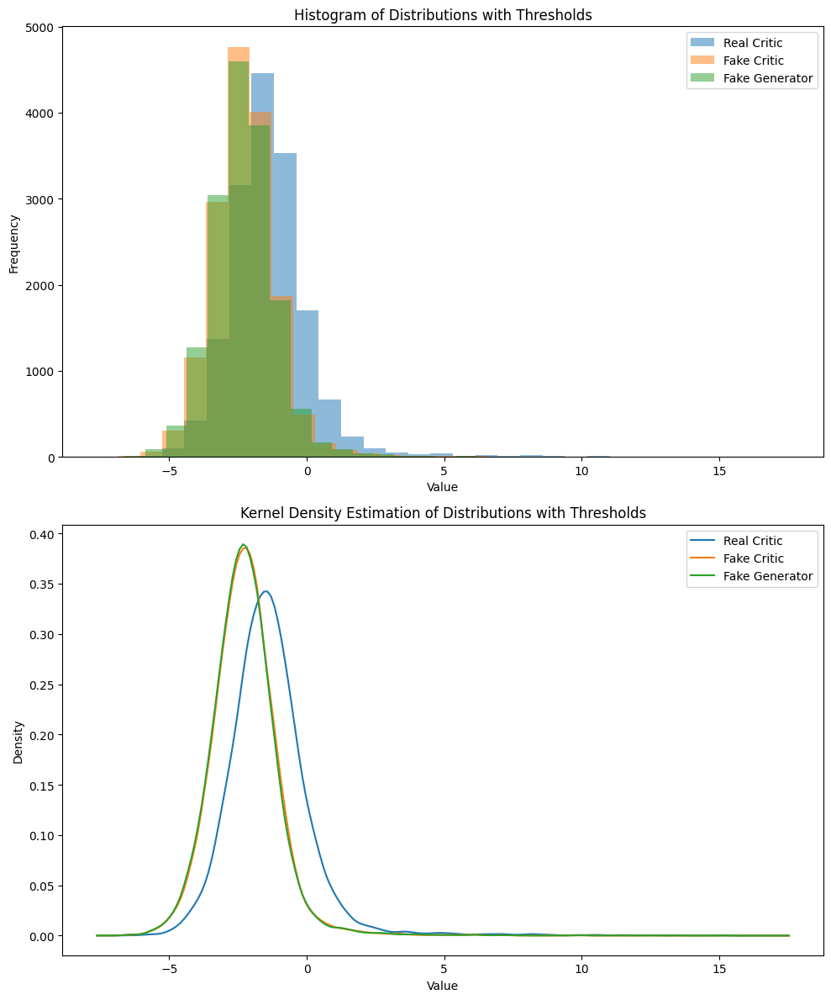

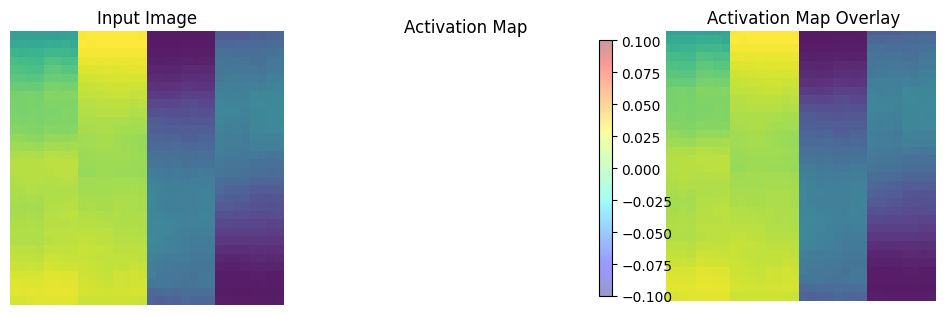

	MNSE Score: 0.00620637217625266
Batch [0/63] -  Critic loss:  -0.7492478887240092 - generator loss:  39.392723083496094
Batch [21/63] -  Critic loss:  -0.8284873086394683 - generator loss:  41.23383209922097
Batch [42/63] -  Critic loss:  -0.8335926874663475 - generator loss:  40.584107243737506
	Epoch 58 - critic loss: -0.8374085073117854 - generator loss: 40.88673334273081
Batch [0/63] -  Critic loss:  -0.7595427632331848 - generator loss:  37.98896789550781
Batch [21/63] -  Critic loss:  -0.8374484280745189 - generator loss:  40.50012345747514
Batch [42/63] -  Critic loss:  -0.838699526102968 - generator loss:  40.388168955958164
	Epoch 59 - critic loss: -0.8390170222236998 - generator loss: 40.14286925300719


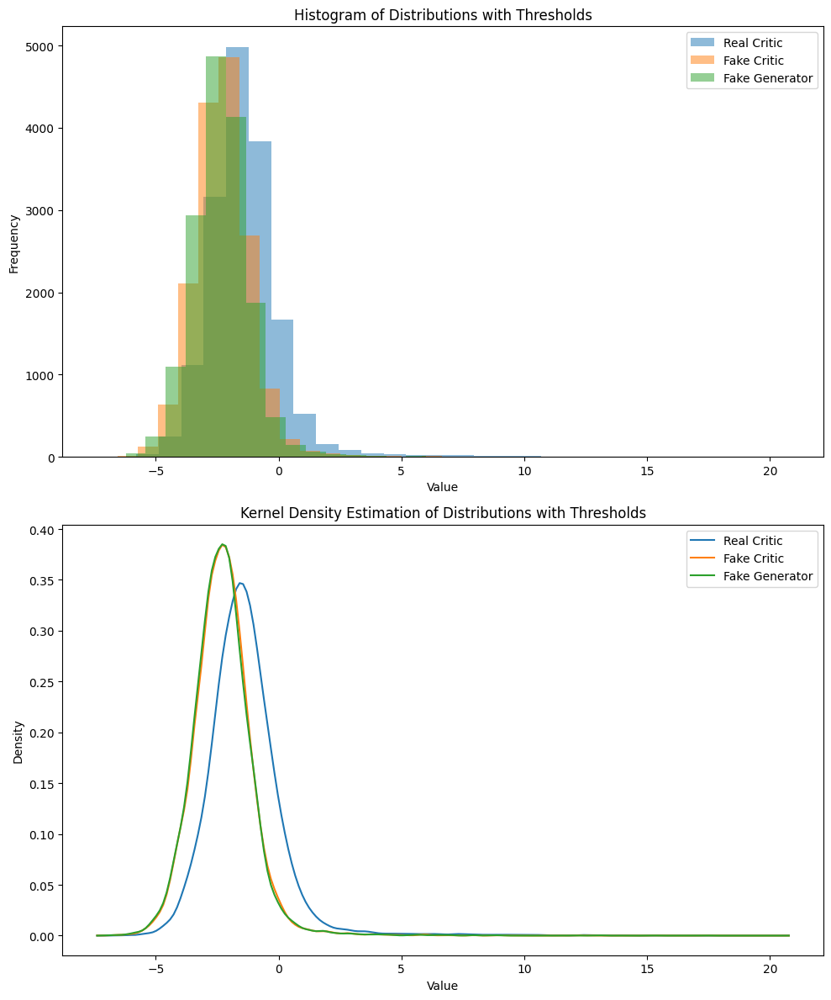

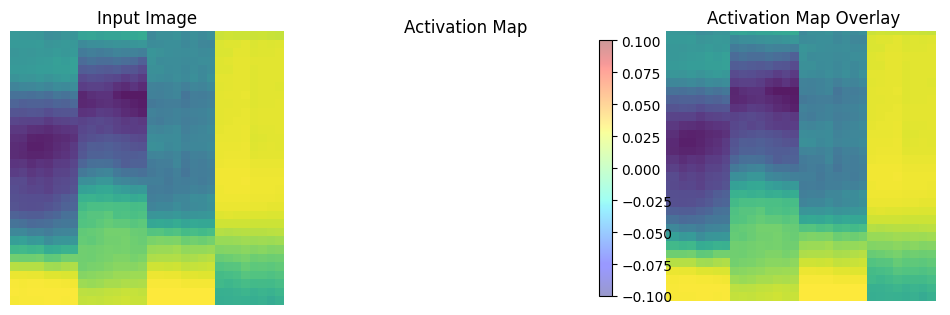

	MNSE Score: 0.0060947015955452885
Batch [0/63] -  Critic loss:  -0.7998751600583395 - generator loss:  40.36701202392578
Batch [21/63] -  Critic loss:  -0.8473457016728141 - generator loss:  38.959636514837094
Batch [42/63] -  Critic loss:  -0.8472531867581744 - generator loss:  39.02786503281704
	Epoch 60 - critic loss: -0.8407402126877397 - generator loss: 38.90466811164977


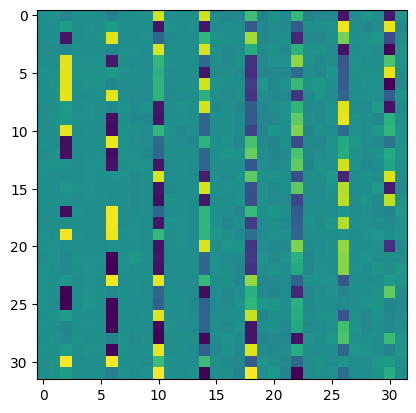

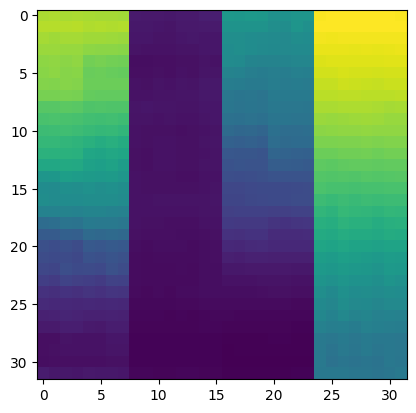

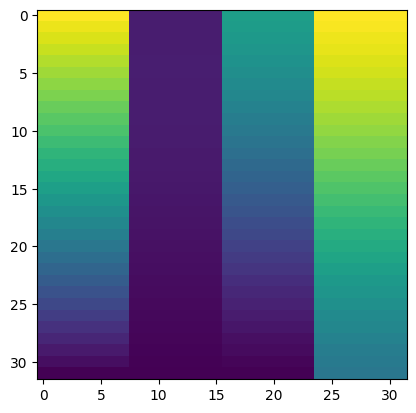

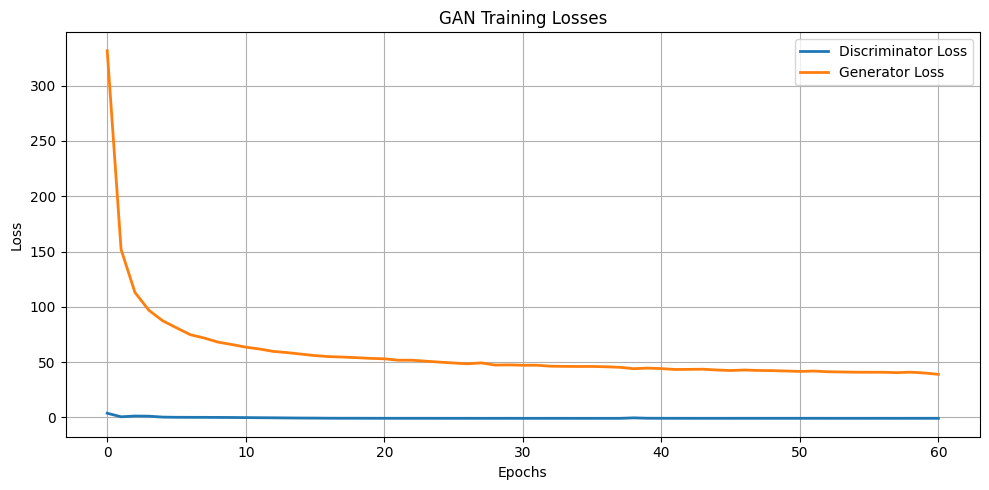

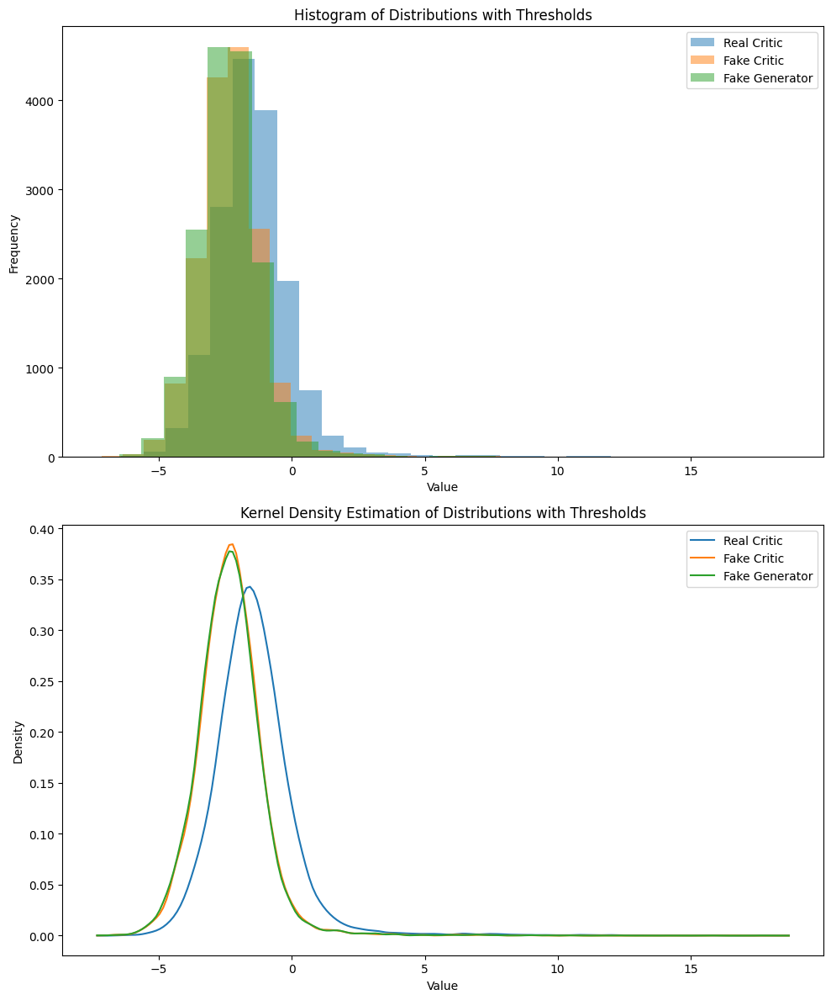

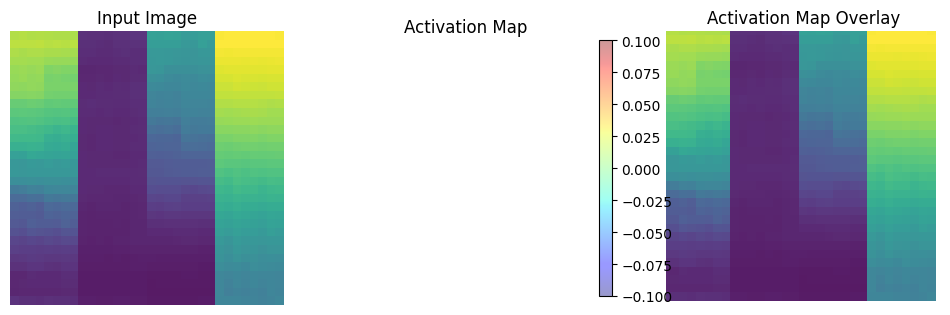

	MNSE Score: 0.0056752040021358025
Batch [0/63] -  Critic loss:  -0.8653433720270792 - generator loss:  36.95737075805664
Batch [21/63] -  Critic loss:  -0.8476473084001829 - generator loss:  40.12691809914329
Batch [42/63] -  Critic loss:  -0.8402222709138264 - generator loss:  40.52576801388763
	Epoch 61 - critic loss: -0.843151136365517 - generator loss: 40.32433207072909
Batch [0/63] -  Critic loss:  -0.8212134639422098 - generator loss:  38.355533599853516
Batch [21/63] -  Critic loss:  -0.8467951534372387 - generator loss:  40.15953930941495
Batch [42/63] -  Critic loss:  -0.8410043499266455 - generator loss:  39.66681227573129
	Epoch 62 - critic loss: -0.8378443982866076 - generator loss: 39.54752492147779
Batch [0/63] -  Critic loss:  -0.6756706635157267 - generator loss:  39.88832092285156
Batch [21/63] -  Critic loss:  -0.8134740184653889 - generator loss:  40.80441943081942
Batch [42/63] -  Critic loss:  -0.8302765909091449 - generator loss:  40.474503716757134
	Epoch 63 - c

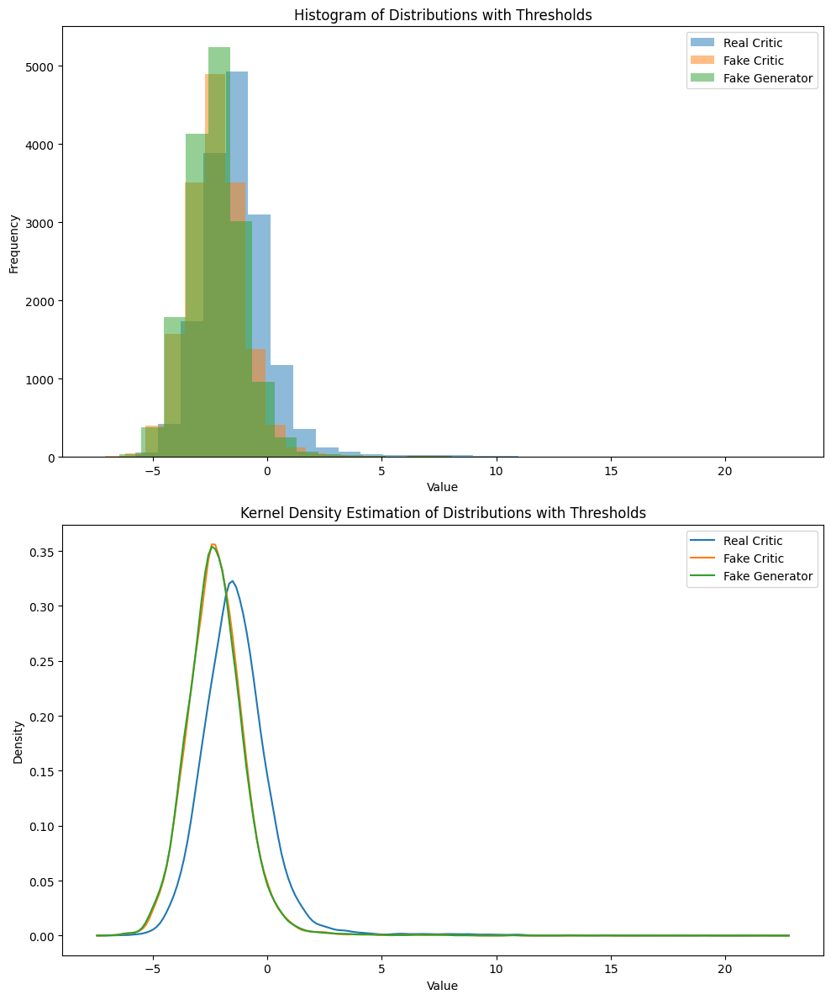

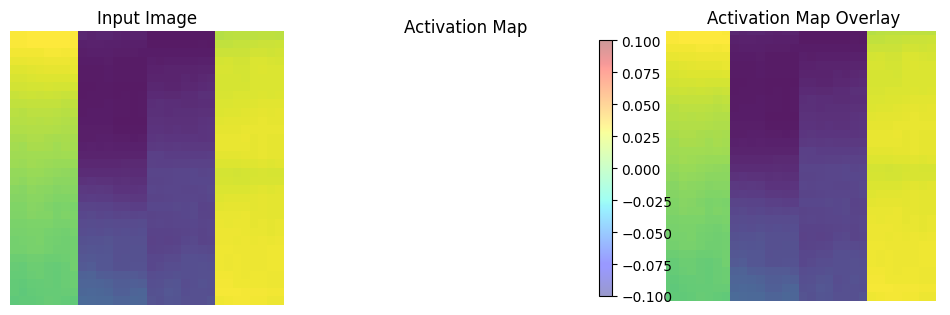

	MNSE Score: 0.005672340325656391
Batch [0/63] -  Critic loss:  -0.8511793414751688 - generator loss:  35.533111572265625
Batch [21/63] -  Critic loss:  -0.8461024977944114 - generator loss:  38.43960276517001
Batch [42/63] -  Critic loss:  -0.8306520872337875 - generator loss:  38.73483790907749
	Epoch 68 - critic loss: -0.8401716603803889 - generator loss: 38.72505902487134
Batch [0/63] -  Critic loss:  -0.9085129896799723 - generator loss:  44.239402770996094
Batch [21/63] -  Critic loss:  -0.8103336475112223 - generator loss:  38.92933533408425
Batch [42/63] -  Critic loss:  -0.8202660384104236 - generator loss:  38.801677171574084
	Epoch 69 - critic loss: -0.8306339499811647 - generator loss: 38.607311006576296


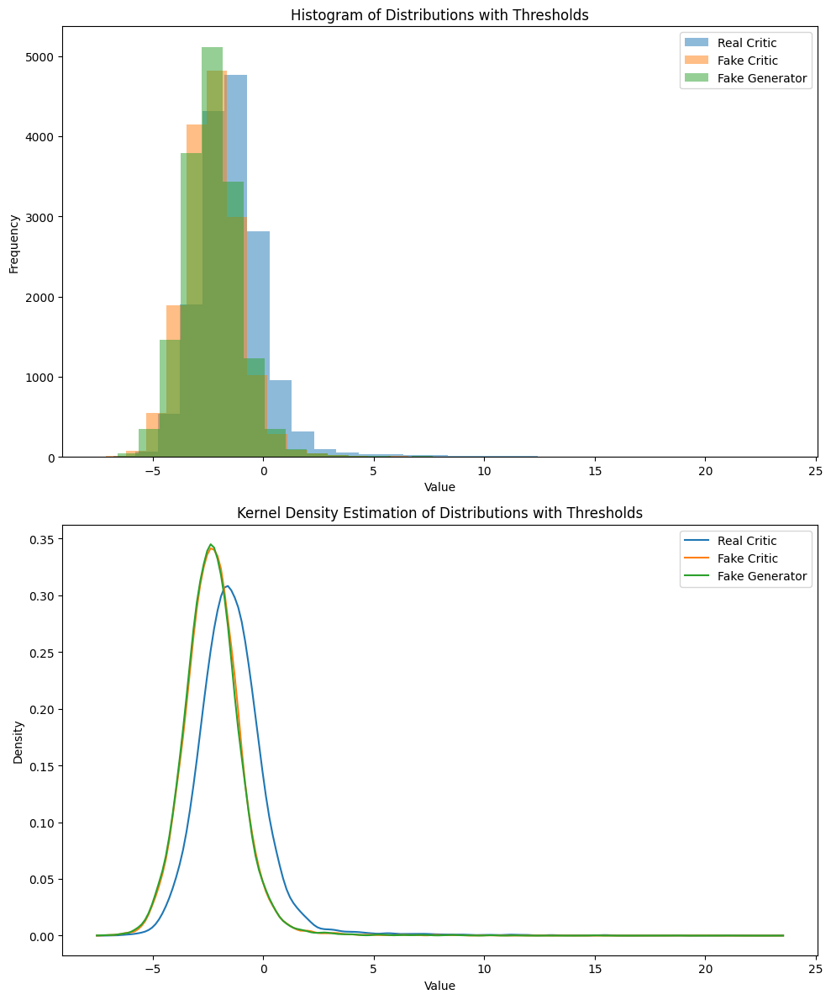

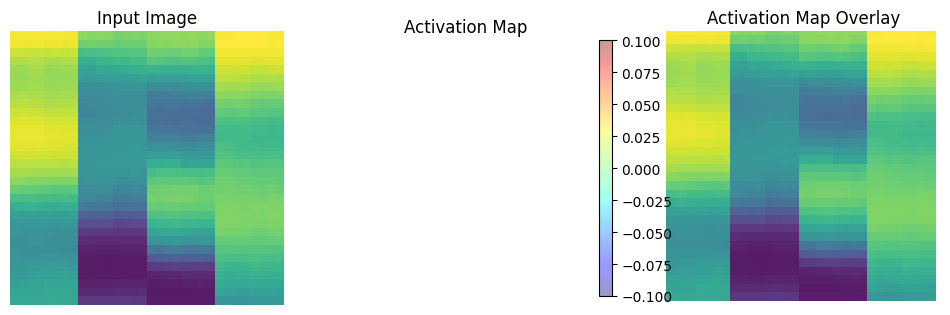

	MNSE Score: 0.0056288523954294975
Batch [0/63] -  Critic loss:  -0.7015024224917094 - generator loss:  36.00391387939453
Batch [21/63] -  Critic loss:  -0.8310040768348809 - generator loss:  38.50608895041726
Batch [42/63] -  Critic loss:  -0.8197168222693512 - generator loss:  39.037831417349885
	Epoch 70 - critic loss: -0.8222028941073746 - generator loss: 38.95739958021376


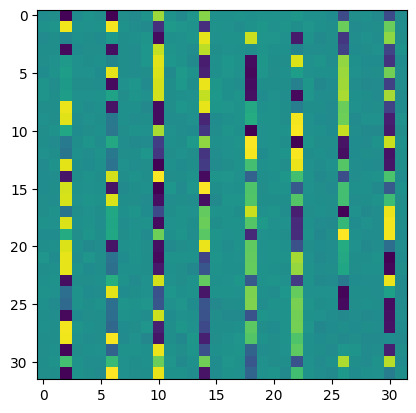

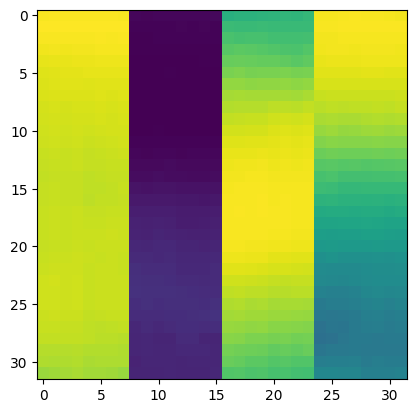

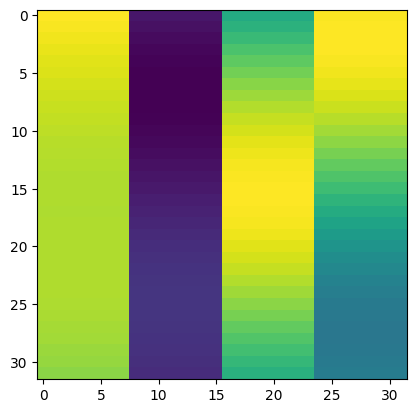

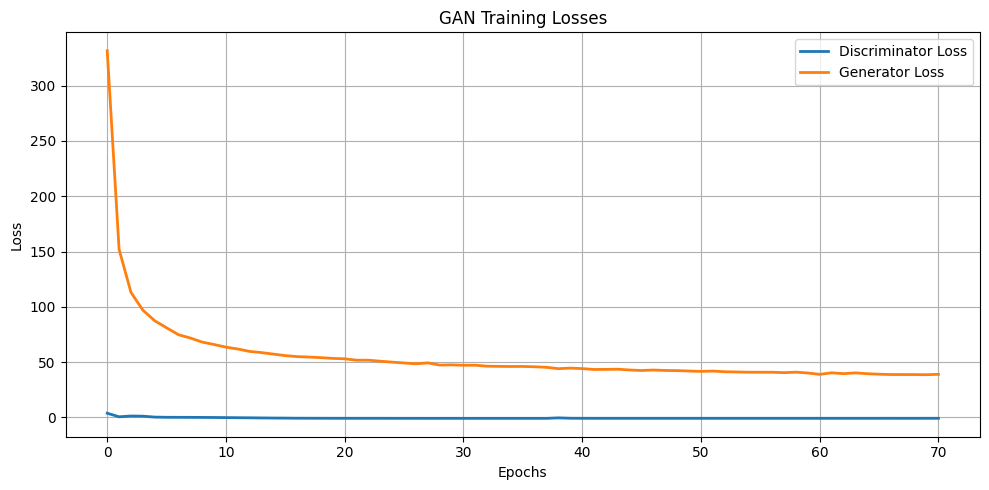

Batch [0/63] -  Critic loss:  -0.681250810623169 - generator loss:  36.812923431396484
Batch [21/63] -  Critic loss:  -0.8458226675337012 - generator loss:  38.60635098544034
Batch [42/63] -  Critic loss:  -0.8367094905801523 - generator loss:  38.30151970441951
	Epoch 71 - critic loss: -0.8326917435757069 - generator loss: 38.52176938738142


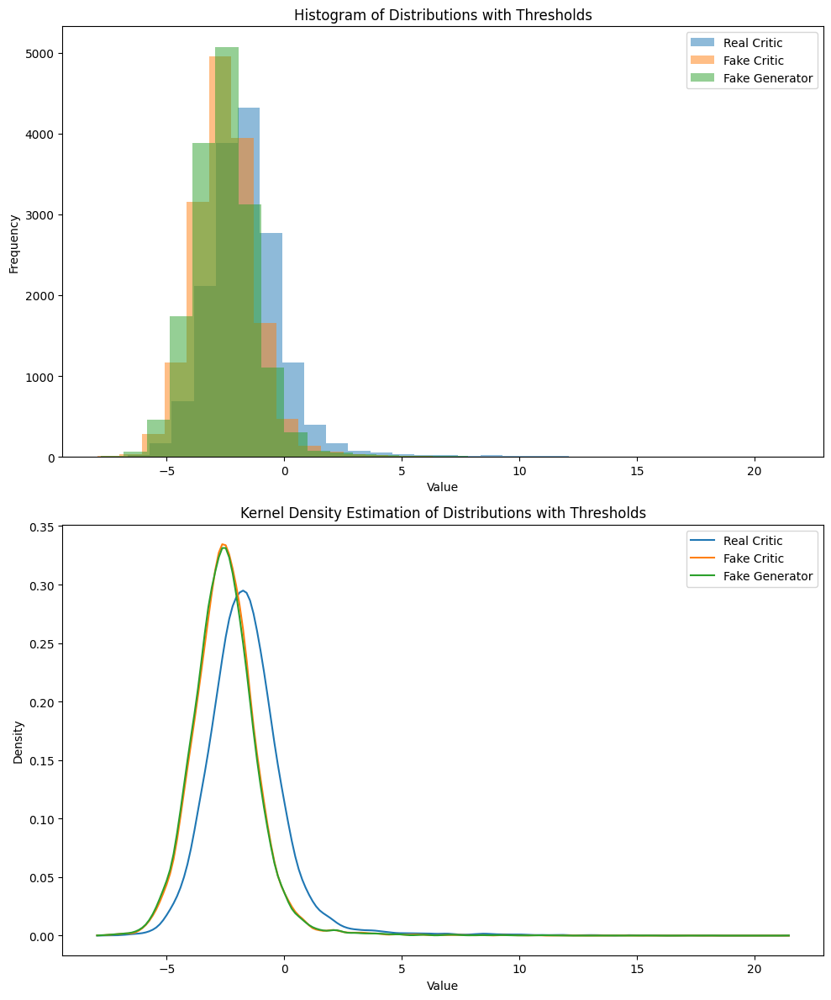

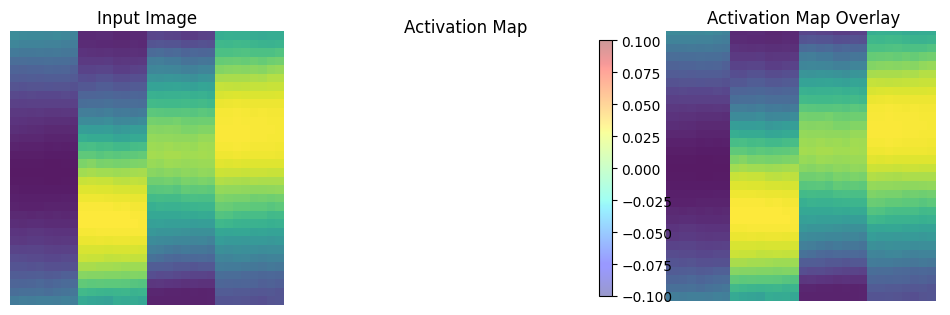

	MNSE Score: 0.005532349001557108
Batch [0/63] -  Critic loss:  -0.7888704538345337 - generator loss:  43.670814514160156
Batch [21/63] -  Critic loss:  -0.8146279580665357 - generator loss:  38.59724842418324
Batch [42/63] -  Critic loss:  -0.8246282279029372 - generator loss:  39.14917027673056
	Epoch 72 - critic loss: -0.8223690431584757 - generator loss: 38.716098815675764
Batch [0/63] -  Critic loss:  -0.8067837357521057 - generator loss:  42.84843444824219
Batch [21/63] -  Critic loss:  -0.8057488139831659 - generator loss:  39.23019634593617
Batch [42/63] -  Critic loss:  -0.8176082257152527 - generator loss:  38.97038508570471
	Epoch 73 - critic loss: -0.8268139955227968 - generator loss: 38.68227295648484


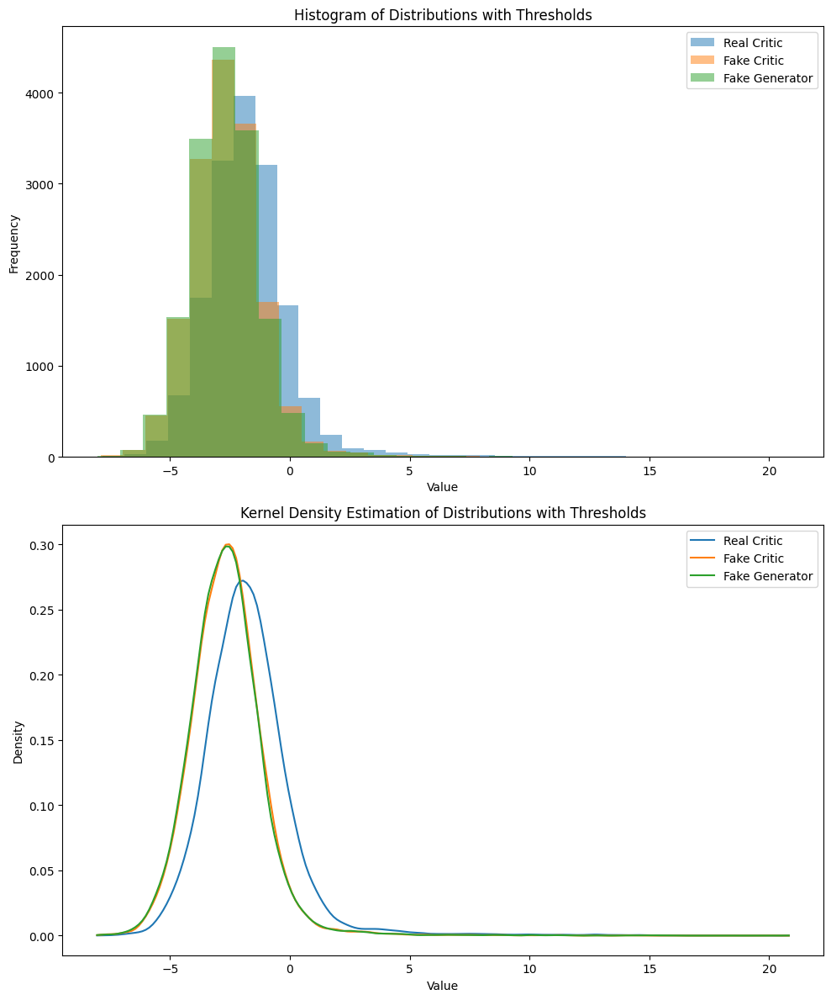

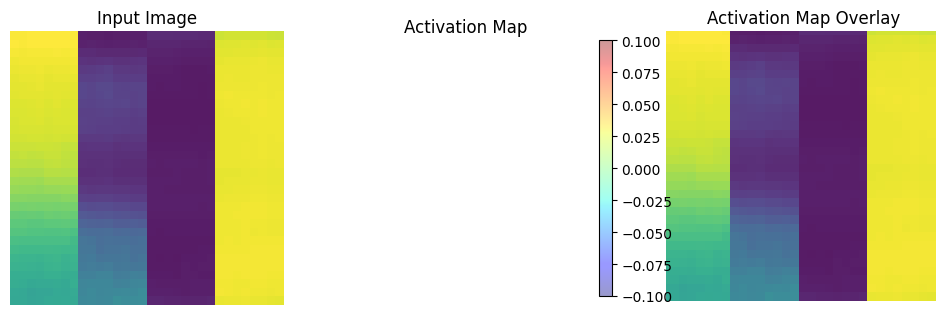

	MNSE Score: 0.005524202826477233
Batch [0/63] -  Critic loss:  -0.8349877595901489 - generator loss:  34.49411392211914
Batch [21/63] -  Critic loss:  -0.8399262301849596 - generator loss:  37.65137967196378
Batch [42/63] -  Critic loss:  -0.8378099424894466 - generator loss:  37.50711307969204
	Epoch 74 - critic loss: -0.840776233761399 - generator loss: 37.532624713958256


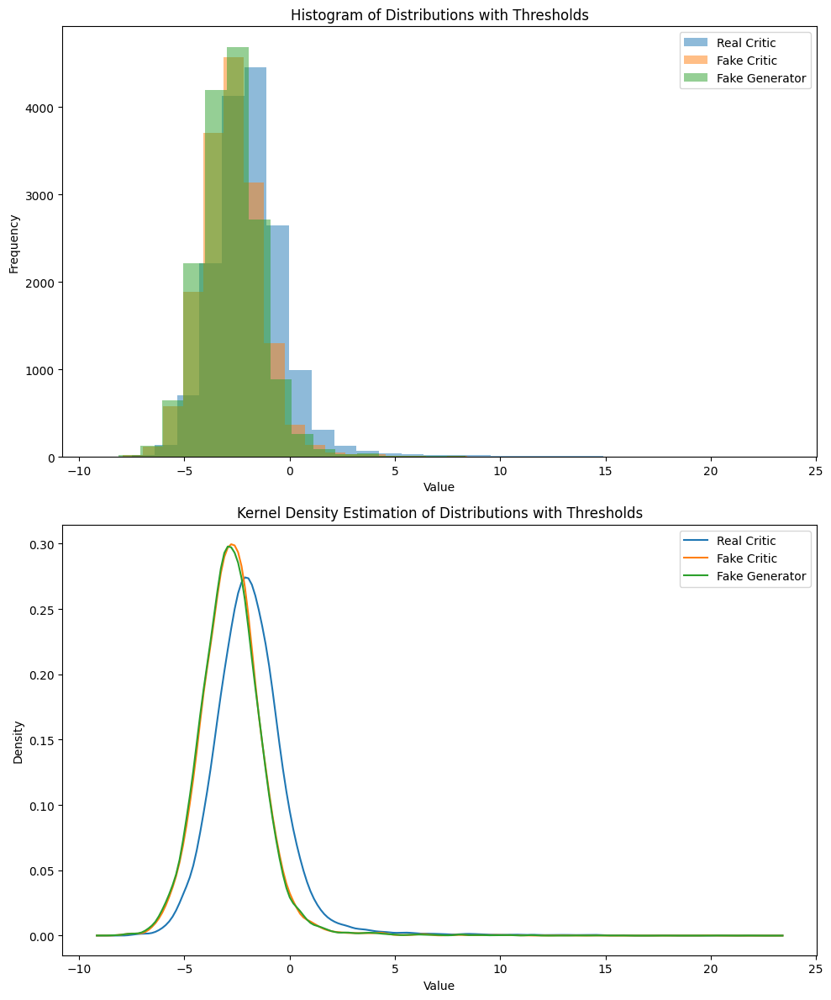

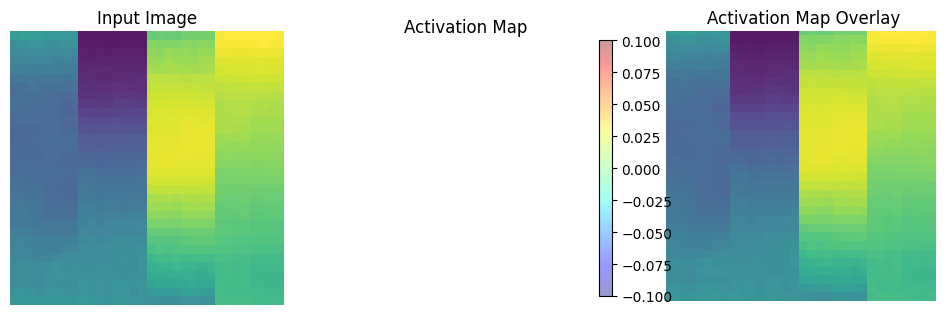

	MNSE Score: 0.005133406473471532
Batch [0/63] -  Critic loss:  -0.7845876812934875 - generator loss:  35.67631149291992
Batch [21/63] -  Critic loss:  -0.8199978868166604 - generator loss:  37.612201343883164
Batch [42/63] -  Critic loss:  -0.8154440397440001 - generator loss:  38.232582180999046
	Epoch 75 - critic loss: -0.813544733499093 - generator loss: 38.05084658425952
Batch [0/63] -  Critic loss:  -0.8128512899080912 - generator loss:  35.622779846191406
Batch [21/63] -  Critic loss:  -0.7950950427488849 - generator loss:  38.37218544699929
Batch [42/63] -  Critic loss:  -0.8109074609224188 - generator loss:  38.17869390443314
	Epoch 76 - critic loss: -0.8114329696332336 - generator loss: 37.929031735374814
Batch [0/63] -  Critic loss:  -0.7789877851804098 - generator loss:  43.543922424316406
Batch [21/63] -  Critic loss:  -0.8157650259408084 - generator loss:  38.85391530123624
Batch [42/63] -  Critic loss:  -0.8129662607991417 - generator loss:  38.74855076989462
	Epoch 77 -

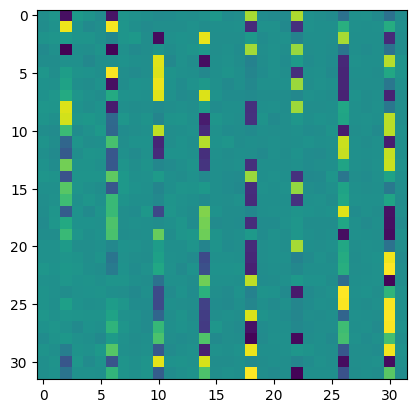

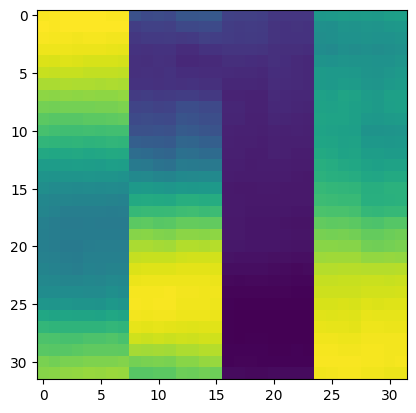

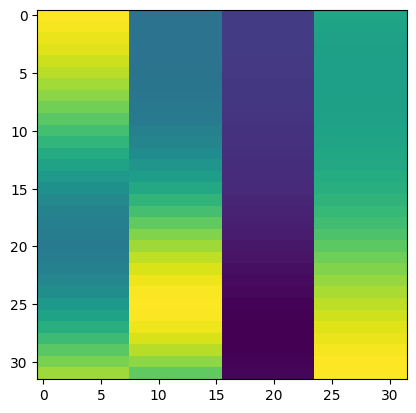

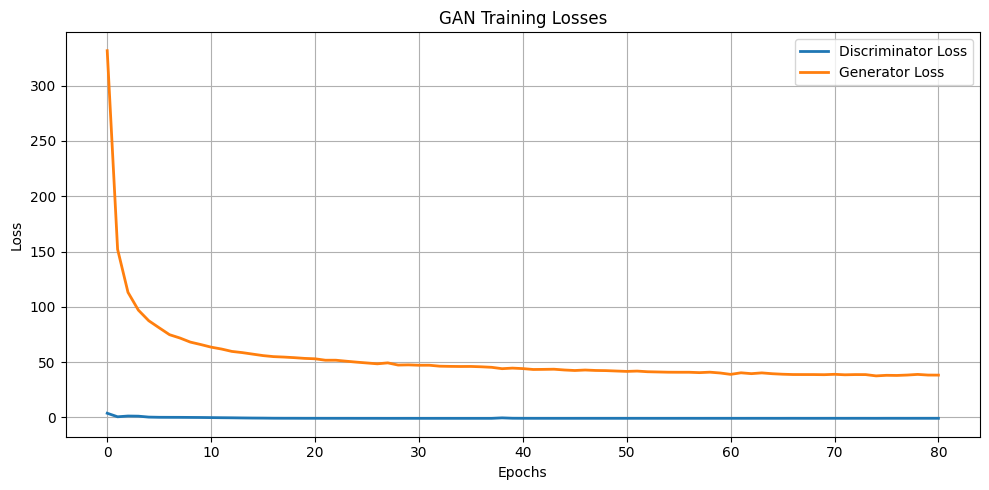

Batch [0/63] -  Critic loss:  -0.8692078987757365 - generator loss:  40.11178207397461
Batch [21/63] -  Critic loss:  -0.8042962749799094 - generator loss:  39.04993300004439
Batch [42/63] -  Critic loss:  -0.8104090639787126 - generator loss:  39.26241586374682
	Epoch 81 - critic loss: -0.8122667335959339 - generator loss: 39.184118180047896
Batch [0/63] -  Critic loss:  -0.8176355163256327 - generator loss:  36.672760009765625
Batch [21/63] -  Critic loss:  -0.8142698687134365 - generator loss:  38.81149604103782
Batch [42/63] -  Critic loss:  -0.8160530980243238 - generator loss:  38.44338794087255
	Epoch 82 - critic loss: -0.8224321991678268 - generator loss: 38.12378084091913


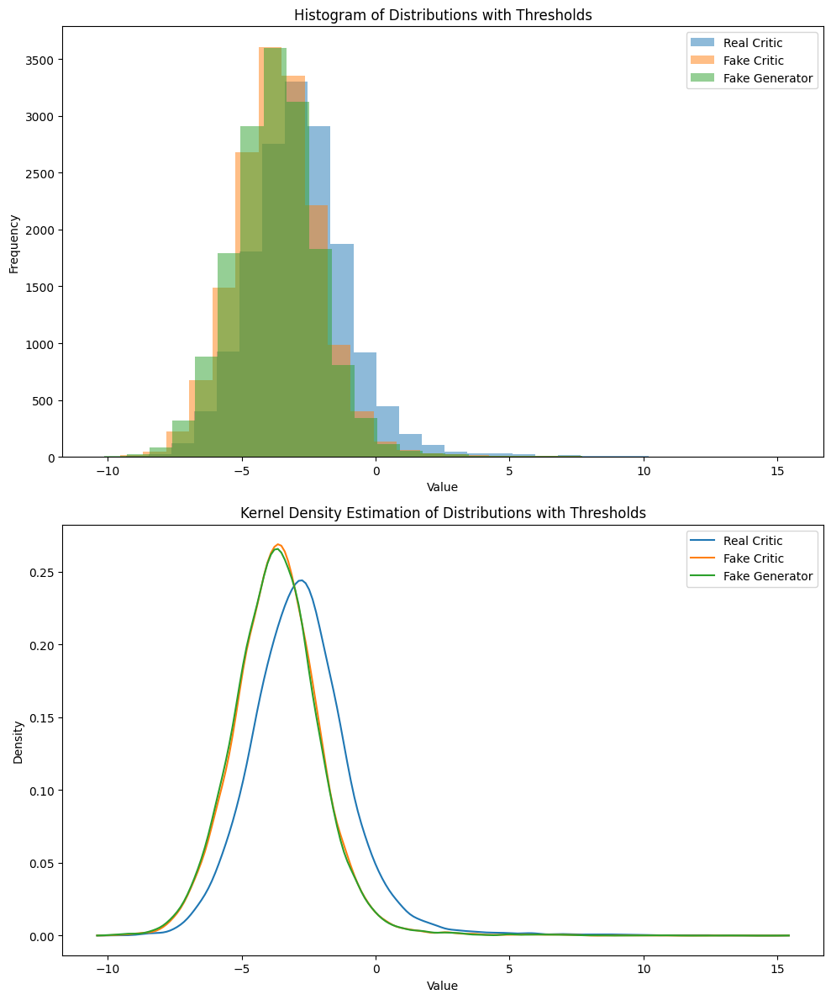

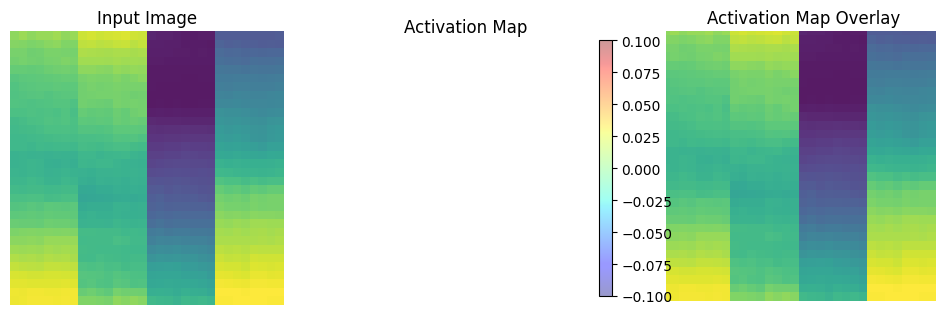

	MNSE Score: 0.005041784348173274
Batch [0/63] -  Critic loss:  -0.8140050967534384 - generator loss:  41.2547607421875
Batch [21/63] -  Critic loss:  -0.790084542650165 - generator loss:  37.79899111661044
Batch [42/63] -  Critic loss:  -0.7973080097242842 - generator loss:  37.84477233886719
	Epoch 83 - critic loss: -0.806564137418434 - generator loss: 38.11678317236522


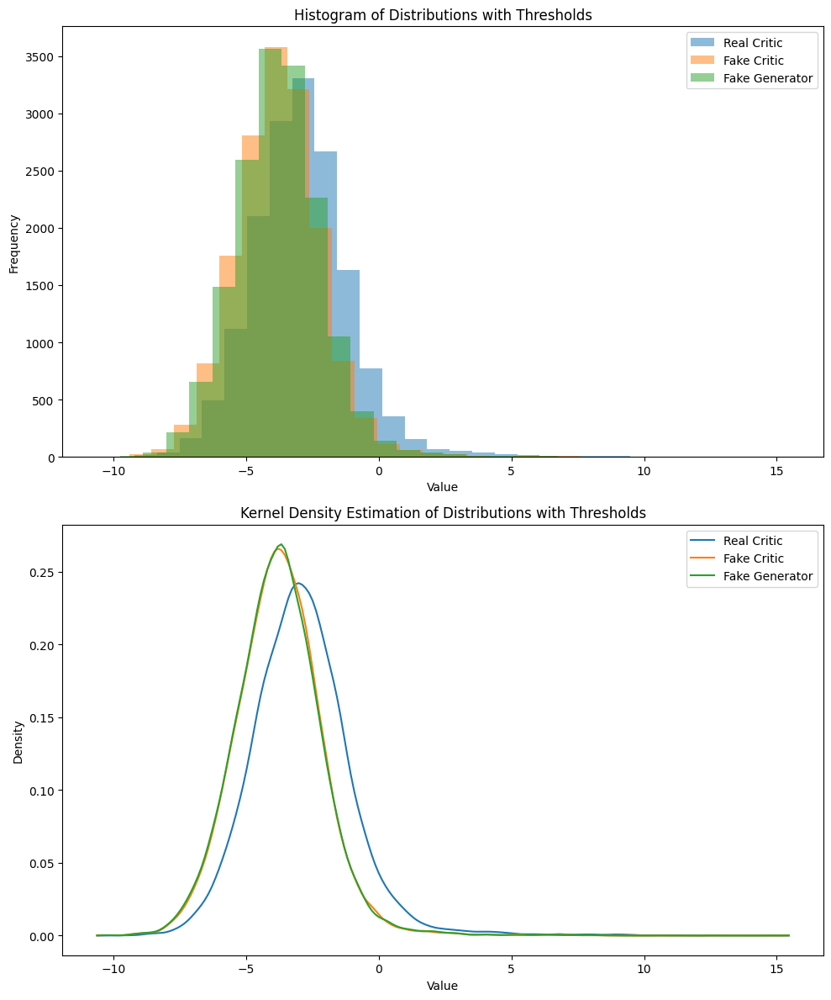

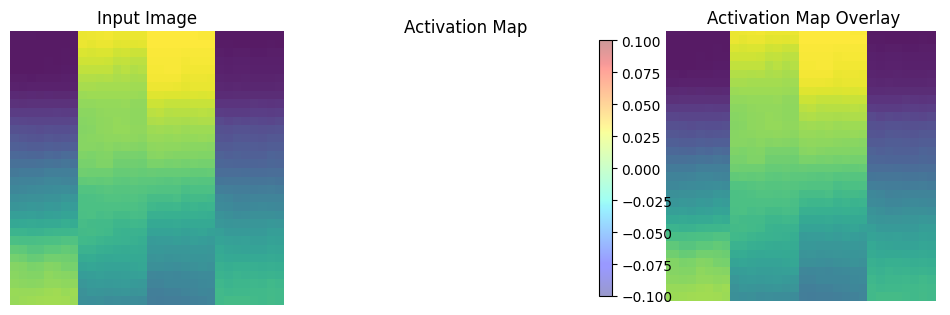

	MNSE Score: 0.005025320449873569
Batch [0/63] -  Critic loss:  -0.8402508497238159 - generator loss:  37.68906784057617
Batch [21/63] -  Critic loss:  -0.8002151729482594 - generator loss:  37.602507851340555
Batch [42/63] -  Critic loss:  -0.8010652827662093 - generator loss:  38.21670807239621
	Epoch 84 - critic loss: -0.8046575428316834 - generator loss: 38.13851849994962


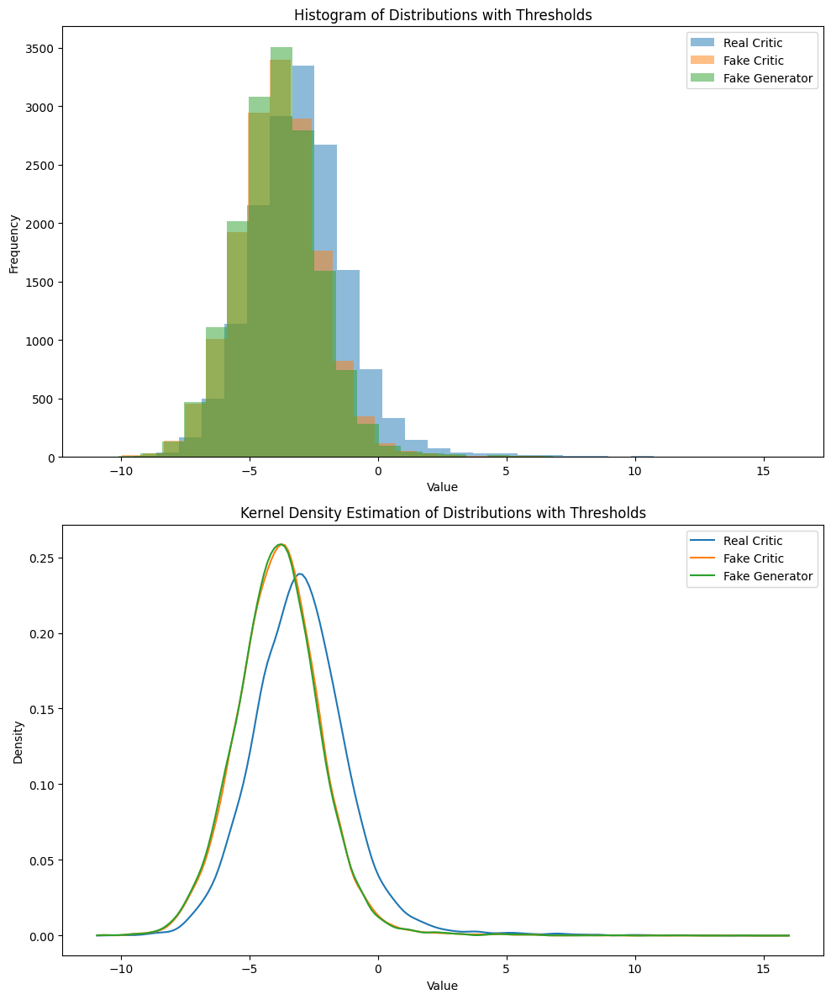

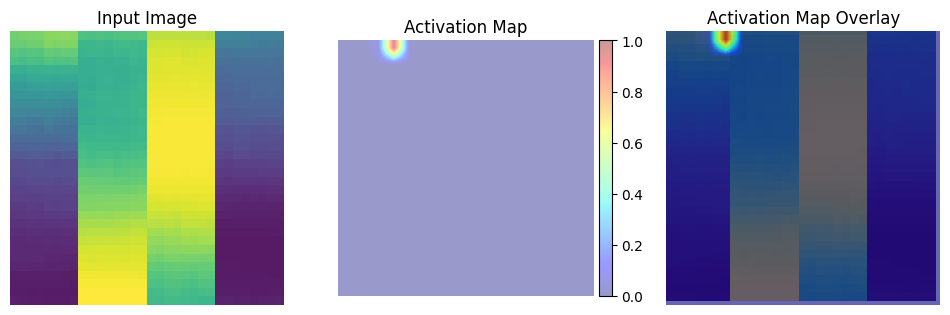

	MNSE Score: 0.005006251597983969
Batch [0/63] -  Critic loss:  -0.7879204352696737 - generator loss:  36.16552734375
Batch [21/63] -  Critic loss:  -0.8172703584035239 - generator loss:  38.27459872852672
Batch [42/63] -  Critic loss:  -0.8130680793939635 - generator loss:  38.22077010398687
	Epoch 85 - critic loss: -0.8206037510009039 - generator loss: 37.97237293303959


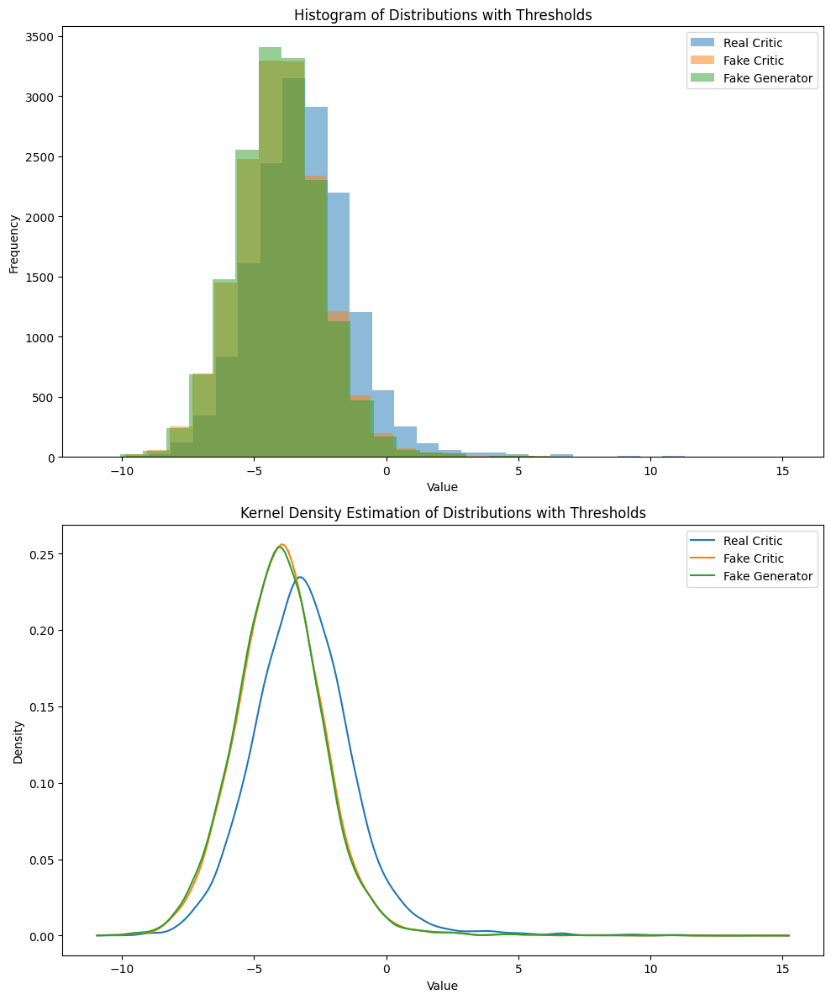

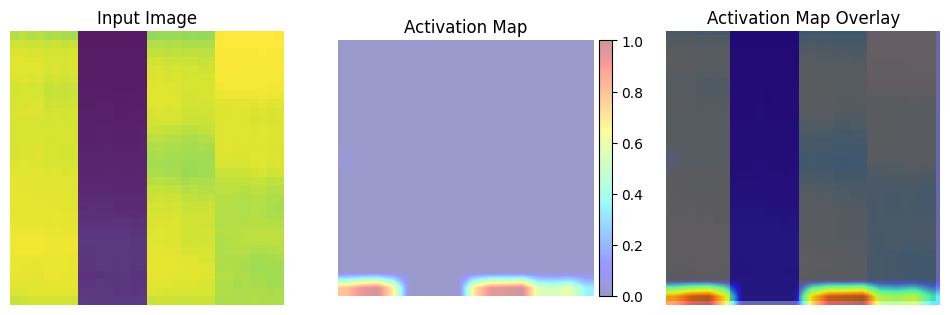

	MNSE Score: 0.004902328608468885
Batch [0/63] -  Critic loss:  -0.7735349933306376 - generator loss:  36.24054718017578
Batch [21/63] -  Critic loss:  -0.8001775470646943 - generator loss:  37.129338871348985
Batch [42/63] -  Critic loss:  -0.7939621237821357 - generator loss:  37.28054082116415
	Epoch 86 - critic loss: -0.8022560338494638 - generator loss: 37.56517976427835


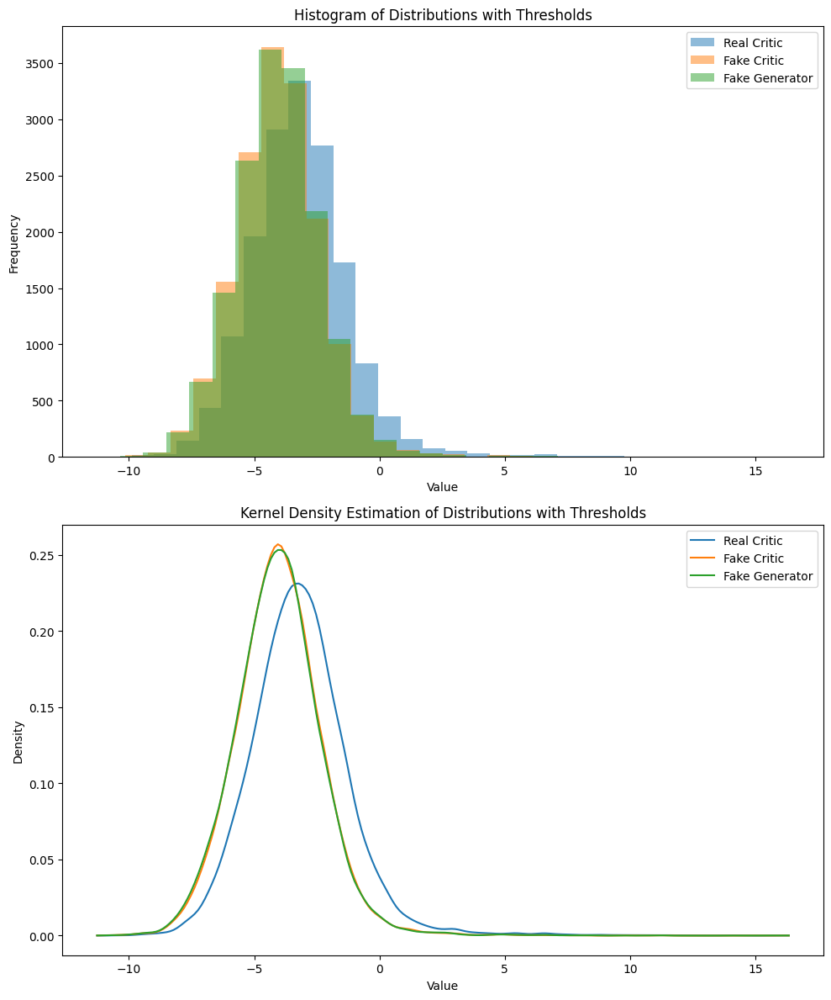

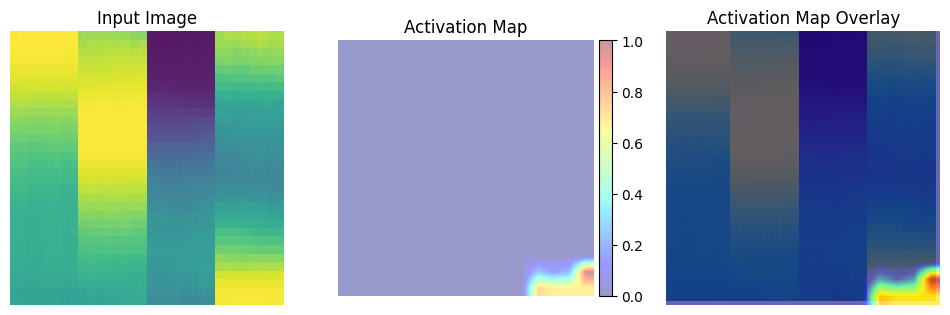

	MNSE Score: 0.004783759270572946
Batch [0/63] -  Critic loss:  -0.7876598238945007 - generator loss:  39.03453826904297
Batch [21/63] -  Critic loss:  -0.820530597007636 - generator loss:  38.531409523703836
Batch [42/63] -  Critic loss:  -0.8072610247966857 - generator loss:  38.45679784375568
	Epoch 87 - critic loss: -0.8092439382795306 - generator loss: 38.19988323393322
Batch [0/63] -  Critic loss:  -0.7544829249382019 - generator loss:  33.046180725097656
Batch [21/63] -  Critic loss:  -0.7946673487171982 - generator loss:  37.127857034856625
Batch [42/63] -  Critic loss:  -0.7920312035915463 - generator loss:  37.523050086442815
	Epoch 88 - critic loss: -0.7931777935810189 - generator loss: 37.920456840878444
Batch [0/63] -  Critic loss:  -0.8096973299980164 - generator loss:  44.31192398071289
Batch [21/63] -  Critic loss:  -0.8188835346337521 - generator loss:  38.50558246265758
Batch [42/63] -  Critic loss:  -0.8109117205752883 - generator loss:  38.229026439578035
	Epoch 89 

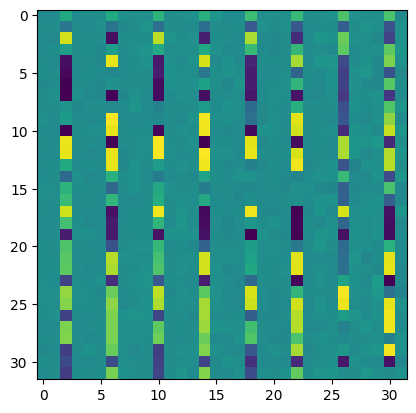

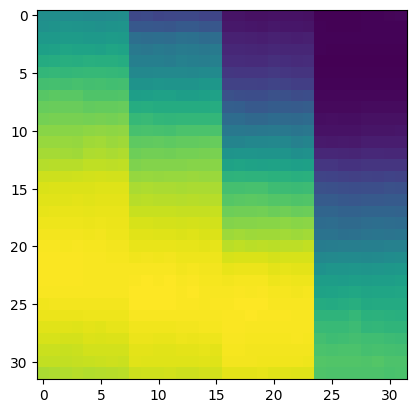

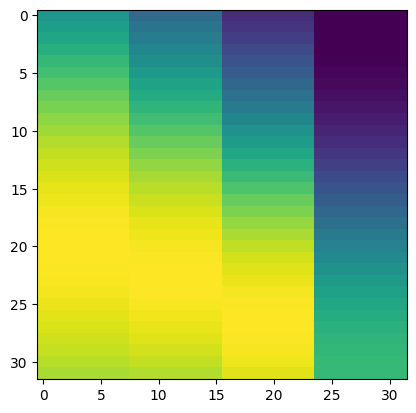

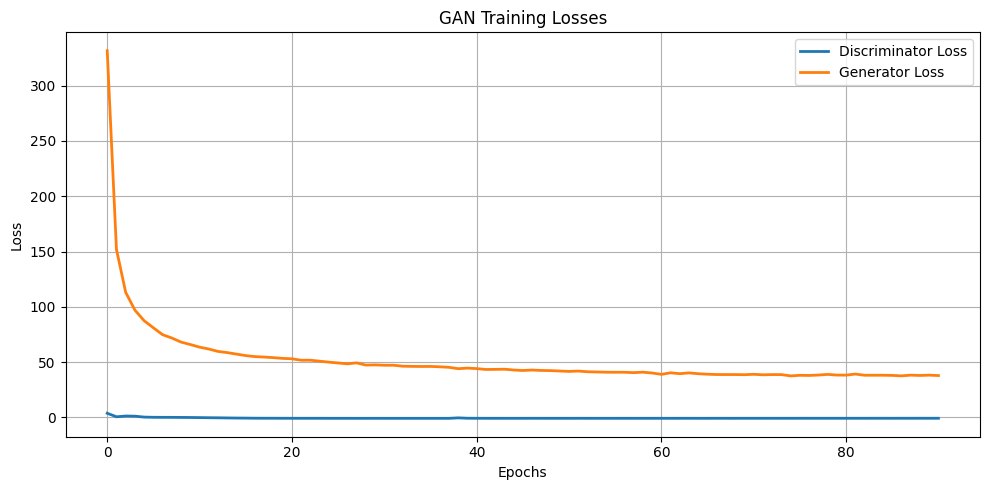

Batch [0/63] -  Critic loss:  -0.7186983823776245 - generator loss:  34.00810623168945
Batch [21/63] -  Critic loss:  -0.7976675999887061 - generator loss:  37.156580144708805
Batch [42/63] -  Critic loss:  -0.7979016650554744 - generator loss:  37.76471674719522
	Epoch 91 - critic loss: -0.7954984442897572 - generator loss: 37.36712543548099


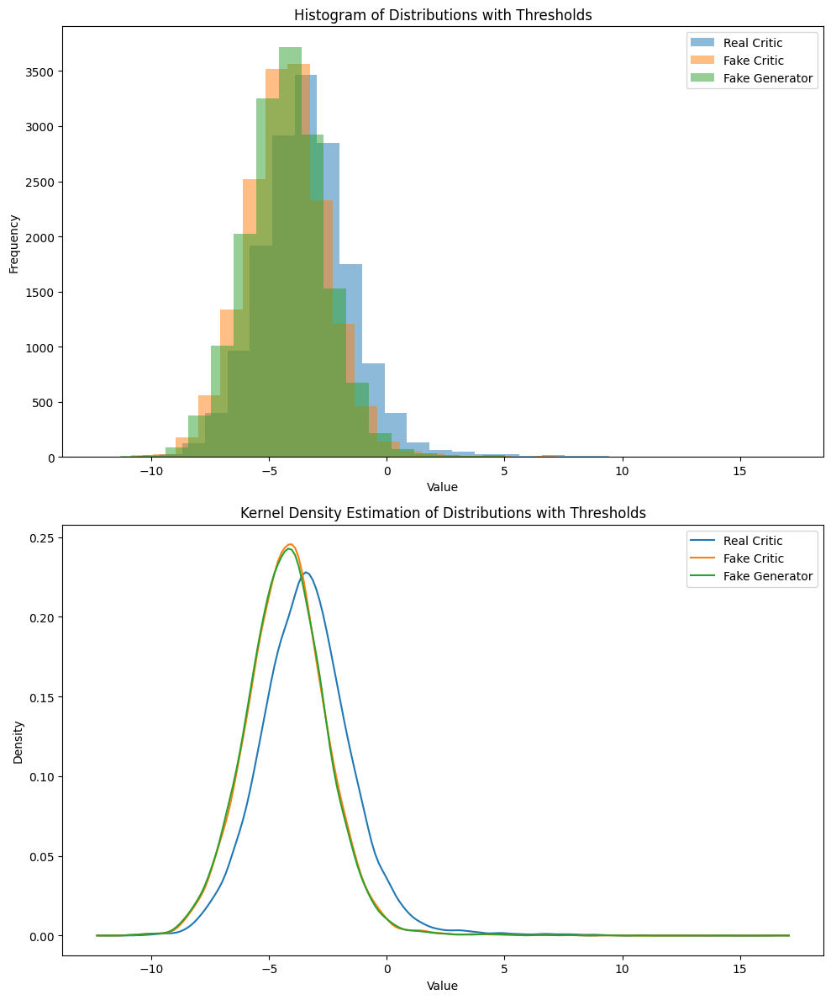

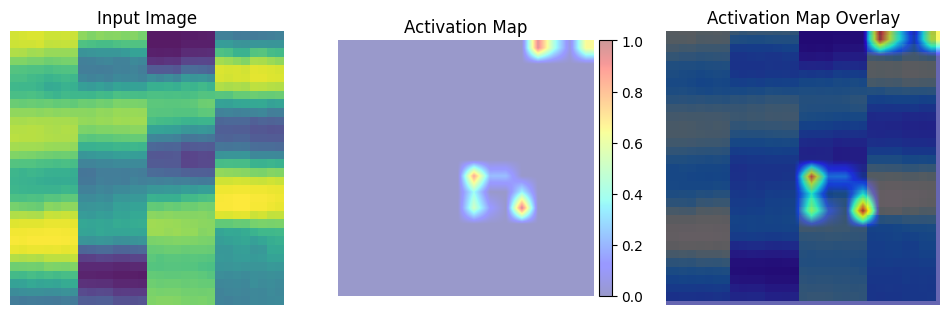

	MNSE Score: 0.004667104584061437
Batch [0/63] -  Critic loss:  -0.7406206329663595 - generator loss:  36.50453186035156
Batch [21/63] -  Critic loss:  -0.7852138172496449 - generator loss:  37.91265192898837
Batch [42/63] -  Critic loss:  -0.7968190238457319 - generator loss:  37.72506013027457
	Epoch 92 - critic loss: -0.79010048429802 - generator loss: 37.83463665795705
Batch [0/63] -  Critic loss:  -0.7936020692189535 - generator loss:  38.589054107666016
Batch [21/63] -  Critic loss:  -0.8012906791585865 - generator loss:  38.10515941273082
Batch [42/63] -  Critic loss:  -0.8018667633219282 - generator loss:  37.67145210088685
	Epoch 93 - critic loss: -0.800262781993422 - generator loss: 37.77486331879147
Batch [0/63] -  Critic loss:  -0.7776770989100138 - generator loss:  35.734275817871094
Batch [21/63] -  Critic loss:  -0.7929825827930915 - generator loss:  37.05521791631525
Batch [42/63] -  Critic loss:  -0.7981373529101529 - generator loss:  37.11494623228561
	Epoch 94 - crit

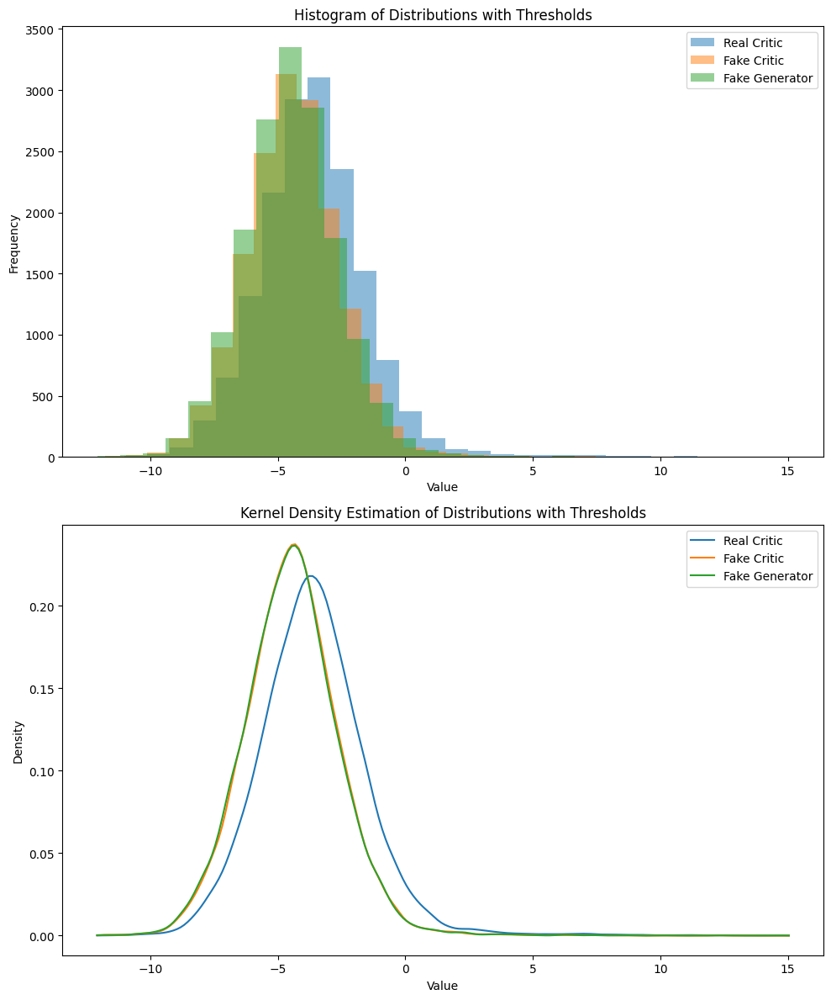

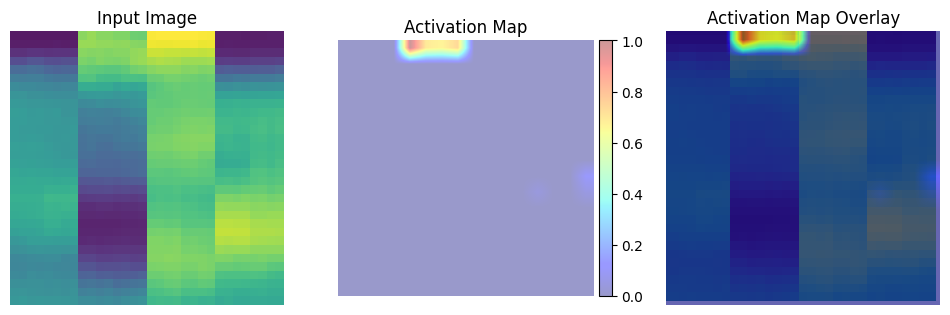

	MNSE Score: 0.004652661005301135
Batch [0/63] -  Critic loss:  -0.9033735990524292 - generator loss:  37.6487922668457
Batch [21/63] -  Critic loss:  -0.8146021889917777 - generator loss:  36.60708184675737
Batch [42/63] -  Critic loss:  -0.8105780944343685 - generator loss:  37.09451010060865
	Epoch 95 - critic loss: -0.8063653057845178 - generator loss: 37.29039155869257


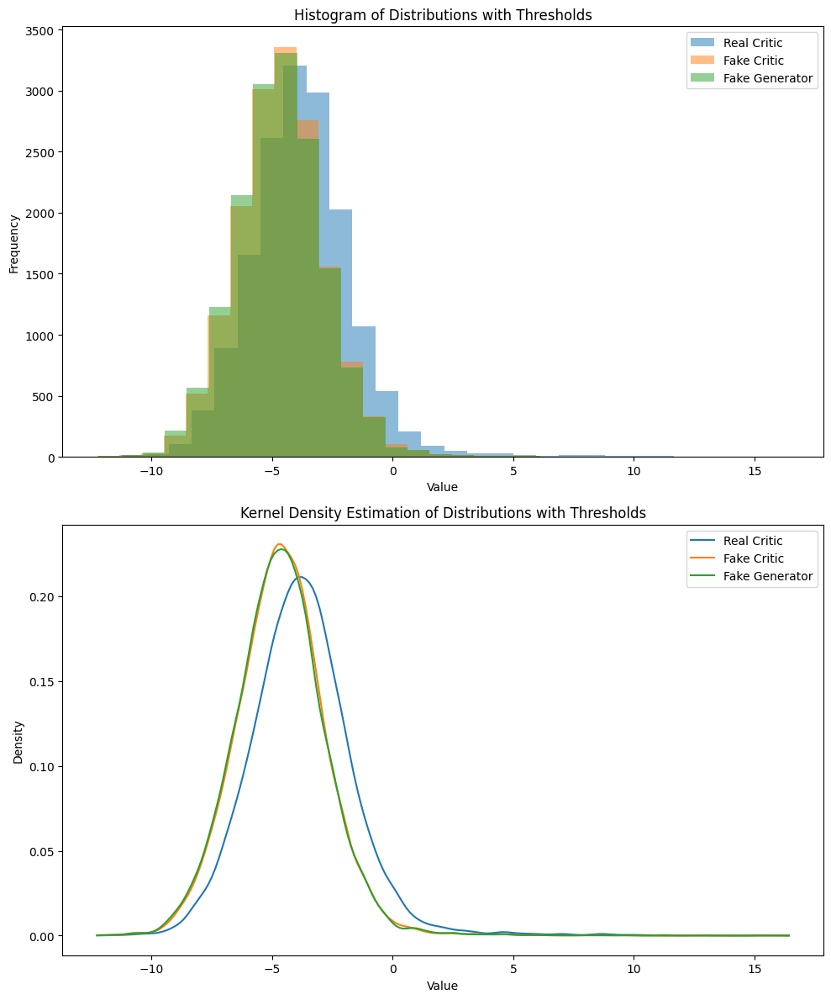

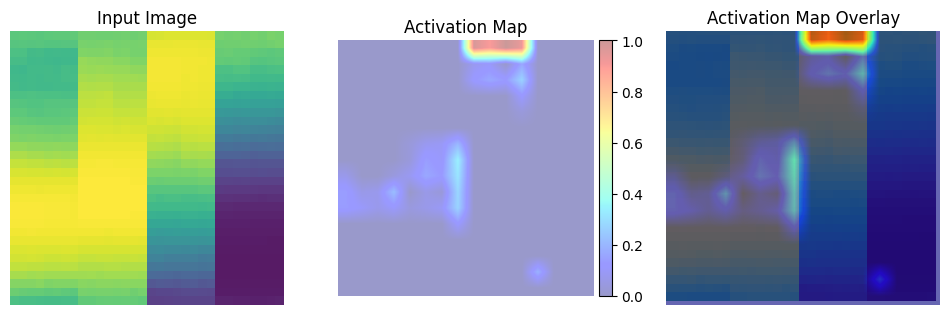

	MNSE Score: 0.004531288756028054
Batch [0/63] -  Critic loss:  -0.7061630884806315 - generator loss:  42.30839538574219
Batch [21/63] -  Critic loss:  -0.7919524411360424 - generator loss:  37.4858736558394
Batch [42/63] -  Critic loss:  -0.7914670137471931 - generator loss:  37.15095253877862
	Epoch 96 - critic loss: -0.785181131943193 - generator loss: 37.2858028714619


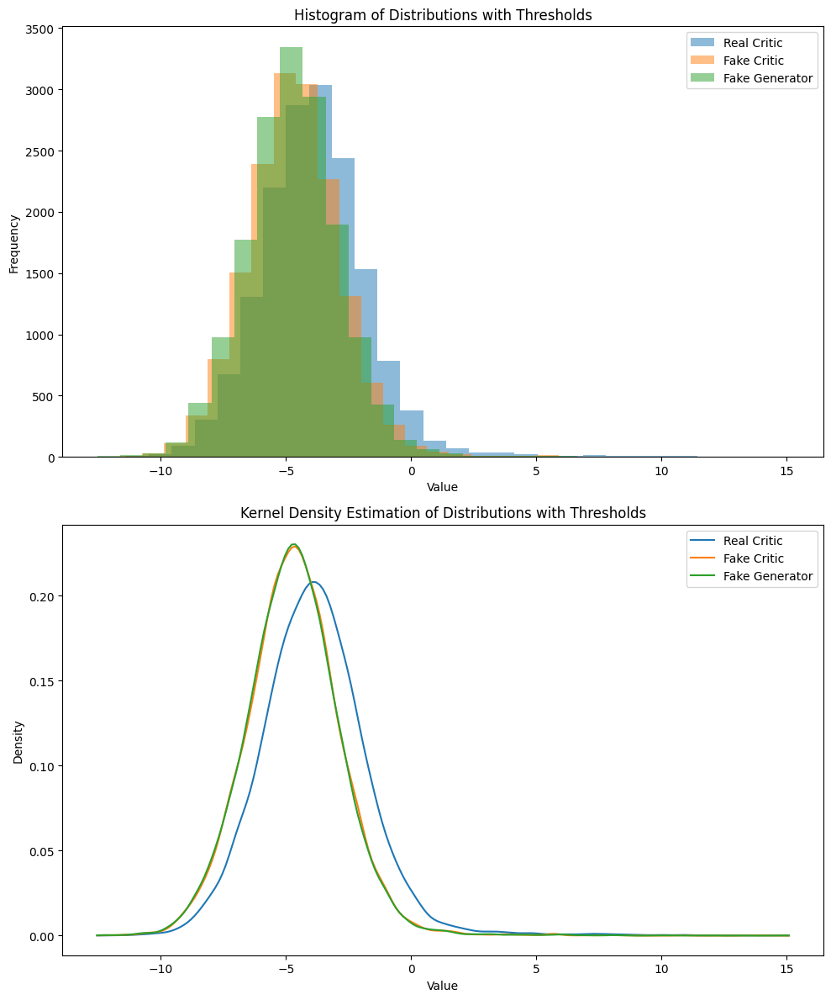

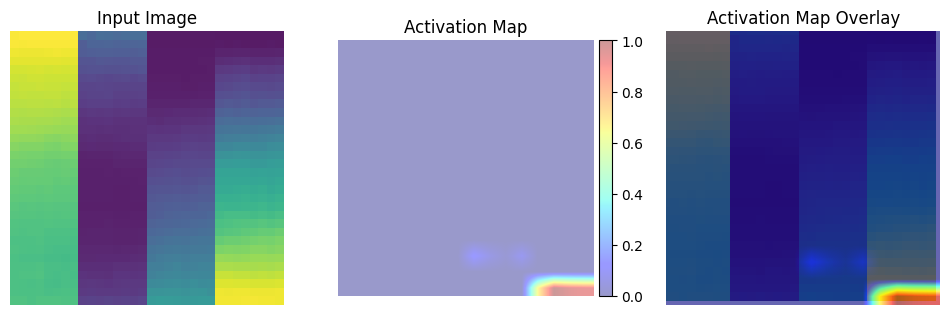

	MNSE Score: 0.004506470842493905
Batch [0/63] -  Critic loss:  -0.8008168935775757 - generator loss:  35.44816970825195
Batch [21/63] -  Critic loss:  -0.7716117474165831 - generator loss:  37.17261782559481
Batch [42/63] -  Critic loss:  -0.7779278450233992 - generator loss:  37.45022653978924
	Epoch 97 - critic loss: -0.7815157597657867 - generator loss: 37.71744180104089
Batch [0/63] -  Critic loss:  -0.7019563714663187 - generator loss:  36.8896598815918
Batch [21/63] -  Critic loss:  -0.7709944970680006 - generator loss:  37.38569450378418
Batch [42/63] -  Critic loss:  -0.7837459976358931 - generator loss:  37.528638529223066
	Epoch 98 - critic loss: -0.7879039165834902 - generator loss: 37.276614204285636


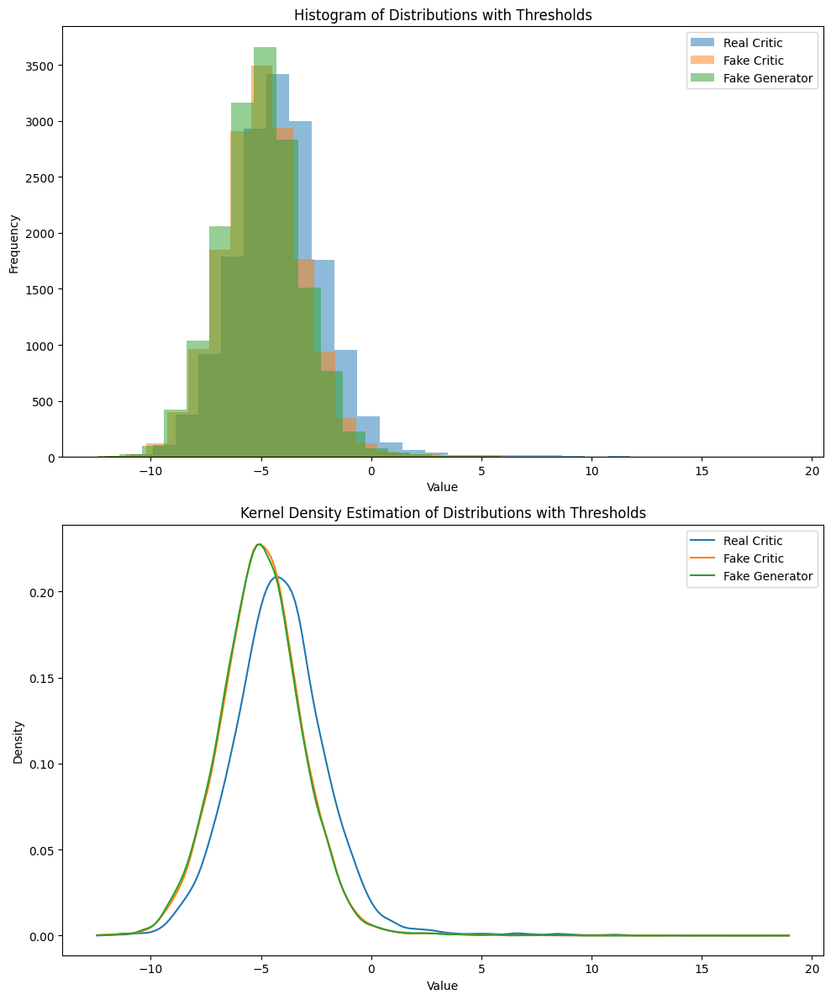

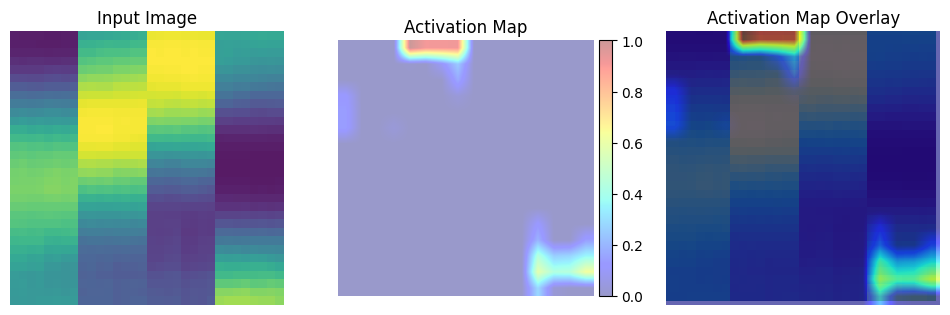

	MNSE Score: 0.004426907633416473
Batch [0/63] -  Critic loss:  -0.6945113937060038 - generator loss:  33.435340881347656
Batch [21/63] -  Critic loss:  -0.7730168049985712 - generator loss:  38.23622651533647
Batch [42/63] -  Critic loss:  -0.7807482249977051 - generator loss:  37.77621255918991
	Epoch 99 - critic loss: -0.7841705919573547 - generator loss: 37.65471679445297


In [ ]:
channel_est_wgan_gp_rec_loss()

## WGAN_GP + Threshold Distribution

In [ ]:
import numpy as np


def compute_prob_real_samples(samples, threshold):
    real_samples = np.array(samples) > threshold
    return np.sum(real_samples) / len(samples)

def compute_prob_fake_samples(samples, threshold):
    fake_samples = np.array(samples) < threshold
    return np.sum(fake_samples) / len(samples)

def compute_center(samples):
    center = (max(samples) + min(samples)) / 2
    return center

def compute_centroid(samples):
    centroid = sum(samples) / len(samples)
    return centroid

In [ ]:
generator = Generator((32 * 32 * 2)).to(device)
critic = Critic().to(device)

# Initialize weights
generator = generator.apply(weights_init)
critic = critic.apply(weights_init)

# Optimizer is Adam help converge faster and more stable
g_opt = torch.optim.Adam(generator.parameters(), lr=lr, betas=betas)
c_opt = torch.optim.Adam(critic.parameters(), lr=lr, betas=betas)

skew_cal = SkewCalculator(device)


In [ ]:
def channel_est_wgan_gp_rec_loss_thresh():
    save_results = "channel_est_wgan_gp_rec_loss_thresh"
    min_nmse_scores = 10000000
    total_g_losses = []
    total_c_losses = []
    total_nmse_scores = []
    for epoch in range(n_epochs):
        # Training
        g_losses = 0
        c_losses = 0
        nmse_scores = 0
        if epoch == 0:
            c_lambda_2 = 0.0
        else:
            c_lambda_2 = 0.1
        total_critic_reals = []
        total_critic_fakes = []
        total_generator_fakes = []

        generator.train()
        critic.train()
        for batch_index, (real, label) in enumerate(train_dataset):

            real = real.to(device)
            label = label.to(device)
            cur_batch_size = real.shape[0]
            #################
            # Update critic #
            #################
            total_c_repeat_losses = 0
            critic_reals = 0
            critic_fakes = 0
            for _ in range(critic_repeats):
                c_opt.zero_grad()

                fake = generator(label)

                # critic loss
                critic_real = critic(real)
                critic_fake = critic(fake)

                c_repeat_loss = - (torch.mean(critic_real) - torch.mean(critic_fake))

                # gp loss
                gp_loss = gradient_penalty_loss(critic=critic, real=real, fake=fake)

                # total critic loss
                total_c_repeat_loss = c_repeat_loss + c_lambda * gp_loss

                # Update gradients
                total_c_repeat_loss.backward(retain_graph=True)

                # Update optimizer
                c_opt.step()

                # Keep track of the average critic loss in this batch
                critic_reals += critic_real.detach().cpu()
                critic_fakes += critic_fake.detach().cpu()

                total_c_repeat_losses += total_c_repeat_loss.detach().cpu().item()

            total_critic_reals.append((critic_reals / critic_repeats).view(-1))
            total_critic_fakes.append((critic_fakes / critic_repeats).view(-1))
            c_losses += total_c_repeat_losses / critic_repeats

            ####################
            # Update generator #
            ####################
            g_opt.zero_grad()

            # get noise
            fake_2 = generator(label)

            critic_fake_2 = critic(fake_2)


            g_loss = - torch.mean(critic_fake_2) + l2_loss(fake_2, real)


            # Update gradients
            g_loss.backward()

            # Update the weights
            g_opt.step()

            g_losses += g_loss.detach().cpu().item()
            total_generator_fakes.append(critic_fake_2.detach().cpu().view(-1))

            if batch_index % (len(train_dataset) // 3) == 0:
                print(f"Batch [{batch_index}/{len(train_dataset)}] - ",  "Critic loss: ",  c_losses / (batch_index + 1), "- generator loss: ", g_losses / (batch_index + 1))

            nmse_score = nmse(
                pred=fake.permute(0, 2, 3, 1).detach().cpu(),
                target=real.permute(0, 2, 3, 1).detach().cpu(),
            )
            nmse_scores += nmse_score

        total_nmse_scores.append(nmse_scores / len(train_dataset))
        total_c_losses.append(c_losses / len(train_dataset))
        total_g_losses.append(g_losses / len(train_dataset))


        print(f"\tEpoch {epoch} - critic loss: {total_c_losses[-1]} - generator loss: {total_g_losses[-1]}")

        generator.eval()
        critic.eval()
        # Visualize Test Dataset
        with torch.no_grad():
            for real, label in eval_dataset:
                cur_batch_size = real.shape[0]
                real = real.to(device)
                label = label.to(device)
                fake = generator(label)
                break
        if epoch in range(0, n_epochs, int(n_epochs // 10)):
            show_tensor_images(label.view(-1, 2, 32, 32)[0,0,:,:].T)
            show_tensor_images(fake[0,0,:,:])
            show_tensor_images(real[0,0,:,:])
            show_loss_images(total_c_losses, total_g_losses)


        if min_nmse_scores > min(total_nmse_scores):
            min_nmse_scores = min(total_nmse_scores)
            plot_generated_image(
                fake[0,0,:,:],
                test_input=label.view(-1, 2, 32, 32)[0,0,:,:].T,
                tar=real[0,0,:,:],
                prefix=save_results,
            )

            plot_distribution(
                np.array(torch.cat(total_critic_reals)),
                np.array(torch.cat(total_critic_fakes)),
                np.array(torch.cat(total_generator_fakes)),
                save_path=f"results/dis/{save_results}/dis_{epoch}.png"
            )
            save_checkpoint(generator, f"results/checkpoint/{save_results}/g_model.pt")
            save_checkpoint(critic, f"results/checkpoint/{save_results}/d_model.pt")

            conv_layer = critic.critic[-3]
            grad_cam = GradCam(critic, conv_layer)
            grad_cam.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_1_epoch{epoch}.png")

            print(f"\tMNSE Score: {min_nmse_scores}")

        plot_nmse_func(
            total_nmse_scores,
            range(epoch + 1),
            img_path=f"results/nmse/{save_results}/nmse.png",
        )
        plot_loss_func(
            total_c_losses,
            total_g_losses,
            range(epoch + 1),
            img_path=f"results/loss/{save_results}/loss.png",
        )
    save_npy(f"results/nmse/{save_results}/nmse_scores.npy", np.array(total_nmse_scores))
    save_npy(f"results/loss/{save_results}/losses_d.npy", np.array(total_c_losses))
    save_npy(f"results/loss/{save_results}/losses_g.npy", np.array(total_g_losses))


In [ ]:
# channel_est_wgan_gp_rec_loss_thresh()

In [ ]:
generator = Generator((32 * 32 * 2)).to(device)
critic = Critic().to(device)

# Initialize weights
generator = generator.apply(weights_init)
critic = critic.apply(weights_init)

# Optimizer is Adam help converge faster and more stable
g_opt = torch.optim.Adam(generator.parameters(), lr=lr, betas=betas)
c_opt = torch.optim.Adam(critic.parameters(), lr=lr, betas=betas)

skew_cal = SkewCalculator(device)

In [ ]:
def channel_est_wgan_gp_rec_skew_loss():
    save_results = "channel_est_wgan_gp_rec_skew_loss"
    min_nmse_scores = 10000000
    total_g_losses = []
    total_c_losses = []
    total_nmse_scores = []
    total_skewness = []
    for epoch in range(n_epochs):
        # Training
        g_losses = 0
        c_losses = 0
        g_skewness = 0
        nmse_scores = 0
        if epoch == 0:
            c_lambda_2 = 0.0
        else:
            c_lambda_2 = 0.1
        total_critic_reals = []
        total_critic_fakes = []
        total_generator_fakes = []

        generator.train()
        critic.train()
        for batch_index, (real, label) in enumerate(train_dataset):

            real = real.to(device)
            label = label.to(device)
            cur_batch_size = real.shape[0]
            #################
            # Update critic #
            #################
            total_c_repeat_losses = 0
            critic_reals = 0
            critic_fakes = 0
            for _ in range(critic_repeats):
                c_opt.zero_grad()

                fake = generator(label)

                # critic loss
                critic_real = critic(real)
                critic_fake = critic(fake)

                c_repeat_loss = - (torch.mean(critic_real) - torch.mean(critic_fake))

                # gp loss
                gp_loss = gradient_penalty_loss(critic=critic, real=real, fake=fake)

                # total critic loss
                total_c_repeat_loss = c_repeat_loss + c_lambda * gp_loss
                # Update gradients
                total_c_repeat_loss.backward(retain_graph=True)

                # Update optimizer
                c_opt.step()

                # Keep track of the average critic loss in this batch
                critic_reals += critic_real.detach().cpu()
                critic_fakes += critic_fake.detach().cpu()

                total_c_repeat_losses += total_c_repeat_loss.detach().cpu().item()

            total_critic_reals.append((critic_reals / critic_repeats).view(-1))
            total_critic_fakes.append((critic_fakes / critic_repeats).view(-1))
            c_losses += total_c_repeat_losses / critic_repeats

            ####################
            # Update generator #
            ####################
            g_opt.zero_grad()

            # get noise
            fake_2 = generator(label)

            critic_fake_2 = critic(fake_2)

            skew_loss_2 = l2_loss(skew_cal(real.view(real.size(0), -1)),skew_cal(fake_2.view(fake_2.size(0), -1)))

            g_loss = - torch.mean(critic_fake_2) + l2_loss(fake_2, real) + skew_loss_2


            # Update gradients
            g_loss.backward()

            # Update the weights
            g_opt.step()

            g_losses += g_loss.detach().cpu().item()
            total_generator_fakes.append(critic_fake_2.detach().cpu().view(-1))
            g_skewness += skew_loss_2.detach().cpu().item()

            if batch_index % (len(train_dataset) // 3) == 0:
                print(f"Batch [{batch_index}/{len(train_dataset)}] - ",  "Critic loss: ",  c_losses / (batch_index + 1), "- generator loss: ", g_losses / (batch_index + 1))

            nmse_score = nmse(
                pred=fake.permute(0, 2, 3, 1).detach().cpu(),
                target=real.permute(0, 2, 3, 1).detach().cpu(),
            )
            nmse_scores += nmse_score

        total_nmse_scores.append(nmse_scores / len(train_dataset))
        total_c_losses.append(c_losses / len(train_dataset))
        total_g_losses.append(g_losses / len(train_dataset))
        total_skewness.append(g_skewness / len(train_dataset))


        print(f"\tEpoch {epoch} - critic loss: {total_c_losses[-1]} - generator loss: {total_g_losses[-1]}")

        generator.eval()
        critic.eval()
        # Visualize Test Dataset
        with torch.no_grad():
            for real, label in eval_dataset:
                cur_batch_size = real.shape[0]
                real = real.to(device)
                label = label.to(device)
                fake = generator(label)
                break
        if epoch in range(0, n_epochs, int(n_epochs // 10)):
            show_tensor_images(label.view(-1, 2, 32, 32)[0,0,:,:].T)
            show_tensor_images(fake[0,0,:,:])
            show_tensor_images(real[0,0,:,:])
            show_loss_images(total_c_losses, total_g_losses)

            grad_cam = GradCam(critic, critic.critic[-3])
            grad_cam_1 = GradCam(critic, critic.critic[-2])
            grad_cam_2 = GradCam(critic, critic.critic[-1])
            grad_cam.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_1_epoch{epoch}.png")
            grad_cam_1.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_2_epoch{epoch}.png")
            grad_cam_2.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_3_epoch{epoch}.png")


        if min_nmse_scores > min(total_nmse_scores):
            min_nmse_scores = min(total_nmse_scores)
            plot_generated_image(
                fake[0,0,:,:],
                test_input=label.view(-1, 2, 32, 32)[0,0,:,:].T,
                tar=real[0,0,:,:],
                prefix=save_results,
            )

            plot_distribution(
                np.array(torch.cat(total_critic_reals)),
                np.array(torch.cat(total_critic_fakes)),
                np.array(torch.cat(total_generator_fakes)),
                save_path=f"results/dis/{save_results}/dis_{epoch}.png"
            )
            save_checkpoint(generator, f"results/checkpoint/{save_results}/g_model.pt")
            save_checkpoint(critic, f"results/checkpoint/{save_results}/d_model.pt")

            grad_cam = GradCam(critic, critic.critic[-3][0])
            grad_cam_1 = GradCam(critic, critic.critic[-2][0])
            grad_cam_2 = GradCam(critic, critic.critic[-1][0])
            grad_cam.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_1_epoch{epoch}.png")
            grad_cam_1.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_2_epoch{epoch}.png")
            grad_cam_2.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_3_epoch{epoch}.png")


            print(f"\tMNSE Score: {min_nmse_scores}")

        plot_nmse_func(
            total_nmse_scores,
            range(epoch + 1),
            img_path=f"results/nmse/{save_results}/nmse.png",
        )
        plot_loss_func(
            total_c_losses,
            total_g_losses,
            range(epoch + 1),
            img_path=f"results/loss/{save_results}/loss.png",
        )

        plot_skewness_func(
            total_skewness,
            range(epoch + 1),
            img_path=f"results/skewness/{save_results}/skewness.png",
        )

    save_npy(f"results/nmse/{save_results}/nmse_scores.npy", np.array(total_nmse_scores))
    save_npy(f"results/loss/{save_results}/losses_d.npy", np.array(total_c_losses))
    save_npy(f"results/loss/{save_results}/losses_g.npy", np.array(total_g_losses))


Batch [0/63] -  Critic loss:  9.862274805704752 - generator loss:  492.931884765625
Batch [21/63] -  Critic loss:  5.228999896482987 - generator loss:  459.4855096990412
Batch [42/63] -  Critic loss:  4.5935666570367735 - generator loss:  393.5970565441043
	Epoch 0 - critic loss: 3.727842193431955 - generator loss: 349.91561913868736


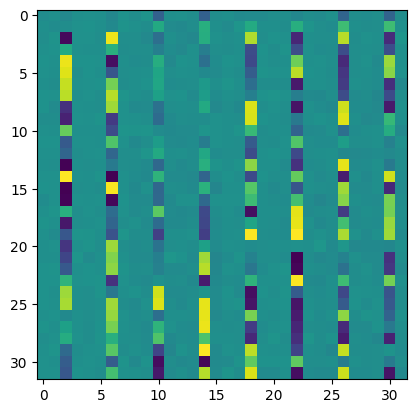

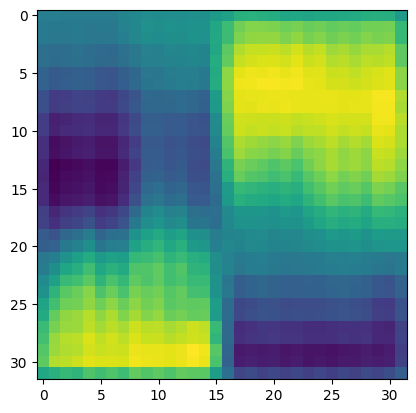

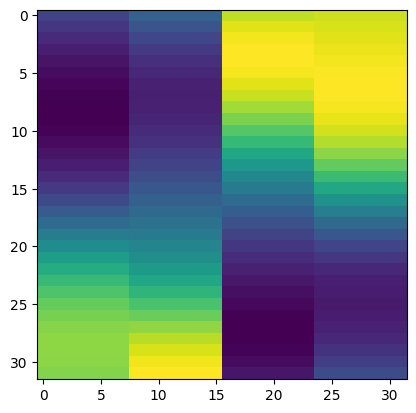

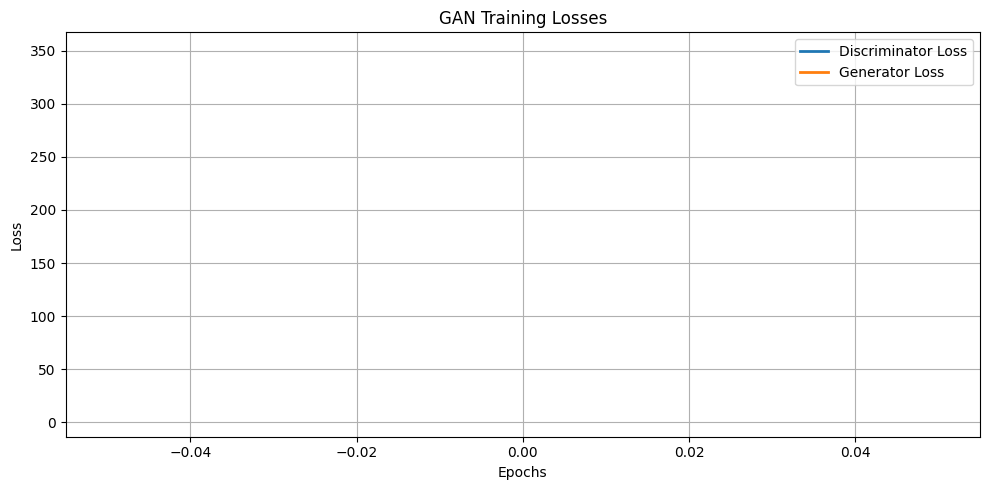

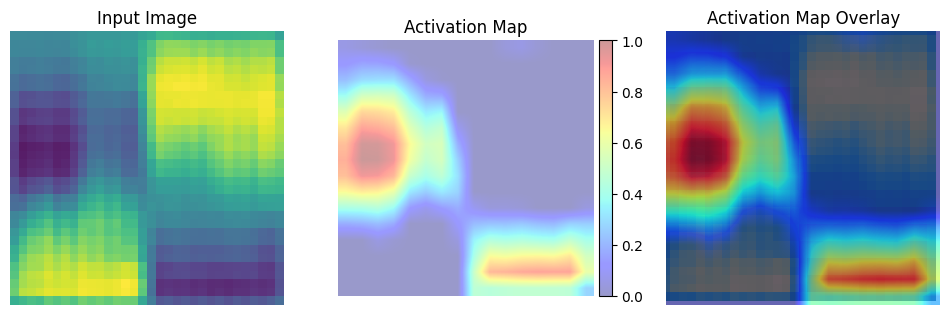

...

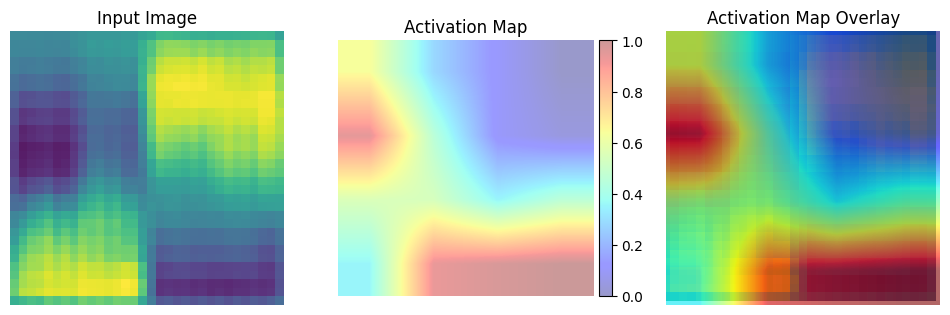

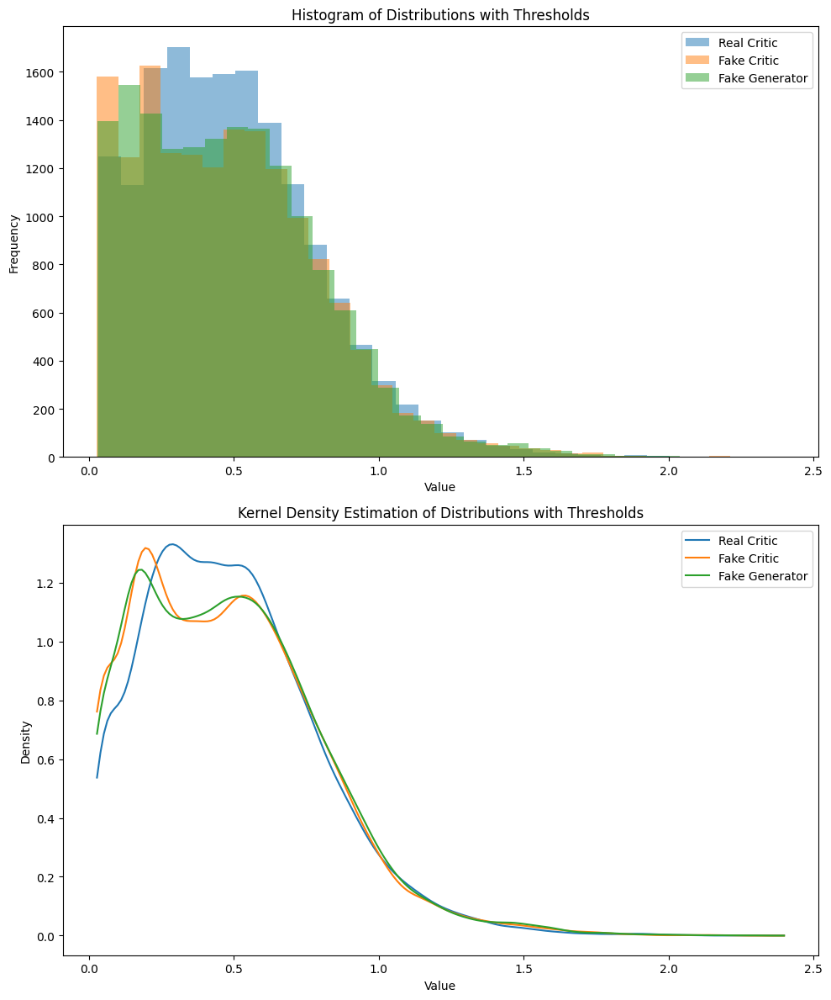

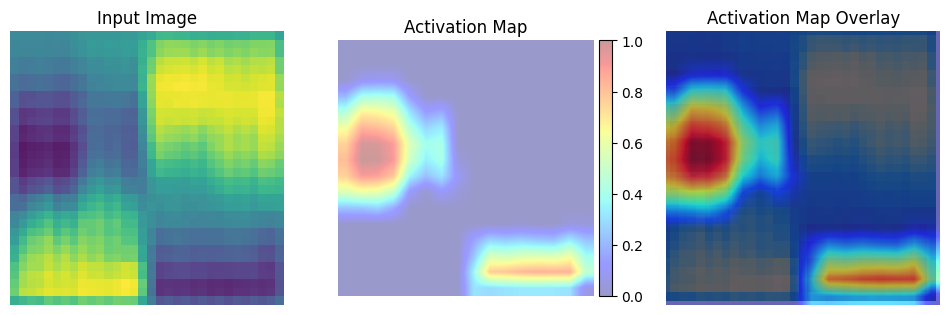

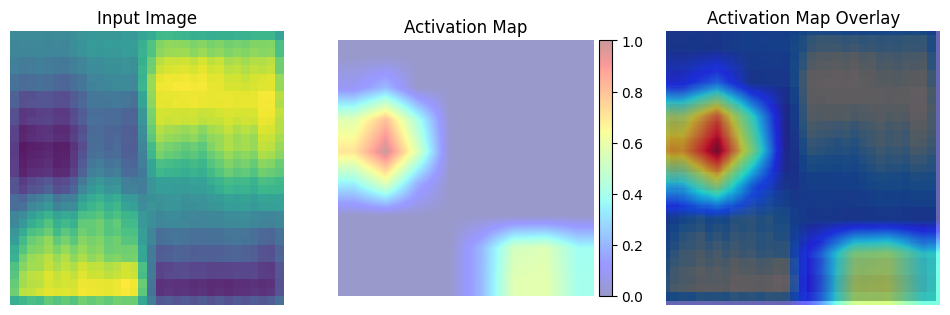

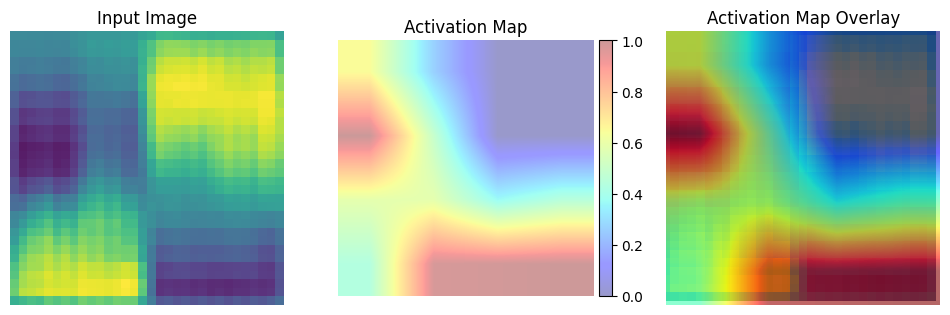

	MNSE Score: 0.5401831110791554
Batch [0/63] -  Critic loss:  0.7911717494328817 - generator loss:  224.12139892578125
Batch [21/63] -  Critic loss:  1.3398762832988393 - generator loss:  197.65790765935725
Batch [42/63] -  Critic loss:  3.3211760989917343 - generator loss:  178.2497068893078
	Epoch 1 - critic loss: 3.76090273954881 - generator loss: 165.7819611080109


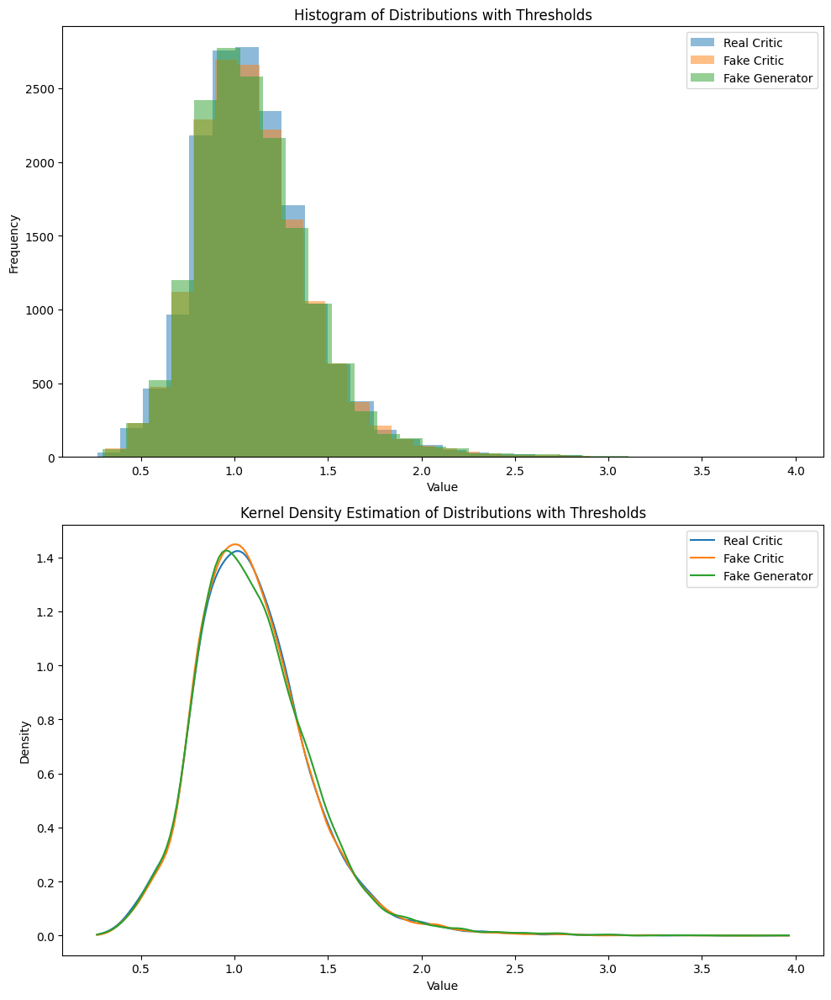

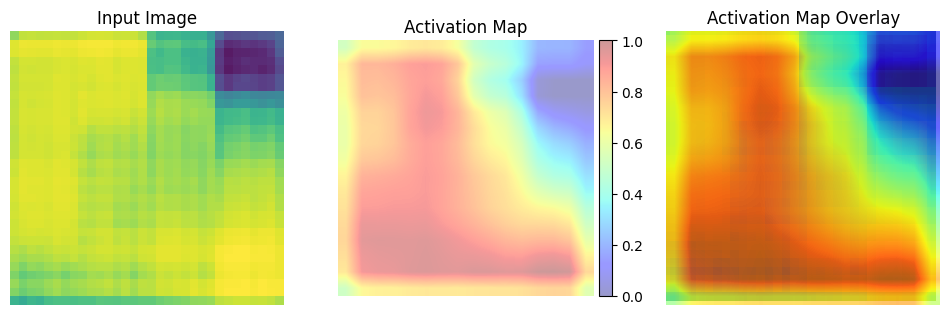

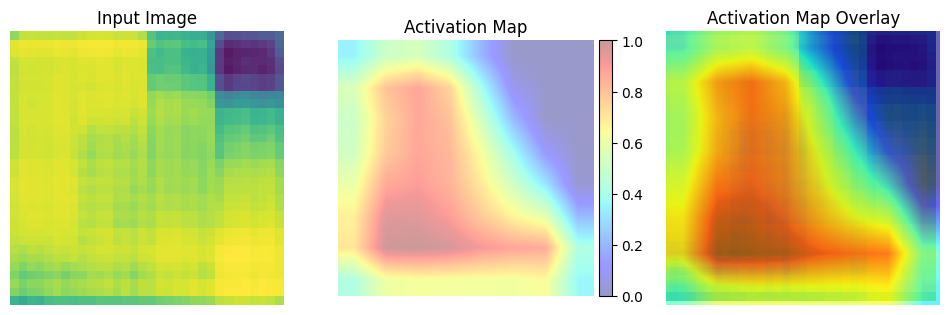

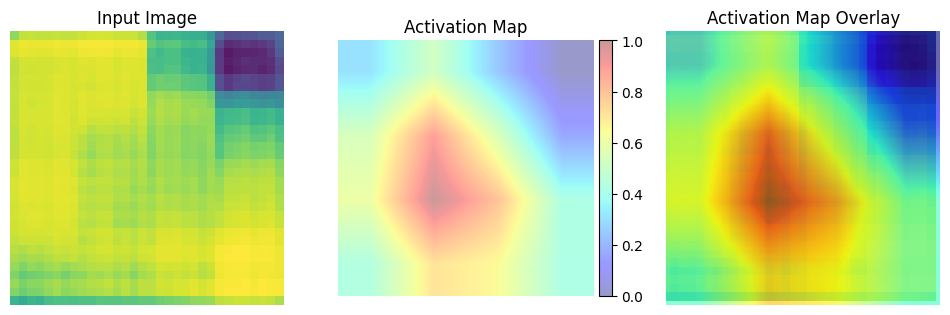

	MNSE Score: 0.11800756045277157
Batch [0/63] -  Critic loss:  6.28009557723999 - generator loss:  127.55305480957031
Batch [21/63] -  Critic loss:  2.291848166422411 - generator loss:  127.76748310435902
Batch [42/63] -  Critic loss:  1.8870292407597684 - generator loss:  123.30758099223293
	Epoch 2 - critic loss: 1.561609191553933 - generator loss: 118.95560527983166


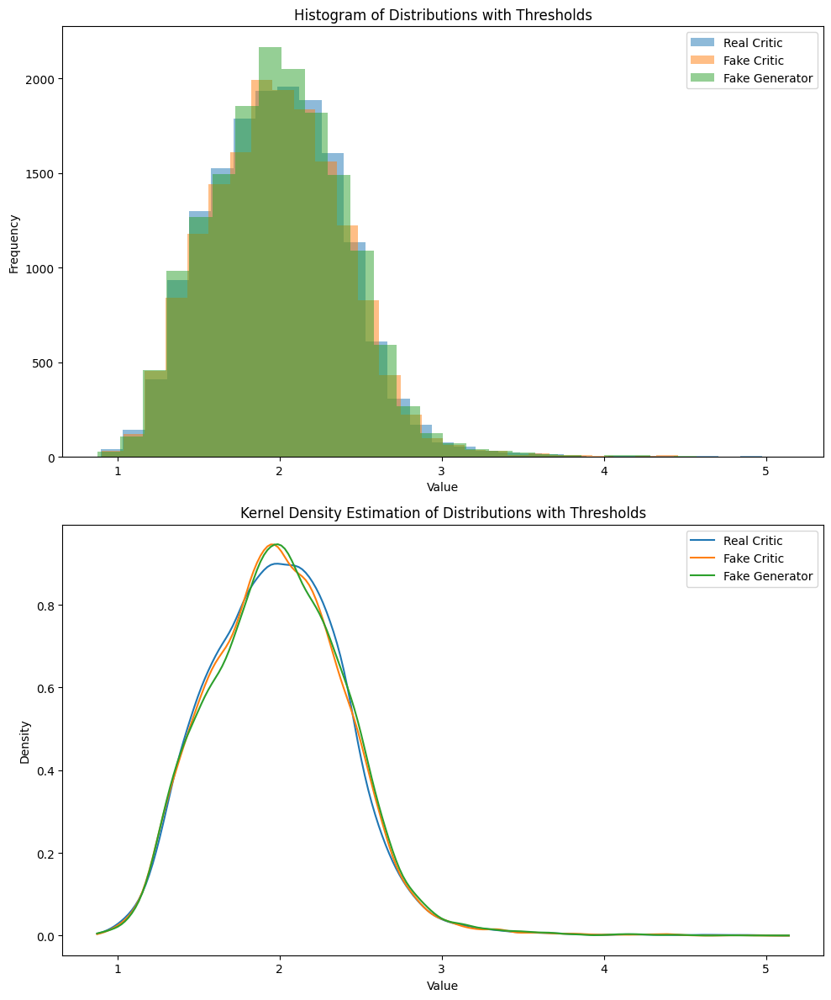

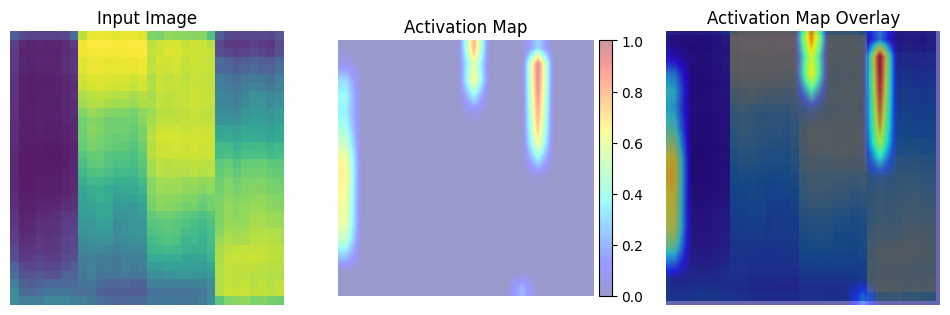

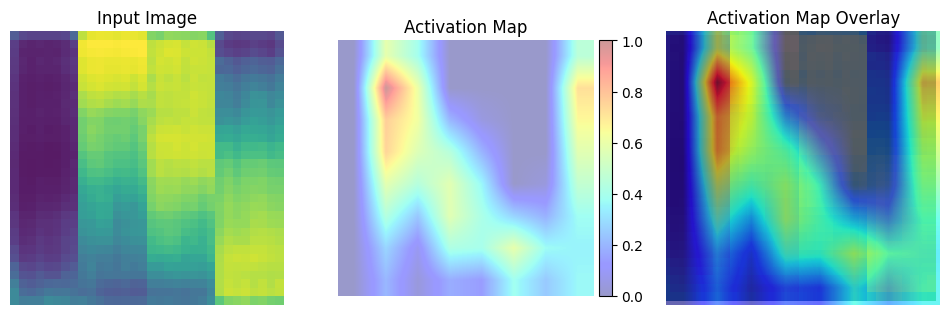

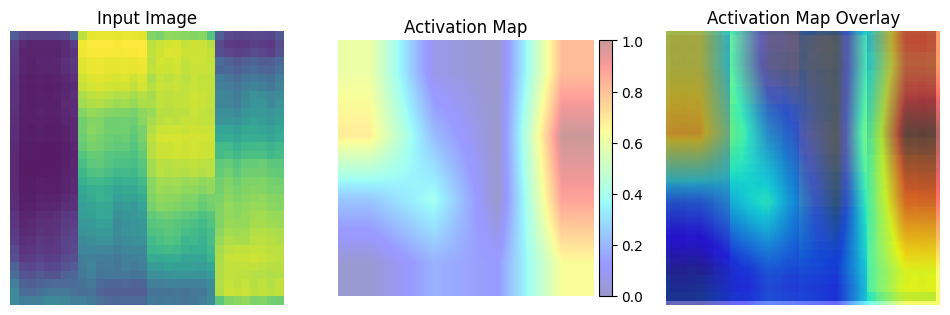

	MNSE Score: 0.06067503551169047
Batch [0/63] -  Critic loss:  0.5248127778371176 - generator loss:  108.24505615234375
Batch [21/63] -  Critic loss:  0.6650845756133399 - generator loss:  105.17412359064275
Batch [42/63] -  Critic loss:  0.6377201477686565 - generator loss:  104.09511761332668
	Epoch 3 - critic loss: 0.5278095724406066 - generator loss: 102.23595670669798


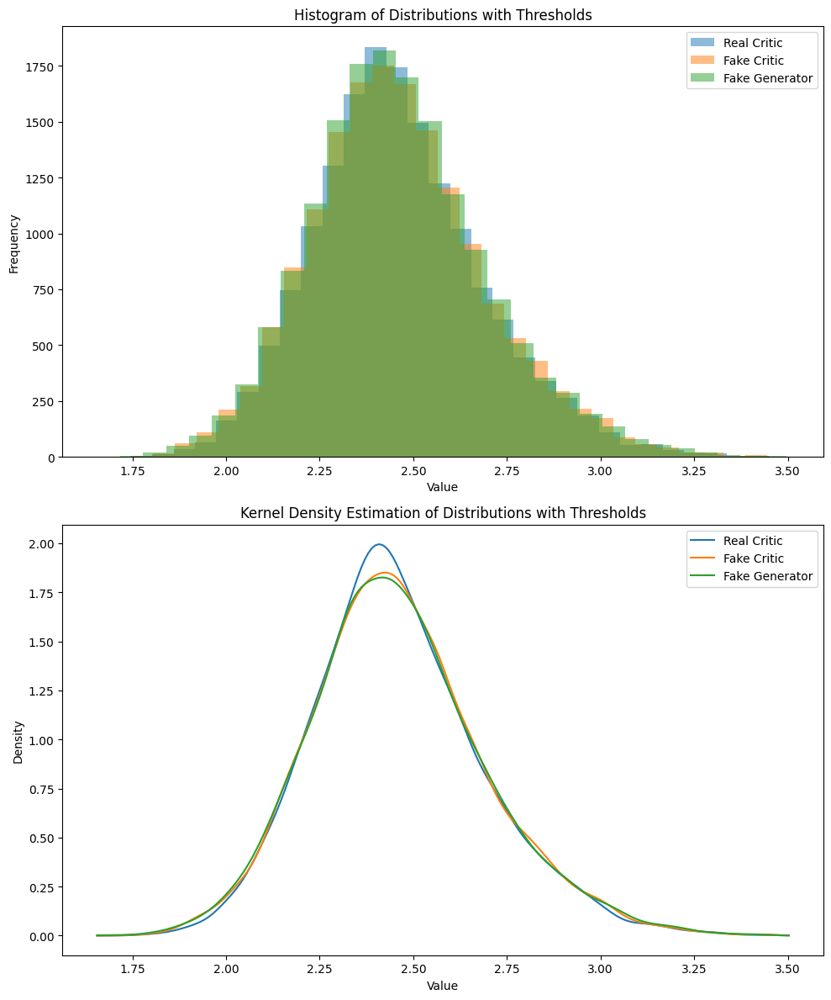

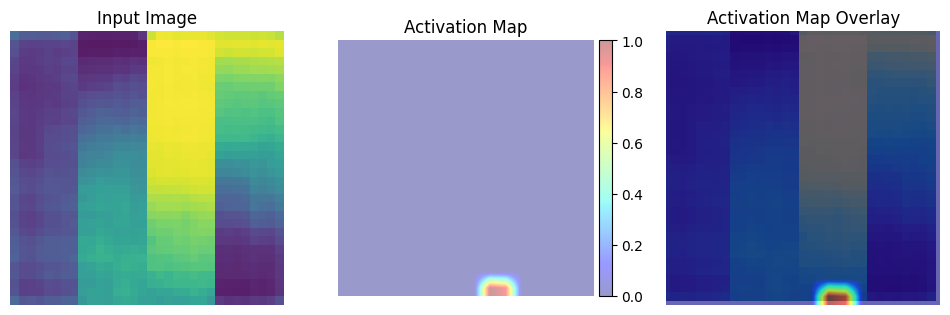

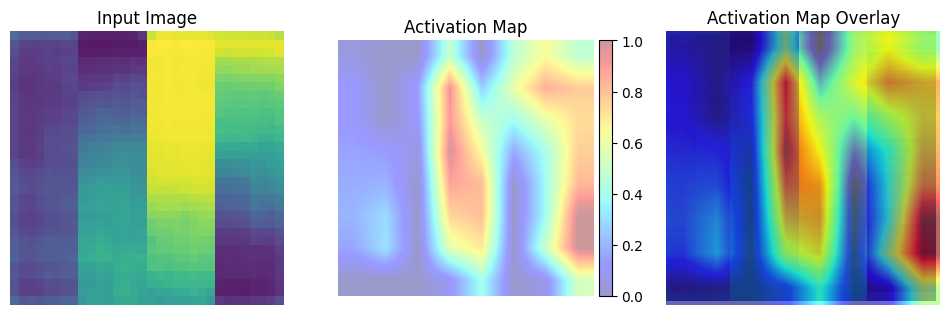

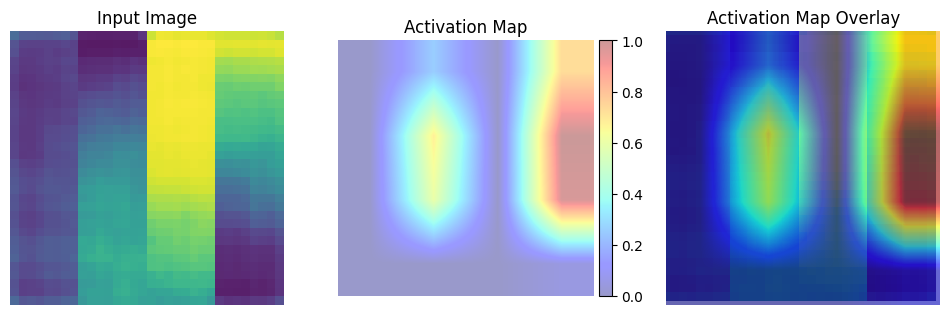

	MNSE Score: 0.04535161833914499
Batch [0/63] -  Critic loss:  0.3942165672779083 - generator loss:  95.88389587402344
Batch [21/63] -  Critic loss:  0.158821682699702 - generator loss:  94.66325655850497
Batch [42/63] -  Critic loss:  0.13141999538092652 - generator loss:  94.15184908134992
	Epoch 4 - critic loss: 0.15264638659184573 - generator loss: 92.5732319544232


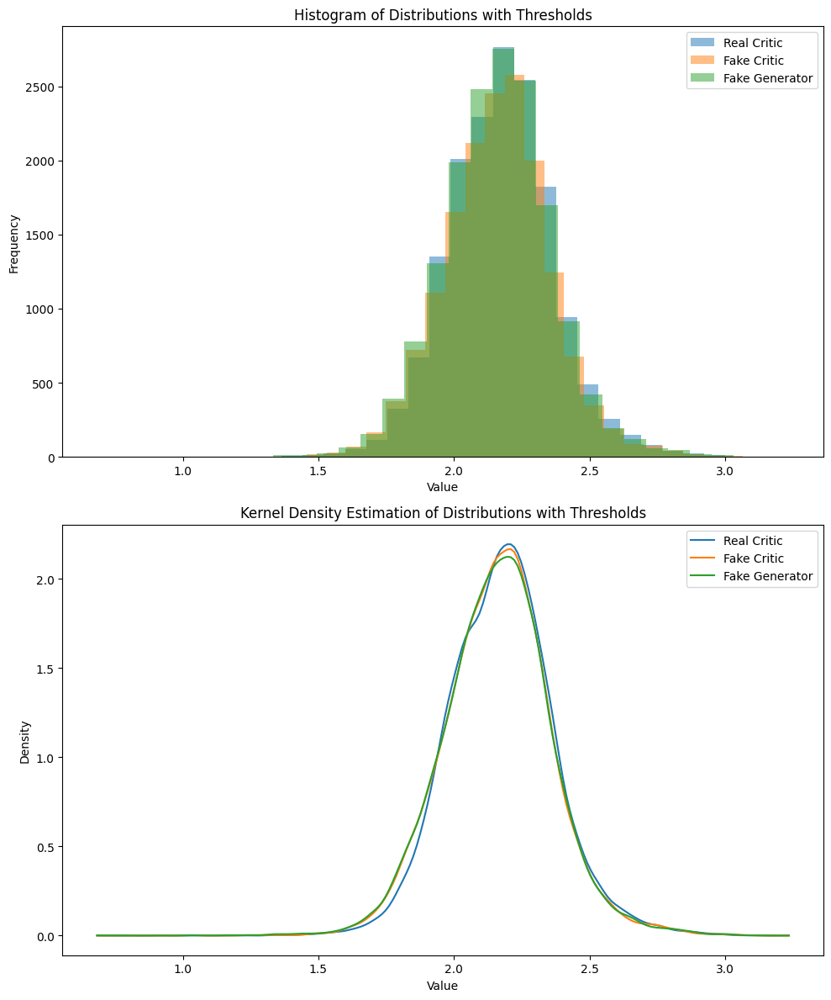

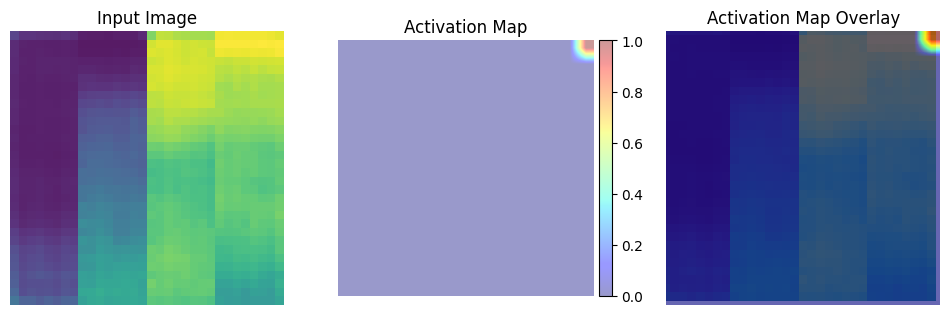

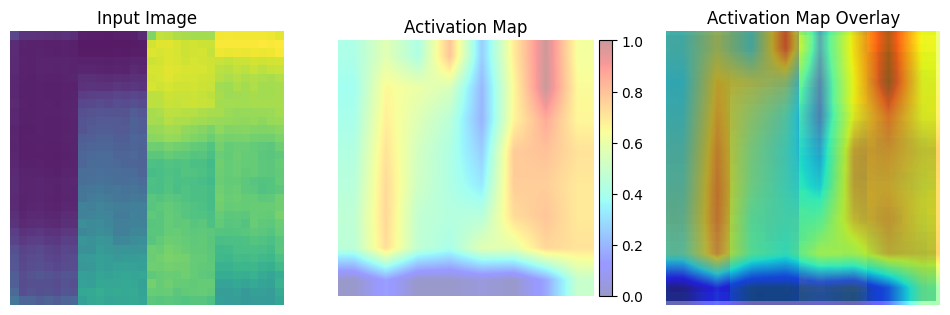

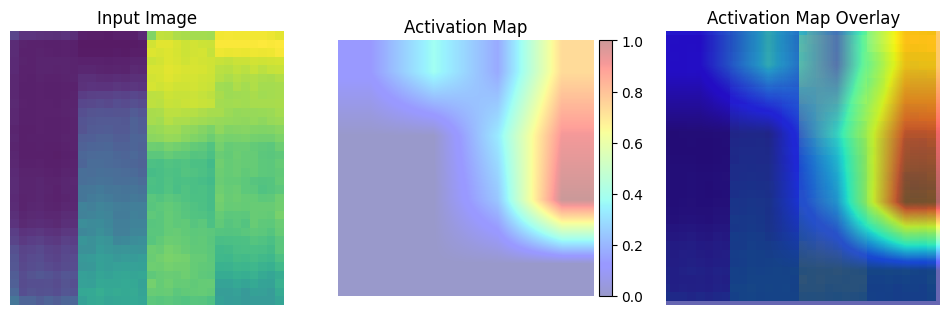

	MNSE Score: 0.03714414147867097
Batch [0/63] -  Critic loss:  0.2791985273361206 - generator loss:  82.80103302001953
Batch [21/63] -  Critic loss:  0.2791314768520269 - generator loss:  88.14097213745117
Batch [42/63] -  Critic loss:  0.23926902048347534 - generator loss:  87.0128683045853
	Epoch 5 - critic loss: 0.24840399670222452 - generator loss: 86.17692590138269


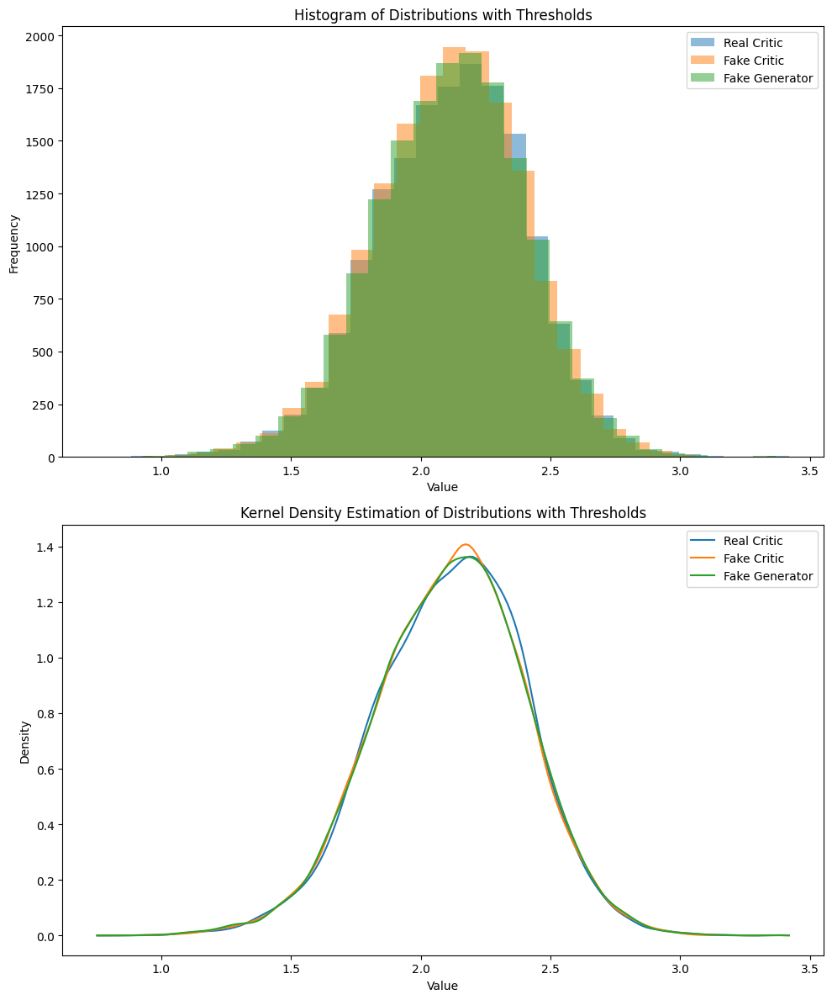

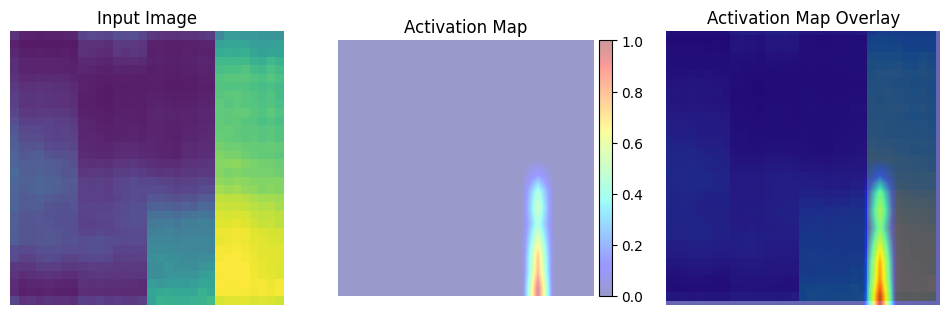

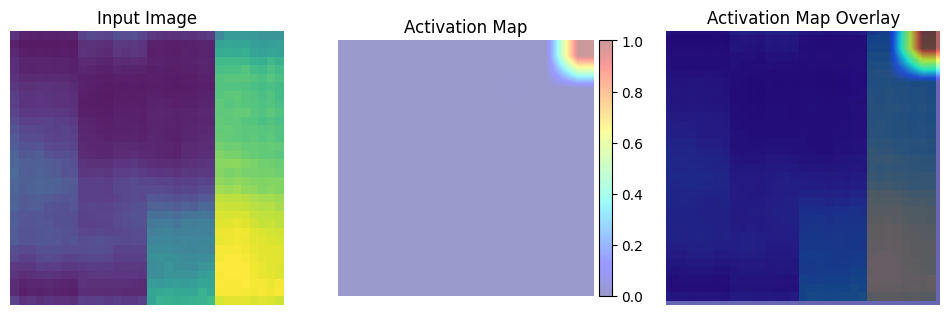

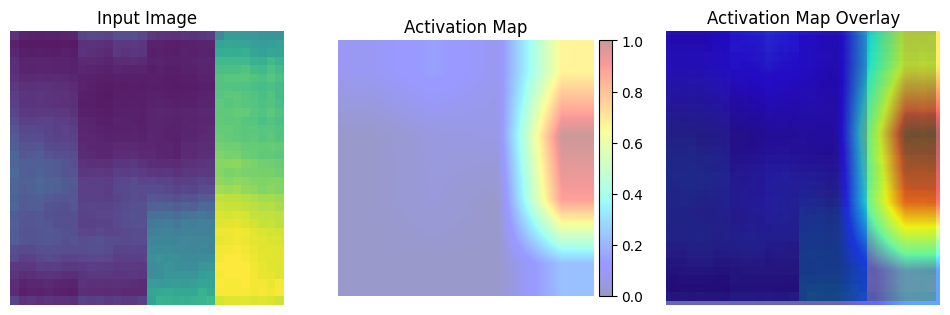

	MNSE Score: 0.032343581939737
Batch [0/63] -  Critic loss:  0.2120324671268463 - generator loss:  90.46903228759766
Batch [21/63] -  Critic loss:  0.24738840499159062 - generator loss:  82.53380758112127
Batch [42/63] -  Critic loss:  0.19513252036747086 - generator loss:  81.14982125925464
	Epoch 6 - critic loss: 0.16690675299319016 - generator loss: 80.50698646666511


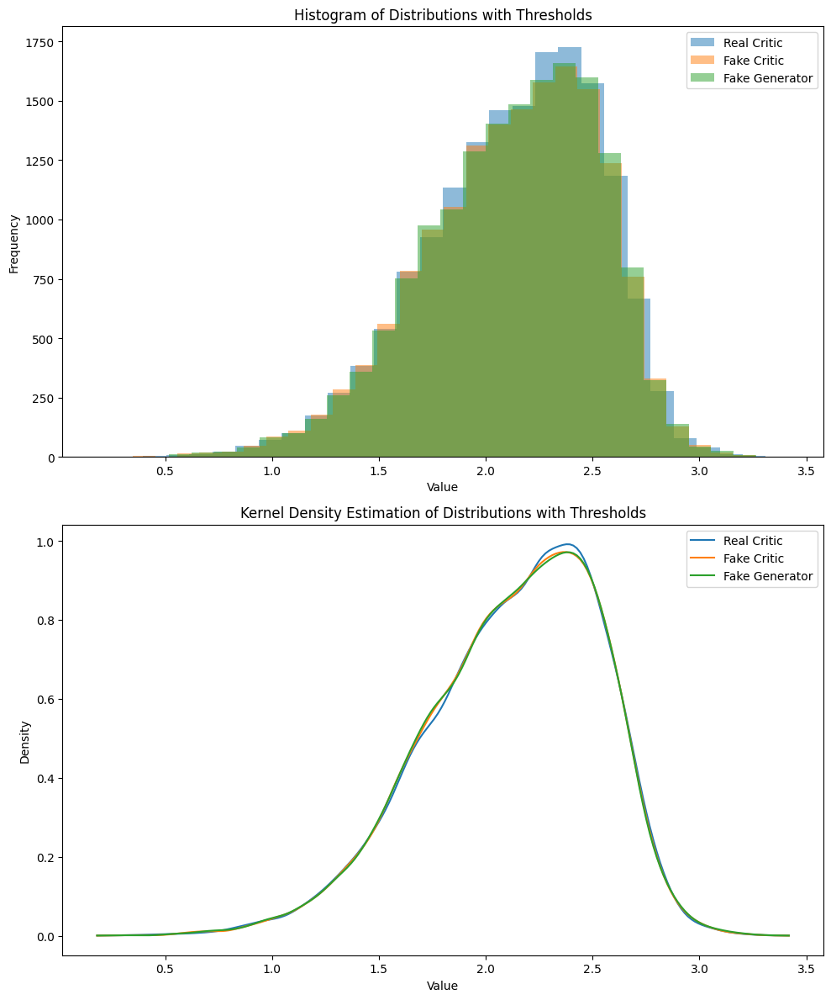

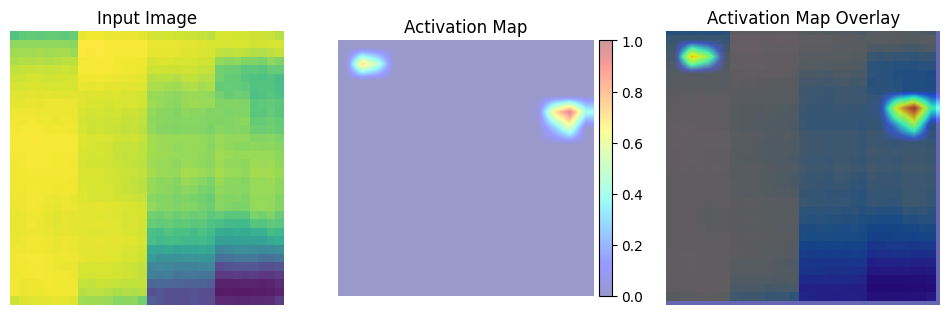

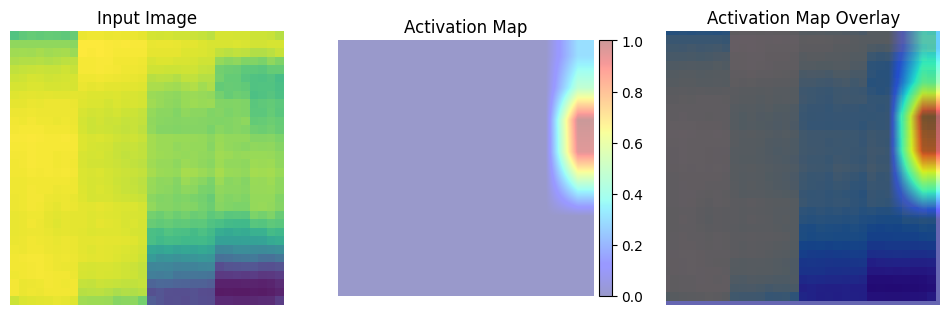

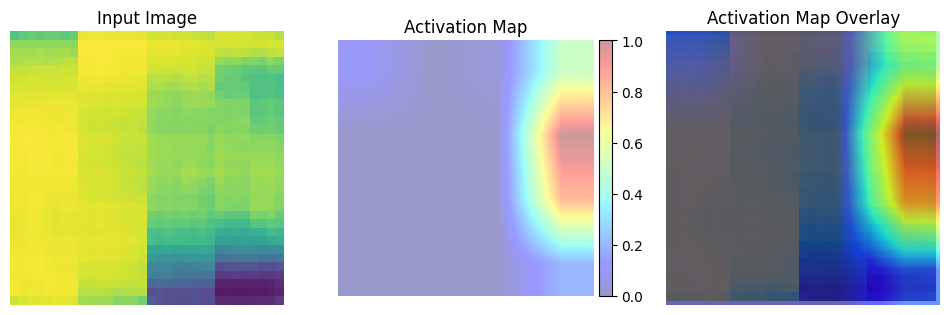

	MNSE Score: 0.028290135017226613
Batch [0/63] -  Critic loss:  0.1061813731988271 - generator loss:  73.53955078125
Batch [21/63] -  Critic loss:  0.05876522816040298 - generator loss:  77.58239988847212
Batch [42/63] -  Critic loss:  0.059482648420010414 - generator loss:  77.06920783464298
	Epoch 7 - critic loss: 0.060449485543859045 - generator loss: 76.2352061195979


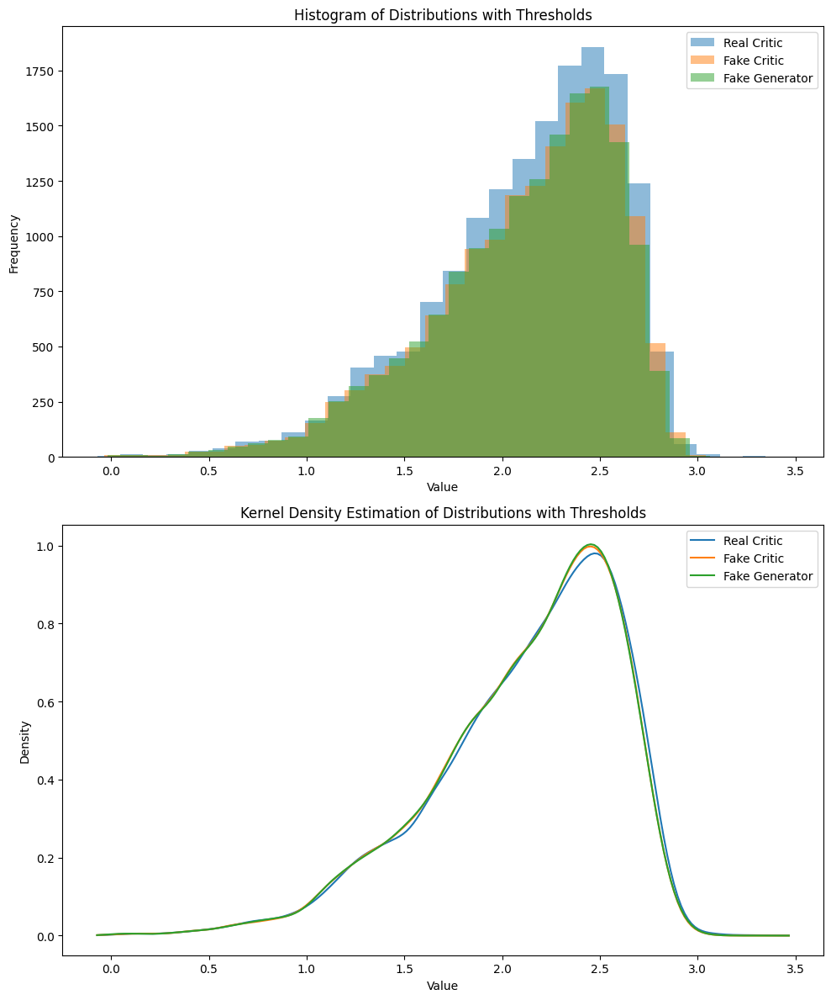

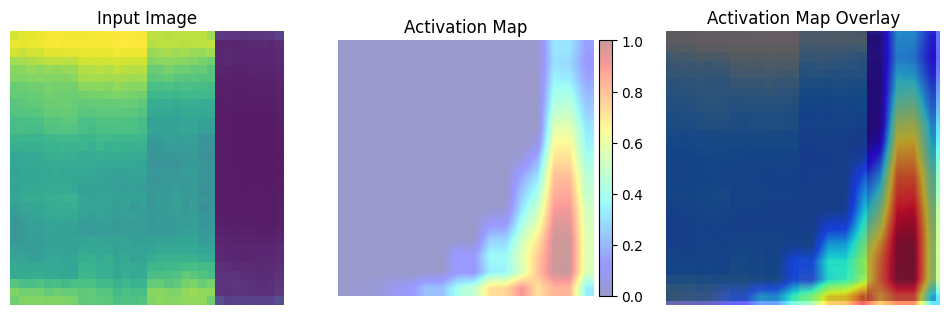

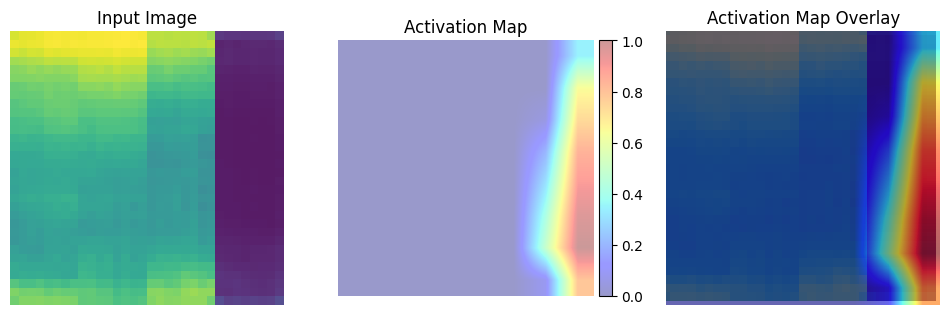

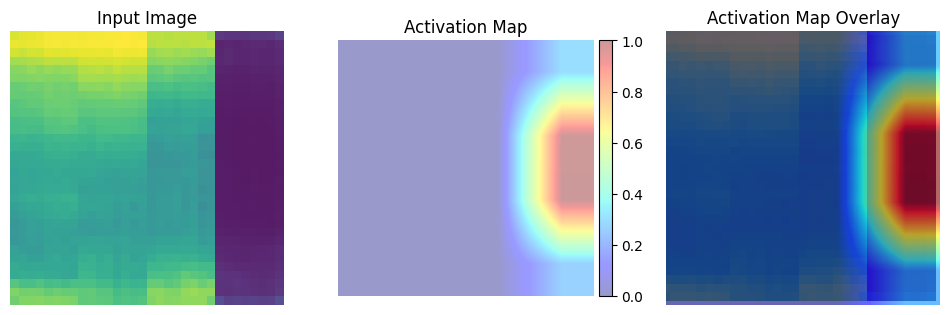

	MNSE Score: 0.025438790549598043
Batch [0/63] -  Critic loss:  0.0304006723066171 - generator loss:  75.9073257446289
Batch [21/63] -  Critic loss:  0.0686607654912002 - generator loss:  74.07660640369762
Batch [42/63] -  Critic loss:  0.05275733295337175 - generator loss:  74.34120639534883
	Epoch 8 - critic loss: 0.06545273358465502 - generator loss: 73.2065793597509


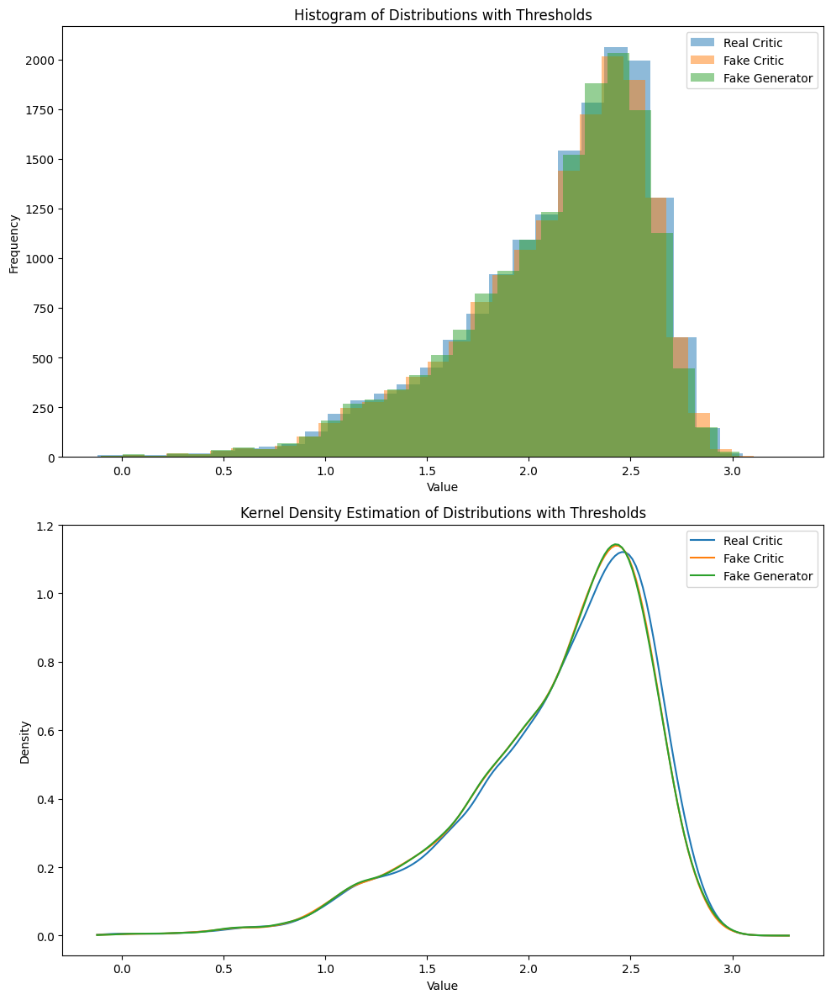

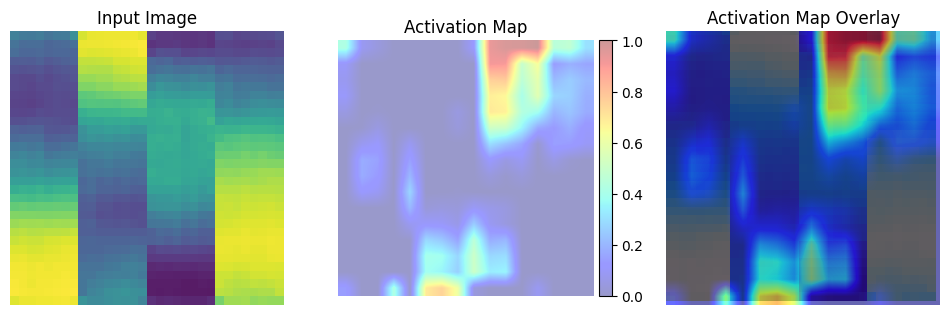

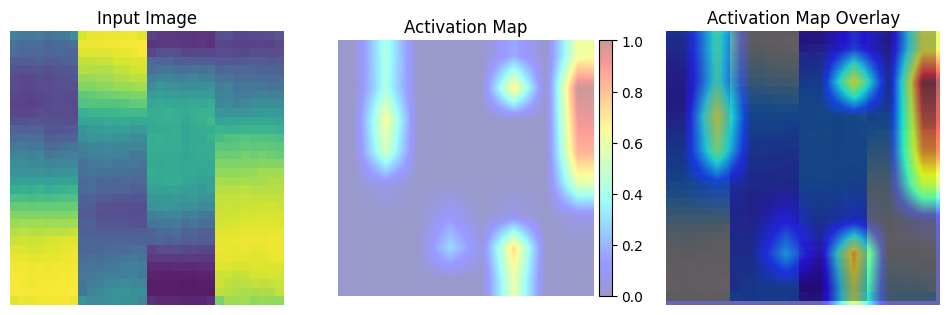

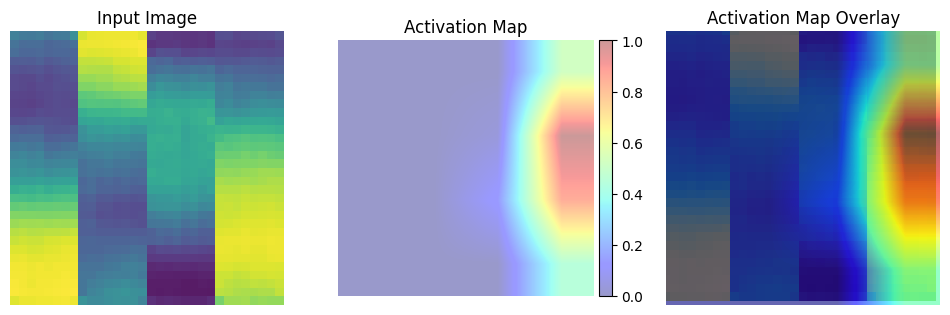

	MNSE Score: 0.02351374596002556
Batch [0/63] -  Critic loss:  0.06680162002642949 - generator loss:  67.39324951171875
Batch [21/63] -  Critic loss:  0.05134307423775846 - generator loss:  68.69964703646573
Batch [42/63] -  Critic loss:  0.041446026327998146 - generator loss:  69.15807307043741
	Epoch 9 - critic loss: 0.03135871851728077 - generator loss: 68.67374153742715


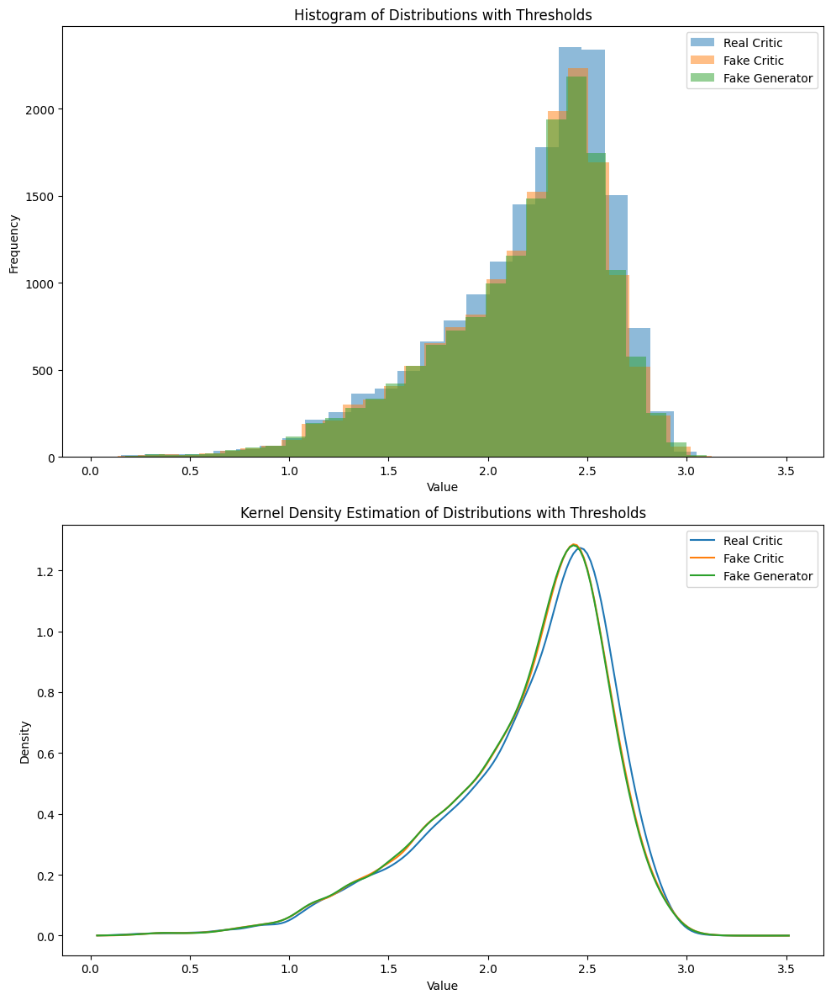

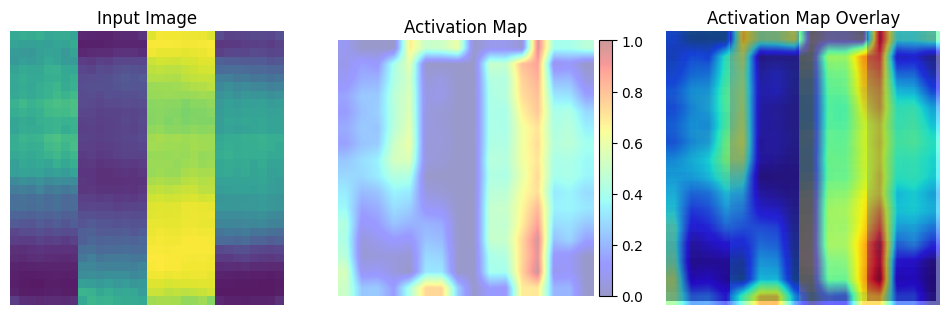

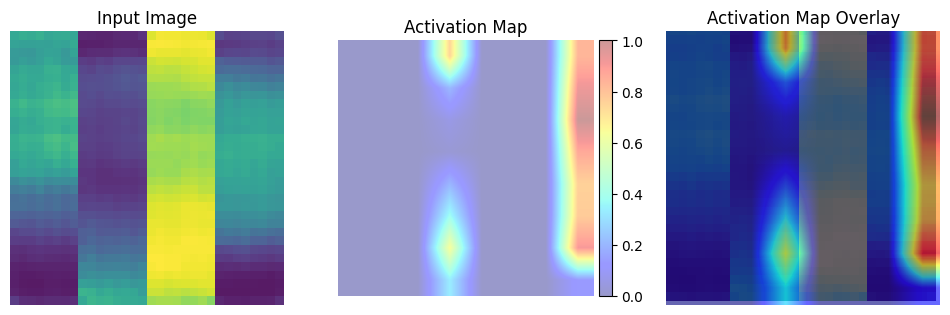

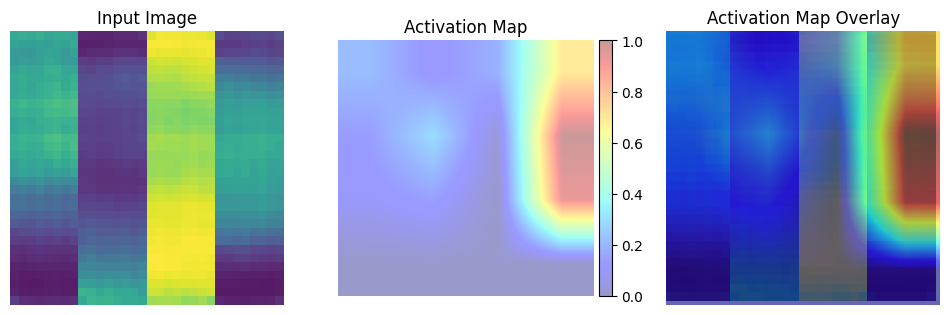

	MNSE Score: 0.020838599415525558
Batch [0/63] -  Critic loss:  0.05947681019703547 - generator loss:  64.33841705322266
Batch [21/63] -  Critic loss:  0.011177901065710816 - generator loss:  67.36335147510876
Batch [42/63] -  Critic loss:  0.0016347220990546888 - generator loss:  66.37095012221225
	Epoch 10 - critic loss: -0.0102960083771635 - generator loss: 66.40598951067243


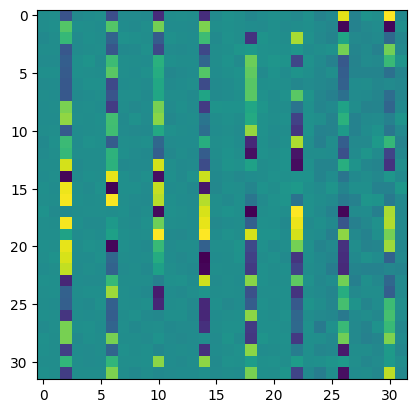

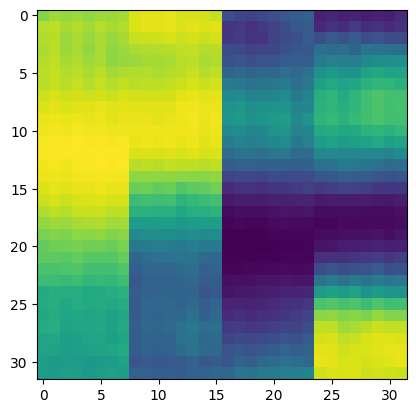

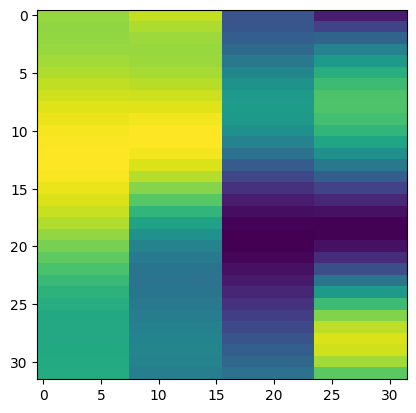

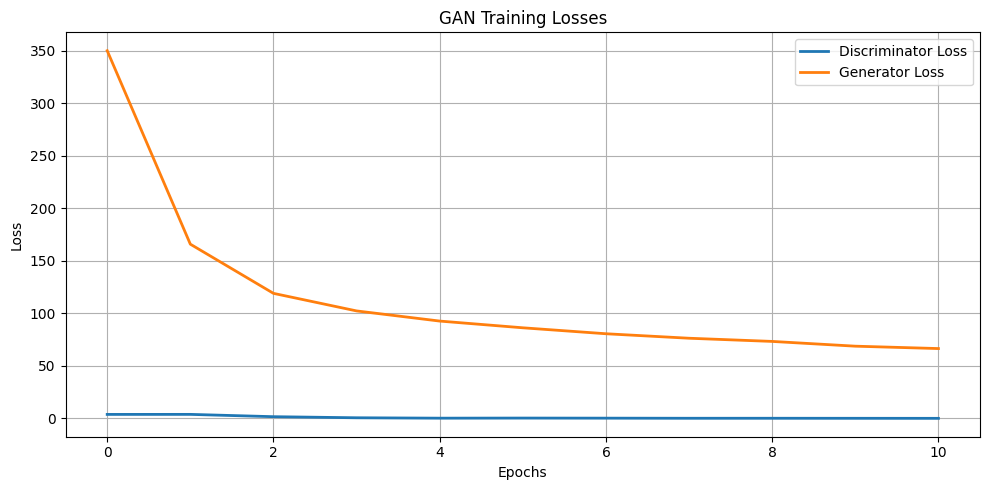

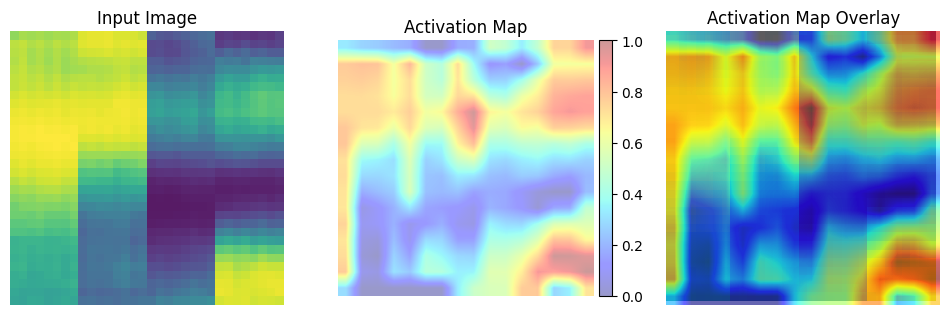

...

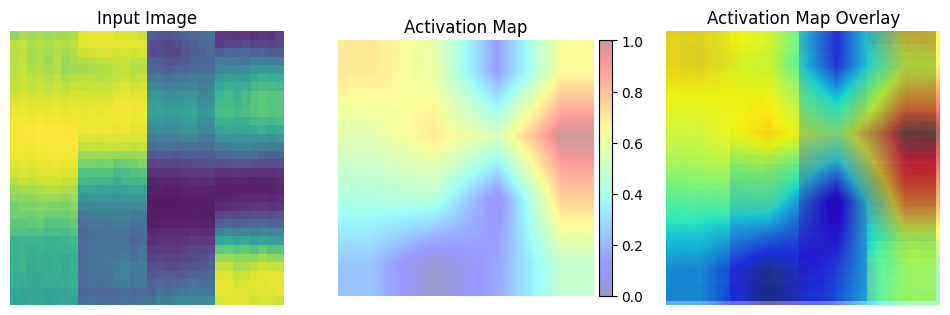

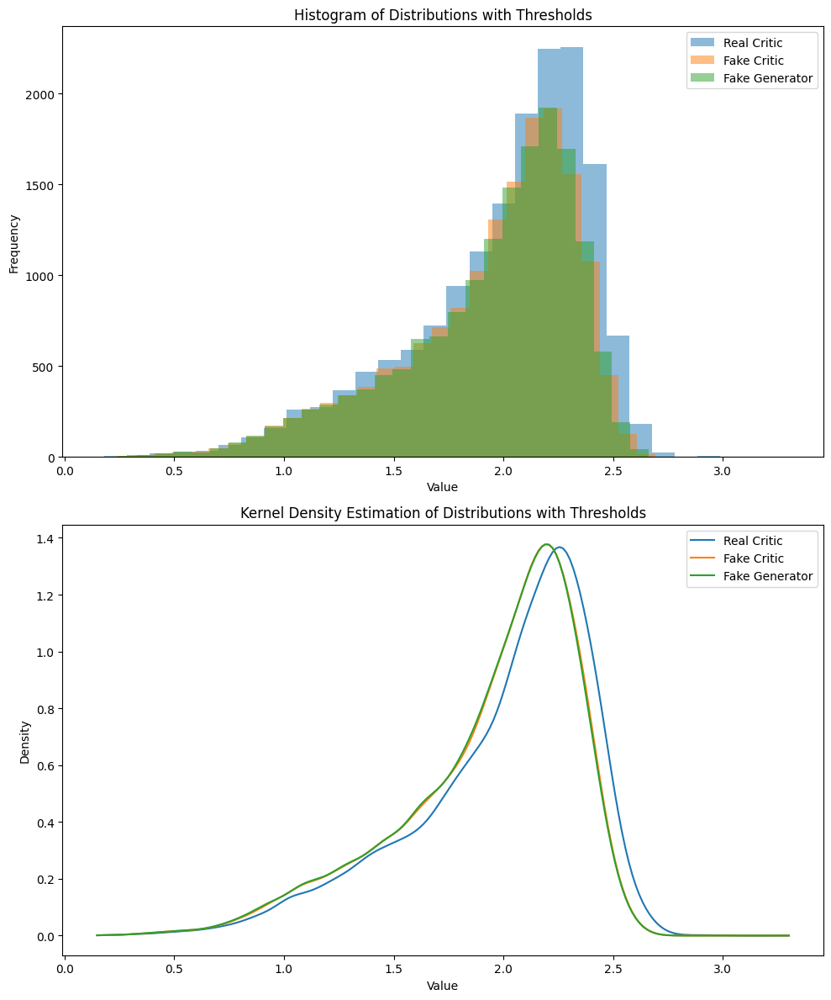

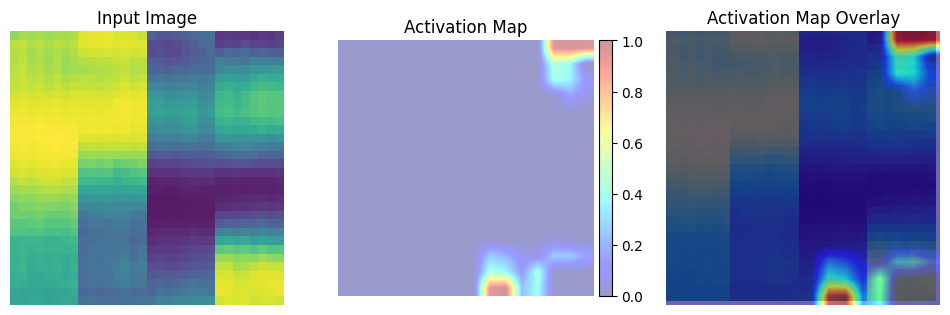

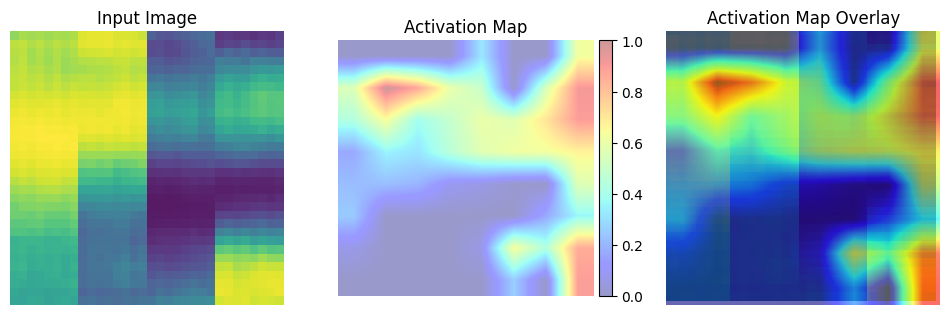

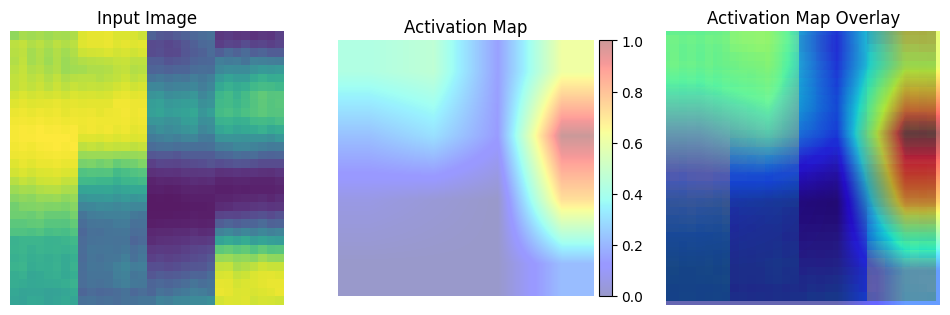

	MNSE Score: 0.019370491172940957
Batch [0/63] -  Critic loss:  -0.020936056971549988 - generator loss:  57.44287109375
Batch [21/63] -  Critic loss:  -0.03534809753976085 - generator loss:  65.1912068453702
Batch [42/63] -  Critic loss:  -0.05491602432358172 - generator loss:  66.07690580501112
	Epoch 11 - critic loss: -0.07333082287872911 - generator loss: 66.09798334515284


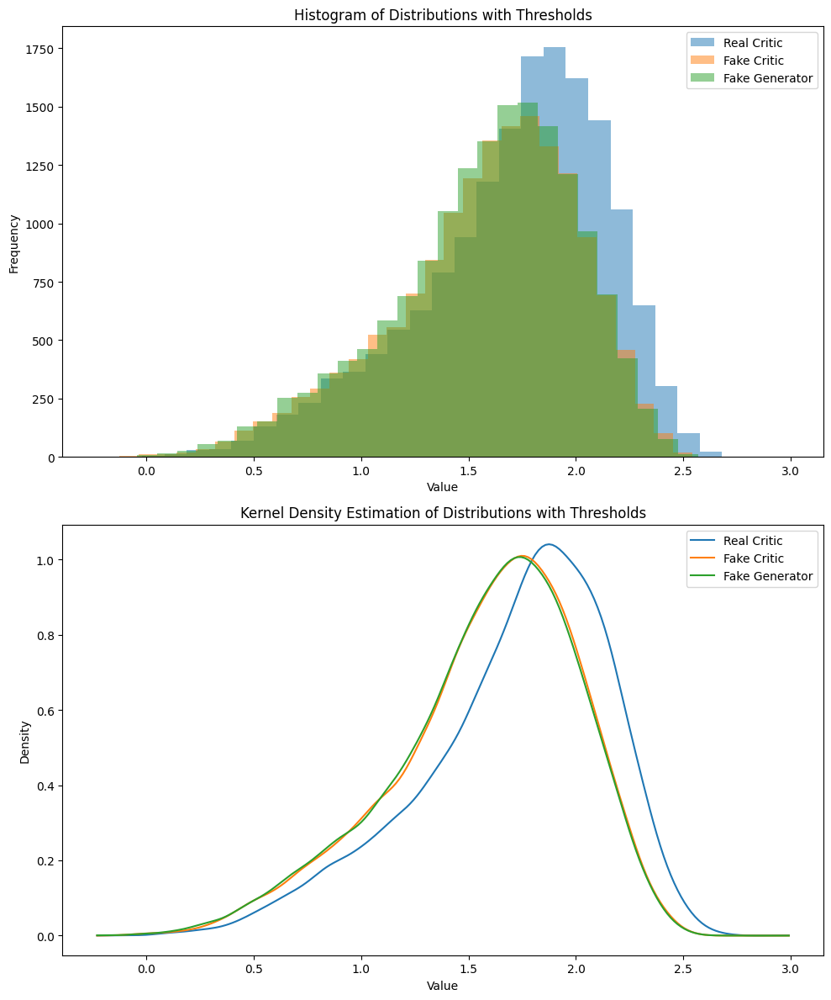

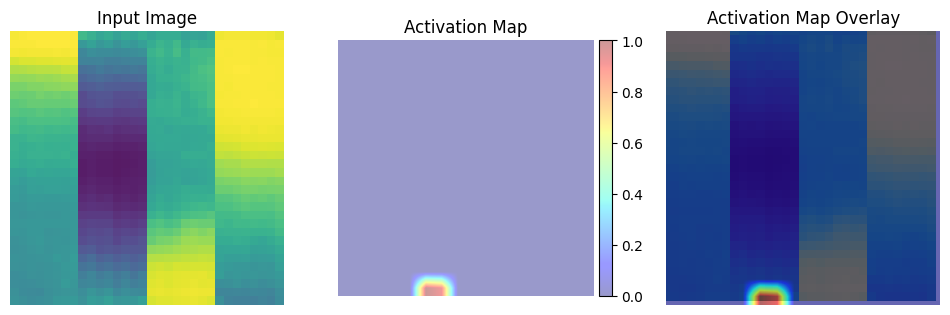

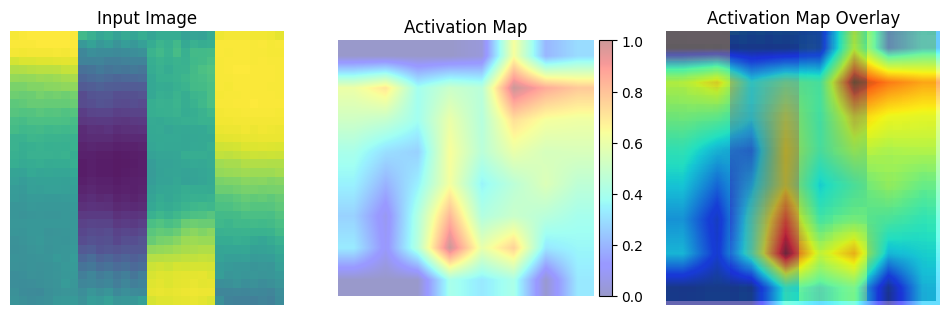

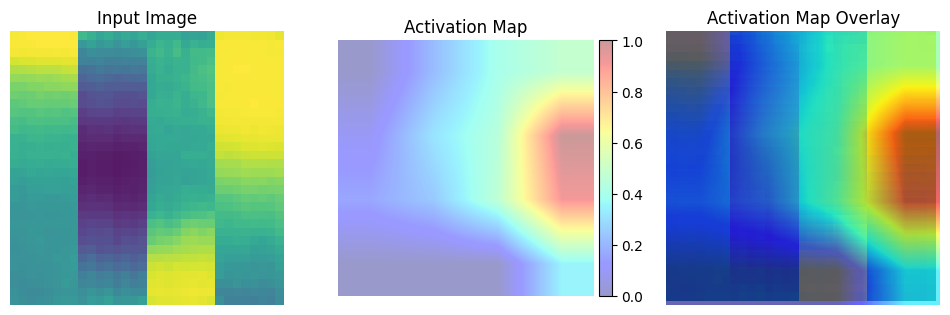

	MNSE Score: 0.019049703040056758
Batch [0/63] -  Critic loss:  -0.1069044644633929 - generator loss:  65.67951202392578
Batch [21/63] -  Critic loss:  -0.14351377094333823 - generator loss:  64.59347430142489
Batch [42/63] -  Critic loss:  -0.15126109111678693 - generator loss:  65.2982001193734
	Epoch 12 - critic loss: -0.16527693576755975 - generator loss: 64.44147158425952


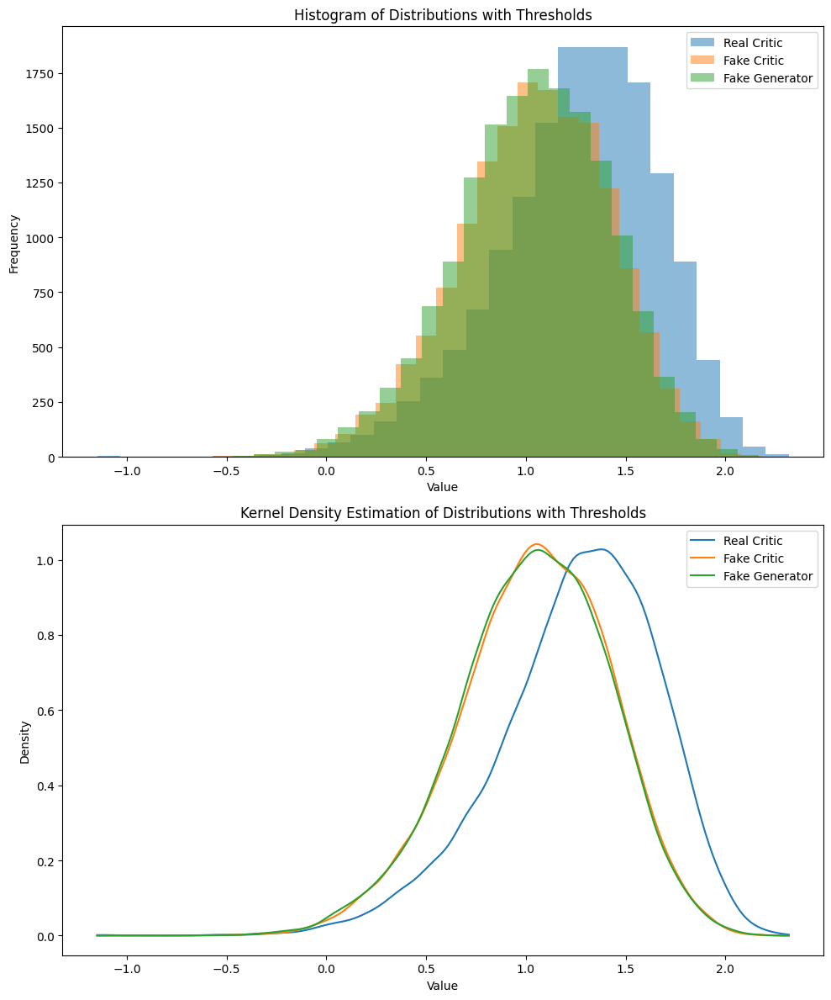

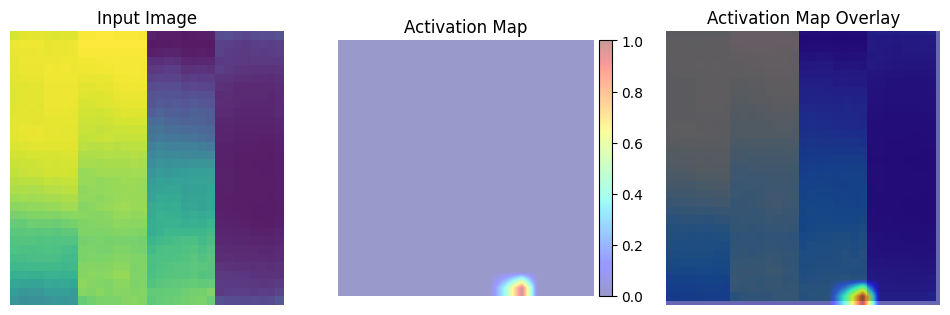

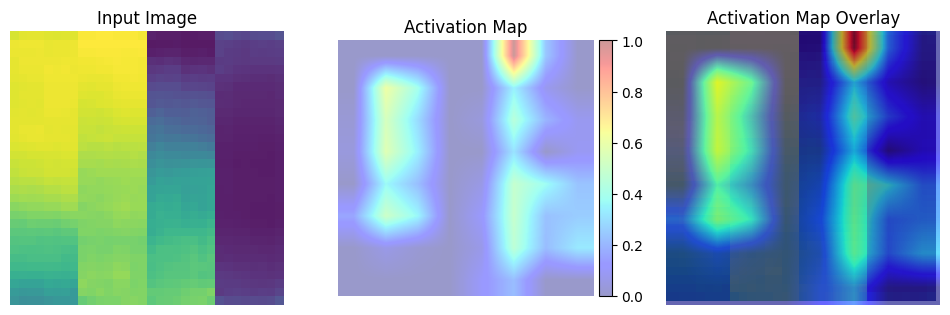

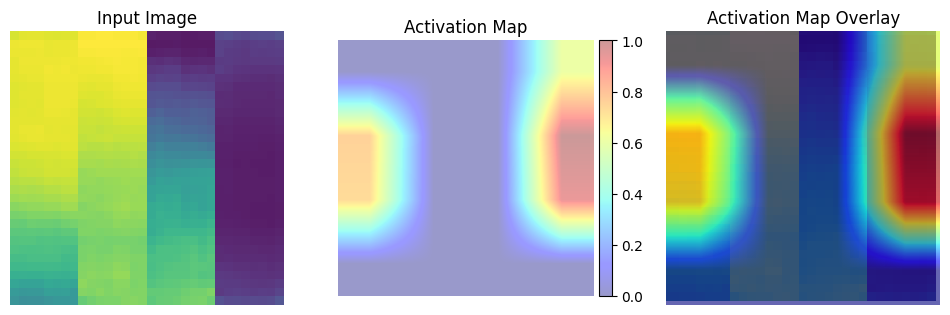

	MNSE Score: 0.017788511833974292
Batch [0/63] -  Critic loss:  -0.13625610371430716 - generator loss:  59.57244873046875
Batch [21/63] -  Critic loss:  -0.21940492319338253 - generator loss:  62.29438920454545
Batch [42/63] -  Critic loss:  -0.24085981335288797 - generator loss:  62.45391419876454
	Epoch 13 - critic loss: -0.25898895921215176 - generator loss: 61.85700201609778


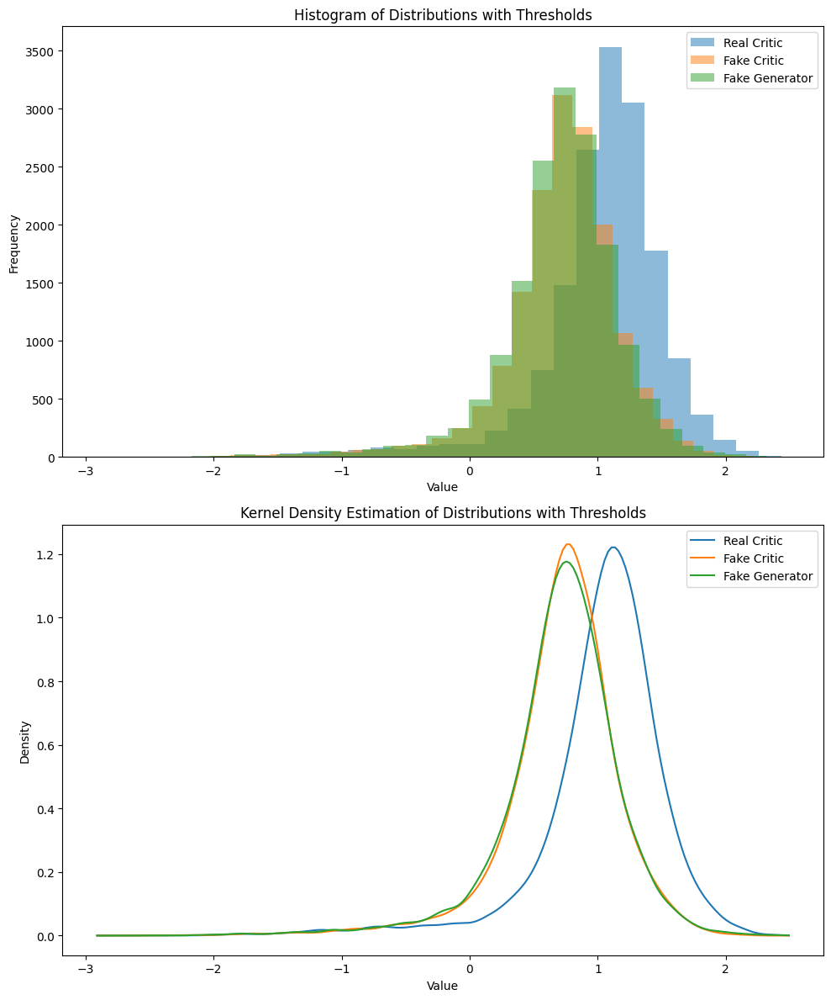

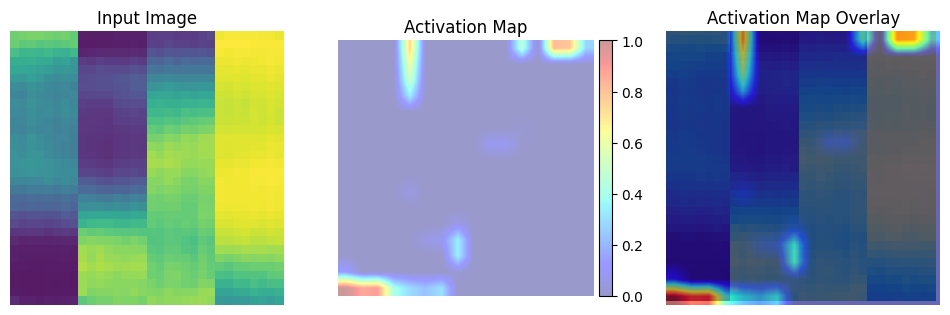

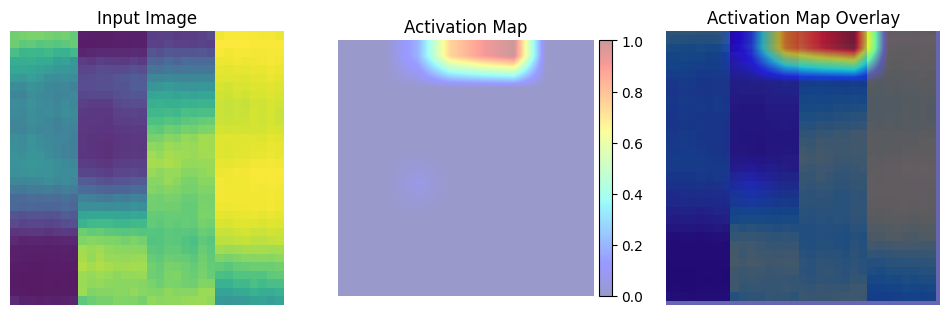

<ipython-input-27-b68e3bf66b4b>:63: RuntimeWarning: invalid value encountered in divide
  activation_map = (activation_map - activation_map.min()) / (


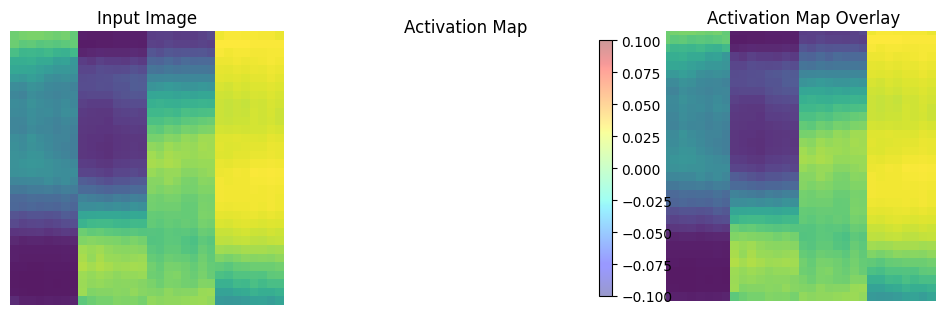

	MNSE Score: 0.016238932497799397
Batch [0/63] -  Critic loss:  -0.2764102766911189 - generator loss:  58.70604705810547
Batch [21/63] -  Critic loss:  -0.3438608436421915 - generator loss:  61.23567754572088
Batch [42/63] -  Critic loss:  -0.3521281581285388 - generator loss:  60.965124884317085
	Epoch 14 - critic loss: -0.3662618980521247 - generator loss: 60.7999509781126


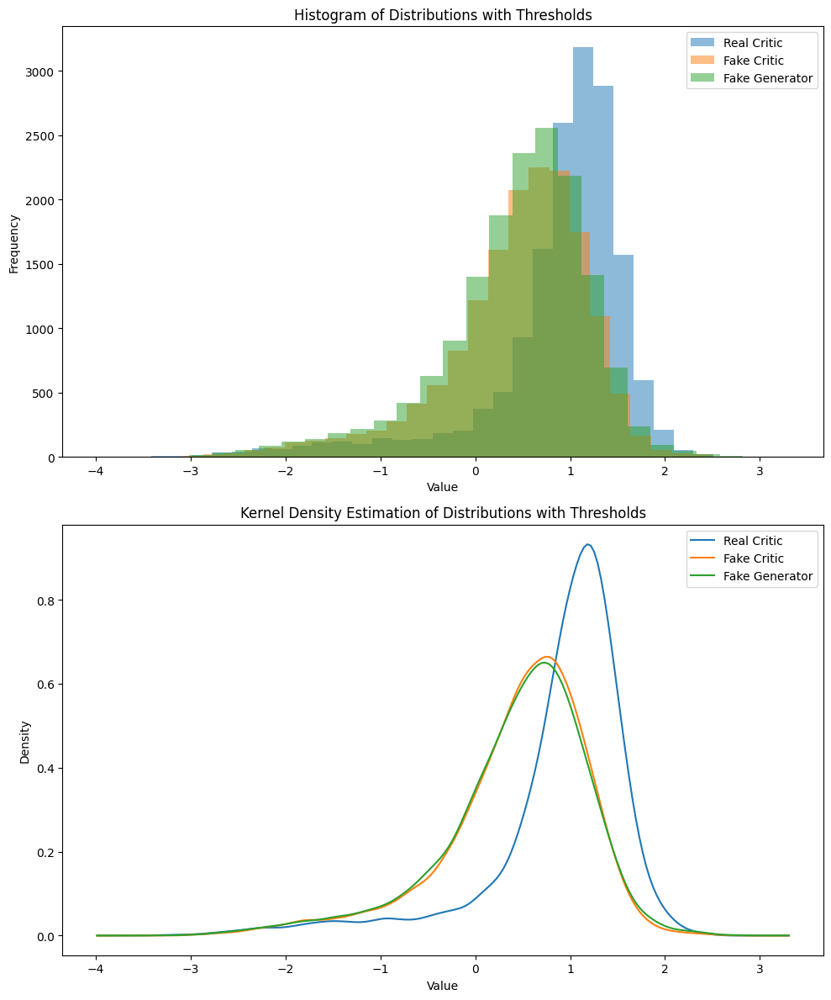

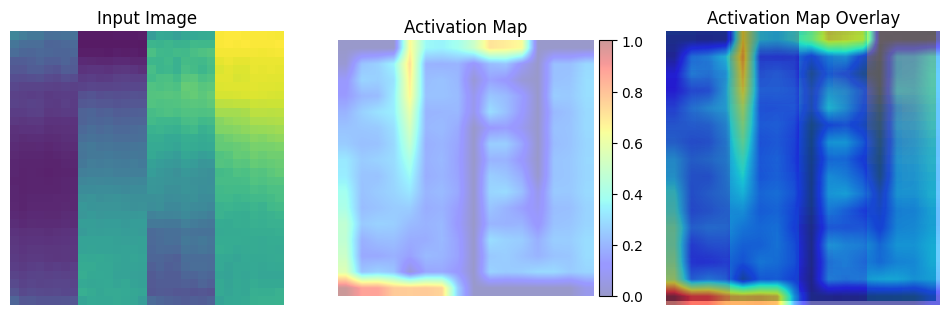

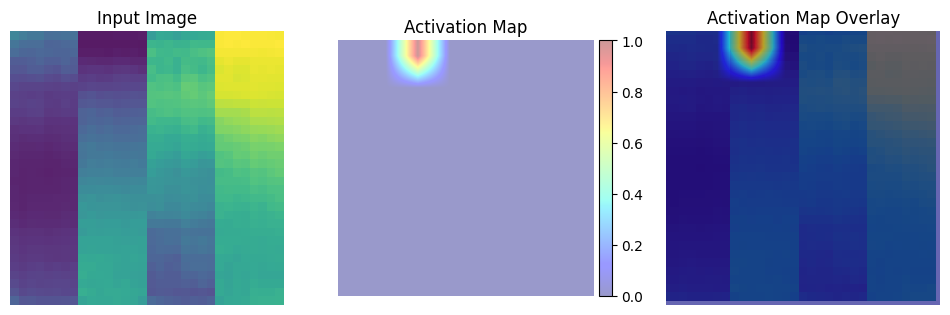

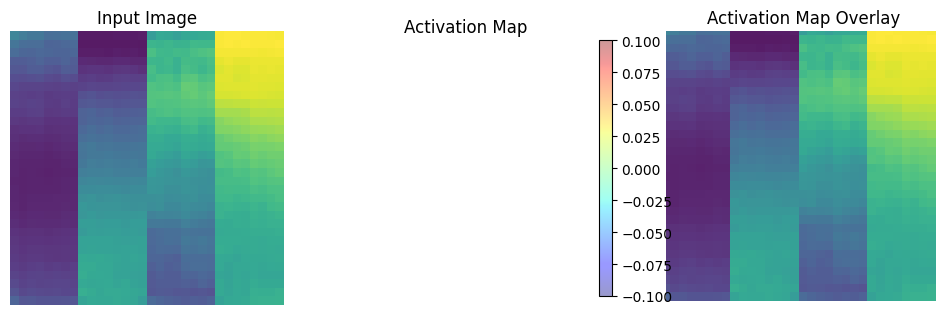

	MNSE Score: 0.015556007638455384
Batch [0/63] -  Critic loss:  -0.4404585063457489 - generator loss:  54.13019943237305
Batch [21/63] -  Critic loss:  -0.49685998983455426 - generator loss:  60.72211300243031
Batch [42/63] -  Critic loss:  -0.5238940544830736 - generator loss:  61.05440272841343
	Epoch 15 - critic loss: -0.5426918009601573 - generator loss: 60.997171371702166


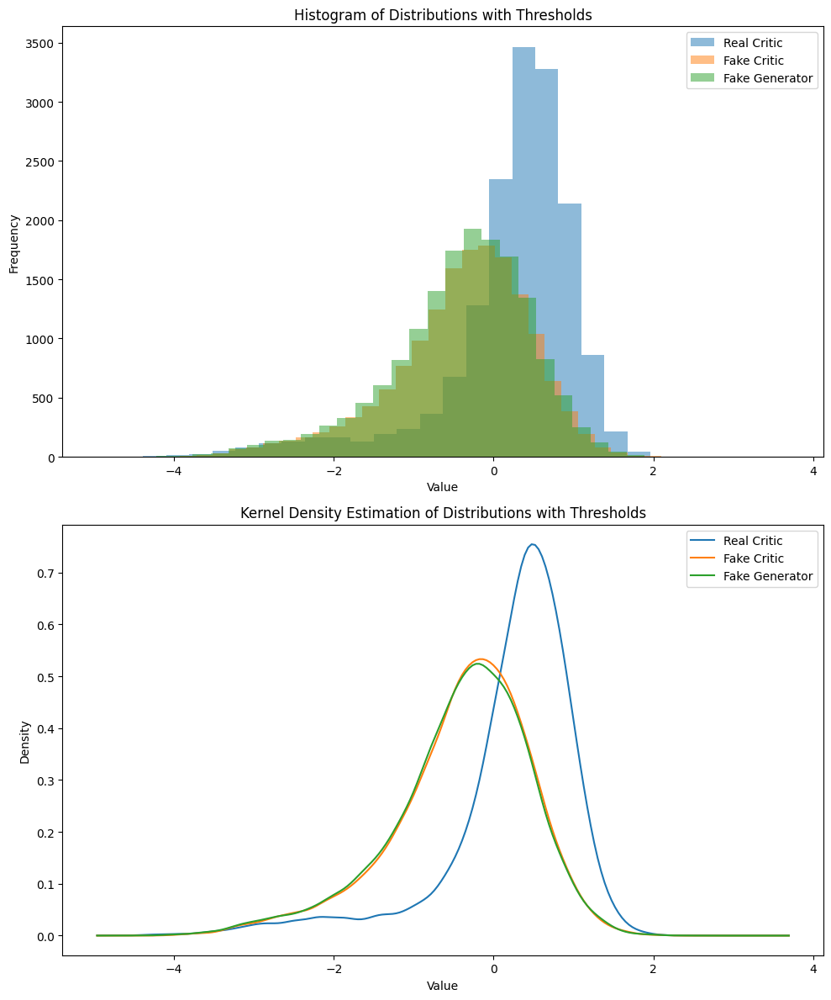

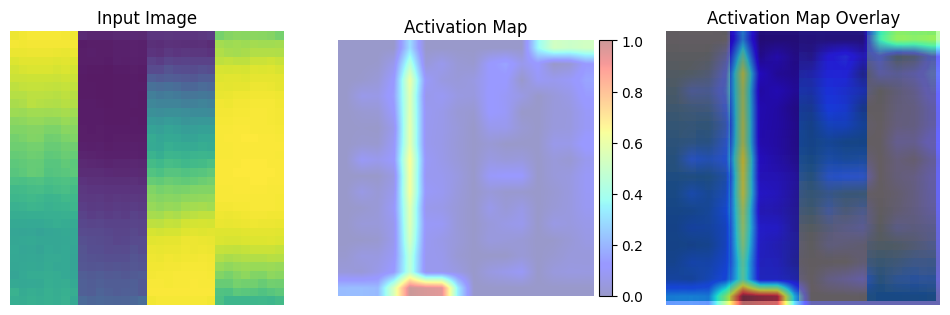

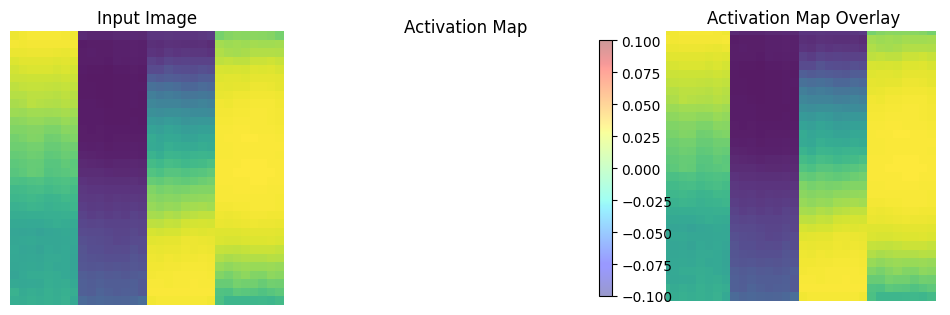

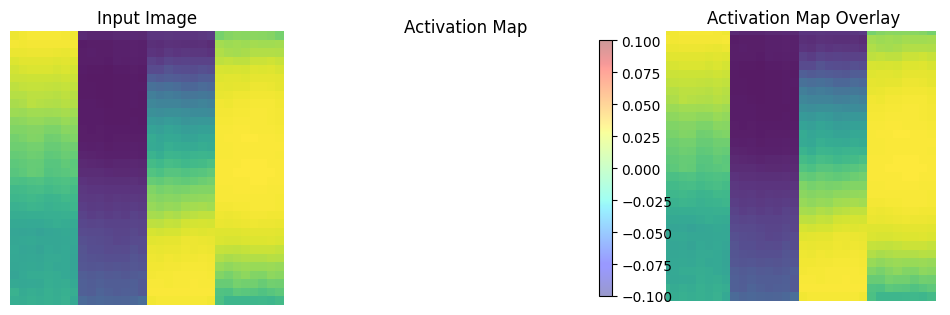

	MNSE Score: 0.01523197539860294
Batch [0/63] -  Critic loss:  -0.6479891737302145 - generator loss:  59.28229904174805
Batch [21/63] -  Critic loss:  -0.6198306526198532 - generator loss:  59.7603816986084
Batch [42/63] -  Critic loss:  -0.6370382424472839 - generator loss:  60.29492648812227
	Epoch 16 - critic loss: -0.652976554222208 - generator loss: 60.044720785958425


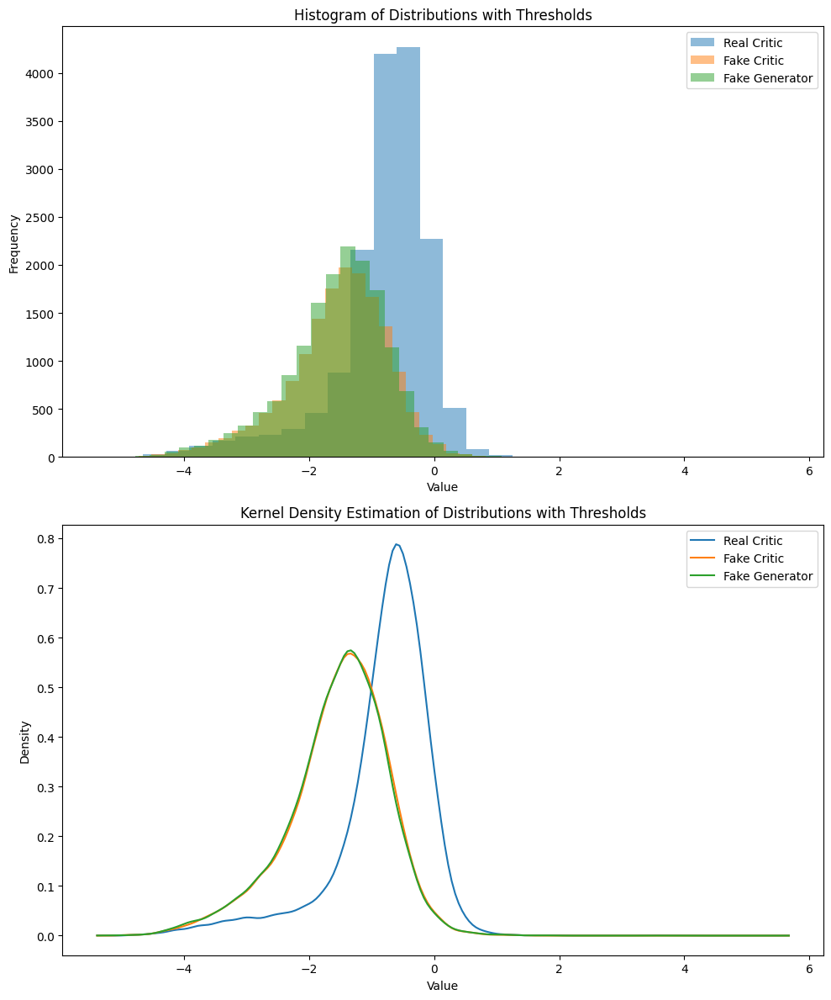

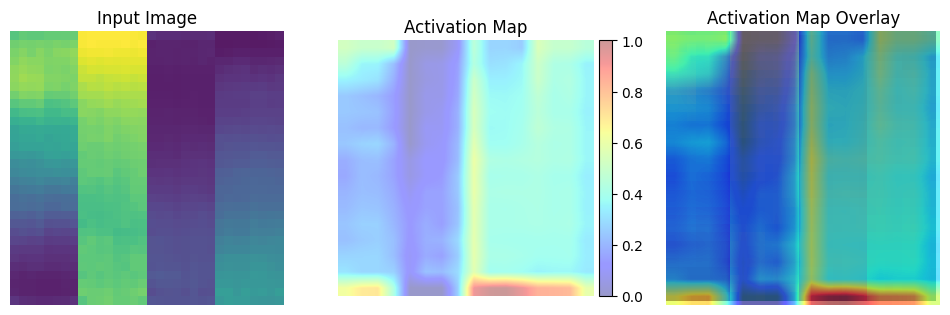

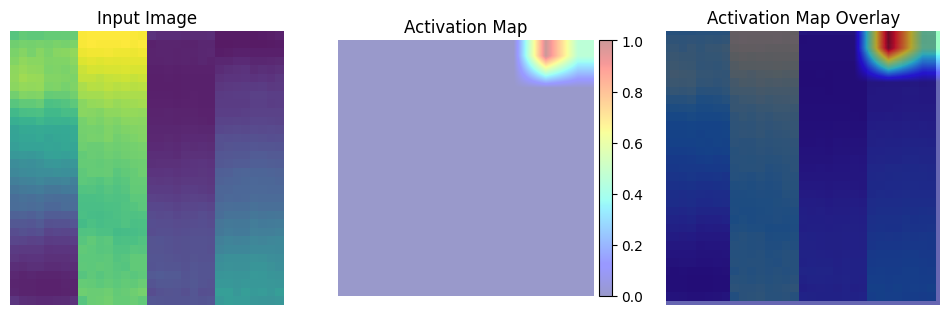

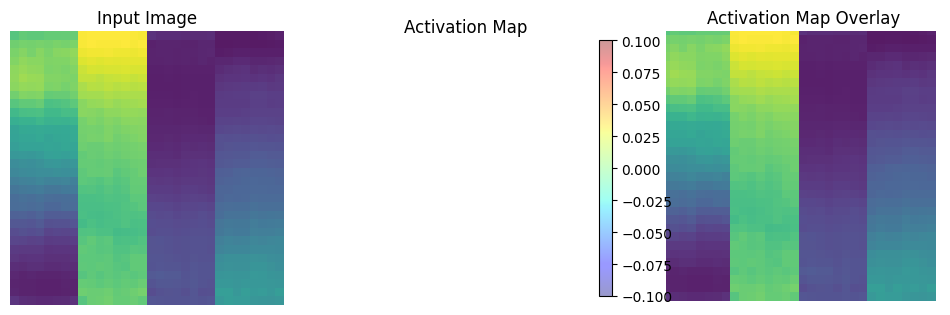

	MNSE Score: 0.014182953947475032
Batch [0/63] -  Critic loss:  -0.6723103523254395 - generator loss:  54.96828079223633
Batch [21/63] -  Critic loss:  -0.7134995027021929 - generator loss:  61.032419724897906
Batch [42/63] -  Critic loss:  -0.7181096483570663 - generator loss:  60.33748857365098
	Epoch 17 - critic loss: -0.7207131239156874 - generator loss: 60.51875831967308


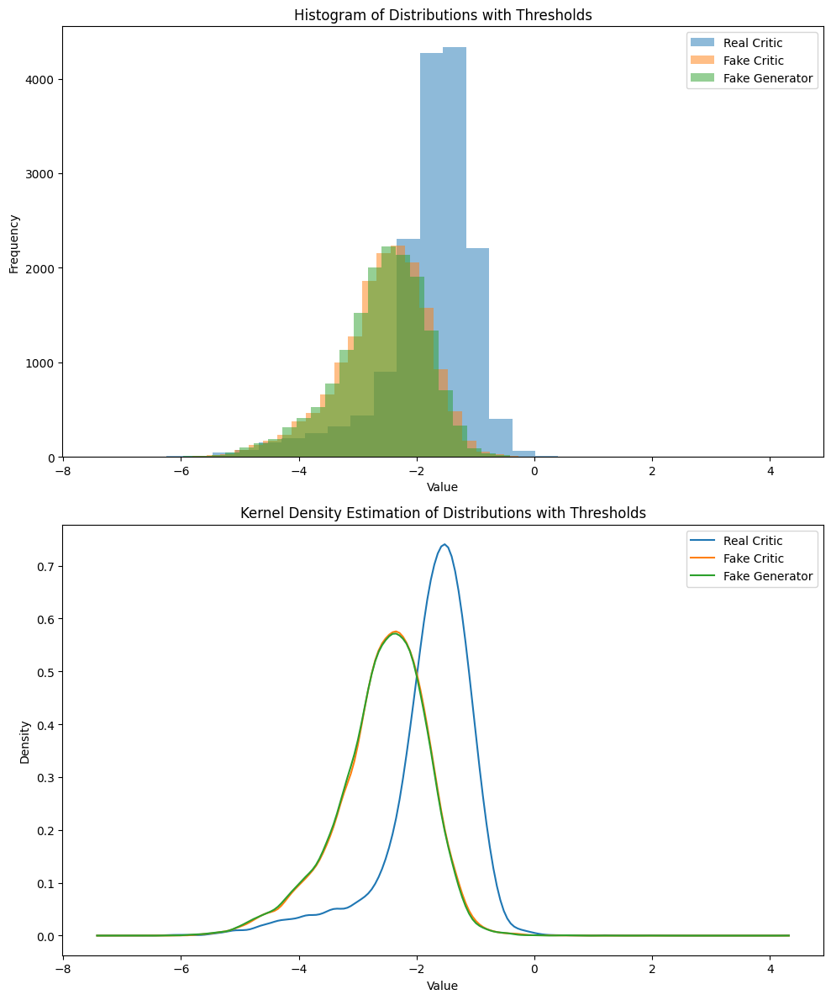

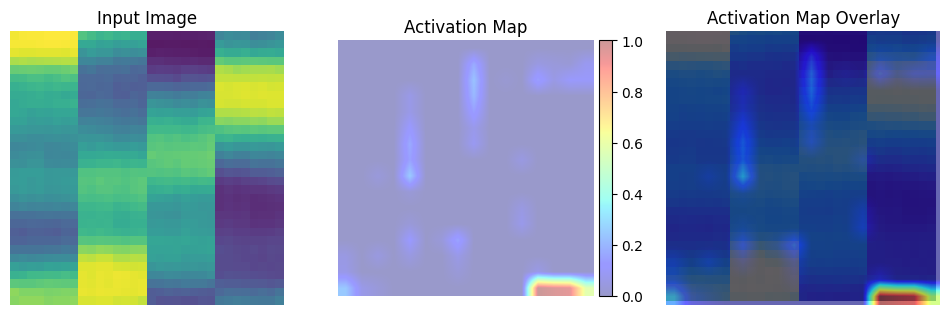

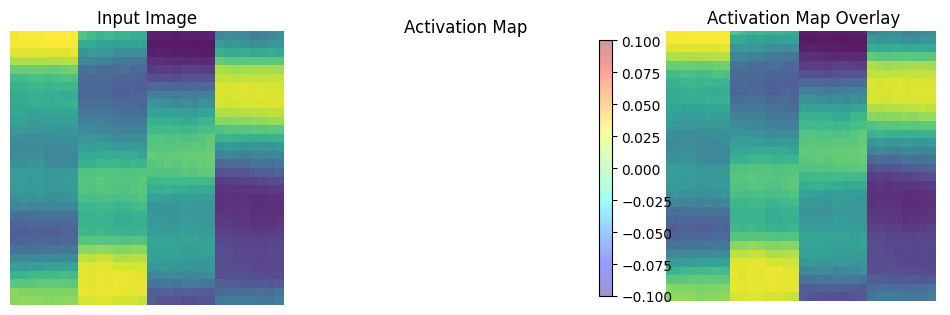

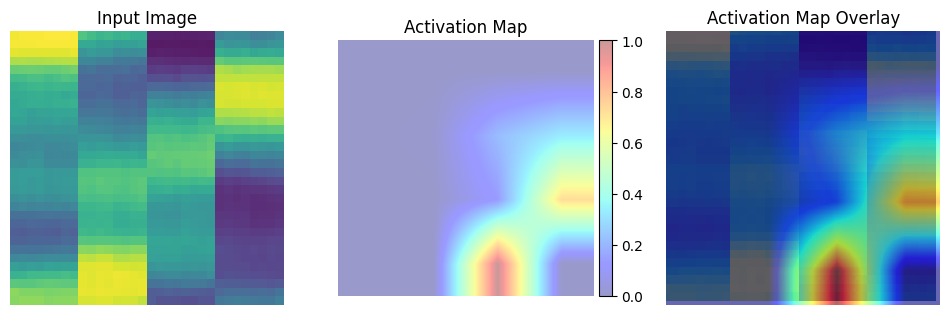

	MNSE Score: 0.013942424311406083
Batch [0/63] -  Critic loss:  -0.8427975177764893 - generator loss:  64.93941497802734
Batch [21/63] -  Critic loss:  -0.7358656606890939 - generator loss:  60.28485176780007
Batch [42/63] -  Critic loss:  -0.7537421436272851 - generator loss:  60.29966194685115
	Epoch 18 - critic loss: -0.7614516142814879 - generator loss: 60.11061810690259


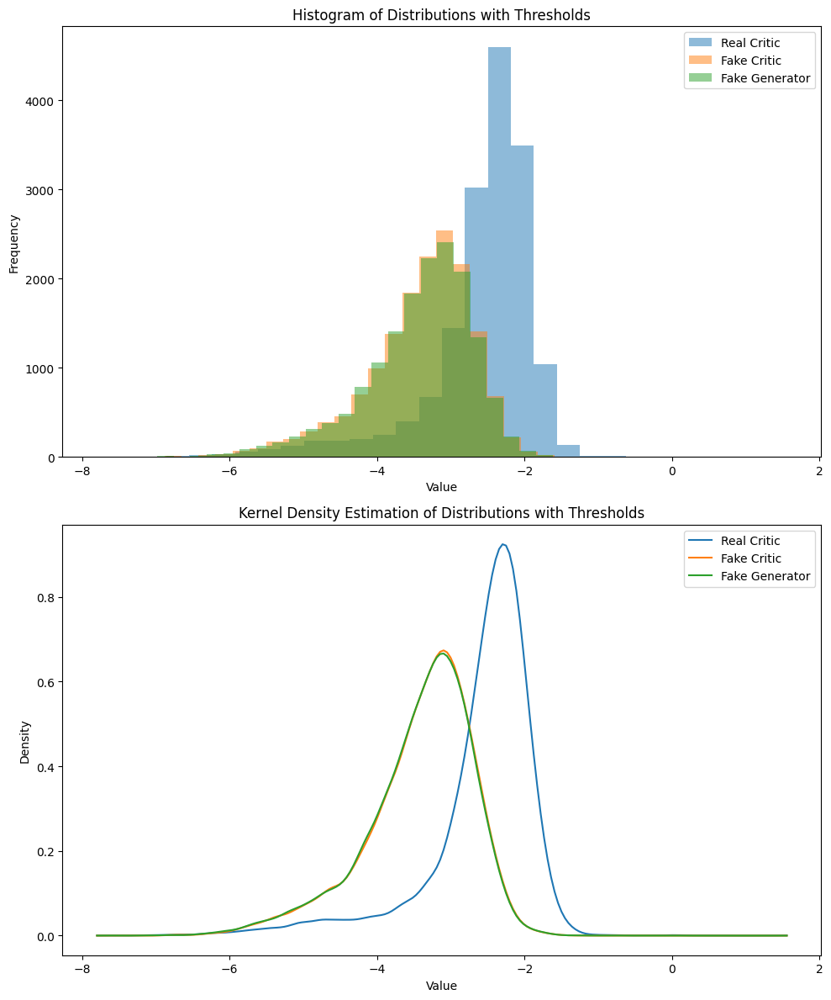

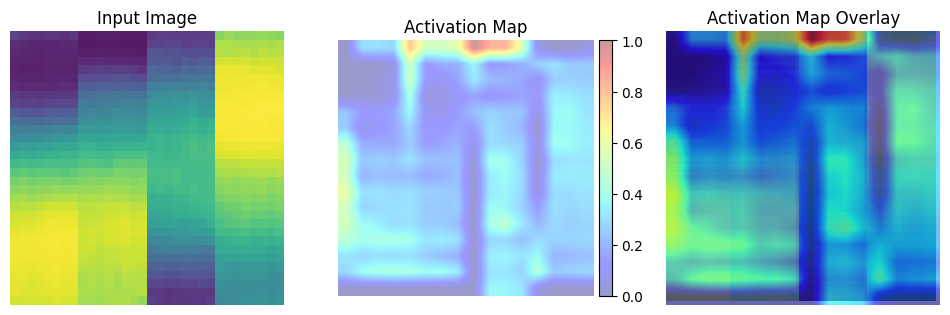

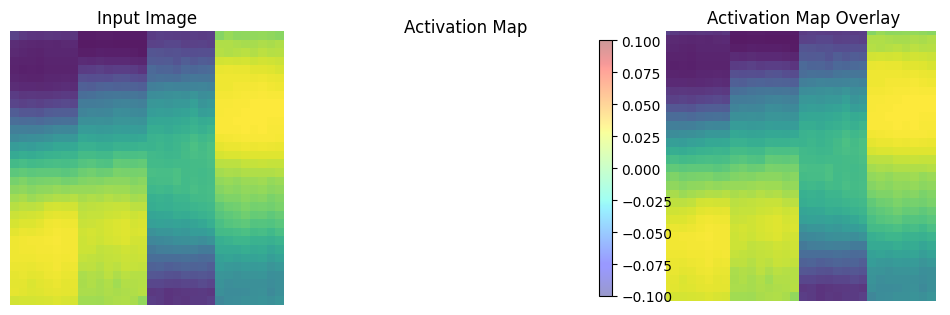

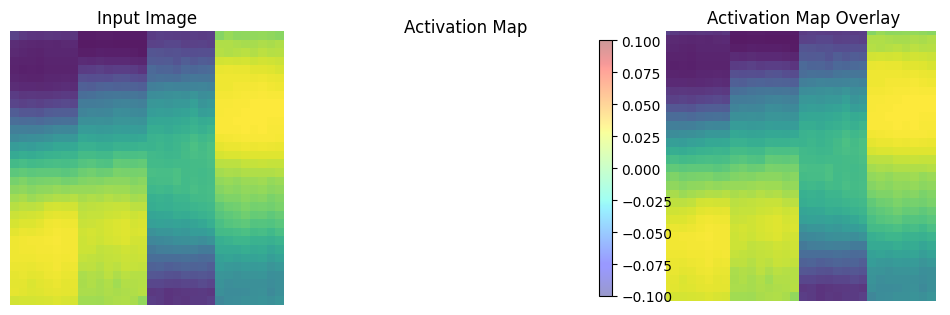

	MNSE Score: 0.01333424308529449
Batch [0/63] -  Critic loss:  -0.8187680244445801 - generator loss:  59.95065689086914
Batch [21/63] -  Critic loss:  -0.7820469971859094 - generator loss:  58.97331393848766
Batch [42/63] -  Critic loss:  -0.7823723457580387 - generator loss:  59.365039381870005
	Epoch 19 - critic loss: -0.7844325975766254 - generator loss: 59.65567597888765


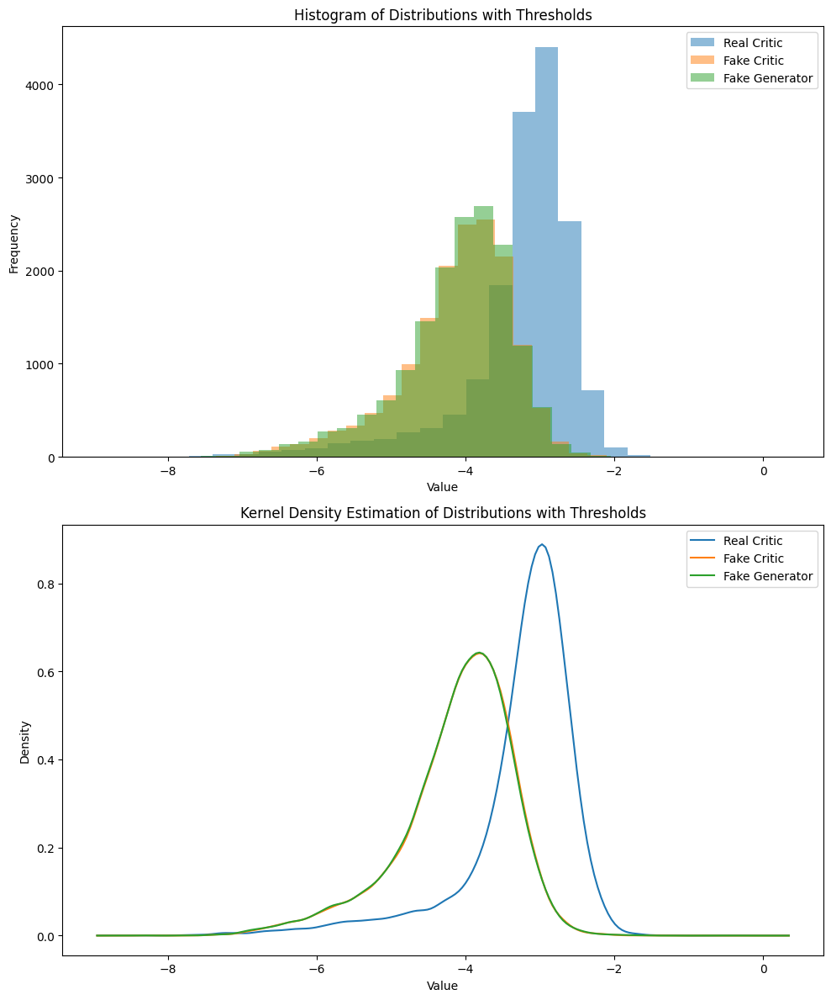

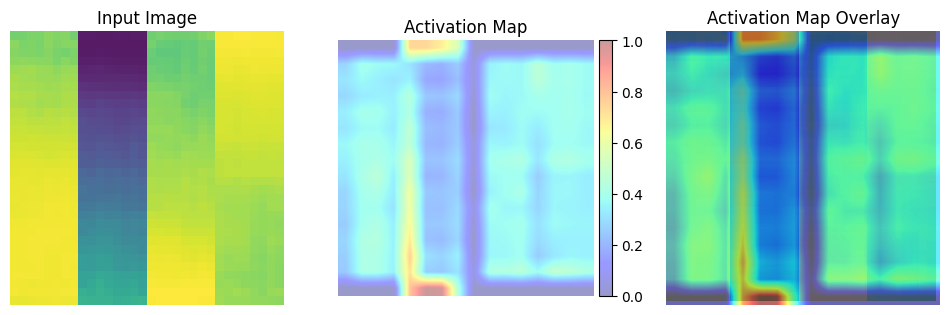

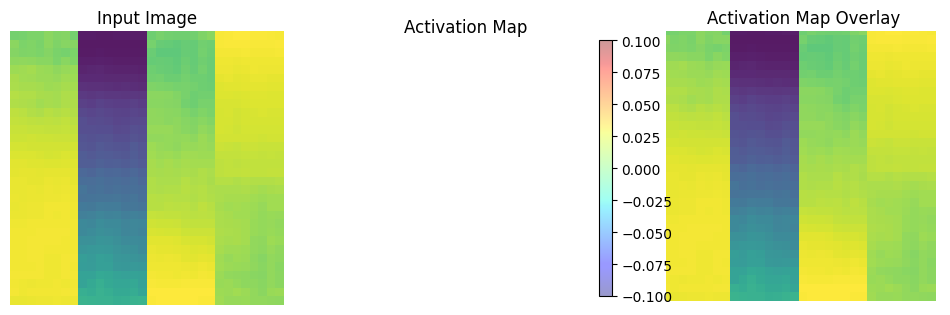

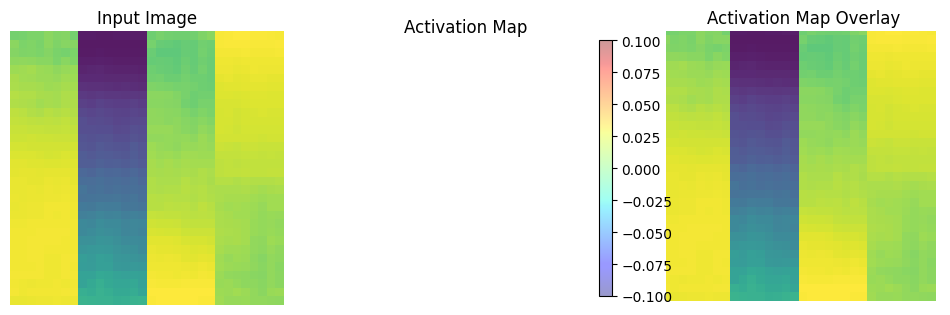

	MNSE Score: 0.01280990791403585
Batch [0/63] -  Critic loss:  -0.7607911626497904 - generator loss:  56.51949691772461
Batch [21/63] -  Critic loss:  -0.7844967282179628 - generator loss:  58.625431060791016
Batch [42/63] -  Critic loss:  -0.787349713403125 - generator loss:  59.003699103067085
	Epoch 20 - critic loss: -0.7931595920885679 - generator loss: 59.2646362667992


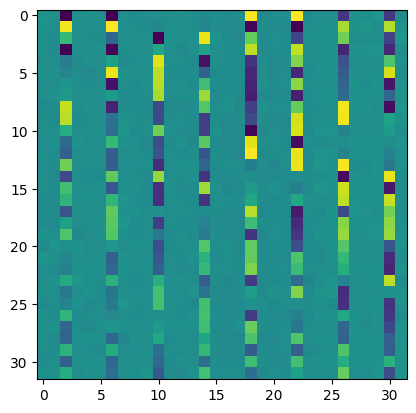

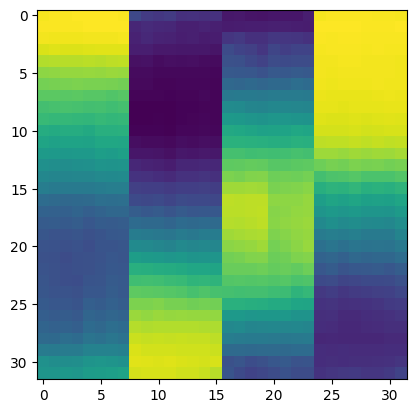

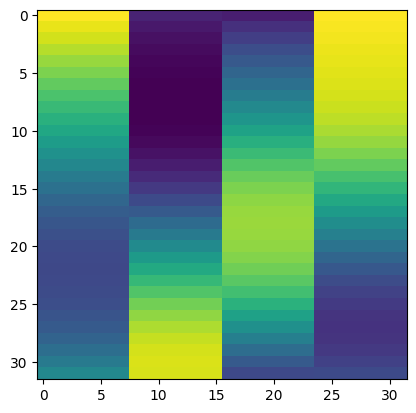

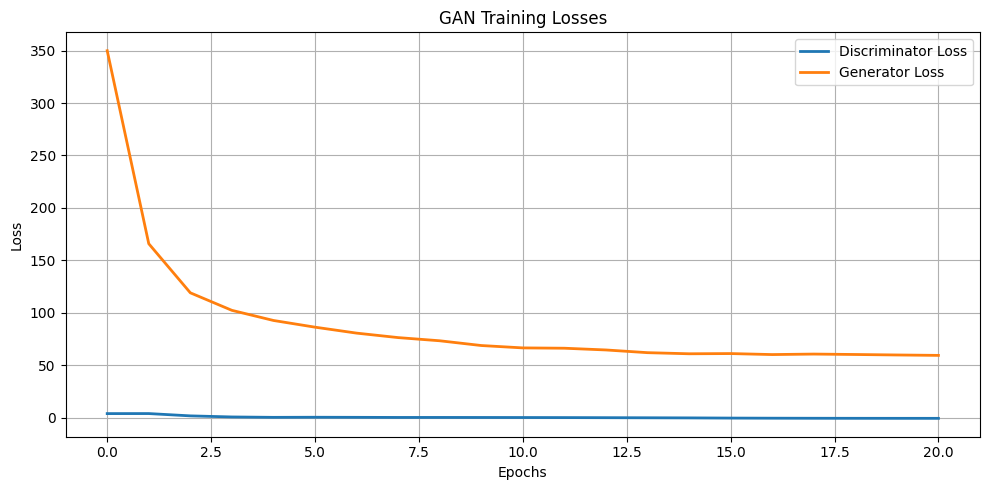

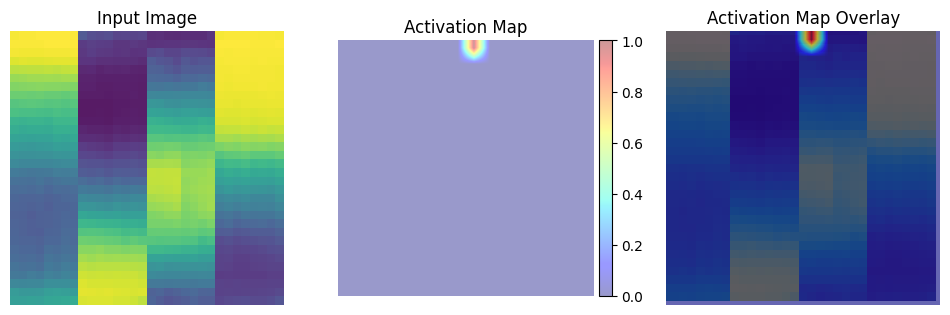

...

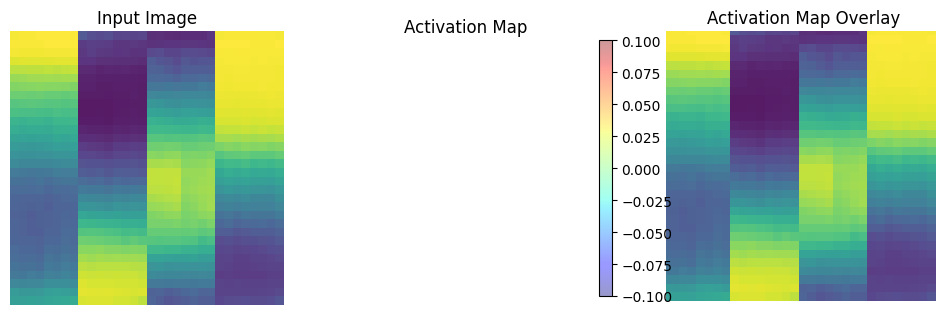

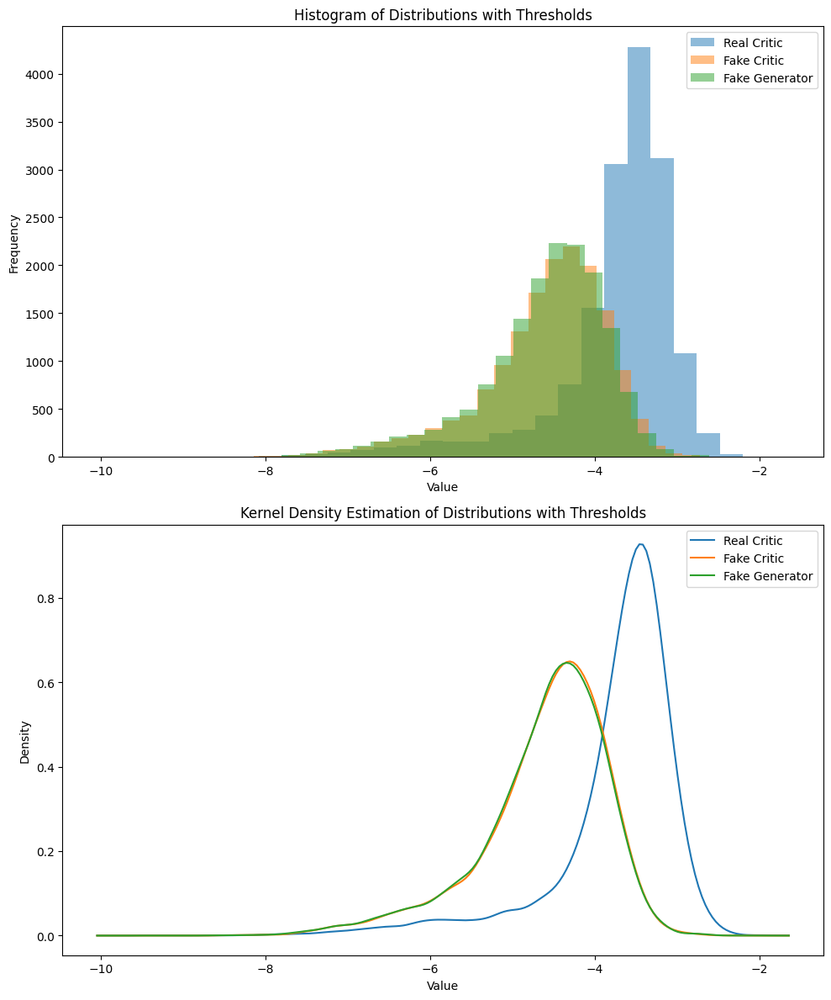

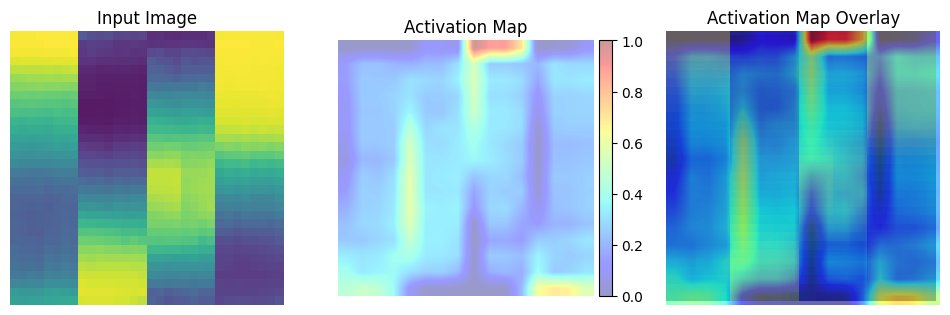

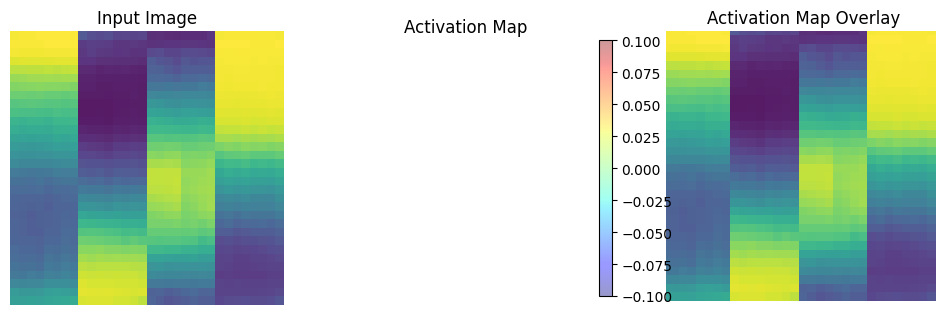

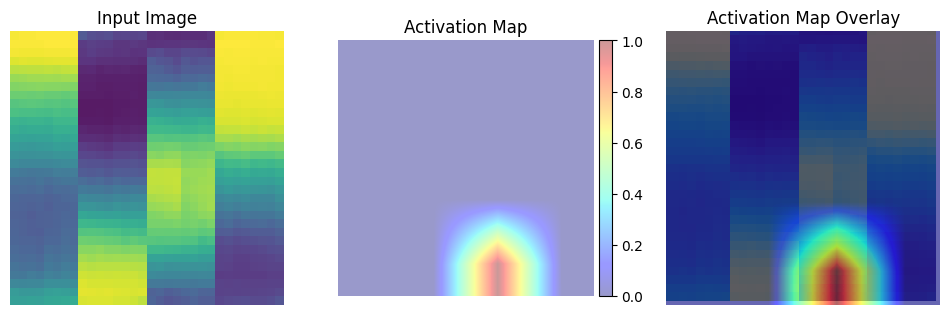

	MNSE Score: 0.012378143782298717
Batch [0/63] -  Critic loss:  -0.8195962111155192 - generator loss:  54.0521125793457
Batch [21/63] -  Critic loss:  -0.7986464843605504 - generator loss:  59.786053224043414
Batch [42/63] -  Critic loss:  -0.8050946828930877 - generator loss:  59.14252037225768
	Epoch 21 - critic loss: -0.8028145782531254 - generator loss: 58.93078474014524


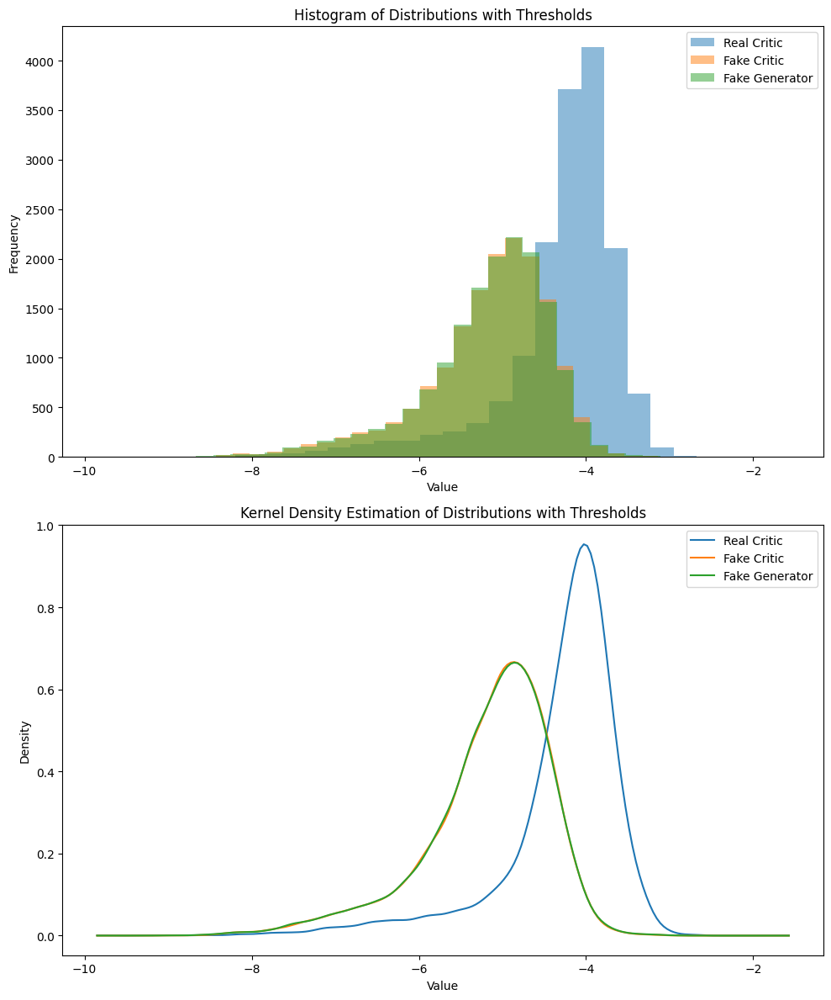

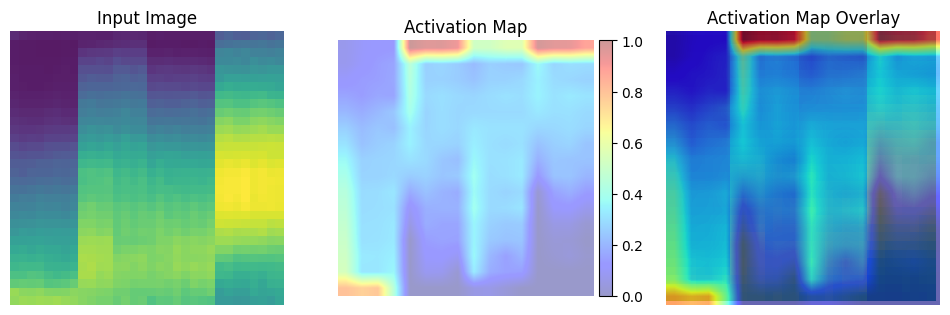

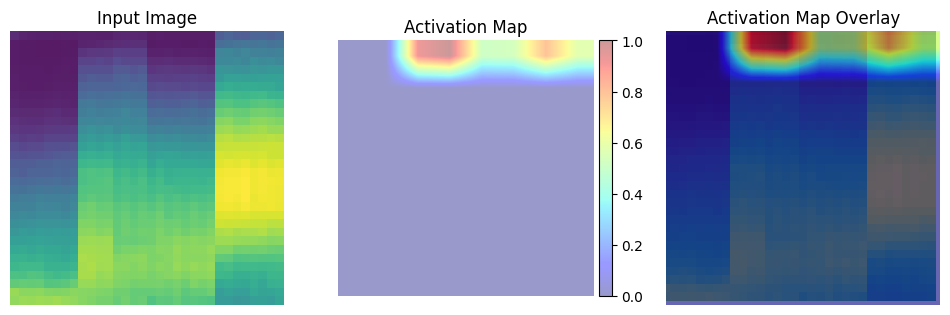

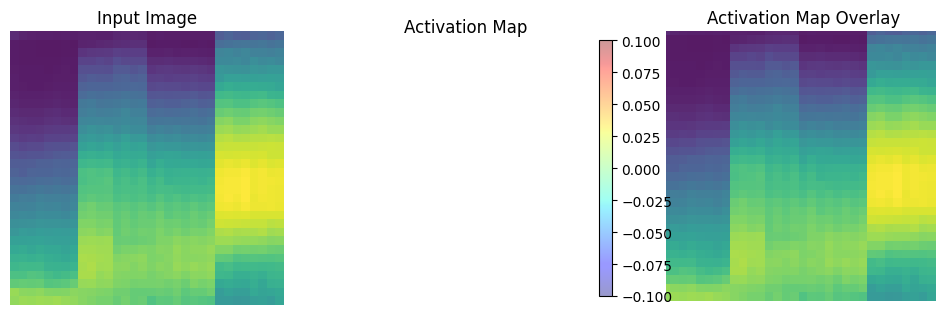

	MNSE Score: 0.01201933202525926
Batch [0/63] -  Critic loss:  -0.8181162079175314 - generator loss:  58.84062957763672
Batch [21/63] -  Critic loss:  -0.8196719333981023 - generator loss:  58.89461708068848
Batch [42/63] -  Critic loss:  -0.8239678139834442 - generator loss:  59.5511474609375
	Epoch 22 - critic loss: -0.8227422417156283 - generator loss: 59.318829430474175


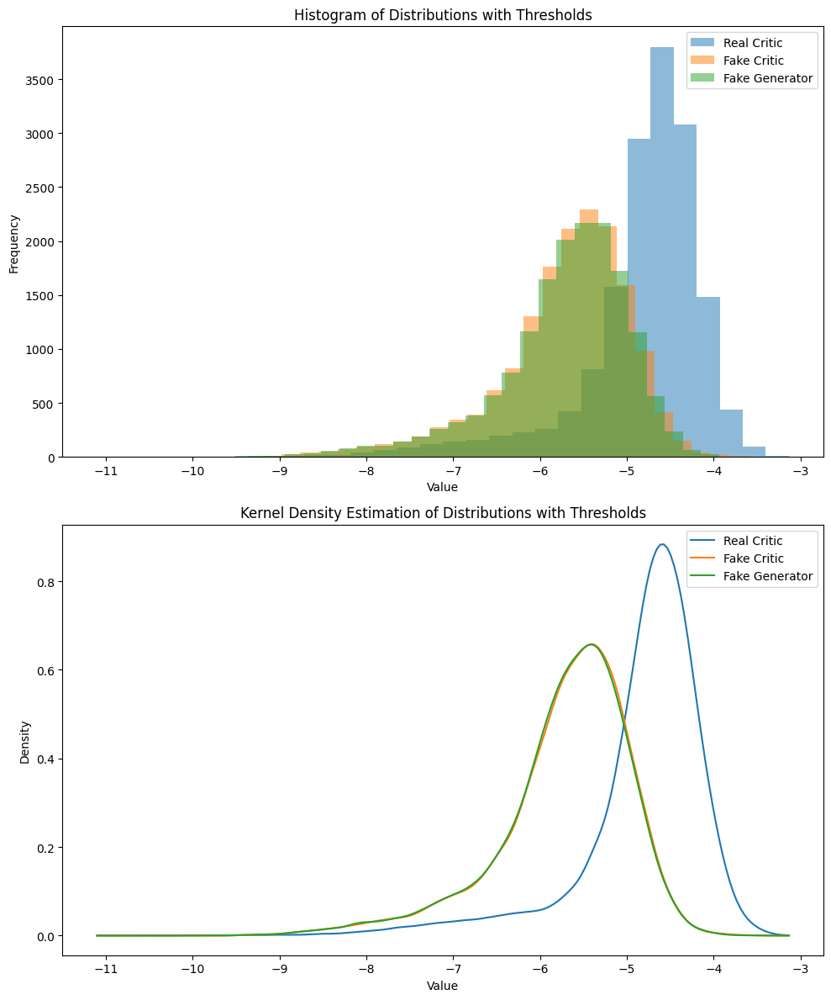

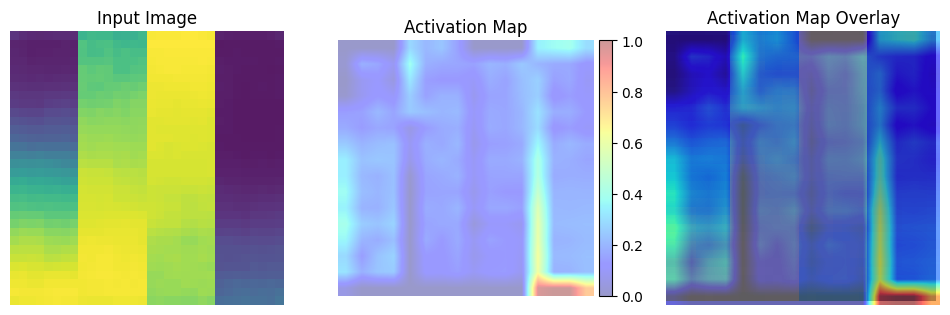

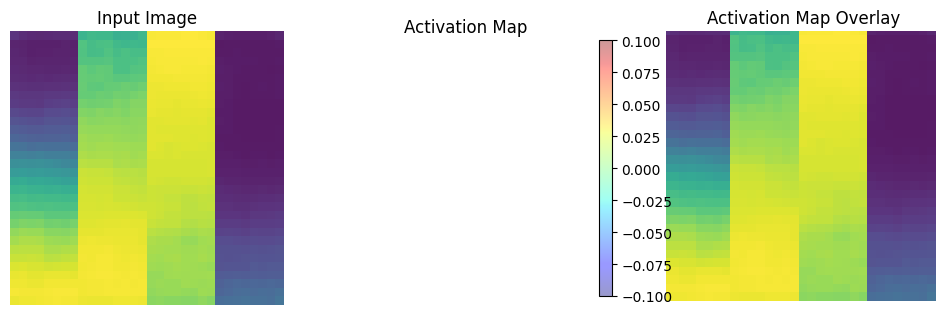

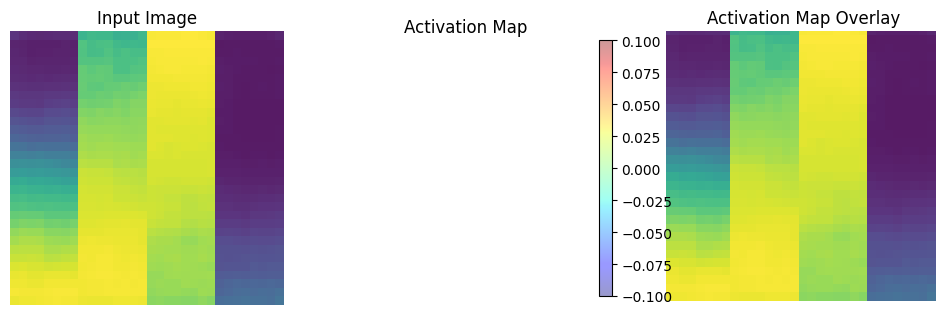

	MNSE Score: 0.01192629604881245
Batch [0/63] -  Critic loss:  -0.8712077736854553 - generator loss:  58.22096252441406
Batch [21/63] -  Critic loss:  -0.8246649503707885 - generator loss:  58.56245509060946
Batch [42/63] -  Critic loss:  -0.8300698575123335 - generator loss:  58.91325520360193
	Epoch 23 - critic loss: -0.8313008543675535 - generator loss: 59.29111184014214


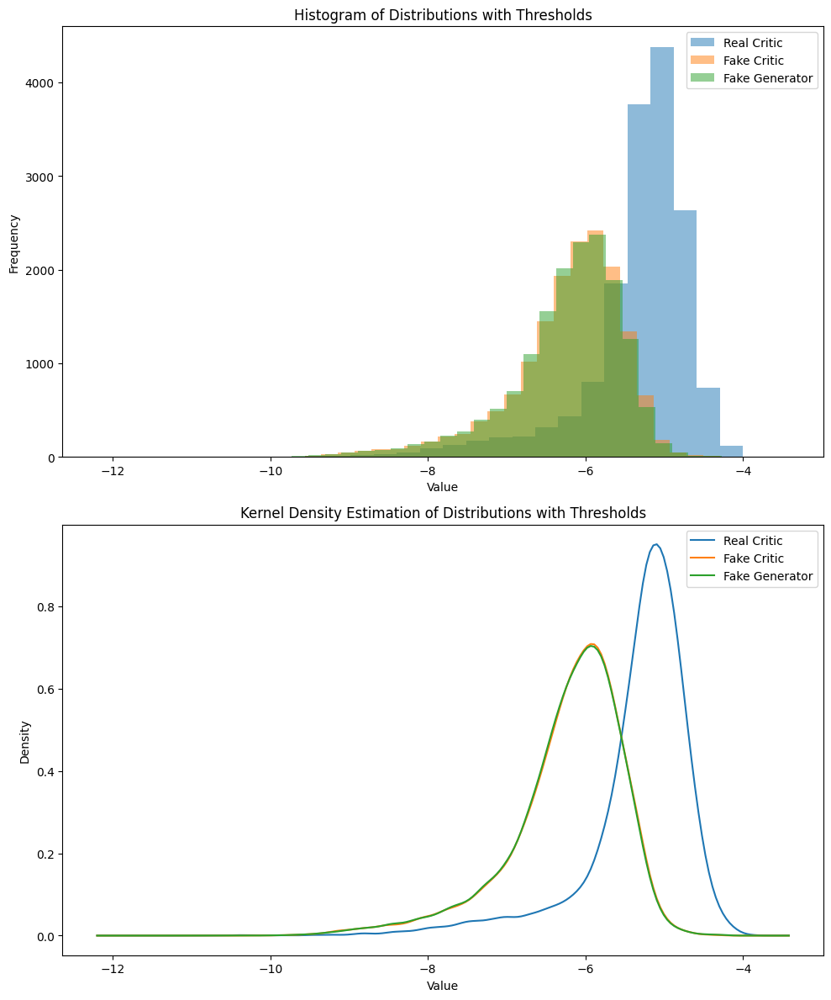

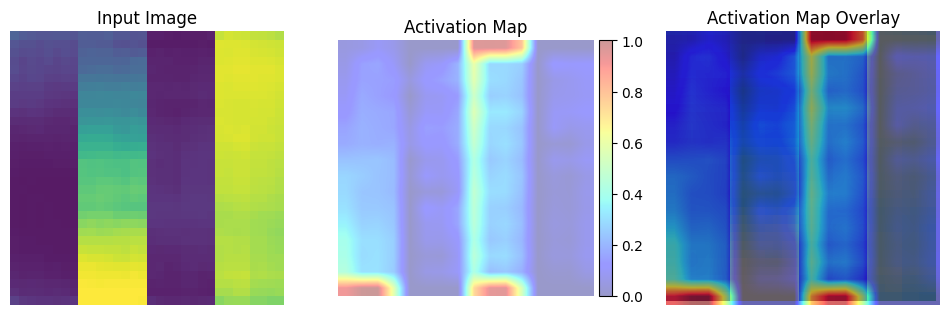

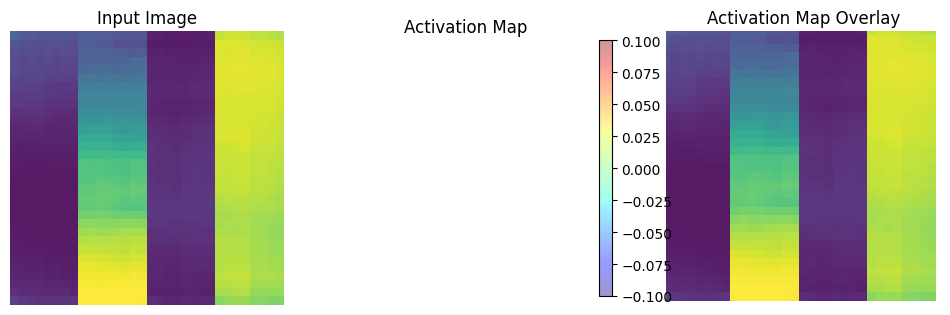

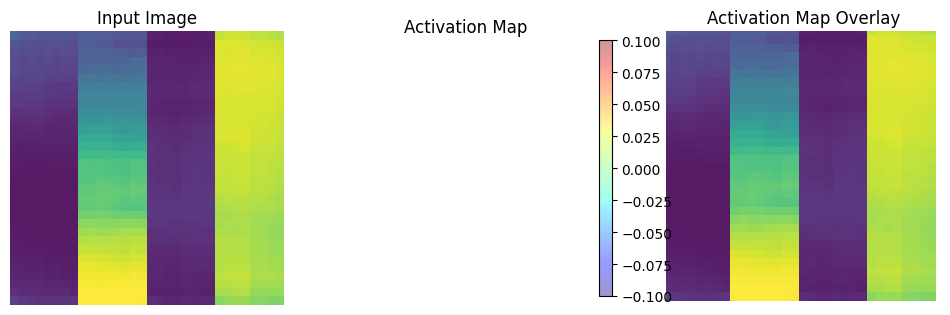

	MNSE Score: 0.011671364026528502
Batch [0/63] -  Critic loss:  -0.8700980345408121 - generator loss:  60.487648010253906
Batch [21/63] -  Critic loss:  -0.8239600649385742 - generator loss:  58.998099933971055
Batch [42/63] -  Critic loss:  -0.8284142876780314 - generator loss:  58.81395375451376
	Epoch 24 - critic loss: -0.8328928323019119 - generator loss: 58.338704184880335


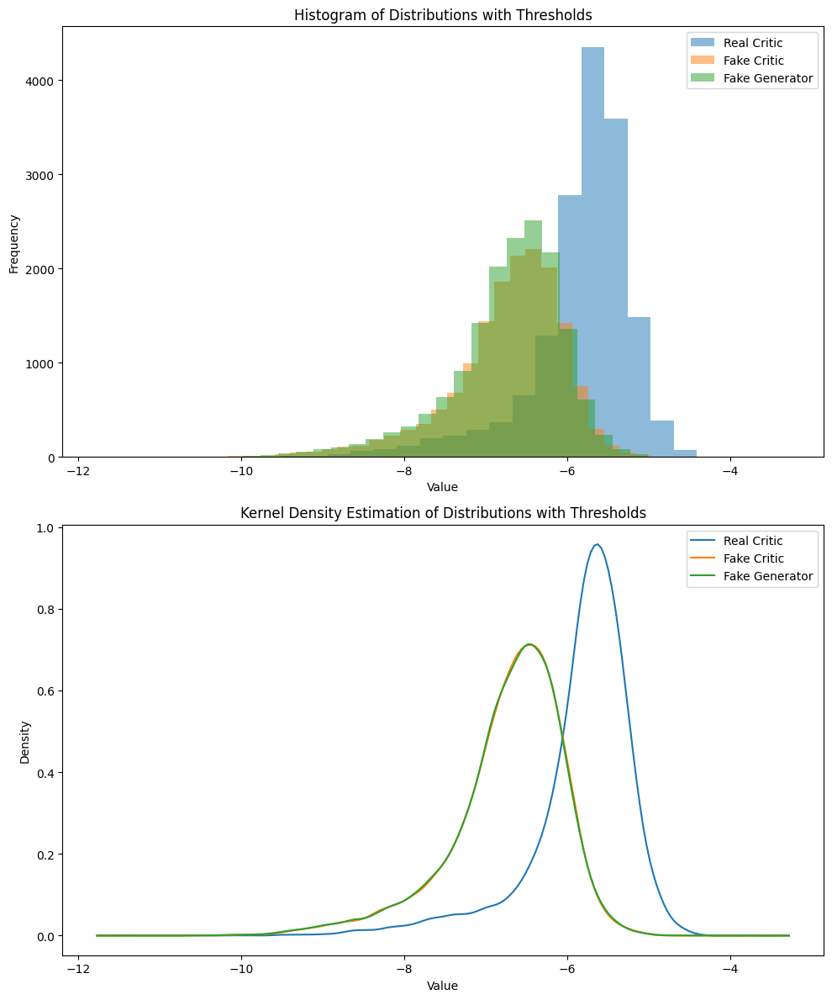

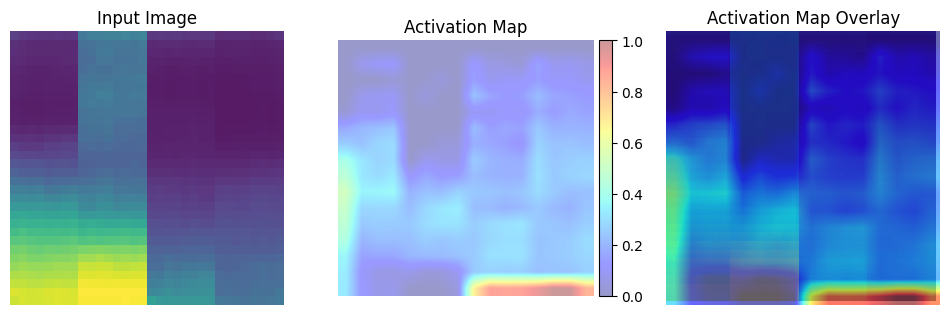

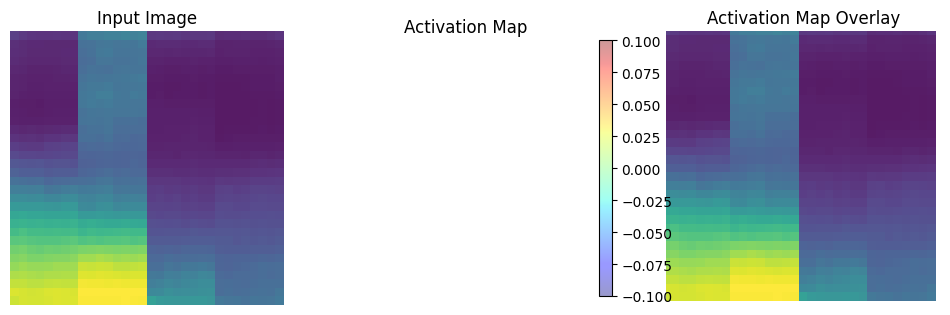

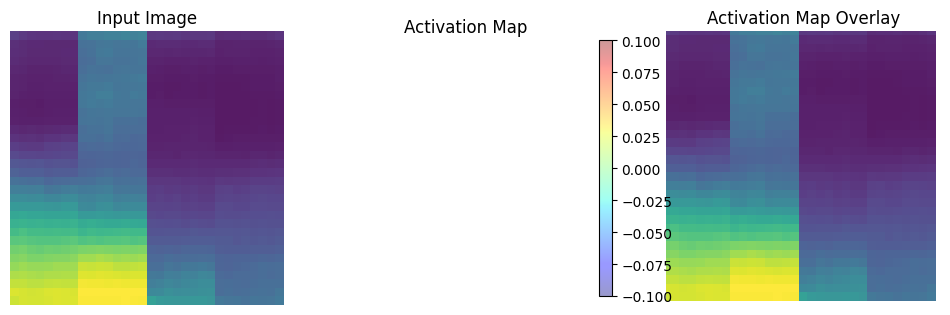

	MNSE Score: 0.011054030530864284
Batch [0/63] -  Critic loss:  -0.7490047415097555 - generator loss:  52.70619201660156
Batch [21/63] -  Critic loss:  -0.836296008391814 - generator loss:  58.04523606733842
Batch [42/63] -  Critic loss:  -0.8236843883529189 - generator loss:  57.75295940665312
	Epoch 25 - critic loss: -0.8237709052978999 - generator loss: 58.009546976240856


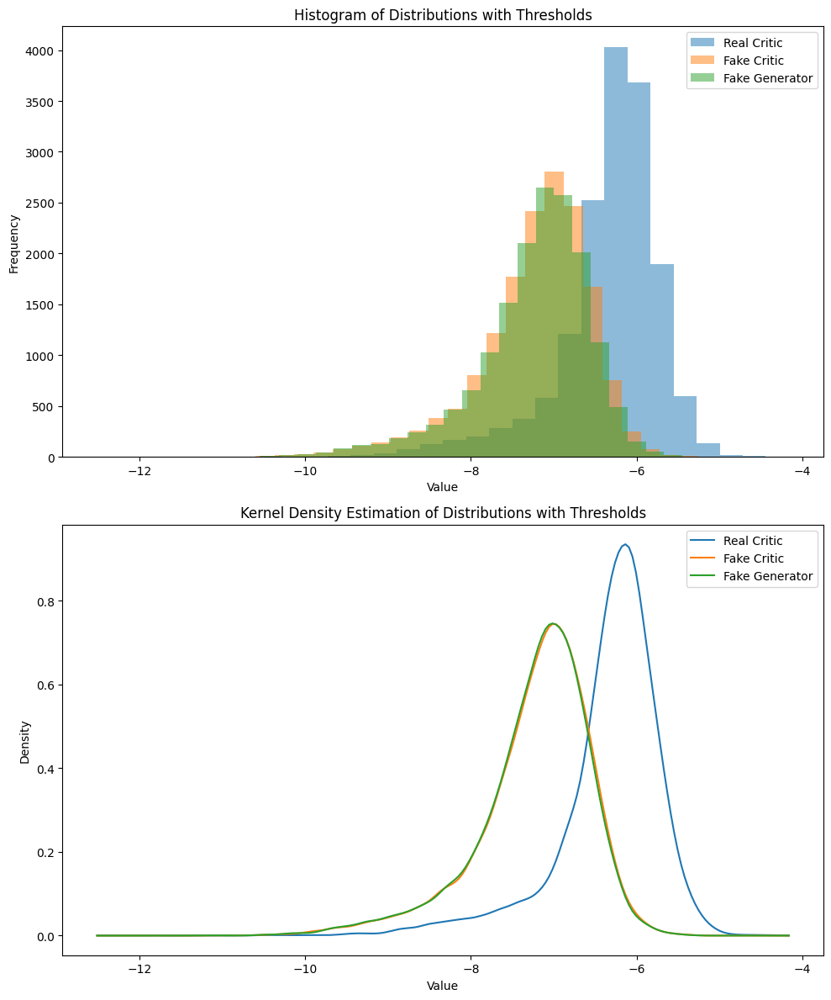

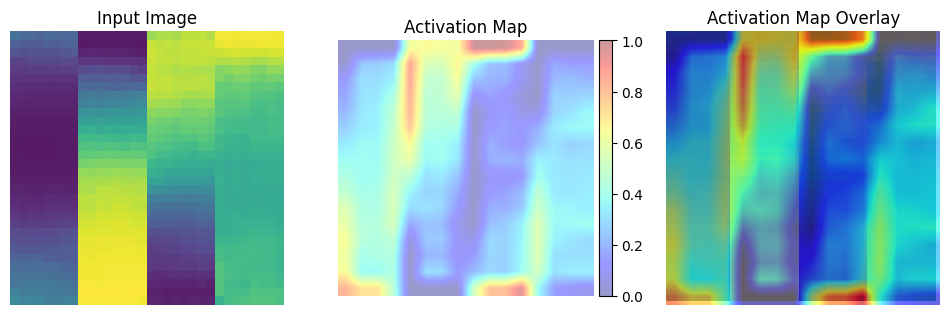

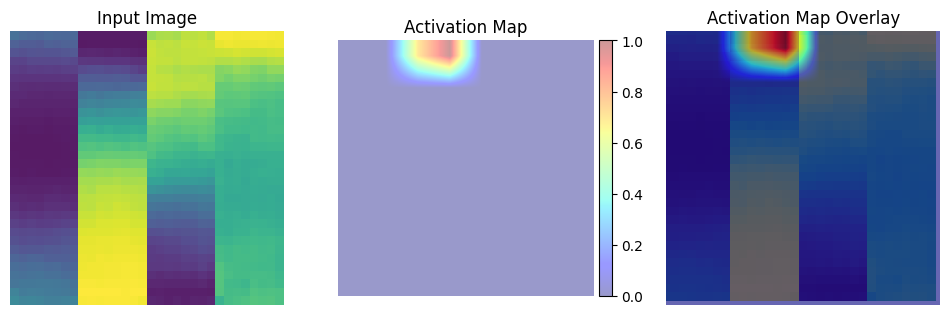

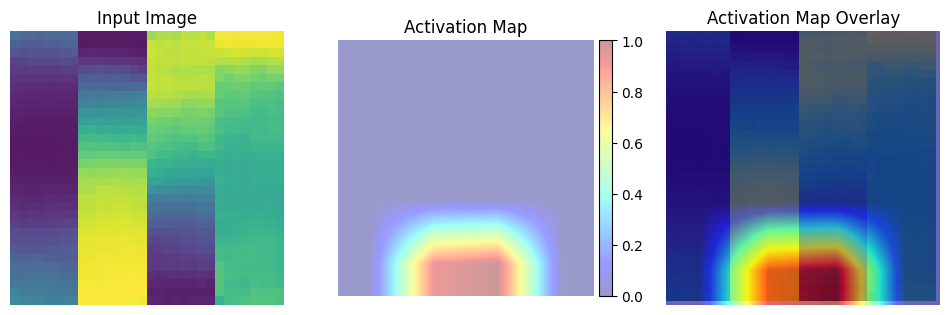

	MNSE Score: 0.010712789475089975
Batch [0/63] -  Critic loss:  -0.847536027431488 - generator loss:  56.73773956298828
Batch [21/63] -  Critic loss:  -0.8277500009897983 - generator loss:  57.749962373213336
Batch [42/63] -  Critic loss:  -0.8306270297183547 - generator loss:  57.69499650112418
	Epoch 26 - critic loss: -0.8303081314399763 - generator loss: 57.74889422219897


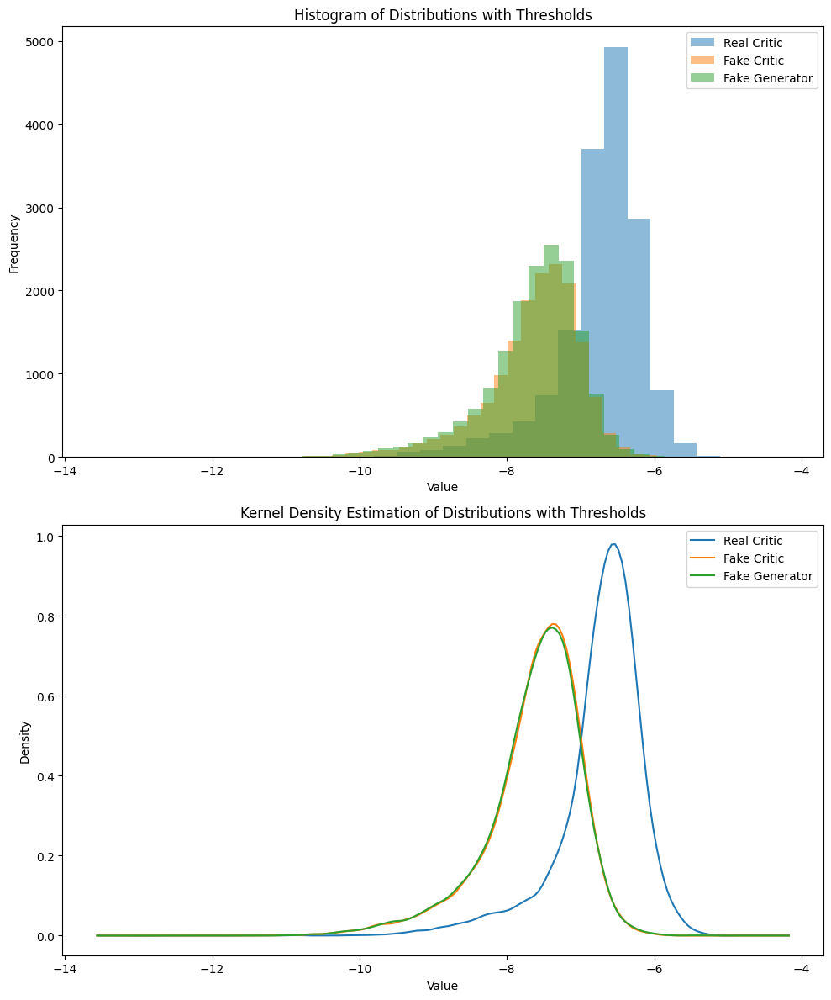

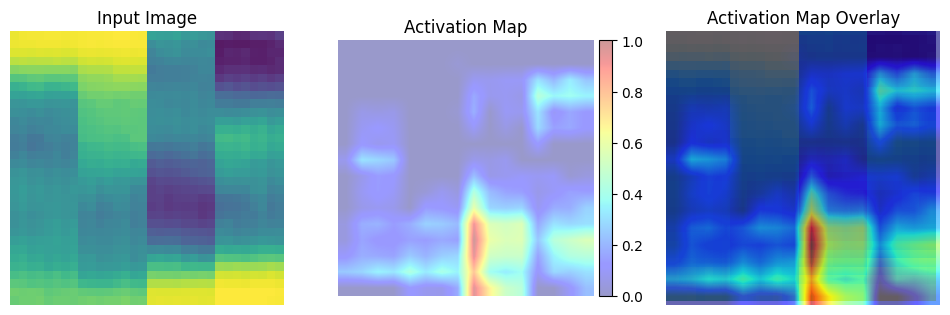

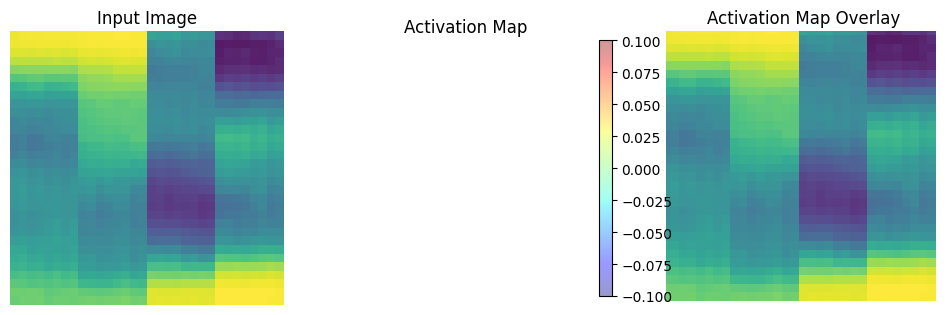

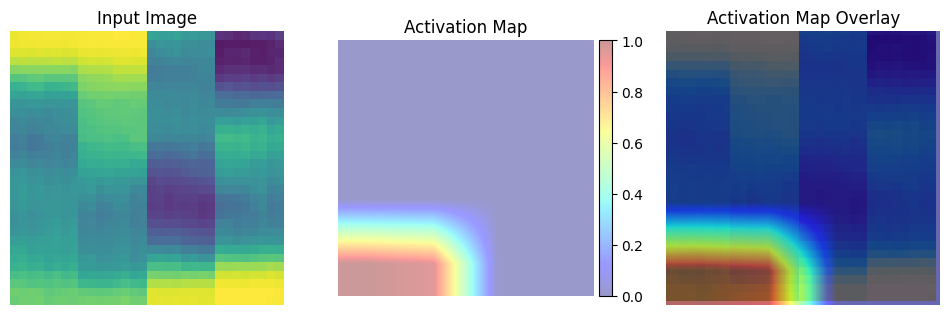

	MNSE Score: 0.01041709470547854
Batch [0/63] -  Critic loss:  -0.9463294744491577 - generator loss:  60.54232406616211
Batch [21/63] -  Critic loss:  -0.8261739765152786 - generator loss:  58.829694574529476
Batch [42/63] -  Critic loss:  -0.8359638494114542 - generator loss:  58.77098056881927
	Epoch 27 - critic loss: -0.8337743982436163 - generator loss: 58.17596677749876
Batch [0/63] -  Critic loss:  -0.8109537760416666 - generator loss:  54.601314544677734
Batch [21/63] -  Critic loss:  -0.8320563715515715 - generator loss:  57.43402255665172
Batch [42/63] -  Critic loss:  -0.8276936564334604 - generator loss:  57.691986172698265


In [ ]:
channel_est_wgan_gp_rec_skew_loss()